In [82]:
# imports

from general_imports import * # imports needed for most of scripts

# Use util fun to find all mps in a selected radius
from utils_mps import find_mps_in_radius, get_region_mp_nums

# Import helper functions
from utils_helpers import smape, get_date_range, split_ds_mp

# Import XGBoost utils
from utils_xgboost import get_XGB_model

In [2]:
# regions from 1 to 9
regions = [
    "Burgenland",
    "Kärnten",
    "Niederösterreich",
    "Oberösterreich",
    "Salzburg",
    "Steiermark",
    "Tirol",
    "Vorarlberg",
    "Wien"
]

region_dirs = ["ehyd_messstellen_{0}_gw_{1}".format(i + 1, regions[i]) for i in range(0,len(regions))]
region_dirs

['ehyd_messstellen_1_gw_Burgenland',
 'ehyd_messstellen_2_gw_Kärnten',
 'ehyd_messstellen_3_gw_Niederösterreich',
 'ehyd_messstellen_4_gw_Oberösterreich',
 'ehyd_messstellen_5_gw_Salzburg',
 'ehyd_messstellen_6_gw_Steiermark',
 'ehyd_messstellen_7_gw_Tirol',
 'ehyd_messstellen_8_gw_Vorarlberg',
 'ehyd_messstellen_9_gw_Wien']

## Integrate data from all mps from all regions

In [20]:
# Integrate data from all mps from all regions
records = []
colnames = []

iterator = 0

for region_idx in range(len(regions)):
    
    region = regions[region_idx]
    
    print("Region:", region)
    region_dir = region_dirs[region_idx]
    
    region_sum_dir = os.path.join(region_dir, "Summary")
    print(region_sum_dir)
    
    # Summary file paths
    sum_fpaths = Path(region_sum_dir).glob("Summary-*.csv")

    for fpath in sum_fpaths:
        df_mp = pd.read_csv(fpath)

        # Execute only once
        if iterator == 0:
            colnames = list(df_mp.columns)

        records.extend(df_mp.values.tolist())
        iterator += 1

ds = pd.DataFrame(records, columns = colnames)

# Convert gw-level to float. Some used time series models expect y as float
ds["gw-level"] = ds["gw-level"].astype(float)

# Remove redundandt cols
del_colnames = ["dbmsnr", "region", "day"]
for colname in del_colnames:
    del ds[colname]


# Add timepoint col at the beginning
ds.insert(0, "timepoint", "")
ds["timepoint"] = ds.apply(
    lambda row: str(row['year']) + "-" + str("{:02d}".format(row['month'])) + "-01"
    , axis=1)
ds["timepoint"] = pd.to_datetime(ds["timepoint"], format="%Y-%m-%d")
print("> dtype of 'timepoint' columns is:", ds["timepoint"].dtype)

del ds["date"]
del ds["year"]
del ds["month"]

# Put regressed col (gw-level) at the end
gw_level_col = ds.pop("gw-level")
ds.insert(len(list(ds.columns)), "gw-level", gw_level_col)

# Print summary of Null values
print("> NaN summary:")
print(pd.isnull(ds).sum())

# Delete since it's nan most of the times
del ds["t_measuring_depth"]

# TODO: find a way later to include "temp" in cols. Del ONLY FOR NOW
del ds["temp"]

# # Drop raws with Nan
# print("DS len before dropna =", len(ds))
# ds.dropna(inplace=True)
# print("DS len after dropna =", len(ds))

ds

Region: Burgenland
ehyd_messstellen_1_gw_Burgenland/Summary
Region: Kärnten
ehyd_messstellen_2_gw_Kärnten/Summary
Region: Niederösterreich
ehyd_messstellen_3_gw_Niederösterreich/Summary
Region: Oberösterreich
ehyd_messstellen_4_gw_Oberösterreich/Summary
Region: Salzburg
ehyd_messstellen_5_gw_Salzburg/Summary
Region: Steiermark
ehyd_messstellen_6_gw_Steiermark/Summary
Region: Tirol
ehyd_messstellen_7_gw_Tirol/Summary
Region: Vorarlberg
ehyd_messstellen_8_gw_Vorarlberg/Summary
Region: Wien
ehyd_messstellen_9_gw_Wien/Summary
> dtype of 'timepoint' columns is: datetime64[ns]
timepoint                  0
x                          0
y                          0
hzbnr01                    0
land_height              252
mp_height                252
bottom_line             3808
t_measuring_depth     673686
yr_max                     0
yr_max_dist                0
yr_min                     0
yr_min_dist                0
yr_avg                     0
yr_avg_dist                0
yr_avg_abs(dist)

,timepoint,x,y,hzbnr01,land_height,mp_height,bottom_line,yr_max,yr_max_dist,yr_min,yr_min_dist,yr_avg,yr_avg_dist,yr_avg_abs(dist),gw-level
0,1999-01-01,624398.59,376150.42,345488,281.88,282.43,272.48,276.59,0.06,275.91,0.62,0.68,275.85,275.85,276.53
1,1999-02-01,624398.59,376150.42,345488,281.88,282.43,272.48,276.59,0.15,275.91,0.53,0.68,275.76,275.76,276.44
2,1999-03-01,624398.59,376150.42,345488,281.88,282.43,272.48,276.59,0.28,275.91,0.40,0.68,275.63,275.63,276.31
3,1999-04-01,624398.59,376150.42,345488,281.88,282.43,272.48,276.59,0.35,275.91,0.33,0.68,275.56,275.56,276.24
4,1999-05-01,624398.59,376150.42,345488,281.88,282.43,272.48,276.59,0.18,275.91,0.50,0.68,275.73,275.73,276.41
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
1454479,2021-05-01,623430.53,483260.63,330167,200.87,200.87,182.67,191.86,0.35,191.47,0.04,0.39,191.12,191.12,191.51
1454480,2021-06-01,623430.53,483260.63,330167,200.87,200.87,182.67,191.86,0.34,191.47,0.05,0.39,191.13,191.13,191.52
1454481,2021-07-01,623430.53,483260.63,330167,200.87,200.87,182.67,191.86,0.28,191.47,0.11,0.39,191.19,191.19,191.58
1454482,2021-08-01,623430.53,483260.63,330167,200.87,200.87,182.67,191.86,0.09,191.47,0.30,0.39,191.38,191.38,191.77


## XGBoost: XGBRegressor 

In [ ]:
for mp_num in f_mp_nums:

    model_smape = []
    model_predictions = dict()
    
    # Get data and split it into variables
    ds_mp = ds.query("hzbnr01==@mp_num")
    X, y, T, ds_mp_train, X_Train, y_Train, T_Train, ds_mp_val, X_val, y_val, T_val, T_total = split_ds_mp(ds_mp.copy(), FORECAST_T_START)
    
    # Try and compare different models
    for MODEL_NAME in ML_MODEL_NAMES:
        # Get fitted model
        fitted_model = get_fitted_model(MODEL_NAME, X, y, N_THREAD, MODEL_TUNE)
        
        # Create df_forecast and fill with features that can be obtained from the timestamp @Azeez
        
        # For each of [yr_min, yr_max, yr_avg], get a model, fit, forecast the values.
        
        # Calculate any necessary features if needed (e.g. yr_max_dist)
        
        # Predict gw-level
        
        # Calc SMAPE (Forecast on test vs Actual test)
        
        model_smape.append([MODEL_NAME, smape_score])
        mmodel_predictions[MODEL_NAME] = df_predictions
        
        # Create df_model_smape
        df_model_smape = pd.DataFrame([model_smape], columns=["model_name", "SMAPE_score"])
    
    # Print df_model_smape for this mp
    # Plot predictions of different models on same plot
    # TODO: plot_multi(....)
        
    # Find model with best SMAPE score
    
    # Fit top model ALL DATA (TILL END 2022), forecast, and assign values to the template provdied by hackathon
    
    

In [18]:
def plot_ts(T_total, T_train, T_target, A, F, forecast_existing):
    """
    Plot time series data of the gw-level of a selected measurement point vs the forecasted values if provided
    
    Parameters:
    ---------------
    T: numpy.ndarray
        The plotted timepoints represented as mm:yyyy
    A: numpy.ndarray
        The actual gw-level data values for an mp at given timepoints
    F: numpy.ndarray (optional)
        The forecasted gw-level data values at same timepoints to be plotted against actual ones
    """
    
    # Print first and last timepoints
    print("First timepoint:", T_total[0])
    print("Last timepoint:\t", T_total[-1])
    
    # Set figure size
    fig, ax = plt.subplots(figsize=(16, 9))
    
    # Plot actual data vs time
    if forecast_existing:        
        plt.plot(T_total, A, color = "blue", 
                 linewidth=4, label = "Actual GW-Level") # make "A" wider
    else:
        plt.plot(T_train, A, color = "blue", 
                 linewidth=4, label = "Actual GW-Level") # make "A" wider

    # Plot forecasted data vs time
    plt.plot(T_target, F, color = "orange", 
             linewidth=4, linestyle='dashed', label = "Forecasted GW-Level")
        
    plt.gcf().autofmt_xdate()
        
    # Add plot legend
    plt.legend(loc="upper right")
    
    # Set year as x-axis for timeseries plot
    # source: https://stackoverflow.com/questions/57126647/how-to-change-xticks-to-yearly-interval-in-pandas-time-series-plot
    ax.xaxis.set_major_locator(matplotlib.dates.YearLocator(base=2)) # step = 2 years
    ax.xaxis.set_major_formatter(matplotlib.dates.DateFormatter("%Y"))
    
    plt.show()

    return None

> Region: Burgenland
N included mps: 5
N records: 1140
N train dates: 248
1999-01-01 00:00:00 till 2019-10-01 00:00:00
N forecast dates (horizon): 26
2019-11-01 00:00:00 till 2021-12-01 00:00:00
> SMAPE Score: 0.080304
First timepoint: 1999-01-01 00:00:00
Last timepoint:	 2021-12-01 00:00:00


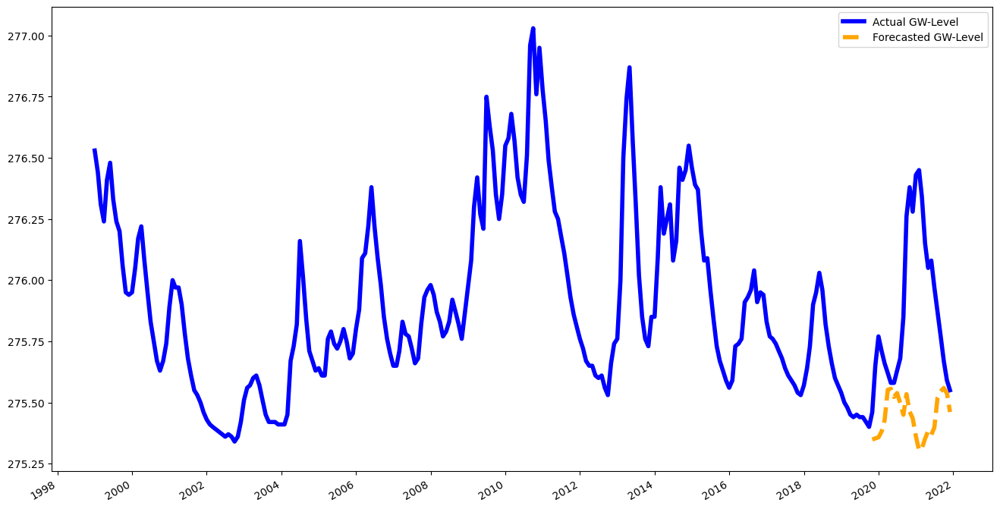



N train dates: 117
2008-01-01 00:00:00 till 2019-10-01 00:00:00
N forecast dates (horizon): 26
2019-11-01 00:00:00 till 2021-12-01 00:00:00
> SMAPE Score: 0.082916
First timepoint: 2008-01-01 00:00:00
Last timepoint:	 2021-12-01 00:00:00


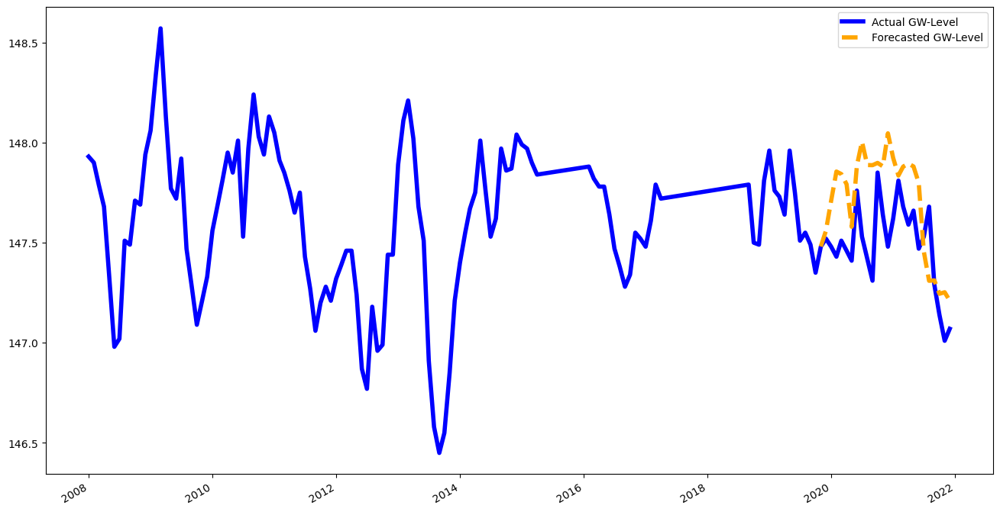



N train dates: 227
2000-11-01 00:00:00 till 2019-10-01 00:00:00
N forecast dates (horizon): 26
2019-11-01 00:00:00 till 2021-12-01 00:00:00
> SMAPE Score: 0.088484
First timepoint: 2000-11-01 00:00:00
Last timepoint:	 2021-12-01 00:00:00


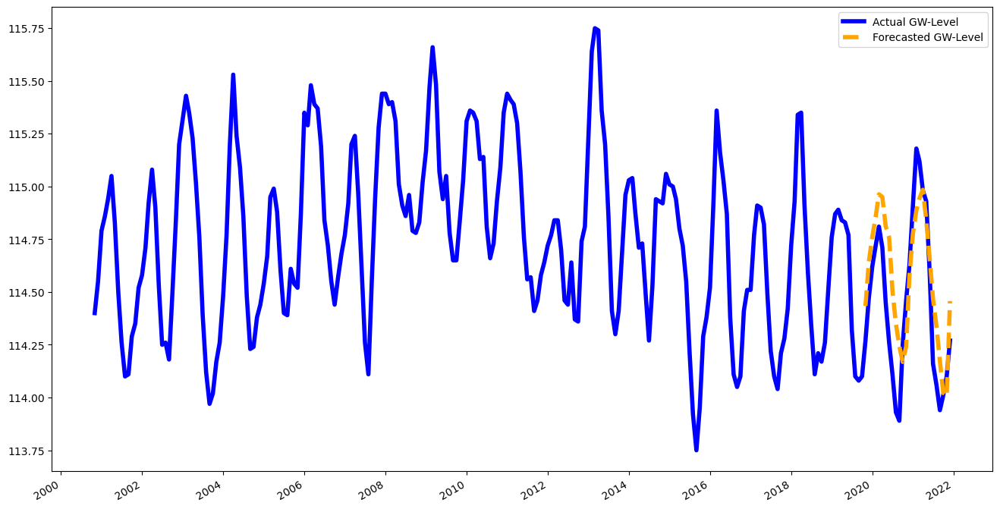



N train dates: 377
1988-01-01 00:00:00 till 2019-10-01 00:00:00
N forecast dates (horizon): 22
2020-03-01 00:00:00 till 2021-12-01 00:00:00
> SMAPE Score: 0.133906
First timepoint: 1988-01-01 00:00:00
Last timepoint:	 2021-12-01 00:00:00


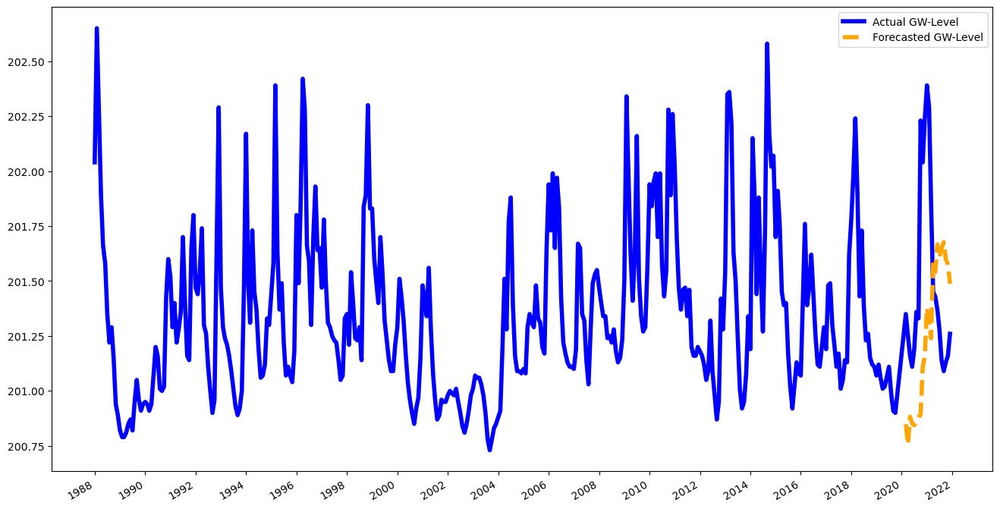



N train dates: 100
2011-05-01 00:00:00 till 2019-10-01 00:00:00
N forecast dates (horizon): 25
2019-11-01 00:00:00 till 2021-11-01 00:00:00
> SMAPE Score: 0.03684
First timepoint: 2011-05-01 00:00:00
Last timepoint:	 2021-11-01 00:00:00


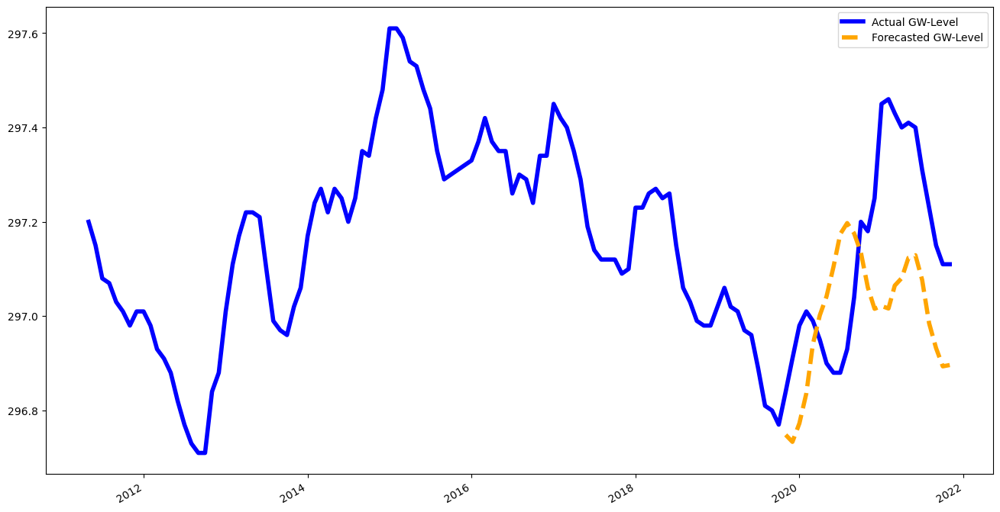



N train dates: 272
1997-02-01 00:00:00 till 2019-10-01 00:00:00
N forecast dates (horizon): 26
2019-11-01 00:00:00 till 2021-12-01 00:00:00
> SMAPE Score: 0.115025
First timepoint: 1997-02-01 00:00:00
Last timepoint:	 2021-12-01 00:00:00


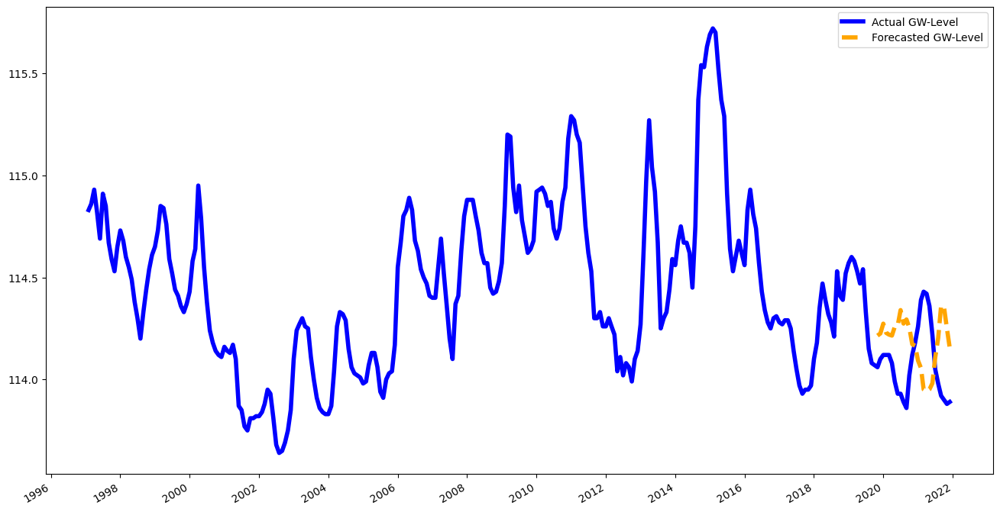



N train dates: 238
2000-01-01 00:00:00 till 2019-10-01 00:00:00
N forecast dates (horizon): 26
2019-11-01 00:00:00 till 2021-12-01 00:00:00
> SMAPE Score: 0.227353
First timepoint: 2000-01-01 00:00:00
Last timepoint:	 2021-12-01 00:00:00


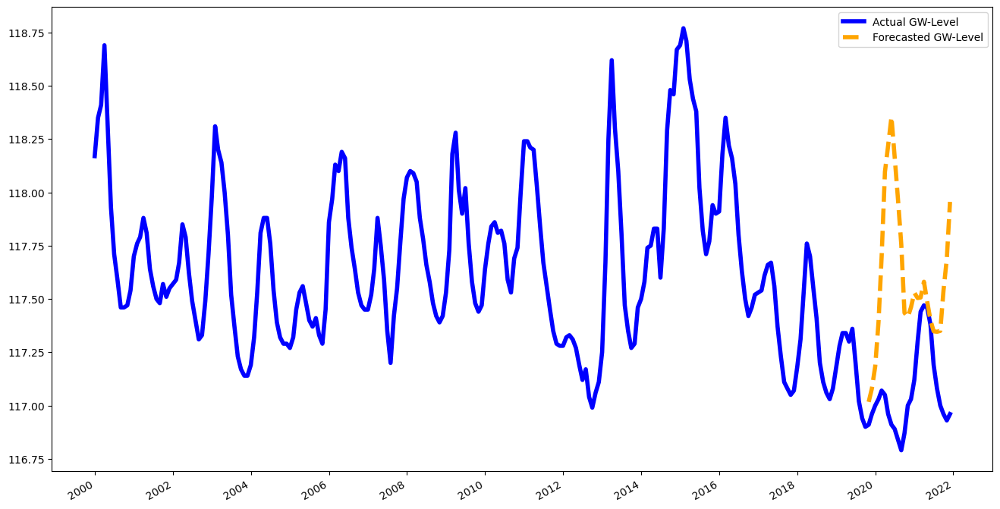



N train dates: 368
1989-01-01 00:00:00 till 2019-10-01 00:00:00
N forecast dates (horizon): 26
2019-11-01 00:00:00 till 2021-12-01 00:00:00
> SMAPE Score: 0.074277
First timepoint: 1989-01-01 00:00:00
Last timepoint:	 2021-12-01 00:00:00


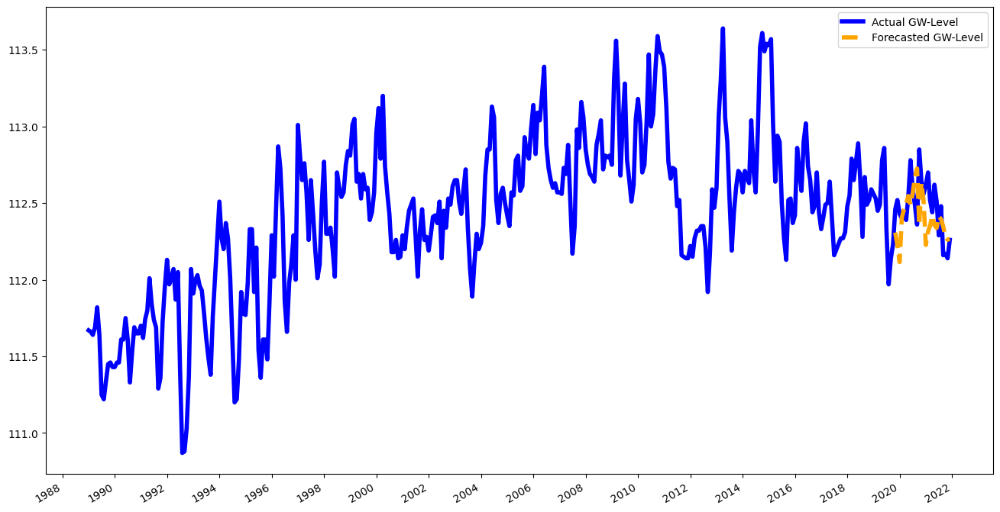



N train dates: 664
1962-06-01 00:00:00 till 2019-10-01 00:00:00
N forecast dates (horizon): 26
2019-11-01 00:00:00 till 2021-12-01 00:00:00
> SMAPE Score: 0.191342
First timepoint: 1962-06-01 00:00:00
Last timepoint:	 2021-12-01 00:00:00


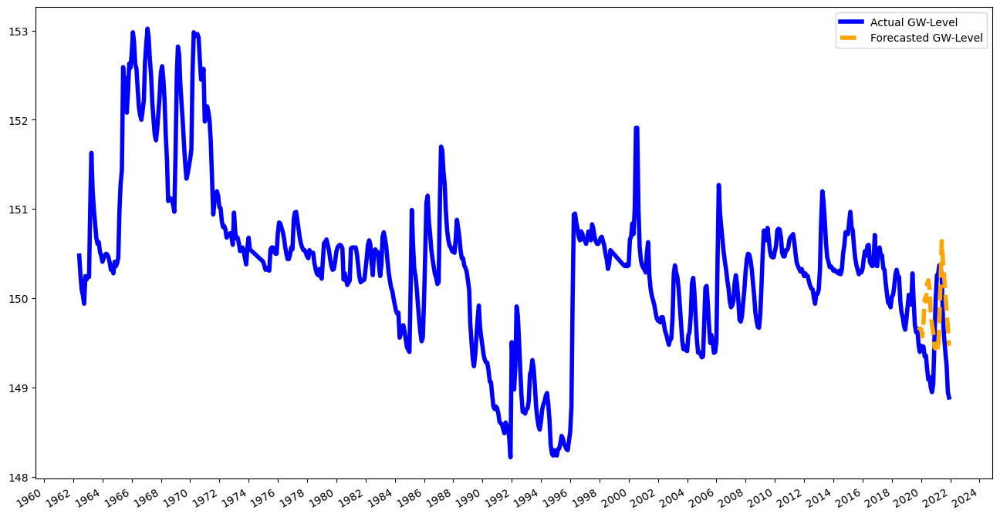



N train dates: 540
1974-11-01 00:00:00 till 2019-10-01 00:00:00
N forecast dates (horizon): 26
2019-11-01 00:00:00 till 2021-12-01 00:00:00
> SMAPE Score: 0.153097
First timepoint: 1974-11-01 00:00:00
Last timepoint:	 2021-12-01 00:00:00


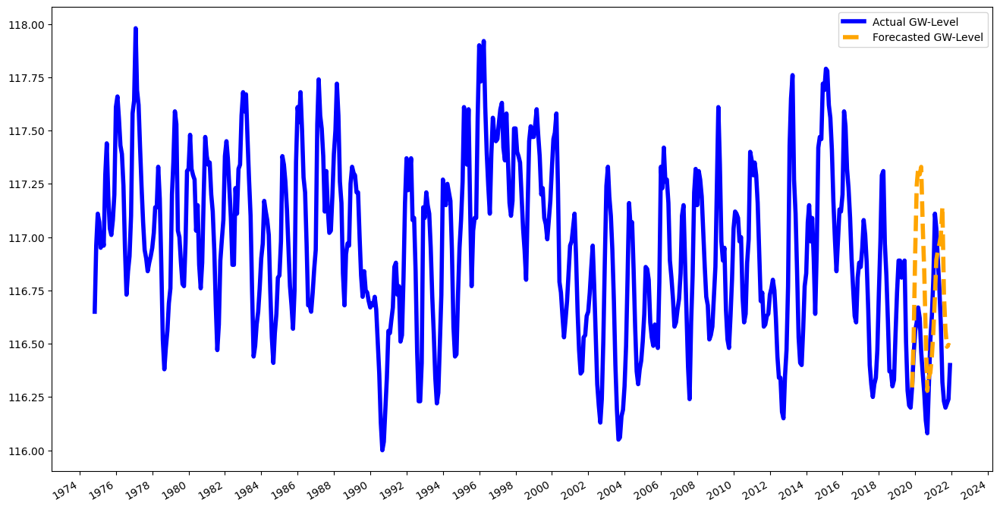



N train dates: 291
1995-08-01 00:00:00 till 2019-10-01 00:00:00
N forecast dates (horizon): 26
2019-11-01 00:00:00 till 2021-12-01 00:00:00
> SMAPE Score: 0.130912
First timepoint: 1995-08-01 00:00:00
Last timepoint:	 2021-12-01 00:00:00


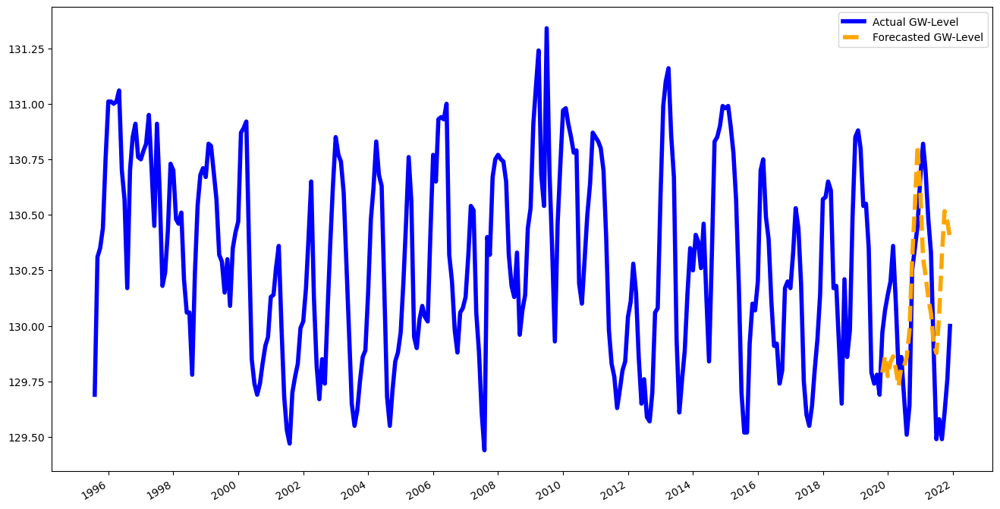



N train dates: 540
1974-11-01 00:00:00 till 2019-10-01 00:00:00
N forecast dates (horizon): 26
2019-11-01 00:00:00 till 2021-12-01 00:00:00
> SMAPE Score: 0.117558
First timepoint: 1974-11-01 00:00:00
Last timepoint:	 2021-12-01 00:00:00


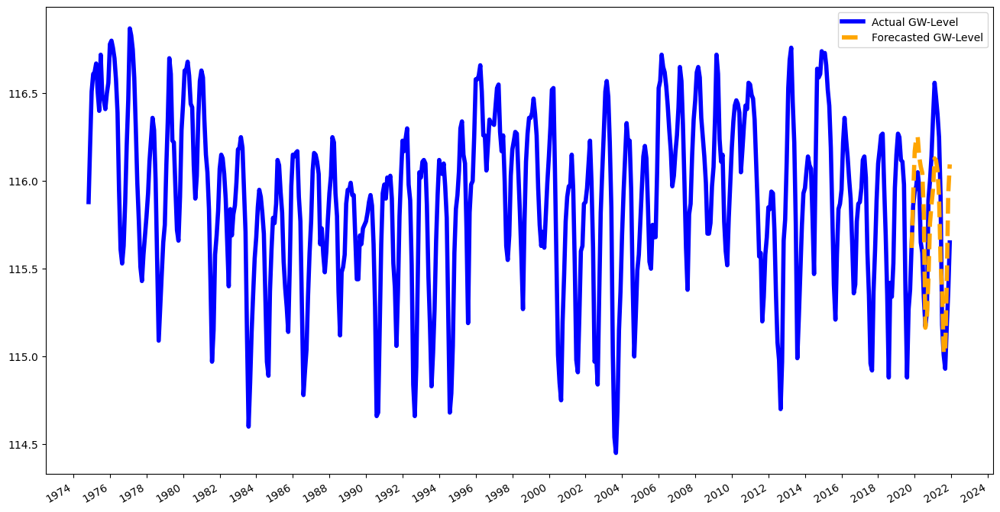



N train dates: 476
1976-06-01 00:00:00 till 2019-07-01 00:00:00
N forecast dates (horizon): 15
2020-01-01 00:00:00 till 2021-12-01 00:00:00
> SMAPE Score: 0.091903
First timepoint: 1976-06-01 00:00:00
Last timepoint:	 2021-12-01 00:00:00


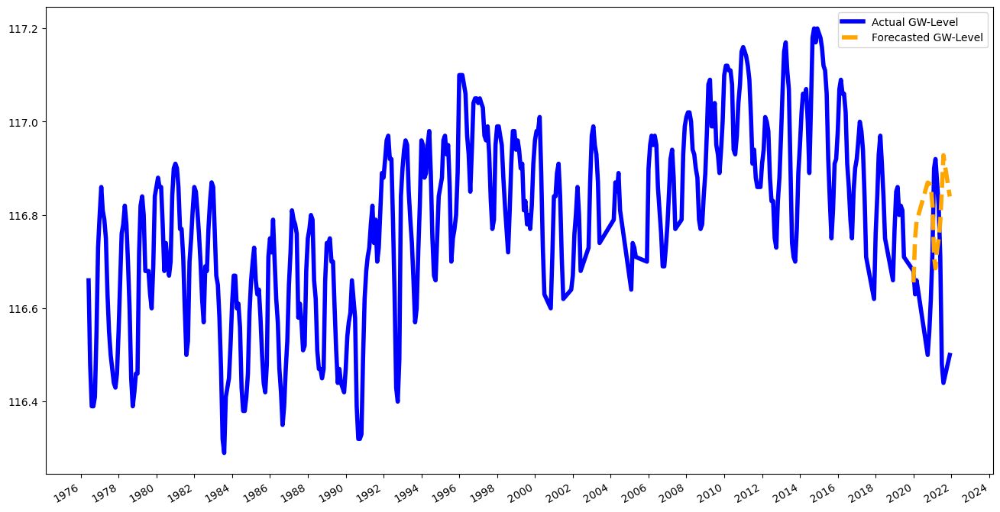



N train dates: 269
1997-06-01 00:00:00 till 2019-10-01 00:00:00
N forecast dates (horizon): 26
2019-11-01 00:00:00 till 2021-12-01 00:00:00
> SMAPE Score: 0.171465
First timepoint: 1997-06-01 00:00:00
Last timepoint:	 2021-12-01 00:00:00


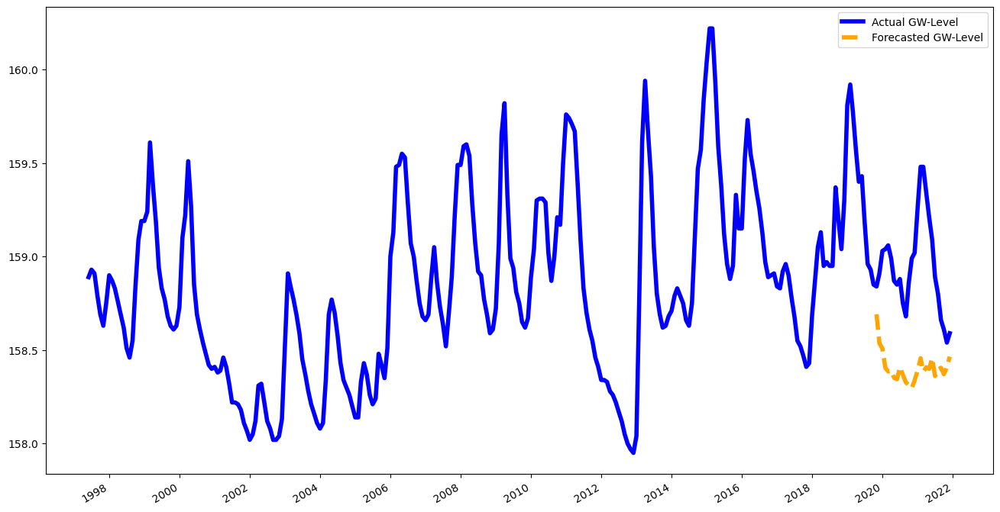



N train dates: 597
1969-11-01 00:00:00 till 2019-10-01 00:00:00
N forecast dates (horizon): 26
2019-11-01 00:00:00 till 2021-12-01 00:00:00
> SMAPE Score: 0.202282
First timepoint: 1969-11-01 00:00:00
Last timepoint:	 2021-12-01 00:00:00


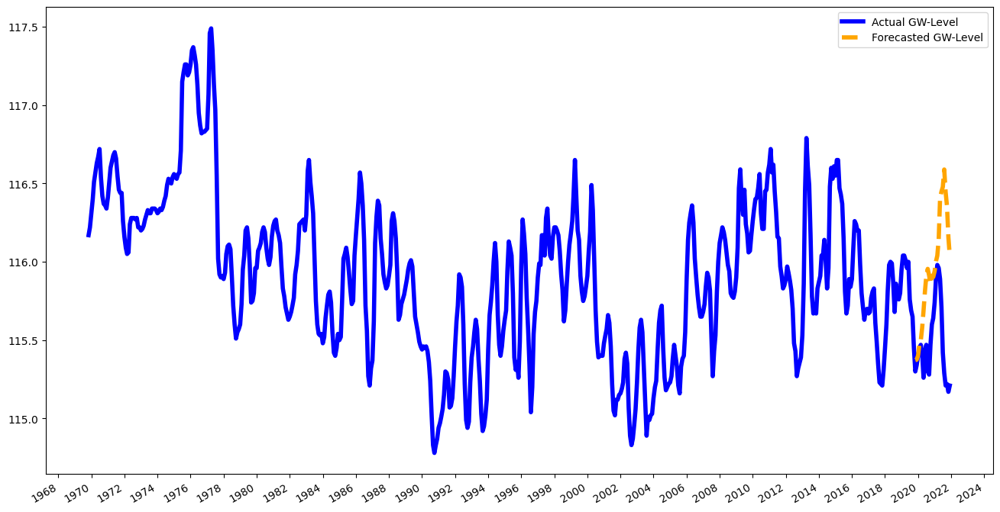



N train dates: 644
1966-01-01 00:00:00 till 2019-10-01 00:00:00
N forecast dates (horizon): 26
2019-11-01 00:00:00 till 2021-12-01 00:00:00
> SMAPE Score: 0.099278
First timepoint: 1966-01-01 00:00:00
Last timepoint:	 2021-12-01 00:00:00


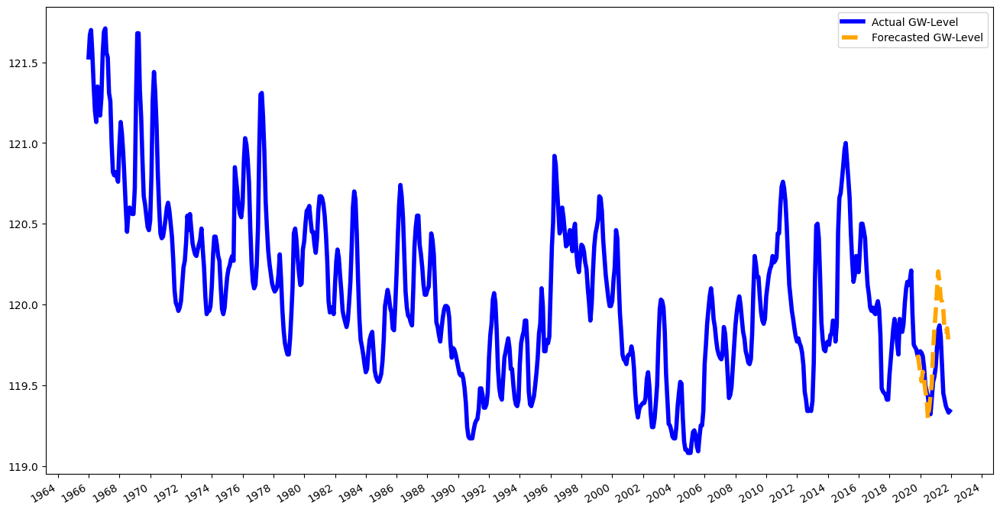



N train dates: 199
2002-11-01 00:00:00 till 2019-10-01 00:00:00
N forecast dates (horizon): 26
2019-11-01 00:00:00 till 2021-12-01 00:00:00
> SMAPE Score: 0.088458
First timepoint: 2002-11-01 00:00:00
Last timepoint:	 2021-12-01 00:00:00


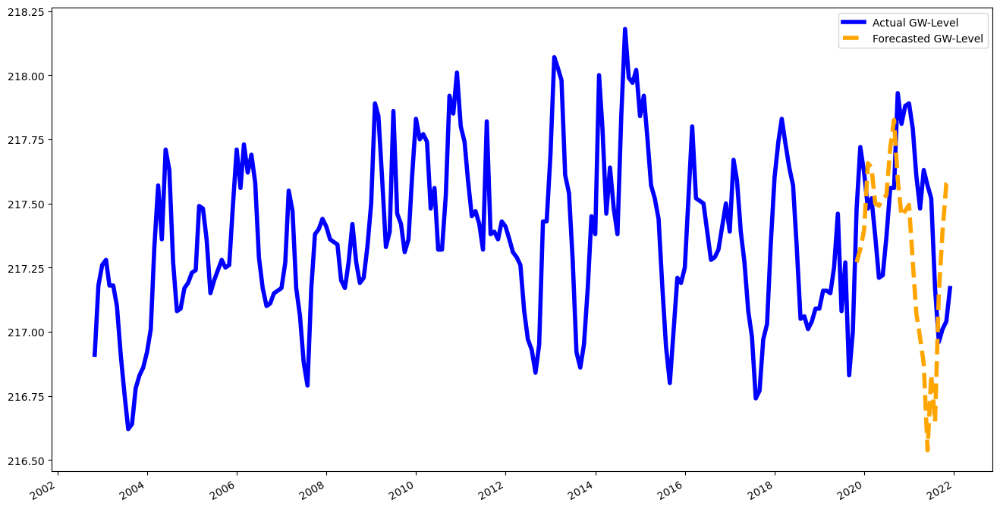



N train dates: 14
2018-09-01 00:00:00 till 2019-10-01 00:00:00
N forecast dates (horizon): 26
2019-11-01 00:00:00 till 2021-12-01 00:00:00


/home/user/miniconda3/lib/python3.9/site-packages/mlforecast/core.py:402: UserWarning: The following series were dropped completely due to the transformations and features: [353755].
These series won't show up if you use `MLForecast.forecast_fitted_values()`.
You can set `dropna=False` or use transformations that require less samples to mitigate this
  warnings.warn(


> SMAPE Score: 100.0
First timepoint: 2018-09-01 00:00:00
Last timepoint:	 2021-12-01 00:00:00


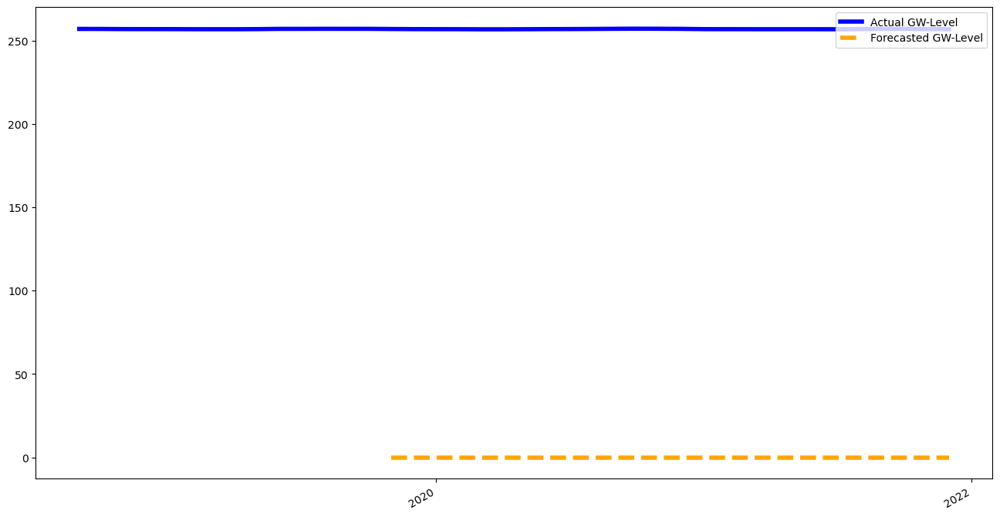



N train dates: 305
1994-06-01 00:00:00 till 2019-10-01 00:00:00
N forecast dates (horizon): 26
2019-11-01 00:00:00 till 2021-12-01 00:00:00
> SMAPE Score: 0.0866
First timepoint: 1994-06-01 00:00:00
Last timepoint:	 2021-12-01 00:00:00


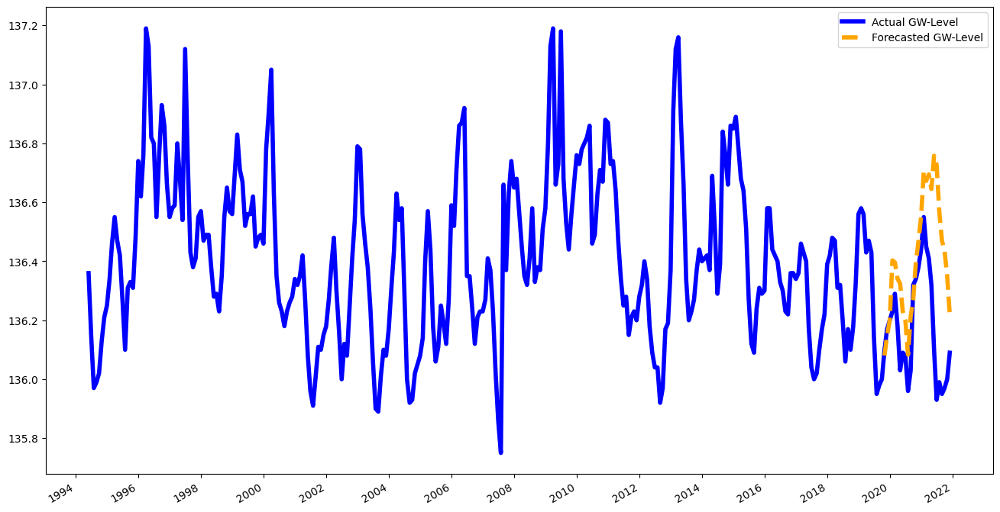



N train dates: 33
2017-02-01 00:00:00 till 2019-10-01 00:00:00
N forecast dates (horizon): 26
2019-11-01 00:00:00 till 2021-12-01 00:00:00
> SMAPE Score: 0.099662
First timepoint: 2017-02-01 00:00:00
Last timepoint:	 2021-12-01 00:00:00


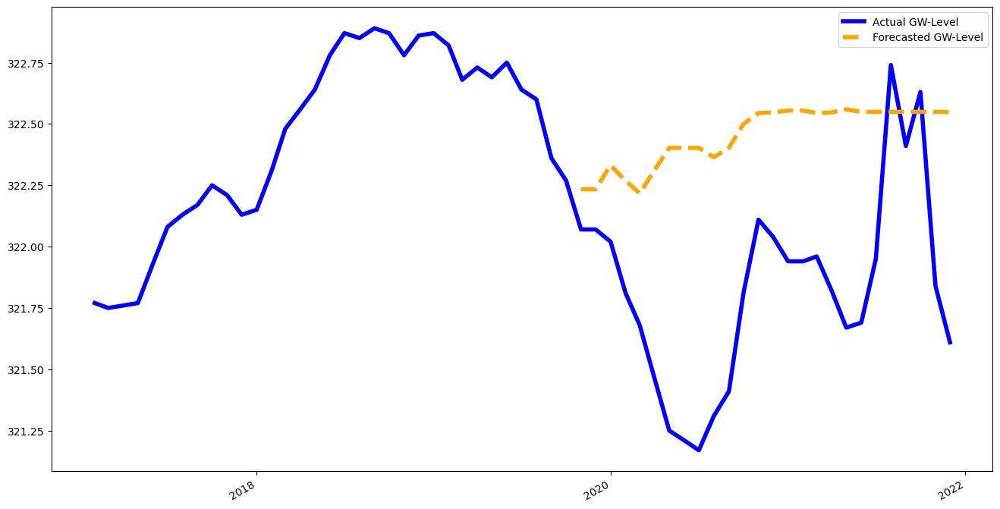



N train dates: 552
1973-11-01 00:00:00 till 2019-10-01 00:00:00
N forecast dates (horizon): 26
2019-11-01 00:00:00 till 2021-12-01 00:00:00
> SMAPE Score: 0.043958
First timepoint: 1973-11-01 00:00:00
Last timepoint:	 2021-12-01 00:00:00


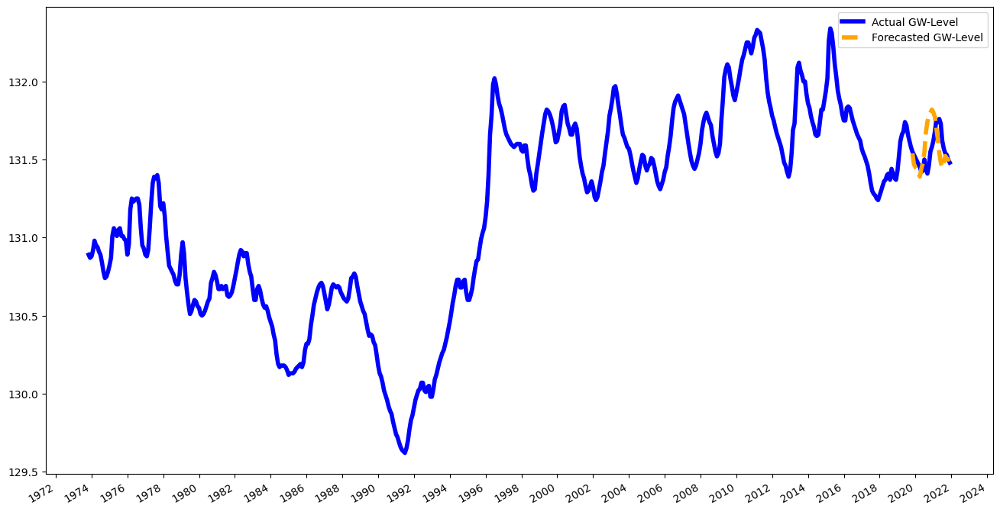



N train dates: 607
1969-01-01 00:00:00 till 2019-10-01 00:00:00
N forecast dates (horizon): 26
2019-11-01 00:00:00 till 2021-12-01 00:00:00
> SMAPE Score: 0.120614
First timepoint: 1969-01-01 00:00:00
Last timepoint:	 2021-12-01 00:00:00


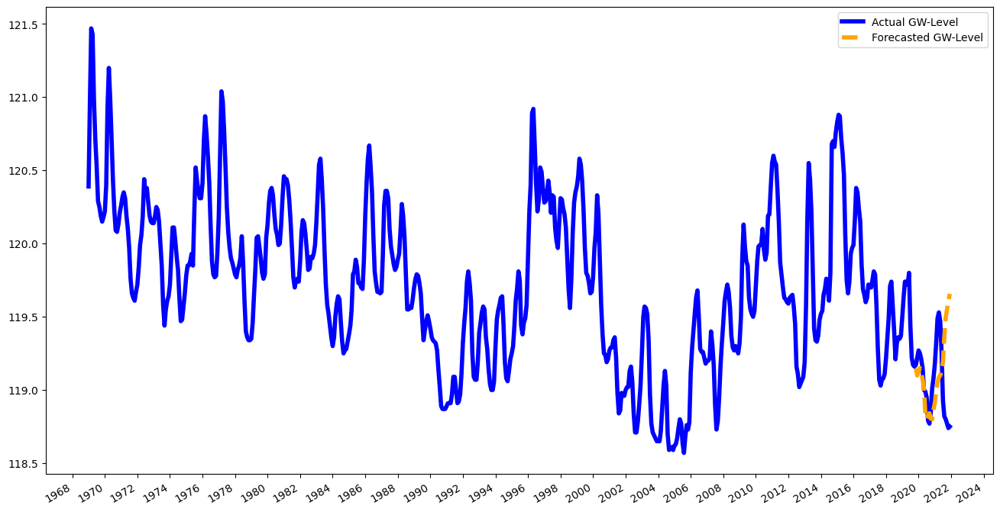



N train dates: 146
2007-09-01 00:00:00 till 2019-10-01 00:00:00
N forecast dates (horizon): 26
2019-11-01 00:00:00 till 2021-12-01 00:00:00
> SMAPE Score: 0.229893
First timepoint: 2007-09-01 00:00:00
Last timepoint:	 2021-12-01 00:00:00


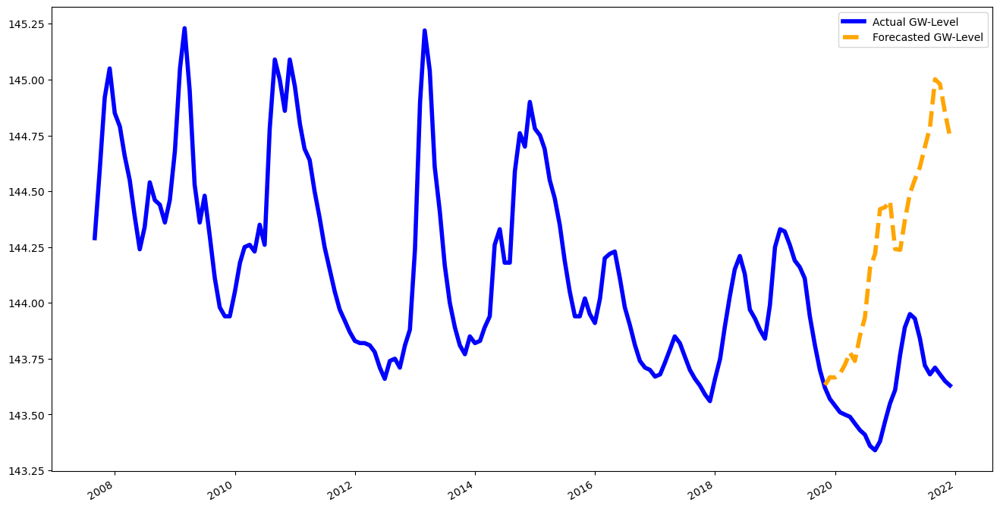



N train dates: 667
1964-04-01 00:00:00 till 2019-10-01 00:00:00
N forecast dates (horizon): 26
2019-11-01 00:00:00 till 2021-12-01 00:00:00
> SMAPE Score: 0.132676
First timepoint: 1964-04-01 00:00:00
Last timepoint:	 2021-12-01 00:00:00


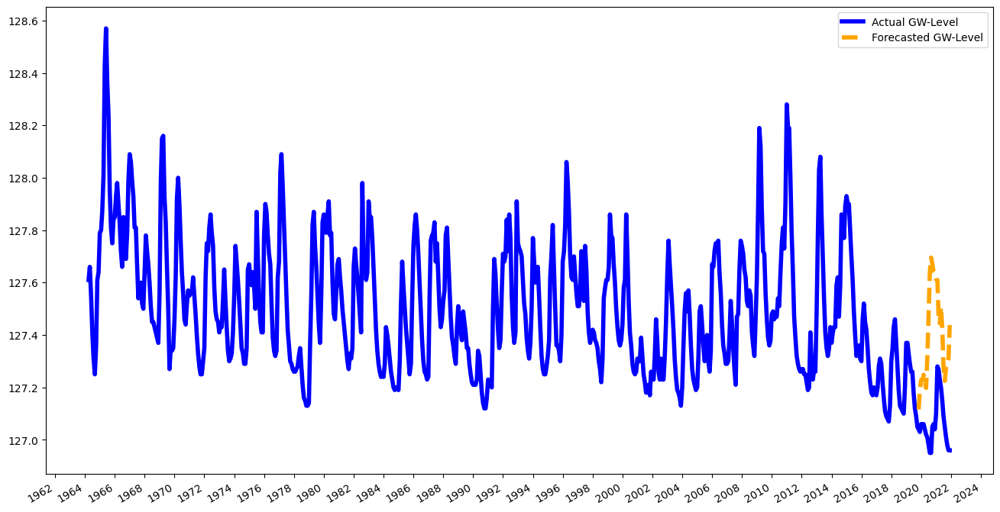



N train dates: 298
1995-01-01 00:00:00 till 2019-10-01 00:00:00
N forecast dates (horizon): 26
2019-11-01 00:00:00 till 2021-12-01 00:00:00
> SMAPE Score: 0.09073
First timepoint: 1995-01-01 00:00:00
Last timepoint:	 2021-12-01 00:00:00


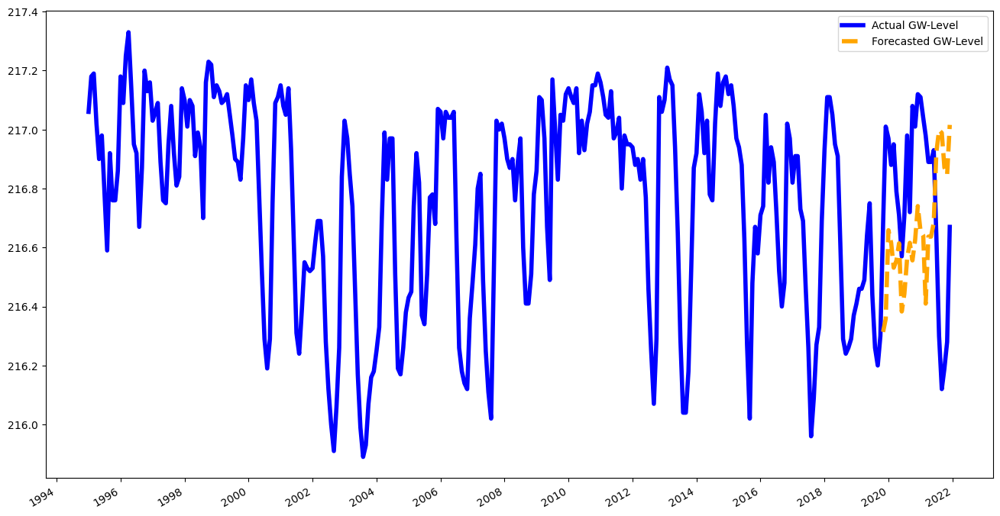



N train dates: 229
2000-10-01 00:00:00 till 2019-10-01 00:00:00
N forecast dates (horizon): 26
2019-11-01 00:00:00 till 2021-12-01 00:00:00
> SMAPE Score: 0.020068
First timepoint: 2000-10-01 00:00:00
Last timepoint:	 2021-12-01 00:00:00


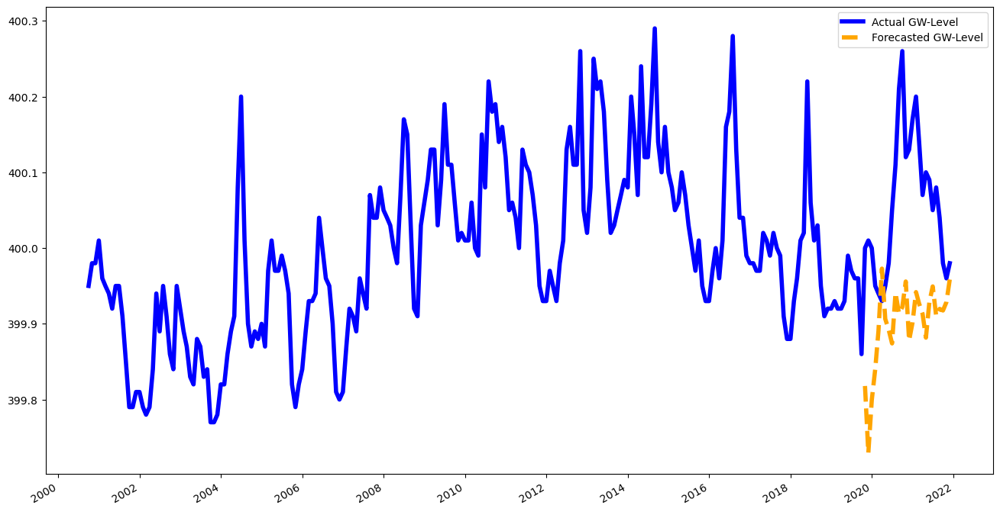



N train dates: 200
2003-01-01 00:00:00 till 2019-10-01 00:00:00
N forecast dates (horizon): 26
2019-11-01 00:00:00 till 2021-12-01 00:00:00
> SMAPE Score: 0.170918
First timepoint: 2003-01-01 00:00:00
Last timepoint:	 2021-12-01 00:00:00


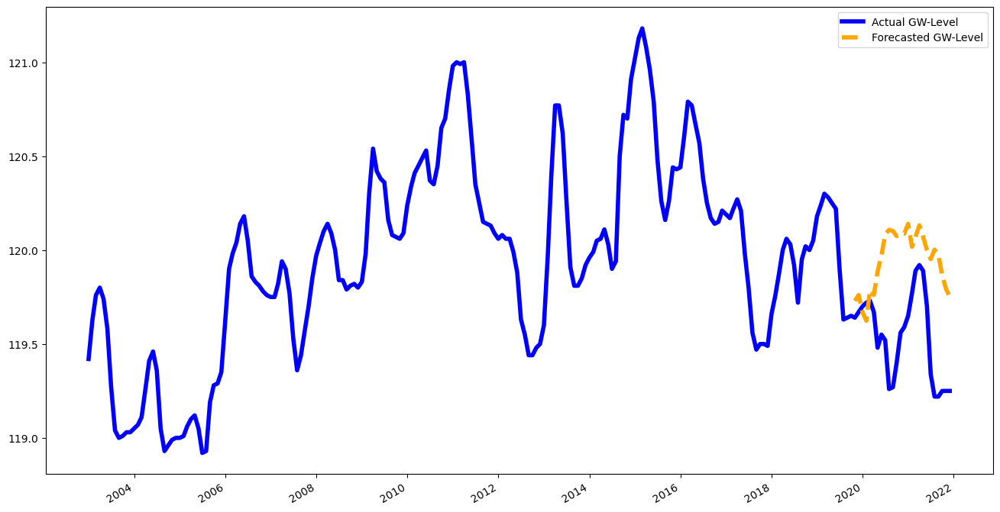



N train dates: 303
1994-02-01 00:00:00 till 2019-10-01 00:00:00
N forecast dates (horizon): 26
2019-11-01 00:00:00 till 2021-12-01 00:00:00
> SMAPE Score: 0.045104
First timepoint: 1994-02-01 00:00:00
Last timepoint:	 2021-12-01 00:00:00


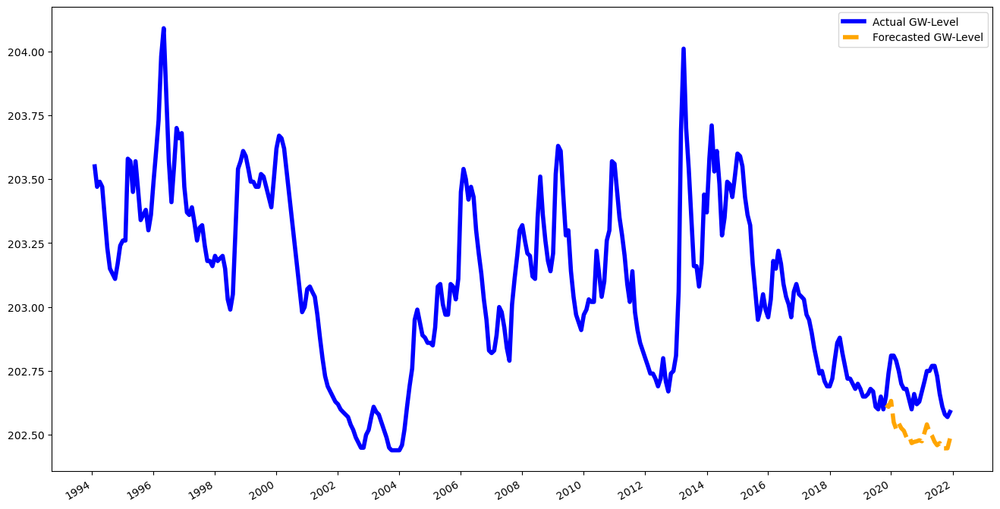



N train dates: 146
2007-09-01 00:00:00 till 2019-10-01 00:00:00
N forecast dates (horizon): 26
2019-11-01 00:00:00 till 2021-12-01 00:00:00
> SMAPE Score: 0.182517
First timepoint: 2007-09-01 00:00:00
Last timepoint:	 2021-12-01 00:00:00


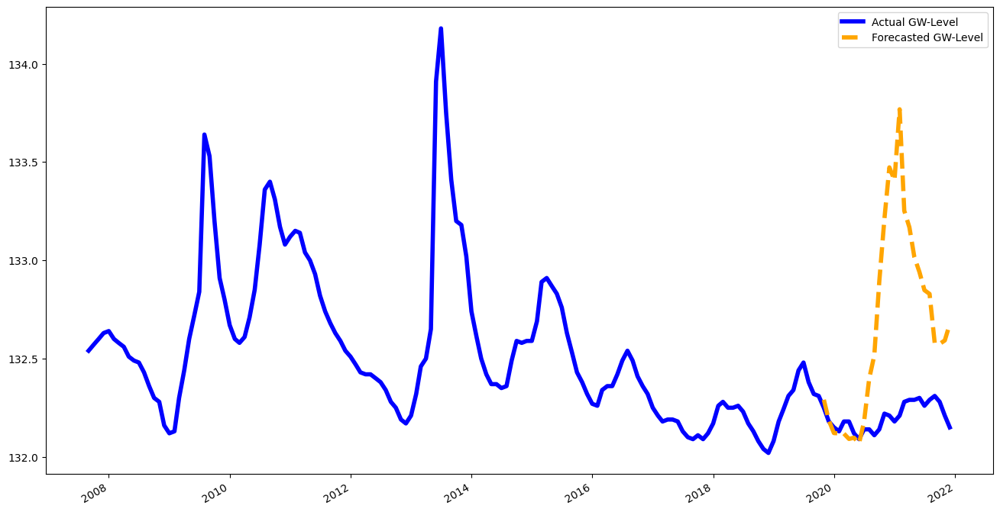



N train dates: 53
2015-01-01 00:00:00 till 2019-10-01 00:00:00
N forecast dates (horizon): 26
2019-11-01 00:00:00 till 2021-12-01 00:00:00
> SMAPE Score: 0.091989
First timepoint: 2015-01-01 00:00:00
Last timepoint:	 2021-12-01 00:00:00


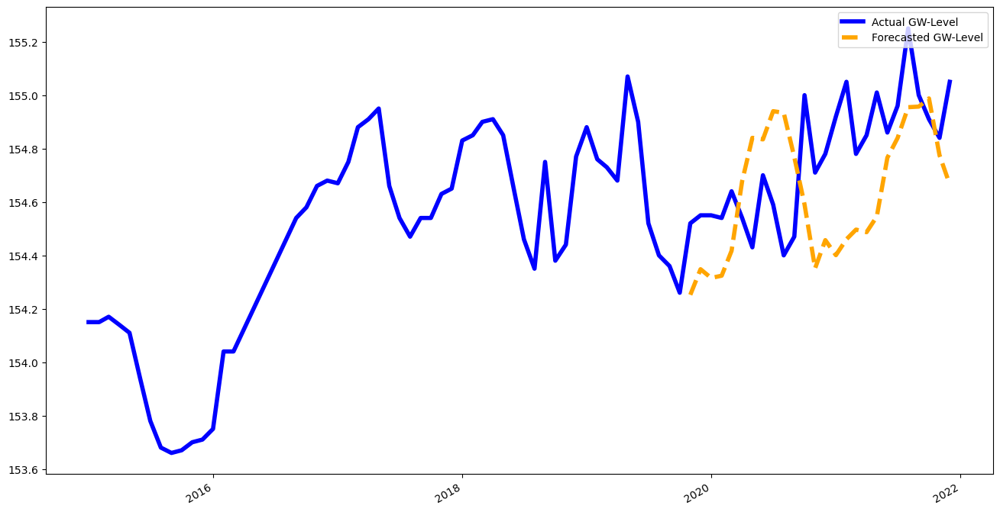



N train dates: 14
2018-09-01 00:00:00 till 2019-10-01 00:00:00
N forecast dates (horizon): 26
2019-11-01 00:00:00 till 2021-12-01 00:00:00


/home/user/miniconda3/lib/python3.9/site-packages/mlforecast/core.py:402: UserWarning: The following series were dropped completely due to the transformations and features: [353722].
These series won't show up if you use `MLForecast.forecast_fitted_values()`.
You can set `dropna=False` or use transformations that require less samples to mitigate this
  warnings.warn(


> SMAPE Score: 100.0
First timepoint: 2018-09-01 00:00:00
Last timepoint:	 2021-12-01 00:00:00


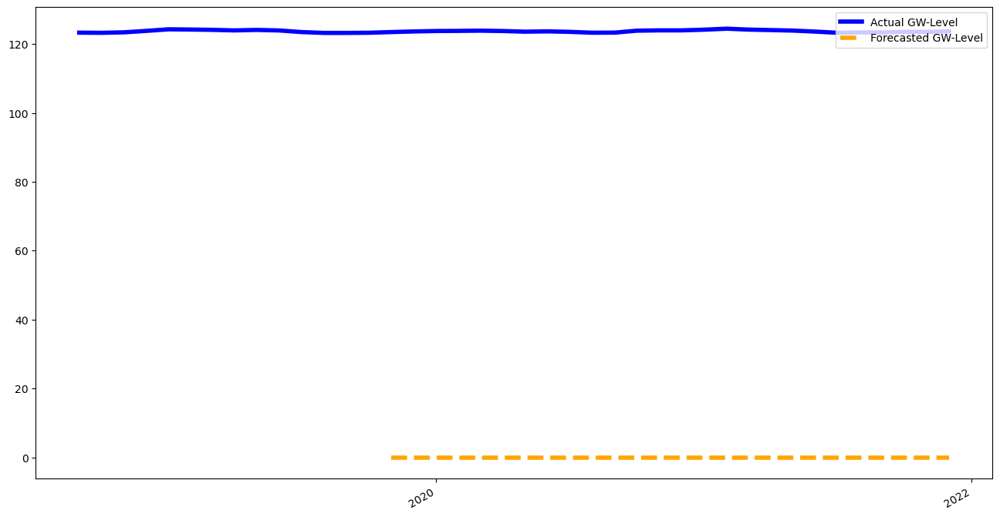



N train dates: 537
1975-02-01 00:00:00 till 2019-10-01 00:00:00
N forecast dates (horizon): 26
2019-11-01 00:00:00 till 2021-12-01 00:00:00
> SMAPE Score: 0.041382
First timepoint: 1975-02-01 00:00:00
Last timepoint:	 2021-12-01 00:00:00


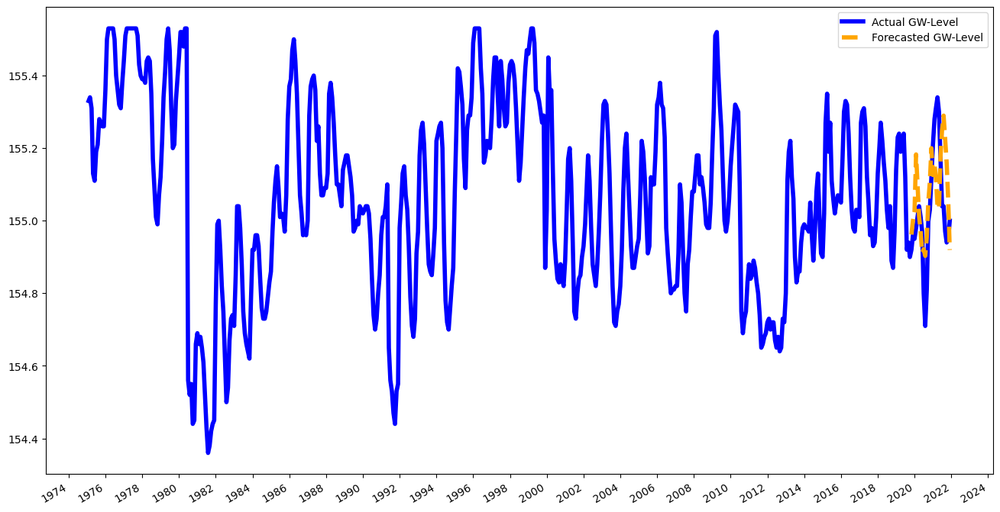



N train dates: 127
2009-03-01 00:00:00 till 2019-10-01 00:00:00
N forecast dates (horizon): 26
2019-11-01 00:00:00 till 2021-12-01 00:00:00
> SMAPE Score: 0.026395
First timepoint: 2009-03-01 00:00:00
Last timepoint:	 2021-12-01 00:00:00


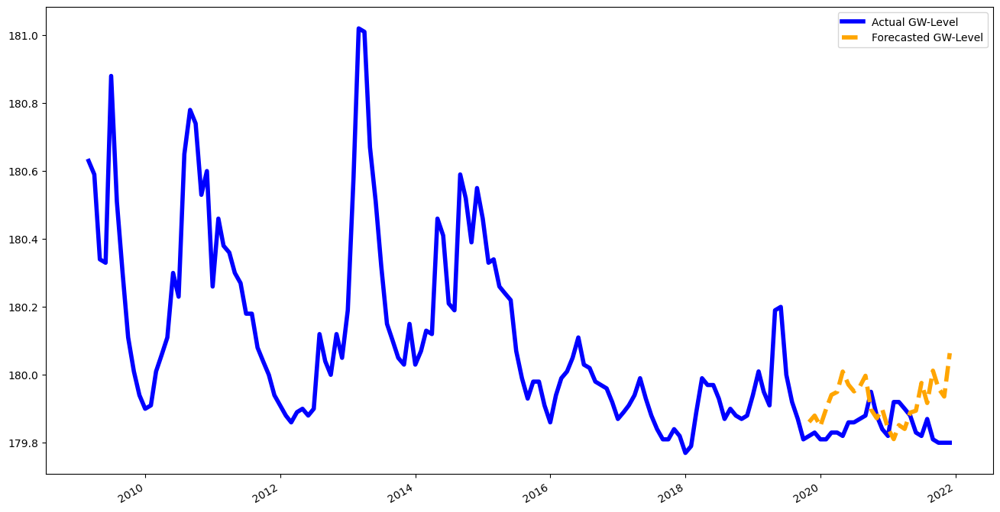



N train dates: 768
1955-04-01 00:00:00 till 2019-03-01 00:00:00
N forecast dates (horizon): 24
2020-01-01 00:00:00 till 2021-12-01 00:00:00
> SMAPE Score: 0.22767
First timepoint: 1955-04-01 00:00:00
Last timepoint:	 2021-12-01 00:00:00


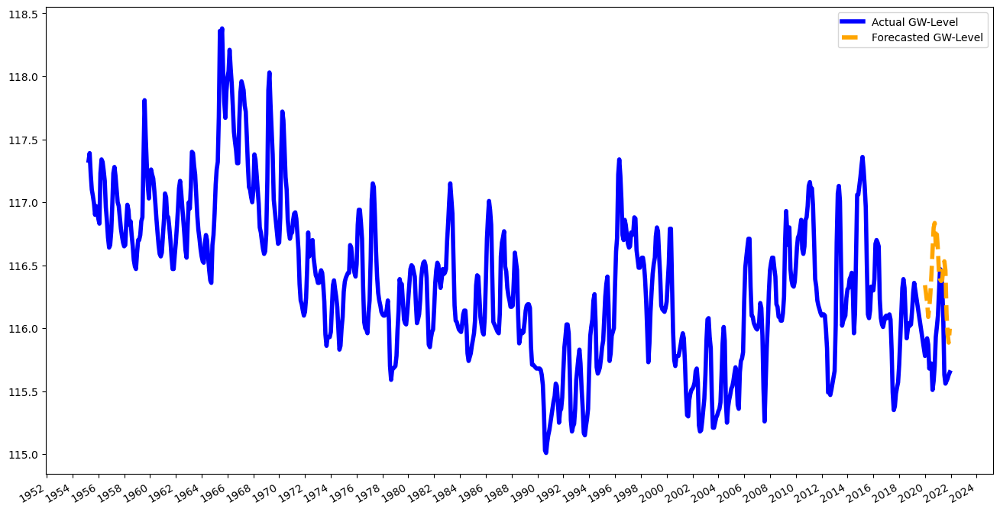



N train dates: 238
2000-01-01 00:00:00 till 2019-10-01 00:00:00
N forecast dates (horizon): 24
2019-11-01 00:00:00 till 2021-10-01 00:00:00
> SMAPE Score: 0.125711
First timepoint: 2000-01-01 00:00:00
Last timepoint:	 2021-10-01 00:00:00


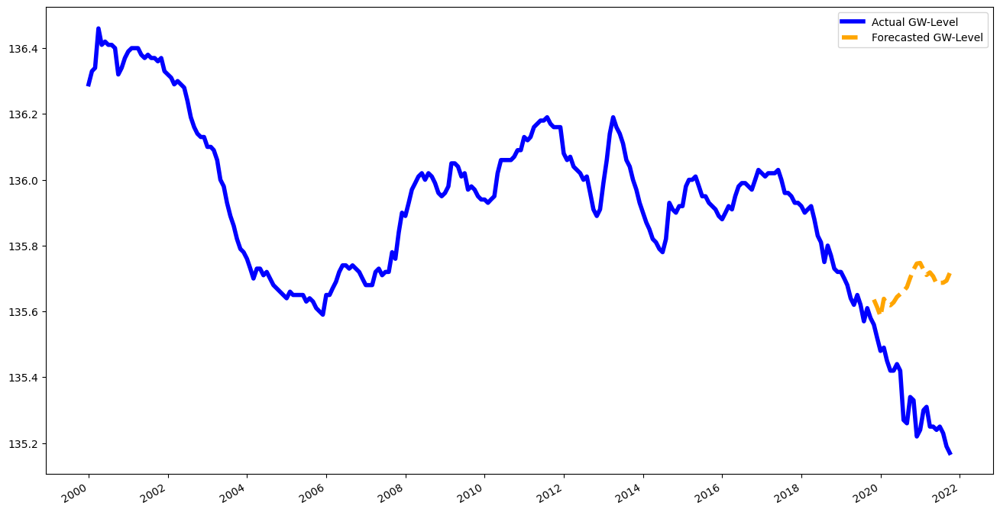



N train dates: 274
1997-01-01 00:00:00 till 2019-10-01 00:00:00
N forecast dates (horizon): 26
2019-11-01 00:00:00 till 2021-12-01 00:00:00
> SMAPE Score: 0.063996
First timepoint: 1997-01-01 00:00:00
Last timepoint:	 2021-12-01 00:00:00


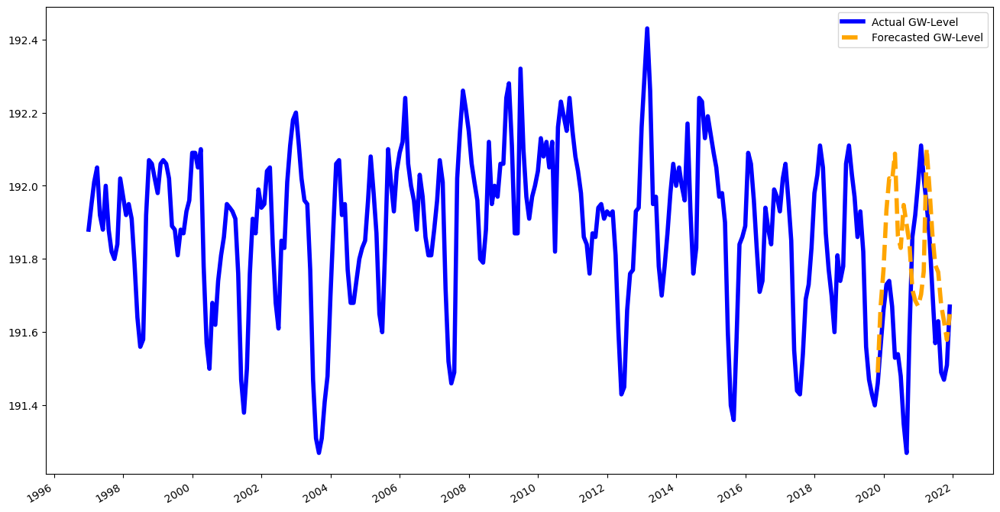



N train dates: 313
1993-01-01 00:00:00 till 2019-10-01 00:00:00
N forecast dates (horizon): 26
2019-11-01 00:00:00 till 2021-12-01 00:00:00
> SMAPE Score: 0.046834
First timepoint: 1993-01-01 00:00:00
Last timepoint:	 2021-12-01 00:00:00


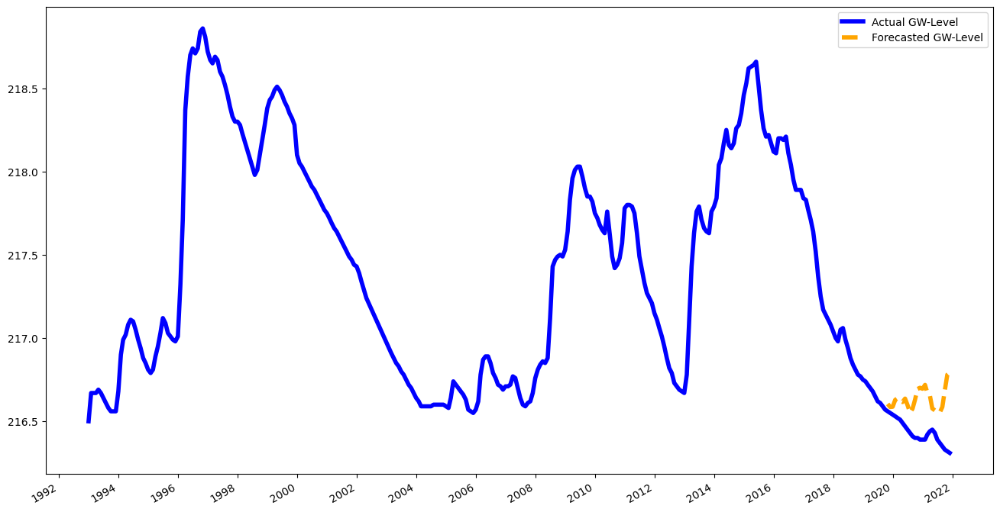



N train dates: 538
1975-01-01 00:00:00 till 2019-10-01 00:00:00
N forecast dates (horizon): 26
2019-11-01 00:00:00 till 2021-12-01 00:00:00
> SMAPE Score: 0.049642
First timepoint: 1975-01-01 00:00:00
Last timepoint:	 2021-12-01 00:00:00


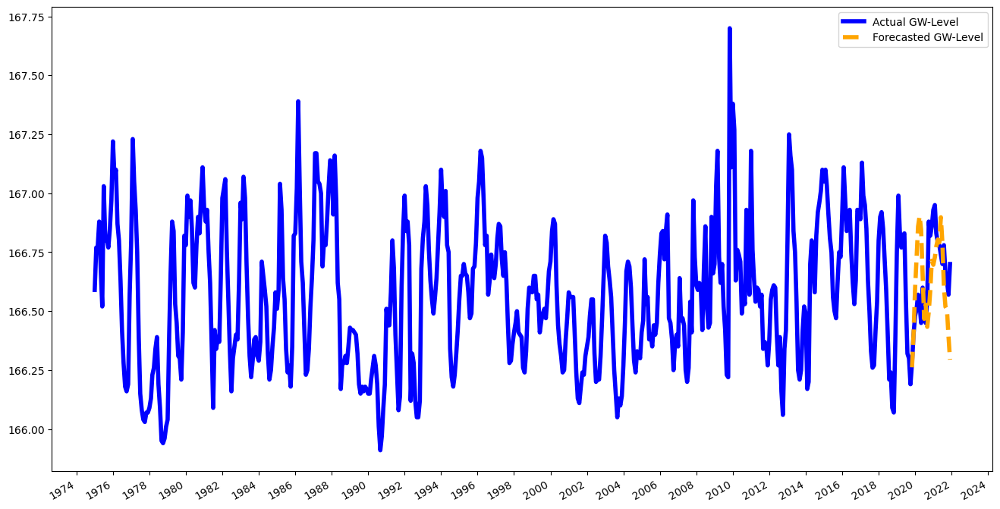



N train dates: 318
1993-01-01 00:00:00 till 2019-10-01 00:00:00
N forecast dates (horizon): 26
2019-11-01 00:00:00 till 2021-12-01 00:00:00
> SMAPE Score: 0.044778
First timepoint: 1993-01-01 00:00:00
Last timepoint:	 2021-12-01 00:00:00


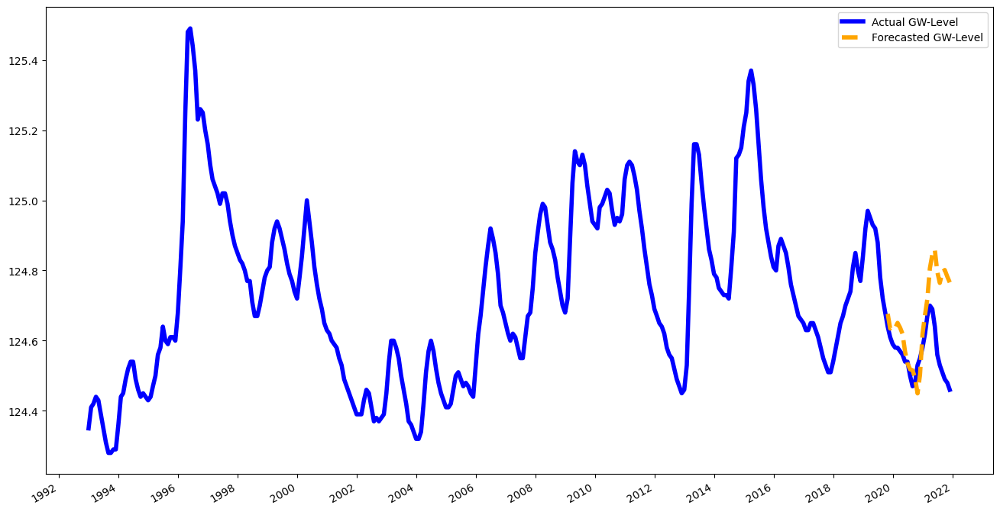



N train dates: 792
1953-11-01 00:00:00 till 2019-10-01 00:00:00
N forecast dates (horizon): 26
2019-11-01 00:00:00 till 2021-12-01 00:00:00
> SMAPE Score: 0.247436
First timepoint: 1953-11-01 00:00:00
Last timepoint:	 2021-12-01 00:00:00


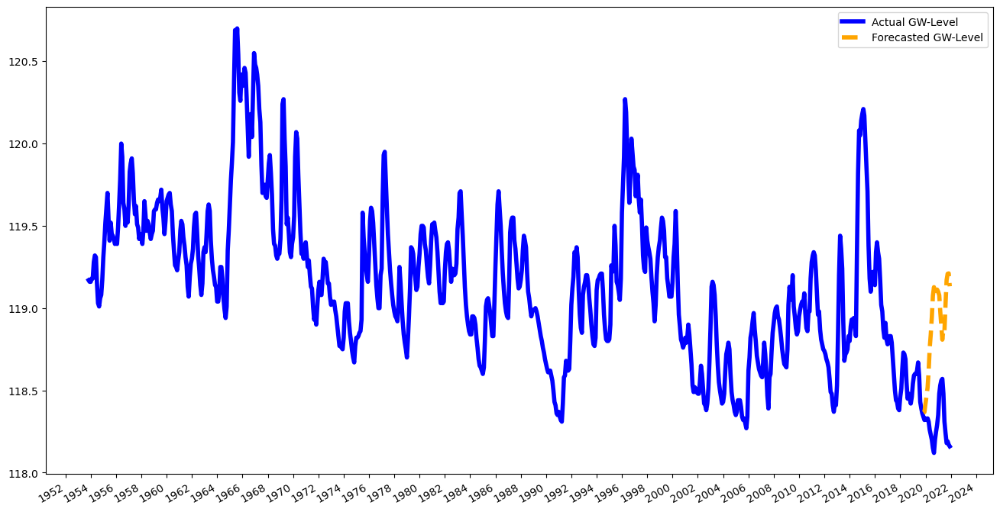



N train dates: 286
1996-01-01 00:00:00 till 2019-10-01 00:00:00
N forecast dates (horizon): 26
2019-11-01 00:00:00 till 2021-12-01 00:00:00
> SMAPE Score: 0.135313
First timepoint: 1996-01-01 00:00:00
Last timepoint:	 2021-12-01 00:00:00


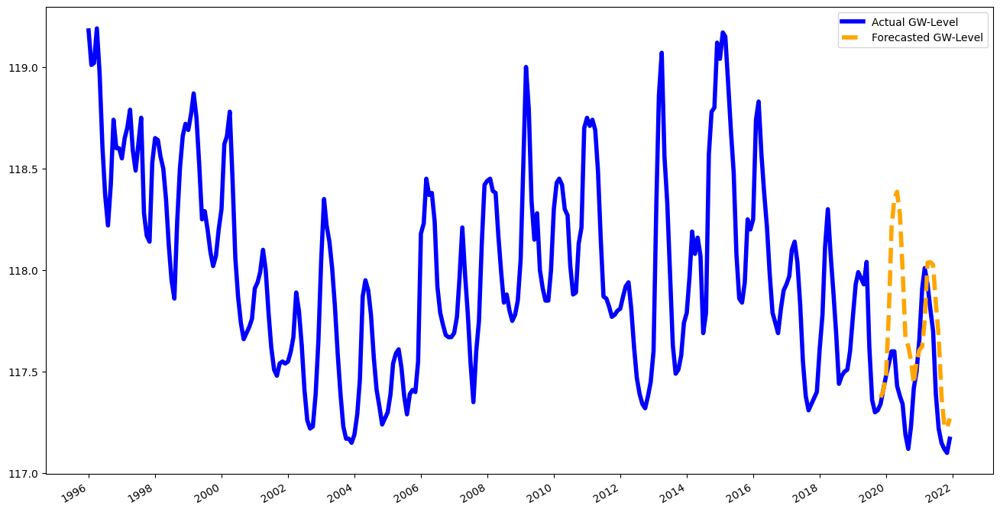



N train dates: 308
1994-01-01 00:00:00 till 2019-10-01 00:00:00
N forecast dates (horizon): 26
2019-11-01 00:00:00 till 2021-12-01 00:00:00
> SMAPE Score: 0.01436
First timepoint: 1994-01-01 00:00:00
Last timepoint:	 2021-12-01 00:00:00


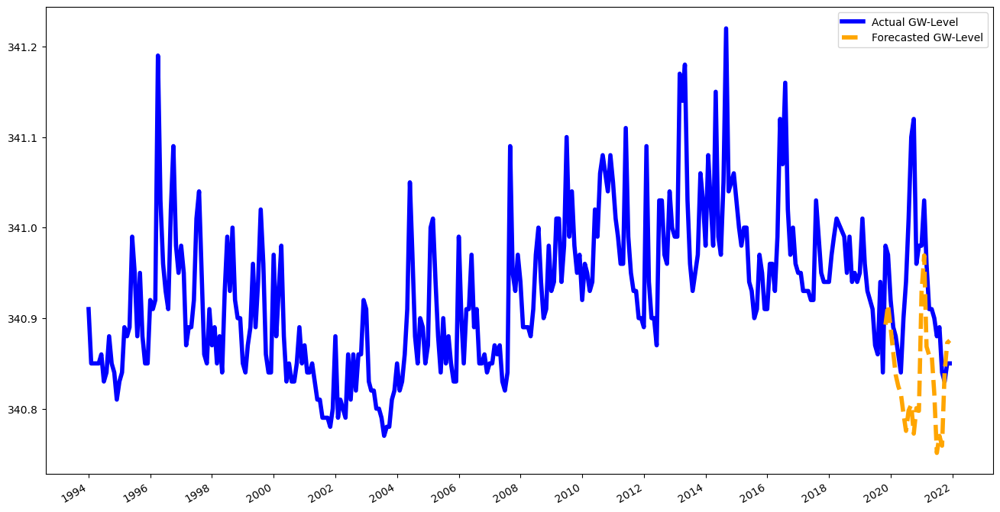



N train dates: 452
1982-01-01 00:00:00 till 2019-10-01 00:00:00
N forecast dates (horizon): 26
2019-11-01 00:00:00 till 2021-12-01 00:00:00
> SMAPE Score: 0.170328
First timepoint: 1982-01-01 00:00:00
Last timepoint:	 2021-12-01 00:00:00


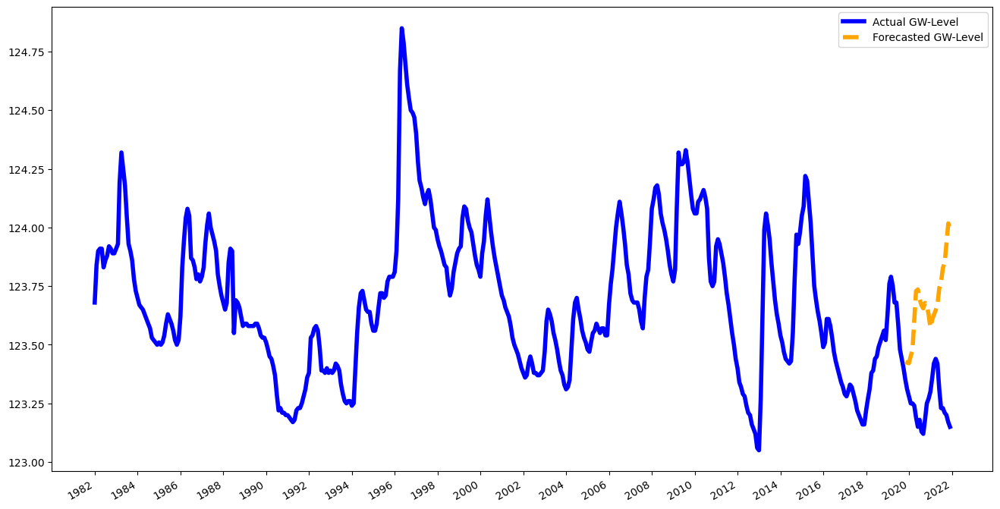



N train dates: 177
2005-01-01 00:00:00 till 2019-10-01 00:00:00
N forecast dates (horizon): 26
2019-11-01 00:00:00 till 2021-12-01 00:00:00
> SMAPE Score: 0.100089
First timepoint: 2005-01-01 00:00:00
Last timepoint:	 2021-12-01 00:00:00


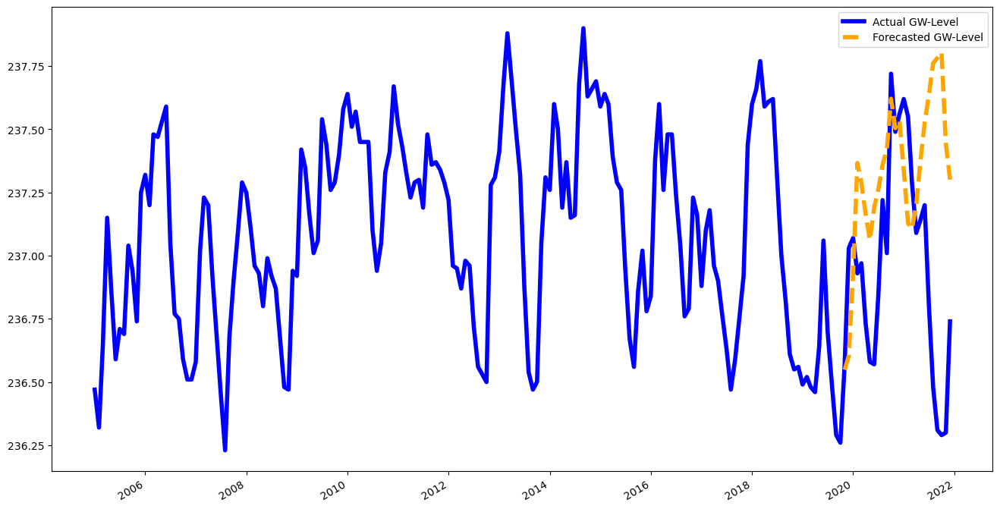



N train dates: 688
1962-07-01 00:00:00 till 2019-10-01 00:00:00
N forecast dates (horizon): 25
2019-11-01 00:00:00 till 2021-12-01 00:00:00
> SMAPE Score: 0.071679
First timepoint: 1962-07-01 00:00:00
Last timepoint:	 2021-12-01 00:00:00


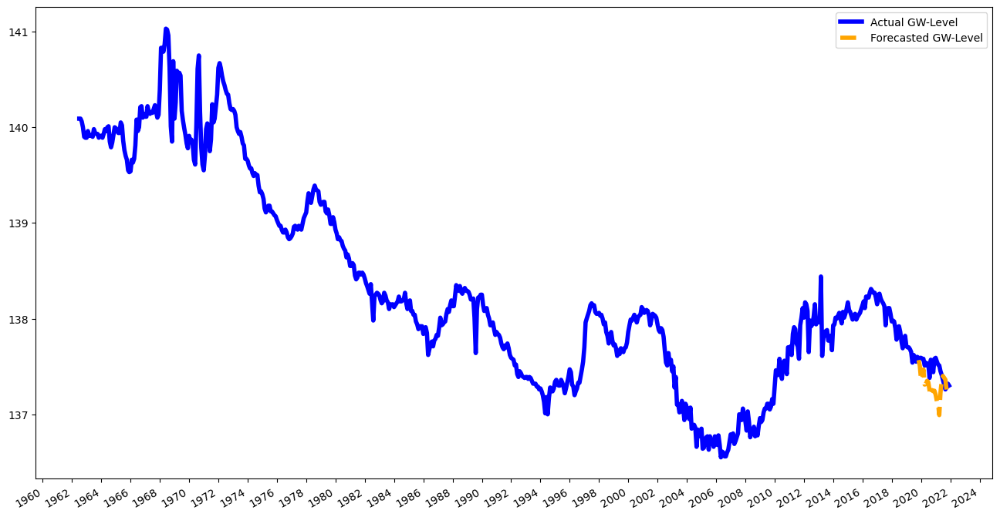



N train dates: 172
2005-03-01 00:00:00 till 2019-10-01 00:00:00
N forecast dates (horizon): 26
2019-11-01 00:00:00 till 2021-12-01 00:00:00
> SMAPE Score: 0.022161
First timepoint: 2005-03-01 00:00:00
Last timepoint:	 2021-12-01 00:00:00


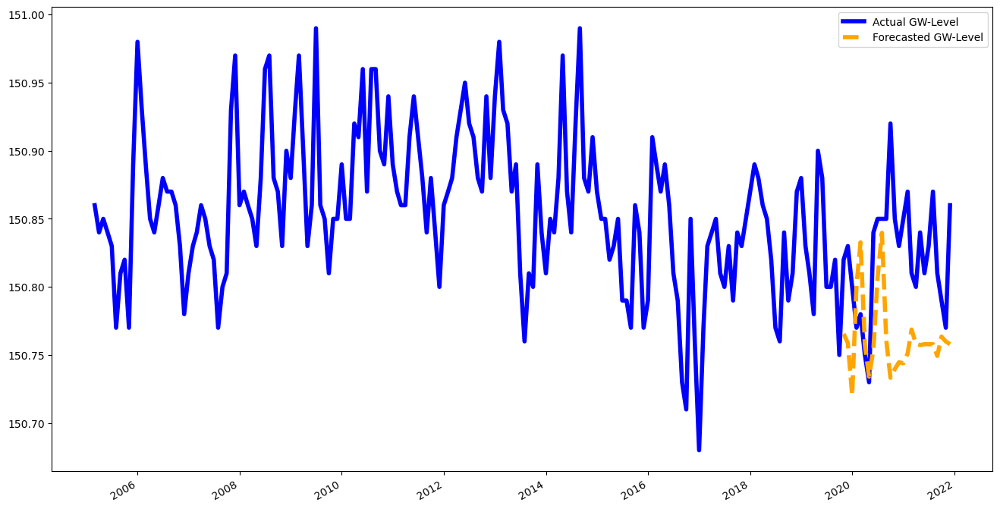



N train dates: 266
1996-01-01 00:00:00 till 2019-10-01 00:00:00
N forecast dates (horizon): 26
2019-11-01 00:00:00 till 2021-12-01 00:00:00
> SMAPE Score: 0.061592
First timepoint: 1996-01-01 00:00:00
Last timepoint:	 2021-12-01 00:00:00


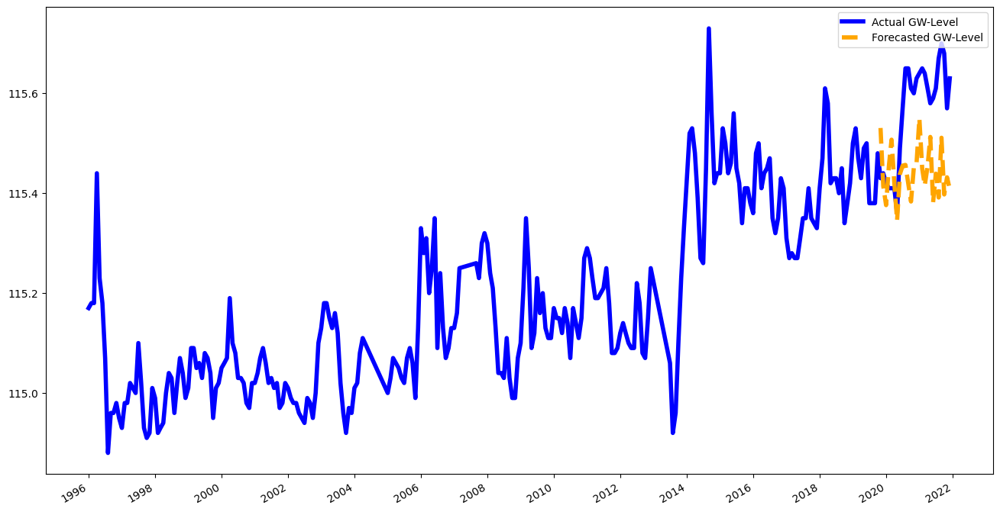



N train dates: 298
1995-01-01 00:00:00 till 2019-10-01 00:00:00
N forecast dates (horizon): 26
2019-11-01 00:00:00 till 2021-12-01 00:00:00
> SMAPE Score: 0.148848
First timepoint: 1995-01-01 00:00:00
Last timepoint:	 2021-12-01 00:00:00


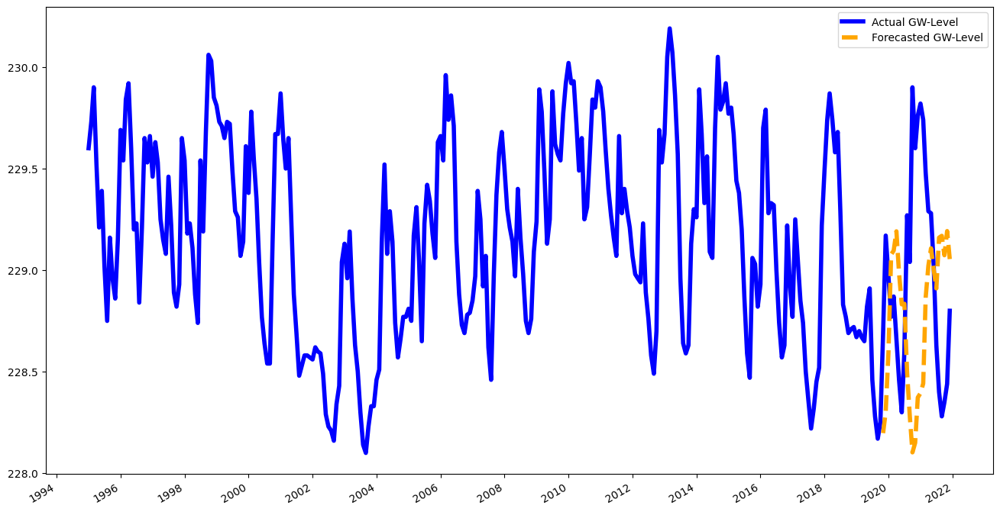



N train dates: 212
2002-01-01 00:00:00 till 2019-10-01 00:00:00
N forecast dates (horizon): 26
2019-11-01 00:00:00 till 2021-12-01 00:00:00
> SMAPE Score: 0.218157
First timepoint: 2002-01-01 00:00:00
Last timepoint:	 2021-12-01 00:00:00


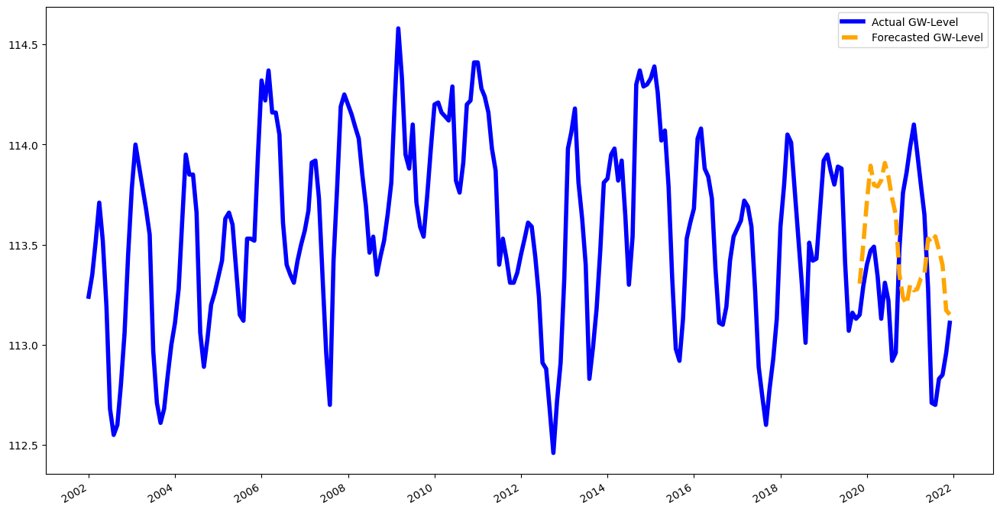



N train dates: 167
2005-12-01 00:00:00 till 2019-10-01 00:00:00
N forecast dates (horizon): 26
2019-11-01 00:00:00 till 2021-12-01 00:00:00
> SMAPE Score: 0.320314
First timepoint: 2005-12-01 00:00:00
Last timepoint:	 2021-12-01 00:00:00


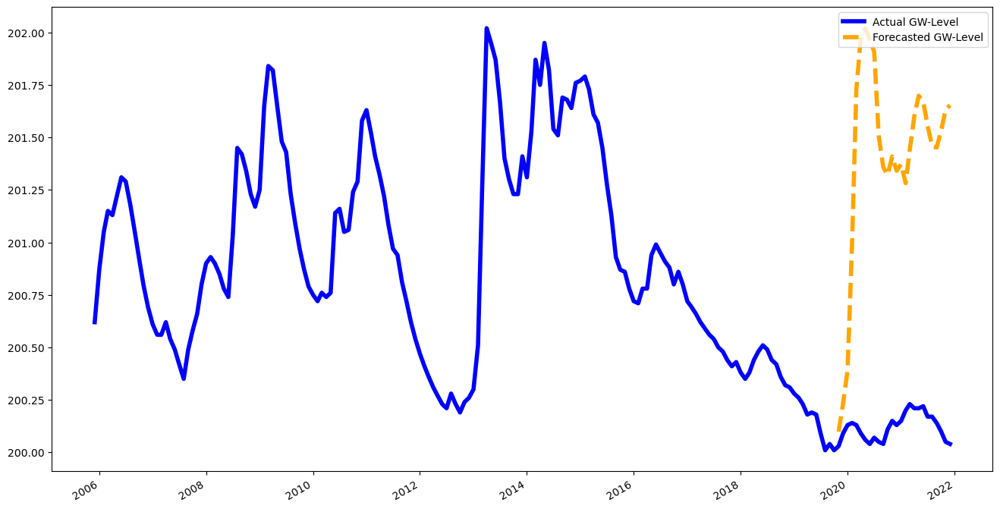



N train dates: 293
1995-05-01 00:00:00 till 2019-10-01 00:00:00
N forecast dates (horizon): 26
2019-11-01 00:00:00 till 2021-12-01 00:00:00
> SMAPE Score: 0.306807
First timepoint: 1995-05-01 00:00:00
Last timepoint:	 2021-12-01 00:00:00


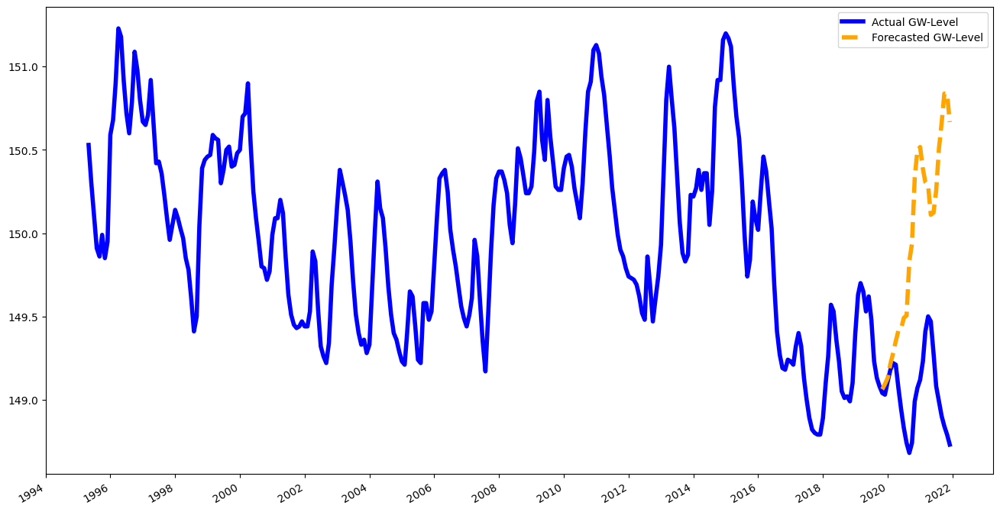



N train dates: 166
2006-01-01 00:00:00 till 2019-10-01 00:00:00
N forecast dates (horizon): 26
2019-11-01 00:00:00 till 2021-12-01 00:00:00
> SMAPE Score: 0.112477
First timepoint: 2006-01-01 00:00:00
Last timepoint:	 2021-12-01 00:00:00


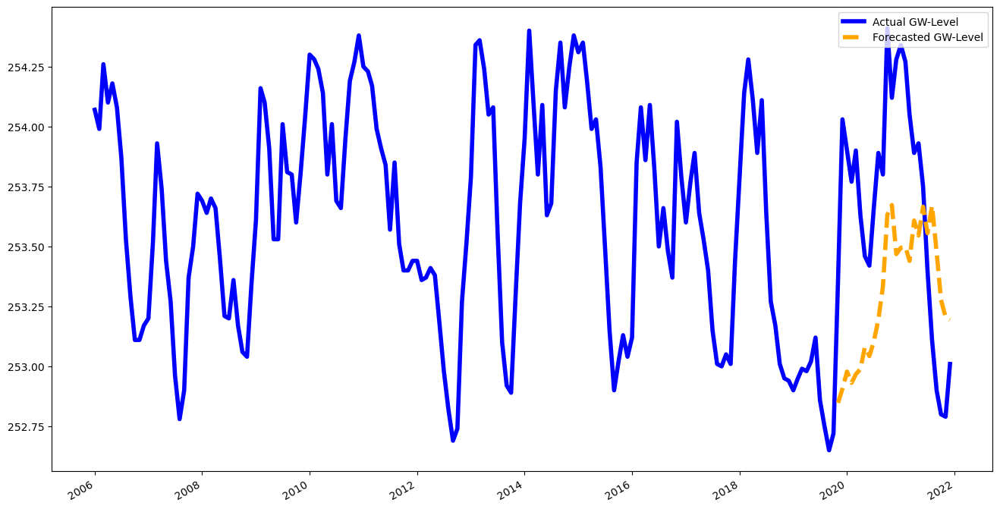



N train dates: 377
1988-01-01 00:00:00 till 2019-10-01 00:00:00
N forecast dates (horizon): 26
2019-11-01 00:00:00 till 2021-12-01 00:00:00
> SMAPE Score: 0.081751
First timepoint: 1988-01-01 00:00:00
Last timepoint:	 2021-12-01 00:00:00


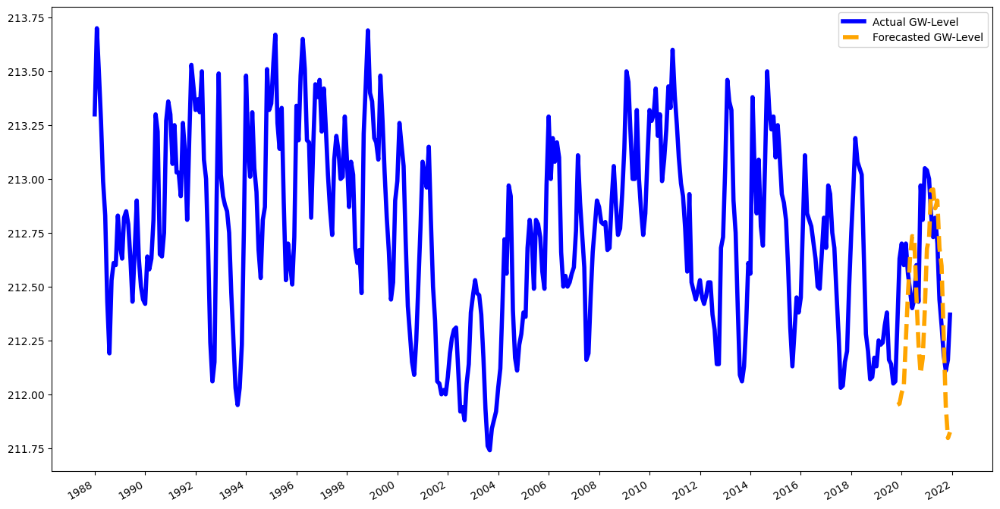



N train dates: 165
2006-01-01 00:00:00 till 2019-10-01 00:00:00
N forecast dates (horizon): 26
2019-11-01 00:00:00 till 2021-12-01 00:00:00
> SMAPE Score: 0.068191
First timepoint: 2006-01-01 00:00:00
Last timepoint:	 2021-12-01 00:00:00


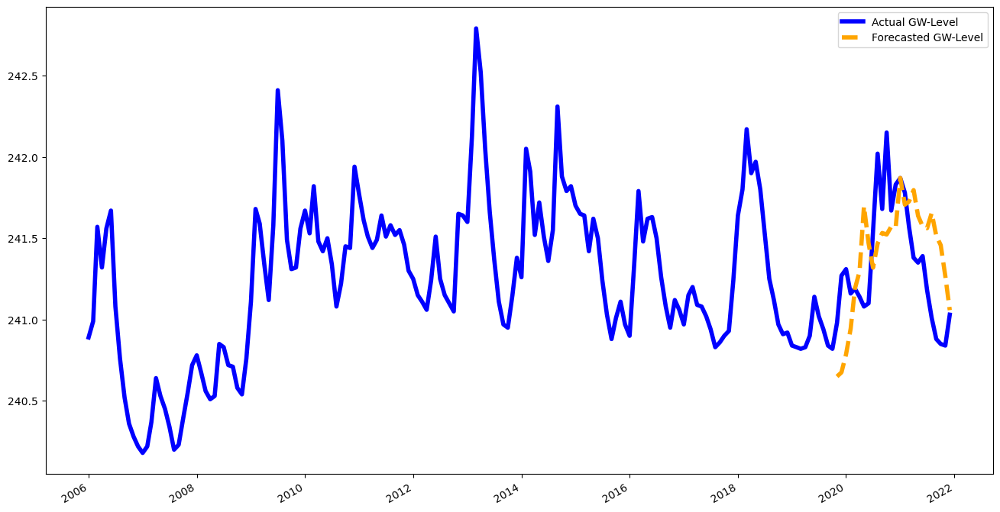



N train dates: 330
1992-01-01 00:00:00 till 2019-10-01 00:00:00
N forecast dates (horizon): 26
2019-11-01 00:00:00 till 2021-12-01 00:00:00
> SMAPE Score: 0.058761
First timepoint: 1992-01-01 00:00:00
Last timepoint:	 2021-12-01 00:00:00


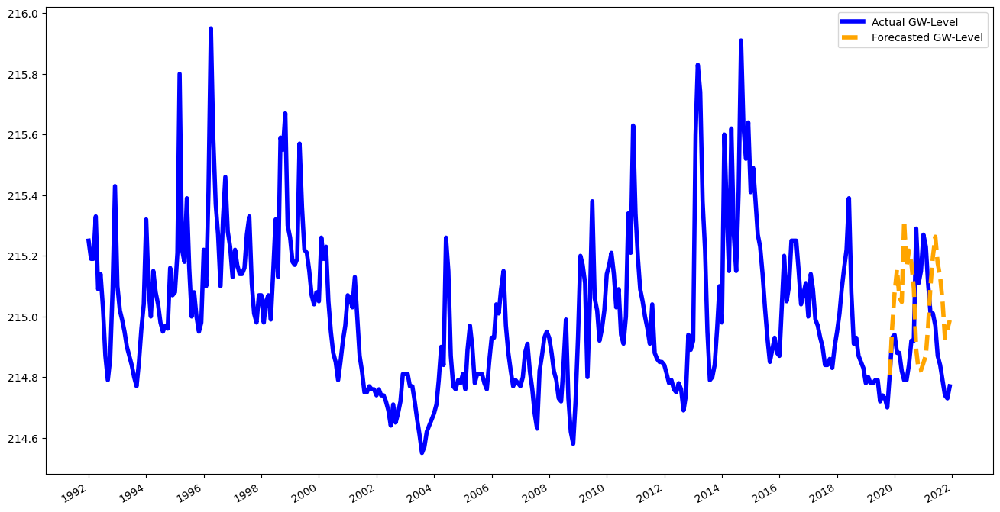



N train dates: 303
1994-02-01 00:00:00 till 2019-10-01 00:00:00
N forecast dates (horizon): 26
2019-11-01 00:00:00 till 2021-12-01 00:00:00
> SMAPE Score: 0.077778
First timepoint: 1994-02-01 00:00:00
Last timepoint:	 2021-12-01 00:00:00


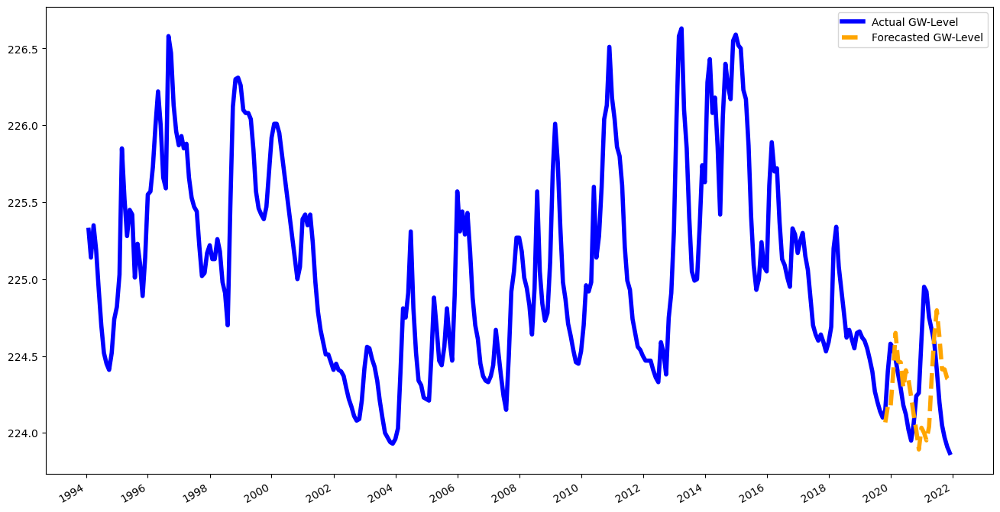



N train dates: 213
2002-01-01 00:00:00 till 2019-10-01 00:00:00
N forecast dates (horizon): 26
2019-11-01 00:00:00 till 2021-12-01 00:00:00
> SMAPE Score: 0.081087
First timepoint: 2002-01-01 00:00:00
Last timepoint:	 2021-12-01 00:00:00


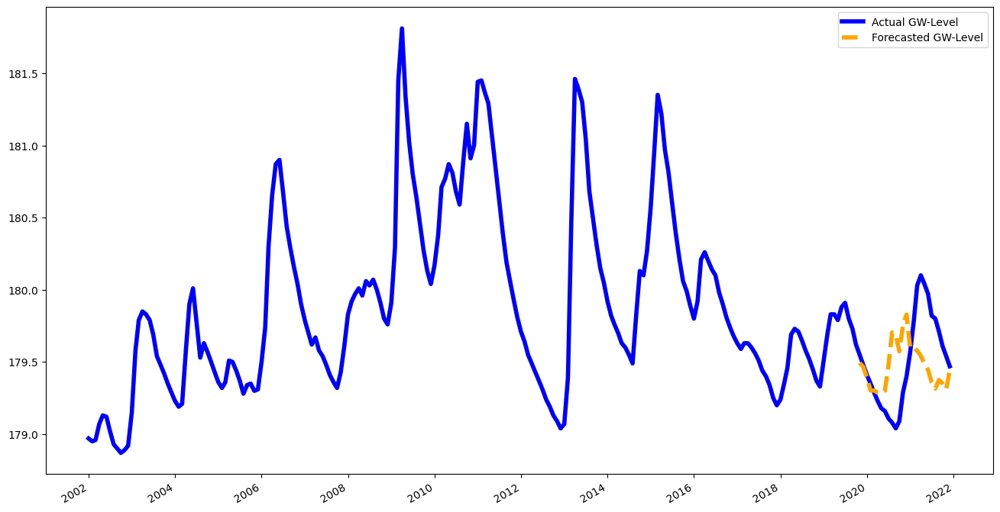



N train dates: 600
1969-11-01 00:00:00 till 2019-10-01 00:00:00
N forecast dates (horizon): 26
2019-11-01 00:00:00 till 2021-12-01 00:00:00
> SMAPE Score: 0.376521
First timepoint: 1969-11-01 00:00:00
Last timepoint:	 2021-12-01 00:00:00


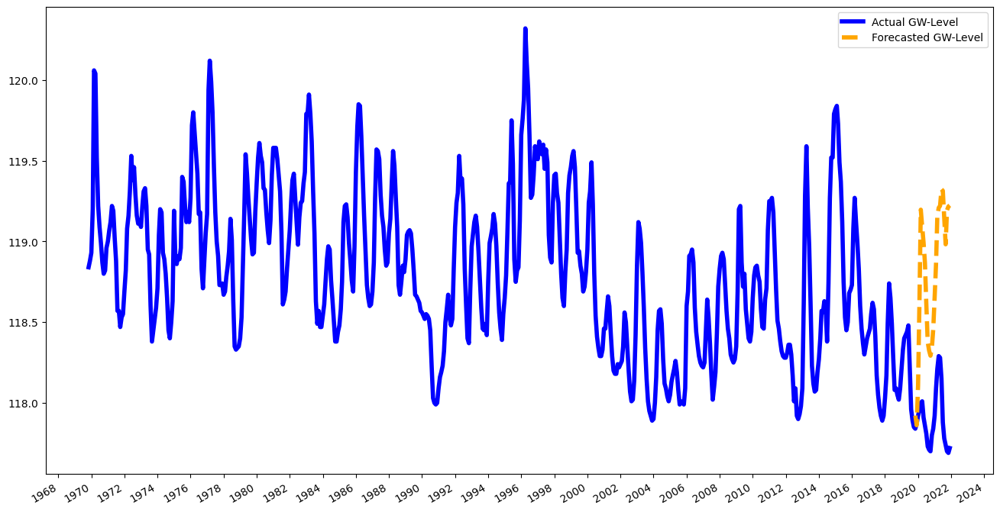



N train dates: 569
1972-01-01 00:00:00 till 2019-10-01 00:00:00
N forecast dates (horizon): 26
2019-11-01 00:00:00 till 2021-12-01 00:00:00
> SMAPE Score: 0.102703
First timepoint: 1972-01-01 00:00:00
Last timepoint:	 2021-12-01 00:00:00


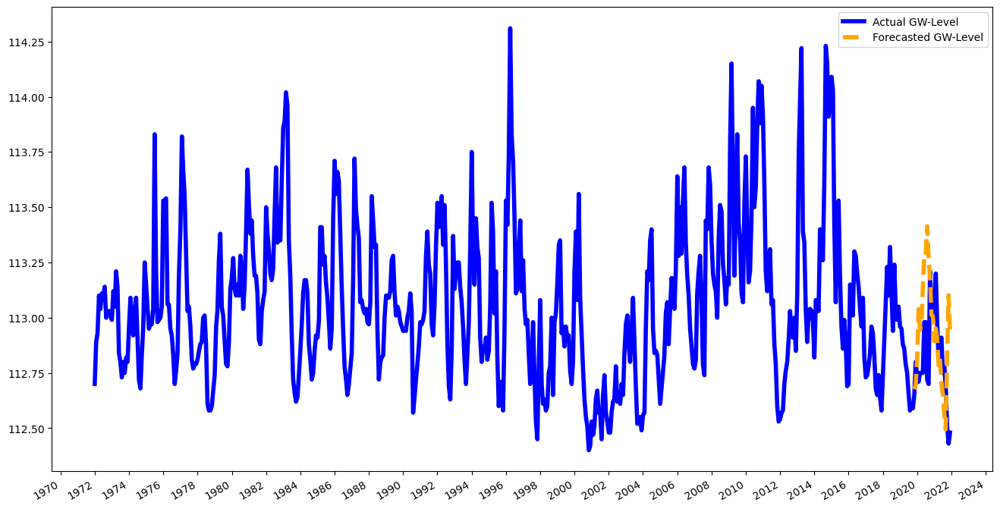



N train dates: 214
2002-01-01 00:00:00 till 2019-10-01 00:00:00
N forecast dates (horizon): 26
2019-11-01 00:00:00 till 2021-12-01 00:00:00
> SMAPE Score: 0.077266
First timepoint: 2002-01-01 00:00:00
Last timepoint:	 2021-12-01 00:00:00


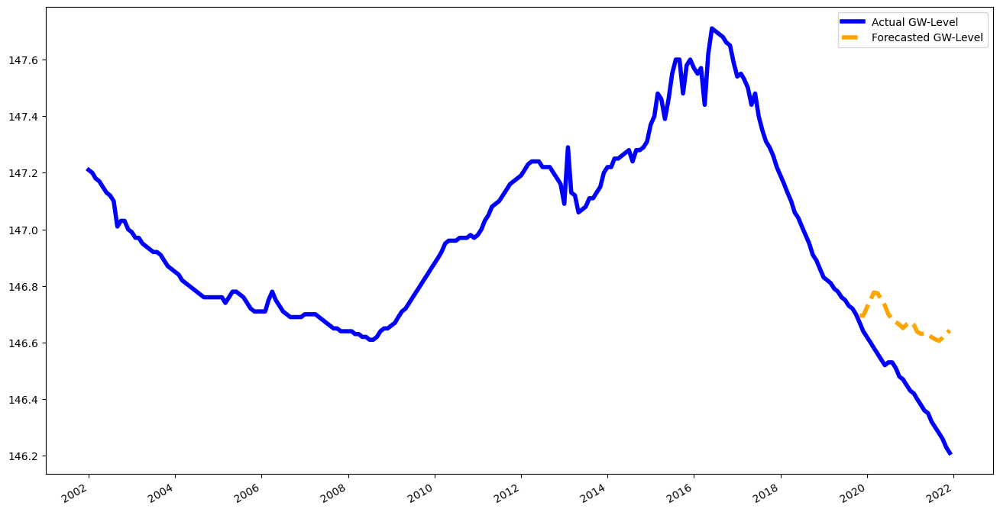



N train dates: 255
1998-03-01 00:00:00 till 2019-10-01 00:00:00
N forecast dates (horizon): 25
2019-11-01 00:00:00 till 2021-12-01 00:00:00
> SMAPE Score: 0.017203
First timepoint: 1998-03-01 00:00:00
Last timepoint:	 2021-12-01 00:00:00


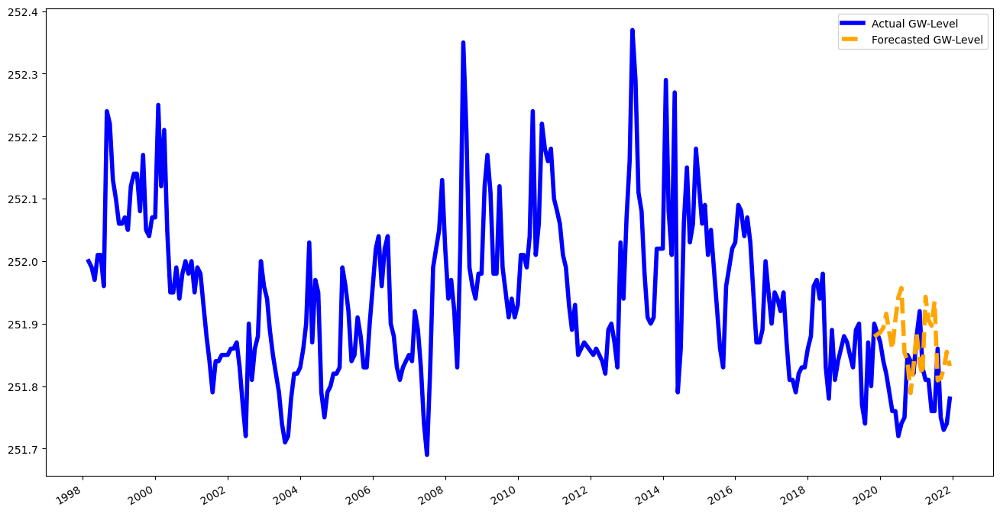



N train dates: 222
2001-03-01 00:00:00 till 2019-10-01 00:00:00
N forecast dates (horizon): 26
2019-11-01 00:00:00 till 2021-12-01 00:00:00
> SMAPE Score: 0.23592
First timepoint: 2001-03-01 00:00:00
Last timepoint:	 2021-12-01 00:00:00


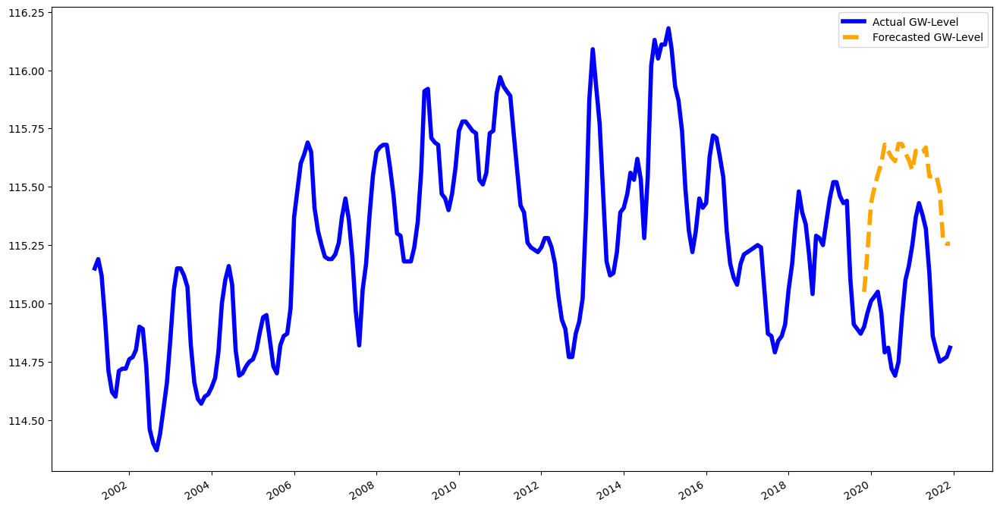



N train dates: 25
2017-10-01 00:00:00 till 2019-10-01 00:00:00
N forecast dates (horizon): 26
2019-11-01 00:00:00 till 2021-12-01 00:00:00
> SMAPE Score: 0.066612
First timepoint: 2017-10-01 00:00:00
Last timepoint:	 2021-12-01 00:00:00


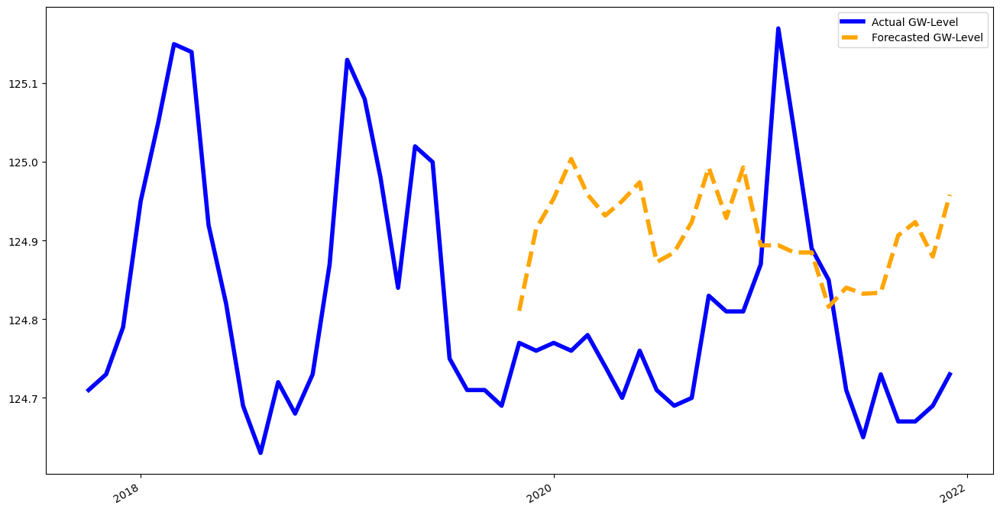



N train dates: 34
2017-01-01 00:00:00 till 2019-10-01 00:00:00
N forecast dates (horizon): 26
2019-11-01 00:00:00 till 2021-12-01 00:00:00
> SMAPE Score: 0.114085
First timepoint: 2017-01-01 00:00:00
Last timepoint:	 2021-12-01 00:00:00


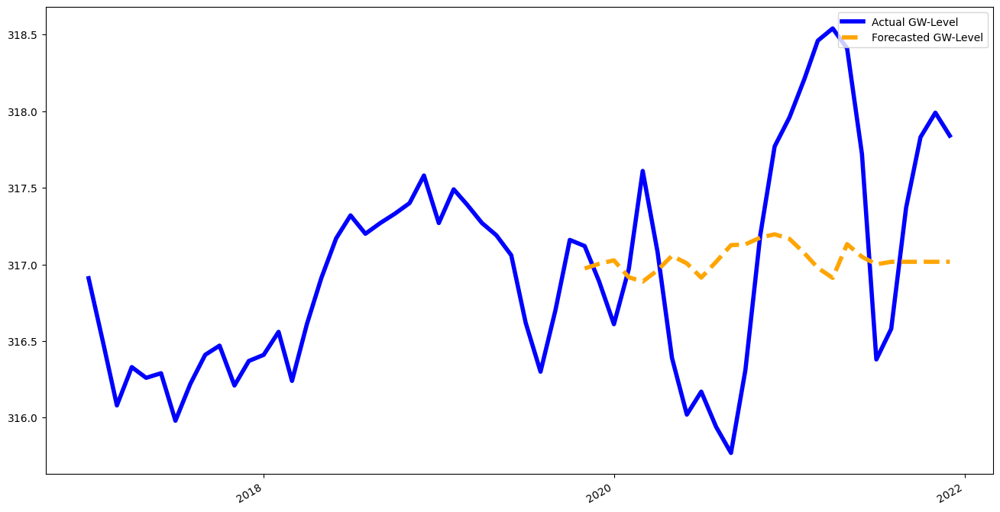



N train dates: 339
1990-01-01 00:00:00 till 2019-10-01 00:00:00
N forecast dates (horizon): 26
2019-11-01 00:00:00 till 2021-12-01 00:00:00
> SMAPE Score: 0.112197
First timepoint: 1990-01-01 00:00:00
Last timepoint:	 2021-12-01 00:00:00


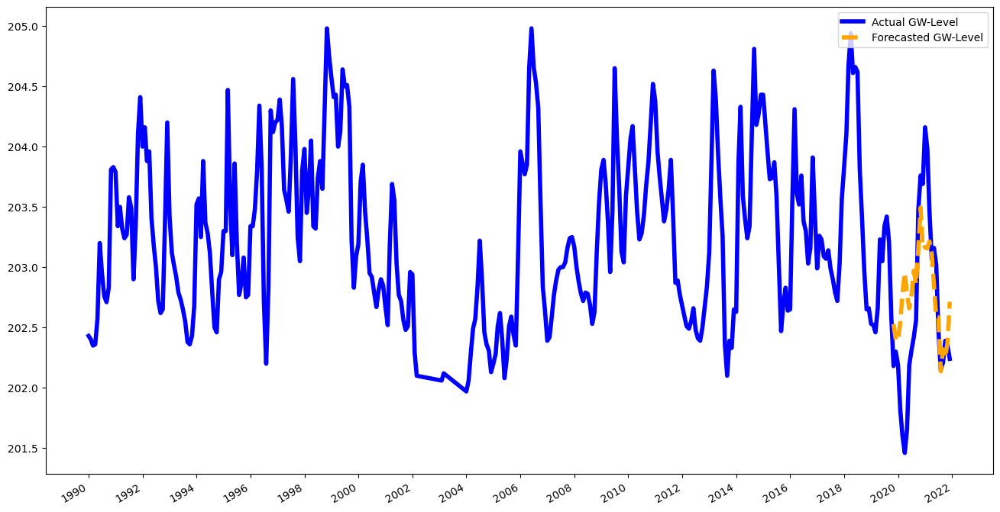



N train dates: 273
1997-01-01 00:00:00 till 2019-10-01 00:00:00
N forecast dates (horizon): 26
2019-11-01 00:00:00 till 2021-12-01 00:00:00
> SMAPE Score: 0.238573
First timepoint: 1997-01-01 00:00:00
Last timepoint:	 2021-12-01 00:00:00


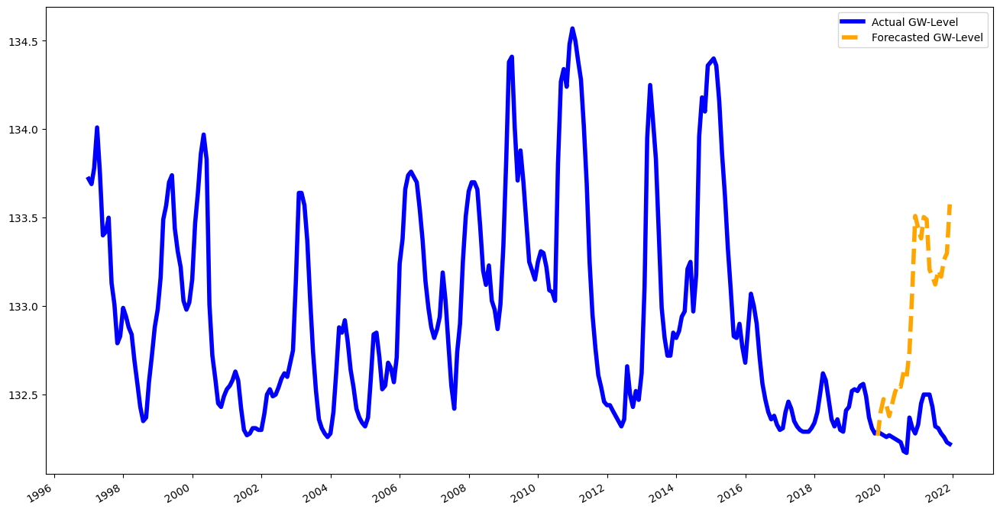



N train dates: 208
2002-01-01 00:00:00 till 2019-10-01 00:00:00
N forecast dates (horizon): 26
2019-11-01 00:00:00 till 2021-12-01 00:00:00
> SMAPE Score: 0.109265
First timepoint: 2002-01-01 00:00:00
Last timepoint:	 2021-12-01 00:00:00


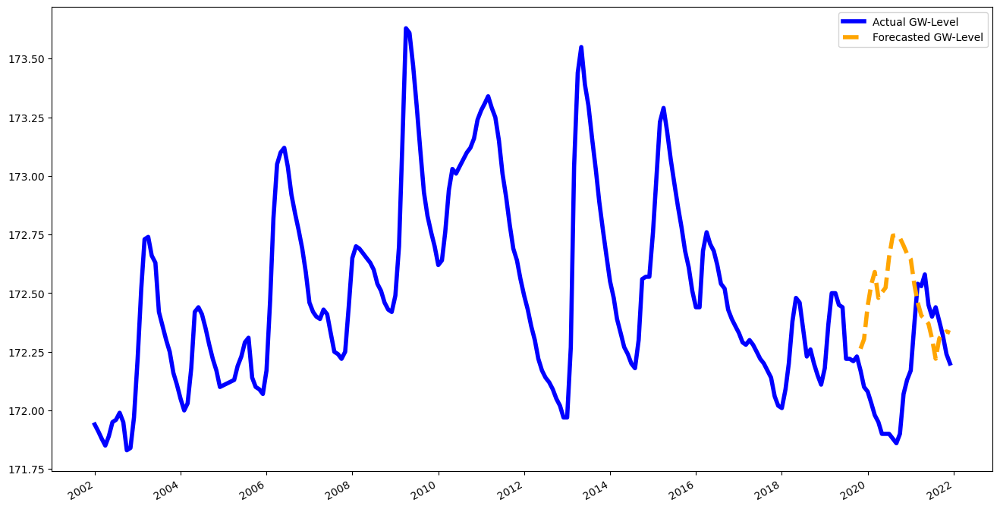



N train dates: 12
2018-11-01 00:00:00 till 2019-10-01 00:00:00
N forecast dates (horizon): 26
2019-11-01 00:00:00 till 2021-12-01 00:00:00


/home/user/miniconda3/lib/python3.9/site-packages/mlforecast/core.py:402: UserWarning: The following series were dropped completely due to the transformations and features: [353730].
These series won't show up if you use `MLForecast.forecast_fitted_values()`.
You can set `dropna=False` or use transformations that require less samples to mitigate this
  warnings.warn(
/home/user/miniconda3/lib/python3.9/site-packages/mlforecast/core.py:579: UserWarning: Found null values in lag14.
  warnings.warn(f'Found null values in {", ".join(cols_with_nulls)}.')


> SMAPE Score: 100.0
First timepoint: 2018-11-01 00:00:00
Last timepoint:	 2021-12-01 00:00:00


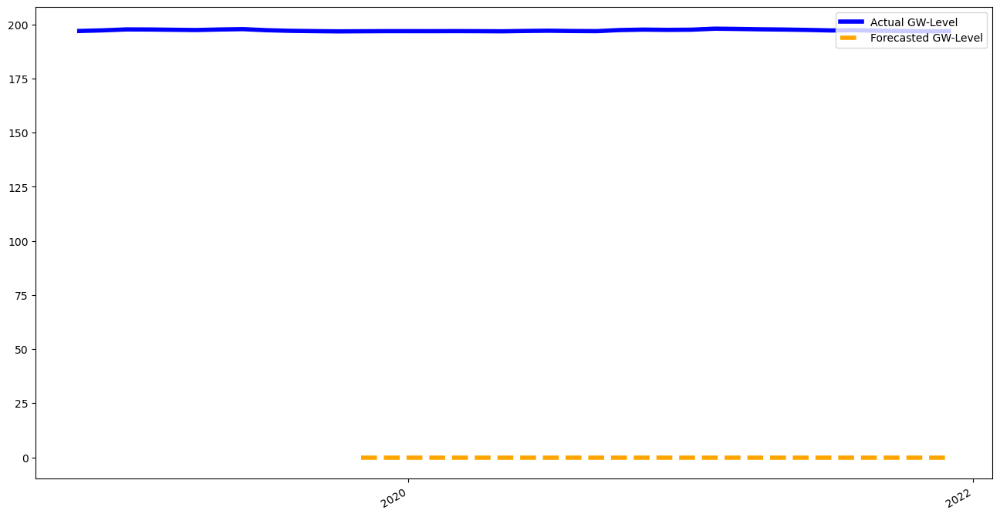



N train dates: 250
1999-01-01 00:00:00 till 2019-10-01 00:00:00
N forecast dates (horizon): 26
2019-11-01 00:00:00 till 2021-12-01 00:00:00
> SMAPE Score: 0.086262
First timepoint: 1999-01-01 00:00:00
Last timepoint:	 2021-12-01 00:00:00


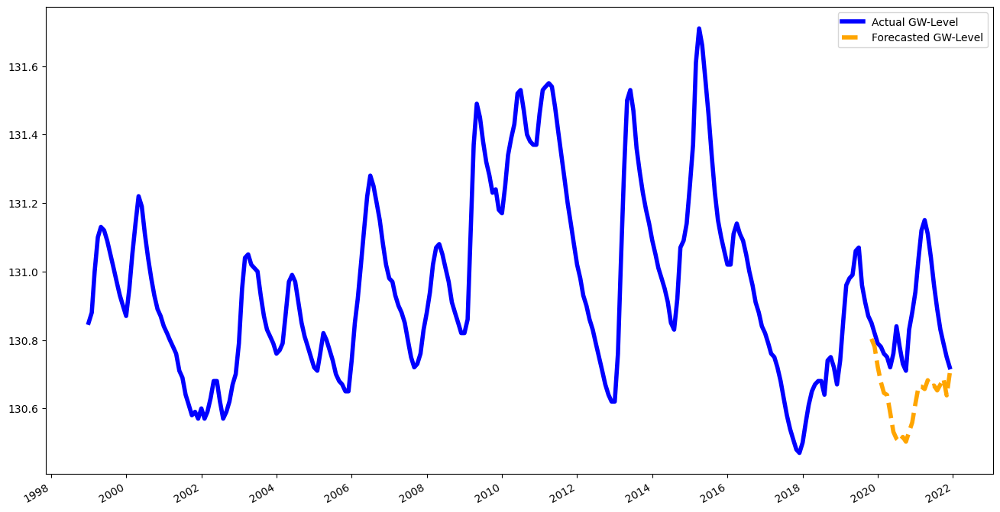



N train dates: 129
2009-02-01 00:00:00 till 2019-10-01 00:00:00
N forecast dates (horizon): 26
2019-11-01 00:00:00 till 2021-12-01 00:00:00
> SMAPE Score: 0.031294
First timepoint: 2009-02-01 00:00:00
Last timepoint:	 2021-12-01 00:00:00


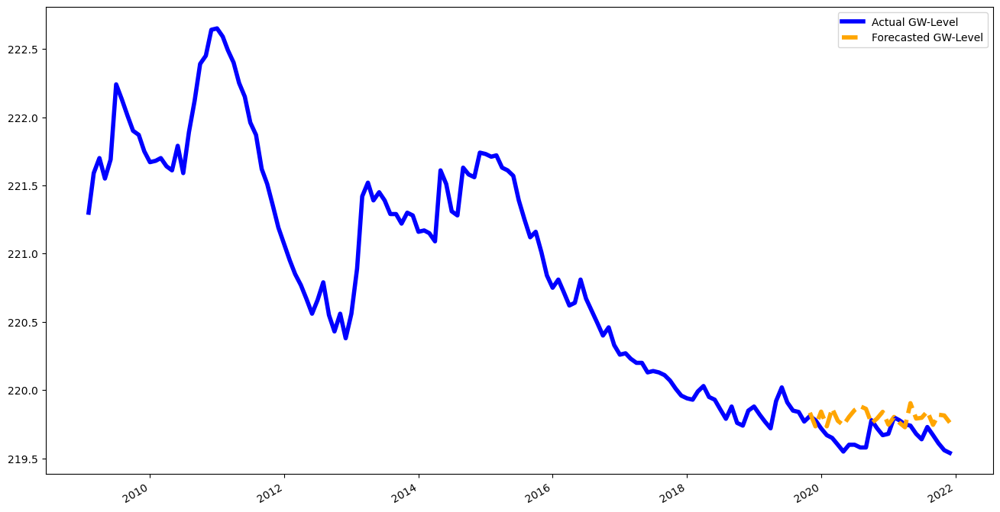



N train dates: 401
1986-03-01 00:00:00 till 2019-10-01 00:00:00
N forecast dates (horizon): 26
2019-11-01 00:00:00 till 2021-12-01 00:00:00
> SMAPE Score: 0.017117
First timepoint: 1986-03-01 00:00:00
Last timepoint:	 2021-12-01 00:00:00


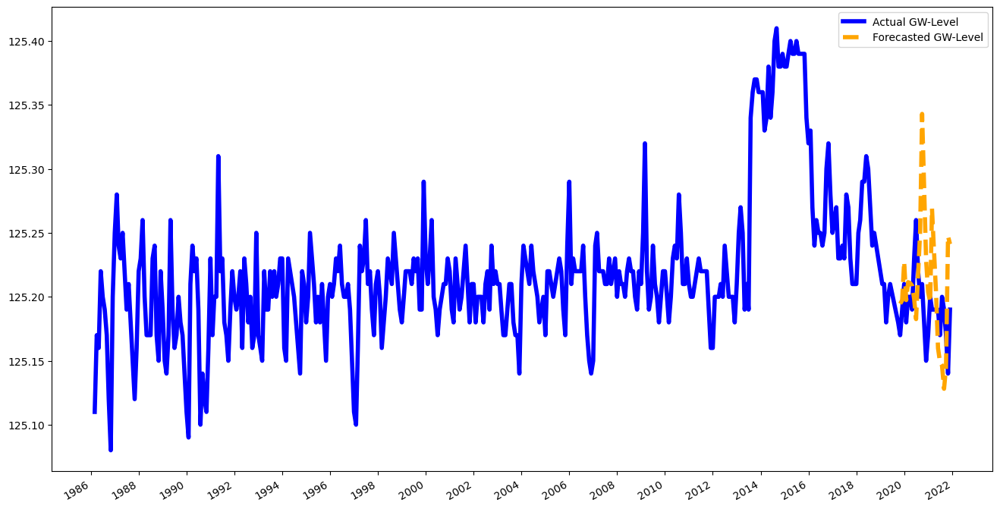



N train dates: 791
1953-11-01 00:00:00 till 2019-10-01 00:00:00
N forecast dates (horizon): 26
2019-11-01 00:00:00 till 2021-12-01 00:00:00
> SMAPE Score: 0.113208
First timepoint: 1953-11-01 00:00:00
Last timepoint:	 2021-12-01 00:00:00


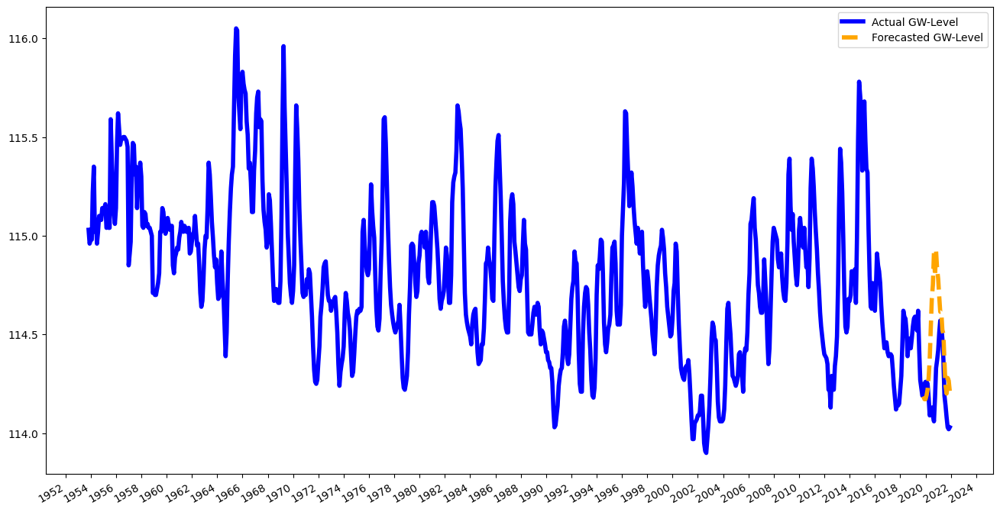



N train dates: 273
1997-01-01 00:00:00 till 2019-10-01 00:00:00
N forecast dates (horizon): 26
2019-11-01 00:00:00 till 2021-12-01 00:00:00
> SMAPE Score: 0.463943
First timepoint: 1997-01-01 00:00:00
Last timepoint:	 2021-12-01 00:00:00


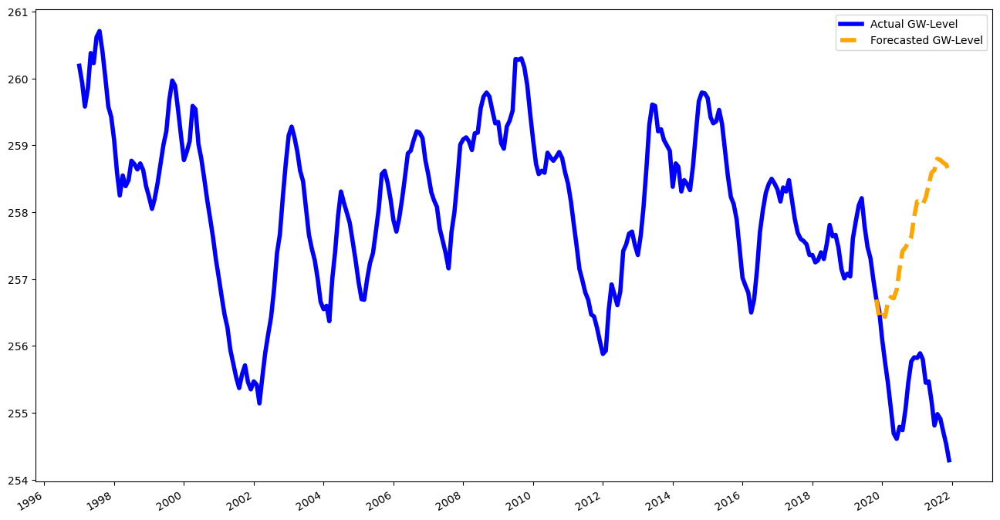



N train dates: 298
1995-01-01 00:00:00 till 2019-10-01 00:00:00
N forecast dates (horizon): 26
2019-11-01 00:00:00 till 2021-12-01 00:00:00
> SMAPE Score: 0.065201
First timepoint: 1995-01-01 00:00:00
Last timepoint:	 2021-12-01 00:00:00


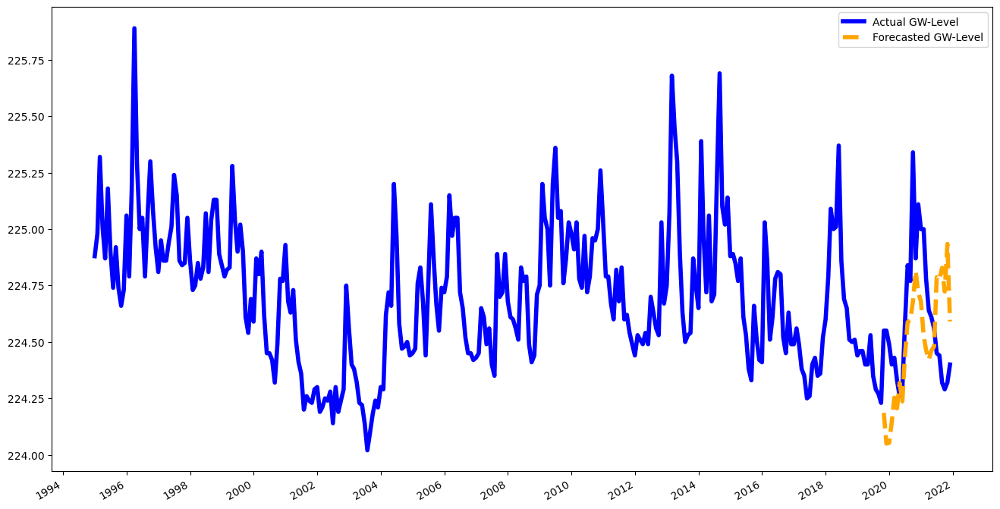



N train dates: 181
2003-12-01 00:00:00 till 2019-10-01 00:00:00
N forecast dates (horizon): 26
2019-11-01 00:00:00 till 2021-12-01 00:00:00
> SMAPE Score: 0.053627
First timepoint: 2003-12-01 00:00:00
Last timepoint:	 2021-12-01 00:00:00


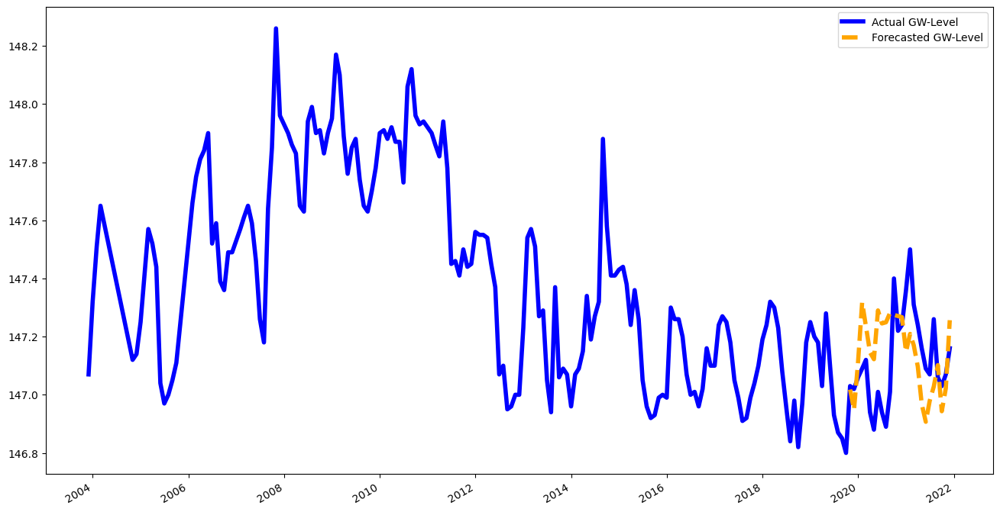



N train dates: 691
1962-04-01 00:00:00 till 2019-10-01 00:00:00
N forecast dates (horizon): 26
2019-11-01 00:00:00 till 2021-12-01 00:00:00
> SMAPE Score: 0.12469
First timepoint: 1962-04-01 00:00:00
Last timepoint:	 2021-12-01 00:00:00


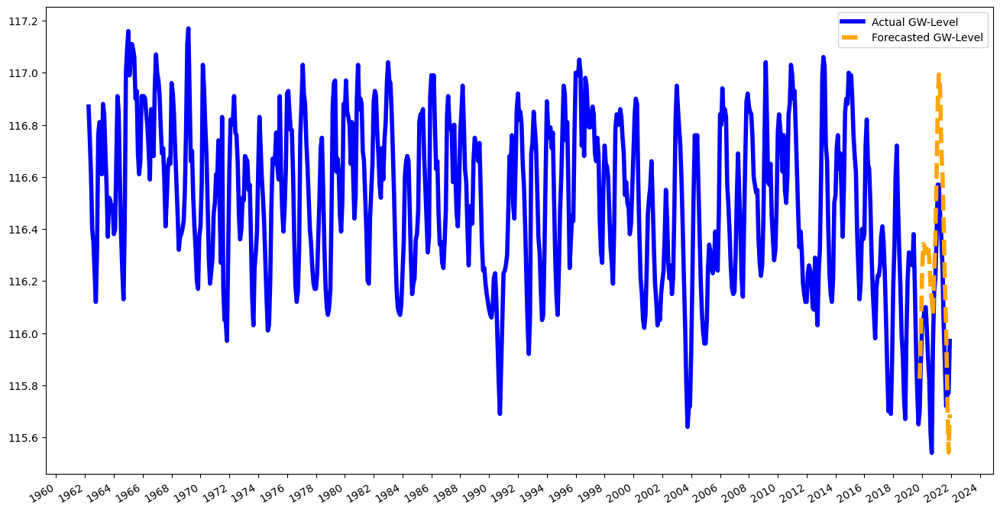



N train dates: 358
1990-01-01 00:00:00 till 2019-10-01 00:00:00
N forecast dates (horizon): 26
2019-11-01 00:00:00 till 2021-12-01 00:00:00
> SMAPE Score: 0.135151
First timepoint: 1990-01-01 00:00:00
Last timepoint:	 2021-12-01 00:00:00


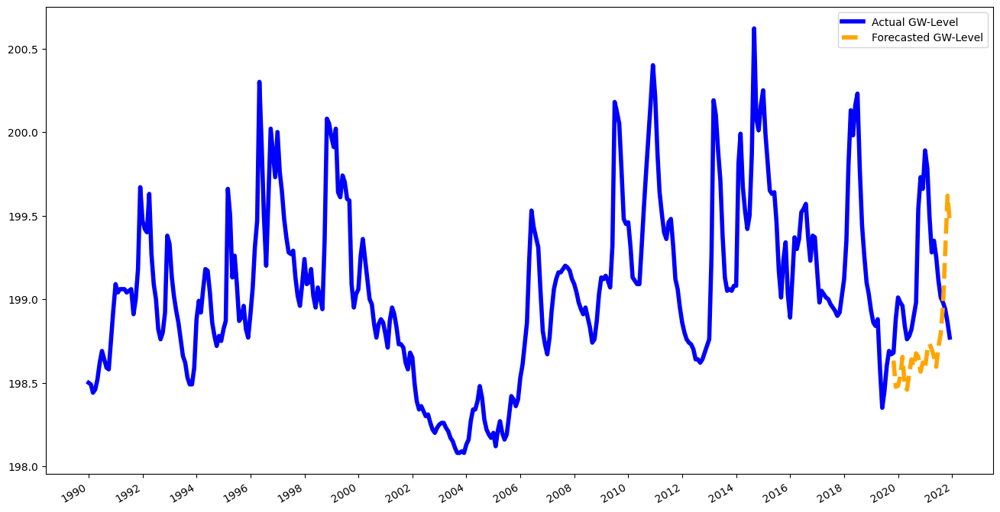



N train dates: 250
1999-01-01 00:00:00 till 2019-10-01 00:00:00
N forecast dates (horizon): 26
2019-11-01 00:00:00 till 2021-12-01 00:00:00
> SMAPE Score: 0.142251
First timepoint: 1999-01-01 00:00:00
Last timepoint:	 2021-12-01 00:00:00


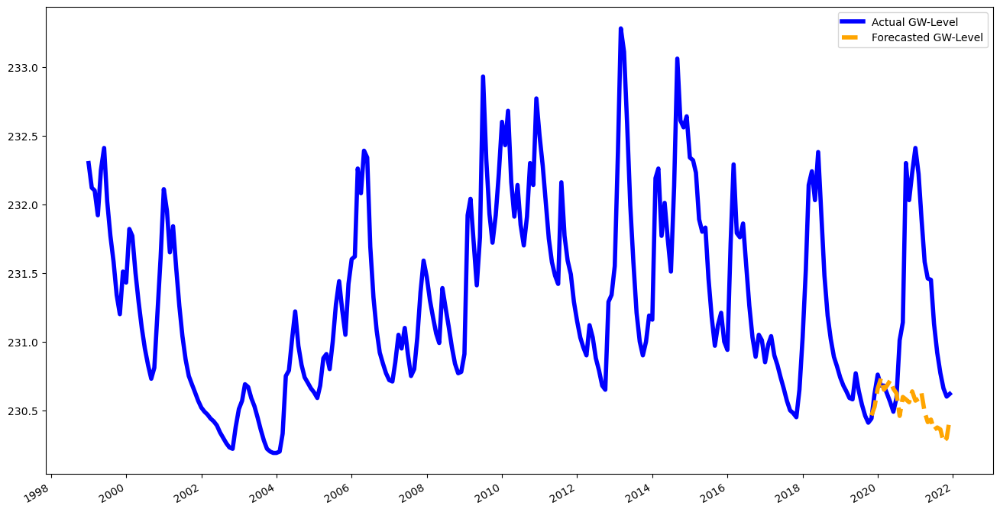



N train dates: 791
1953-11-01 00:00:00 till 2019-10-01 00:00:00
N forecast dates (horizon): 26
2019-11-01 00:00:00 till 2021-12-01 00:00:00
> SMAPE Score: 0.125457
First timepoint: 1953-11-01 00:00:00
Last timepoint:	 2021-12-01 00:00:00


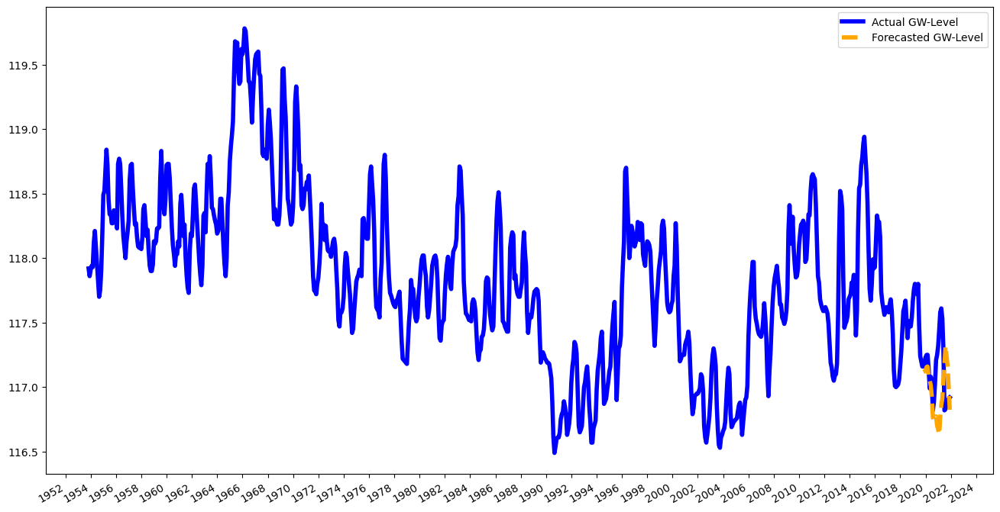



N train dates: 377
1988-01-01 00:00:00 till 2019-10-01 00:00:00
N forecast dates (horizon): 26
2019-11-01 00:00:00 till 2021-12-01 00:00:00
> SMAPE Score: 0.10896
First timepoint: 1988-01-01 00:00:00
Last timepoint:	 2021-12-01 00:00:00


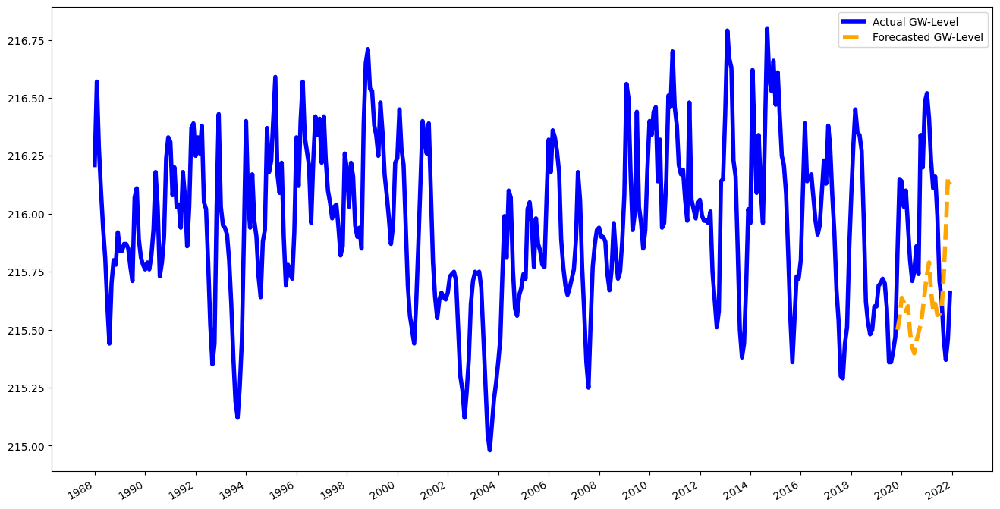



N train dates: 321
1993-01-01 00:00:00 till 2019-10-01 00:00:00
N forecast dates (horizon): 26
2019-11-01 00:00:00 till 2021-12-01 00:00:00
> SMAPE Score: 0.146225
First timepoint: 1993-01-01 00:00:00
Last timepoint:	 2021-12-01 00:00:00


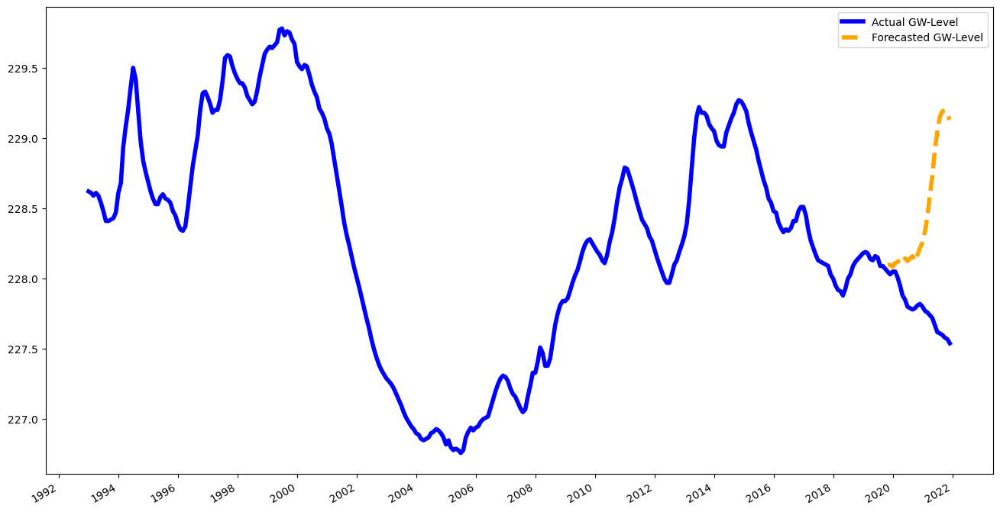



N train dates: 610
1969-01-01 00:00:00 till 2019-10-01 00:00:00
N forecast dates (horizon): 25
2019-11-01 00:00:00 till 2021-12-01 00:00:00
> SMAPE Score: 0.151544
First timepoint: 1969-01-01 00:00:00
Last timepoint:	 2021-12-01 00:00:00


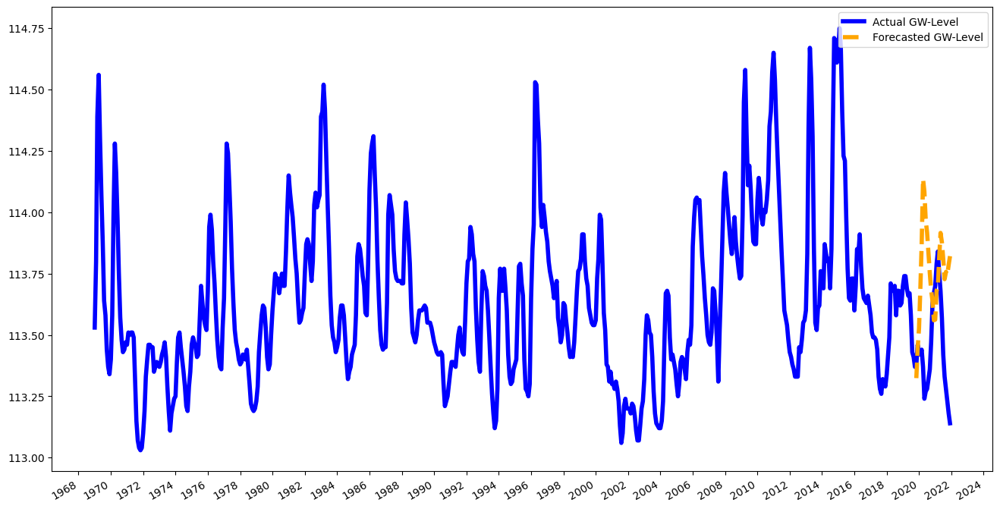



N train dates: 189
2004-02-01 00:00:00 till 2019-10-01 00:00:00
N forecast dates (horizon): 25
2019-11-01 00:00:00 till 2021-12-01 00:00:00
> SMAPE Score: 0.213656
First timepoint: 2004-02-01 00:00:00
Last timepoint:	 2021-12-01 00:00:00


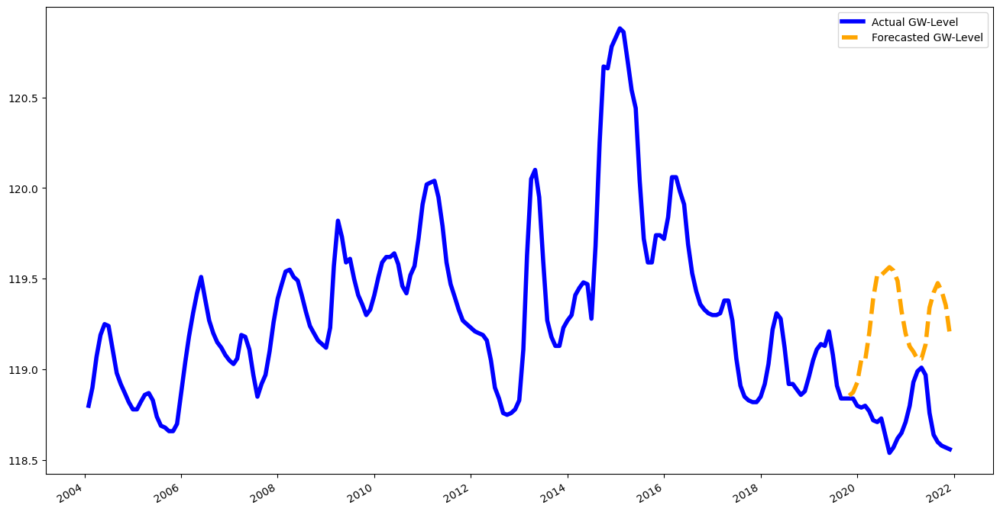



N train dates: 334
1992-01-01 00:00:00 till 2019-10-01 00:00:00
N forecast dates (horizon): 26
2019-11-01 00:00:00 till 2021-12-01 00:00:00
> SMAPE Score: 0.058352
First timepoint: 1992-01-01 00:00:00
Last timepoint:	 2021-12-01 00:00:00


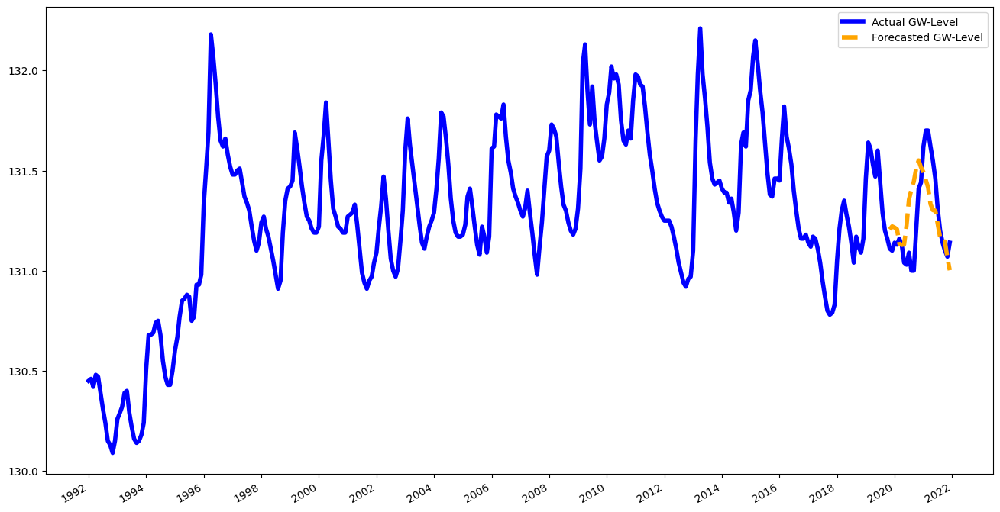



N train dates: 756
1956-11-01 00:00:00 till 2019-10-01 00:00:00
N forecast dates (horizon): 26
2019-11-01 00:00:00 till 2021-12-01 00:00:00
> SMAPE Score: 0.106733
First timepoint: 1956-11-01 00:00:00
Last timepoint:	 2021-12-01 00:00:00


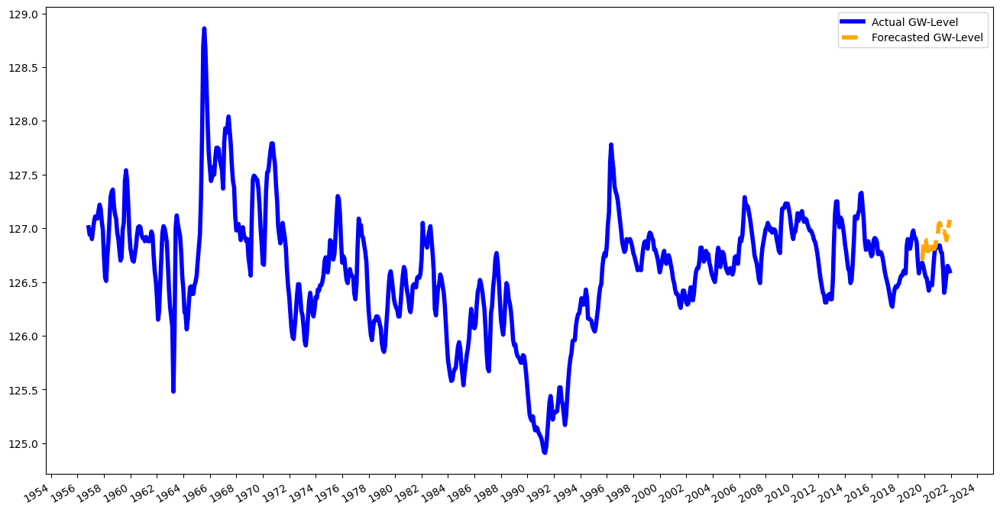



N train dates: 141
2008-01-01 00:00:00 till 2019-10-01 00:00:00
N forecast dates (horizon): 23
2019-11-01 00:00:00 till 2021-12-01 00:00:00
> SMAPE Score: 0.038762
First timepoint: 2008-01-01 00:00:00
Last timepoint:	 2021-12-01 00:00:00


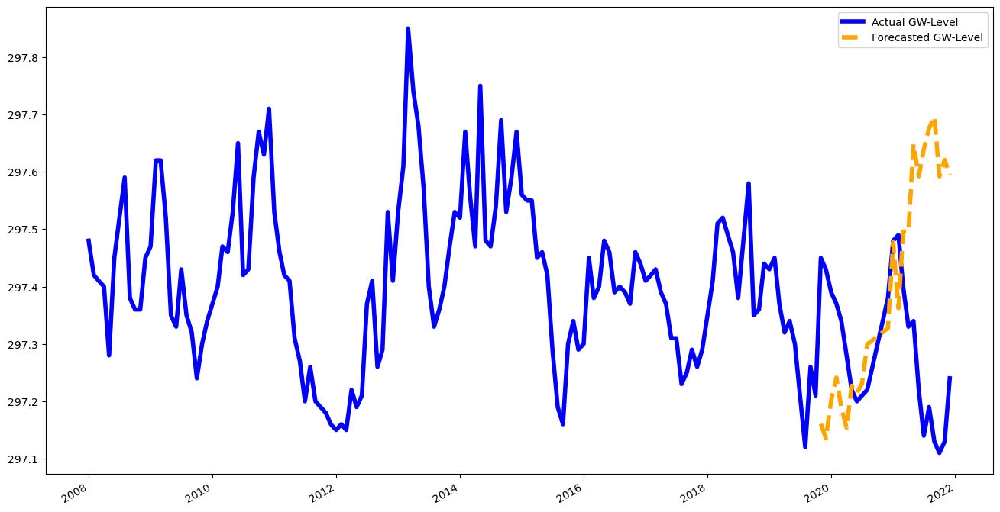



N train dates: 142
2008-01-01 00:00:00 till 2019-10-01 00:00:00
N forecast dates (horizon): 26
2019-11-01 00:00:00 till 2021-12-01 00:00:00
> SMAPE Score: 0.046322
First timepoint: 2008-01-01 00:00:00
Last timepoint:	 2021-12-01 00:00:00


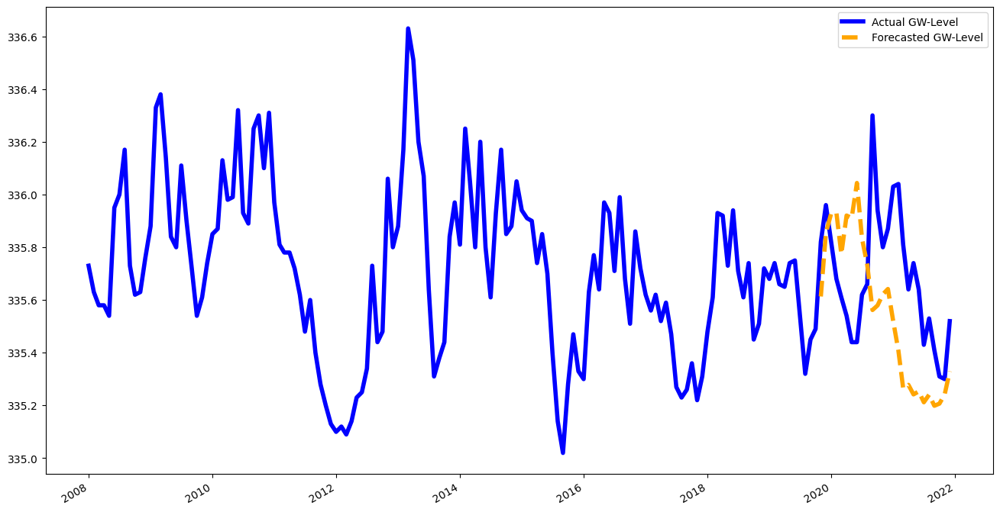



N train dates: 274
1997-01-01 00:00:00 till 2019-10-01 00:00:00
N forecast dates (horizon): 26
2019-11-01 00:00:00 till 2021-12-01 00:00:00
> SMAPE Score: 0.054654
First timepoint: 1997-01-01 00:00:00
Last timepoint:	 2021-12-01 00:00:00


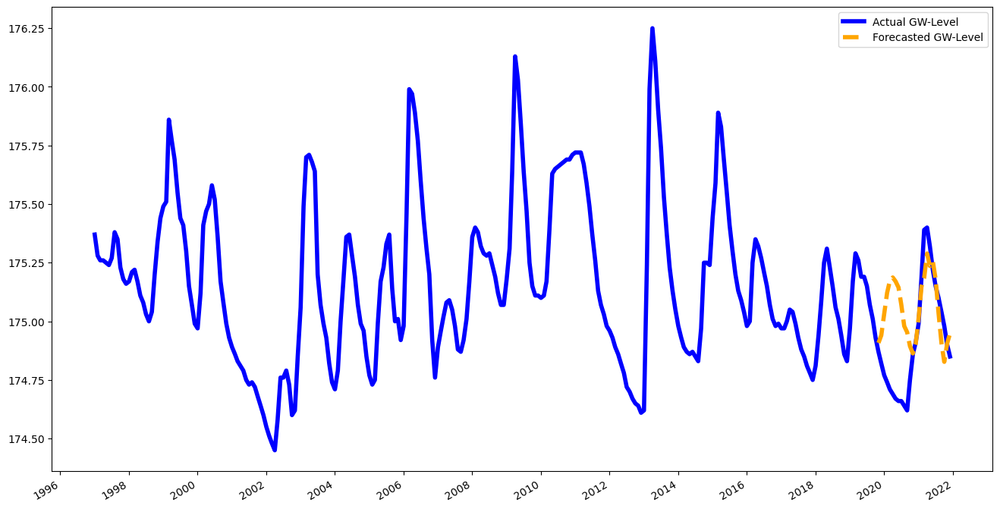



N train dates: 405
1986-01-01 00:00:00 till 2019-10-01 00:00:00
N forecast dates (horizon): 26
2019-11-01 00:00:00 till 2021-12-01 00:00:00
> SMAPE Score: 0.097029
First timepoint: 1986-01-01 00:00:00
Last timepoint:	 2021-12-01 00:00:00


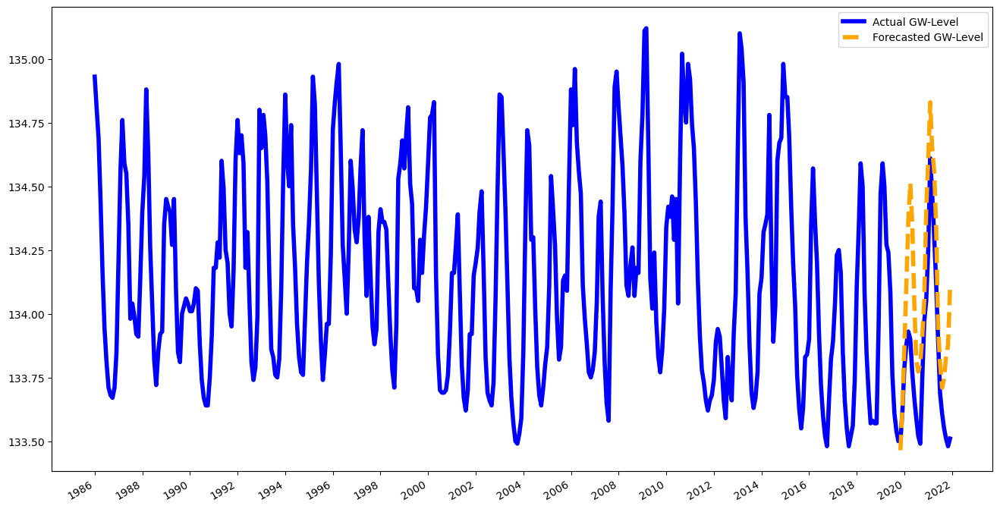



N train dates: 259
1998-03-01 00:00:00 till 2019-10-01 00:00:00
N forecast dates (horizon): 26
2019-11-01 00:00:00 till 2021-12-01 00:00:00
> SMAPE Score: 0.036306
First timepoint: 1998-03-01 00:00:00
Last timepoint:	 2021-12-01 00:00:00


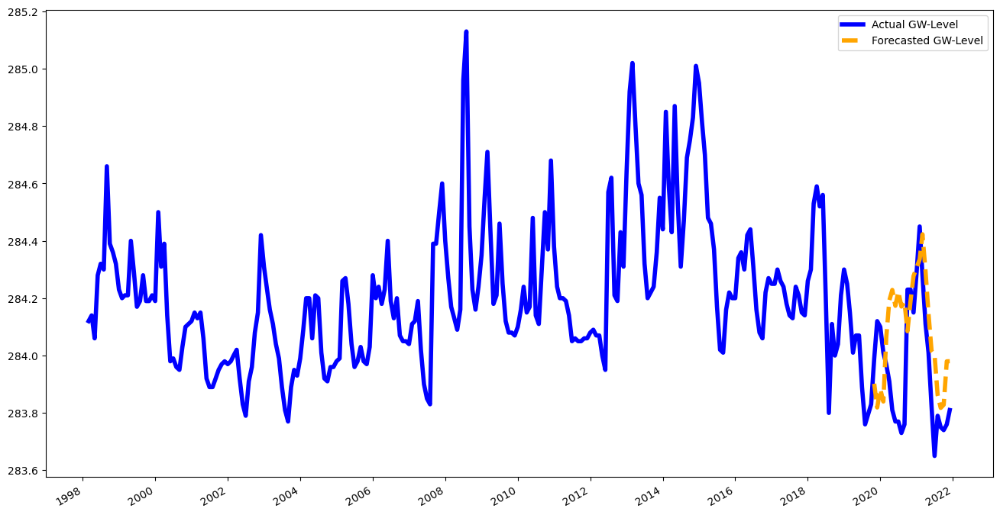



N train dates: 586
1971-01-01 00:00:00 till 2019-10-01 00:00:00
N forecast dates (horizon): 26
2019-11-01 00:00:00 till 2021-12-01 00:00:00
> SMAPE Score: 0.261155
First timepoint: 1971-01-01 00:00:00
Last timepoint:	 2021-12-01 00:00:00


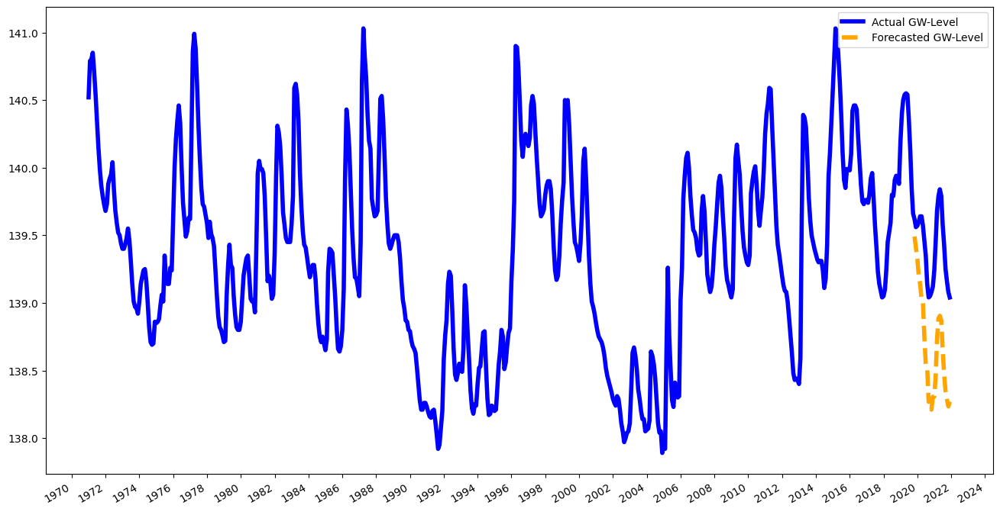



N train dates: 322
1993-01-01 00:00:00 till 2019-10-01 00:00:00
N forecast dates (horizon): 26
2019-11-01 00:00:00 till 2021-12-01 00:00:00
> SMAPE Score: 0.026878
First timepoint: 1993-01-01 00:00:00
Last timepoint:	 2021-12-01 00:00:00


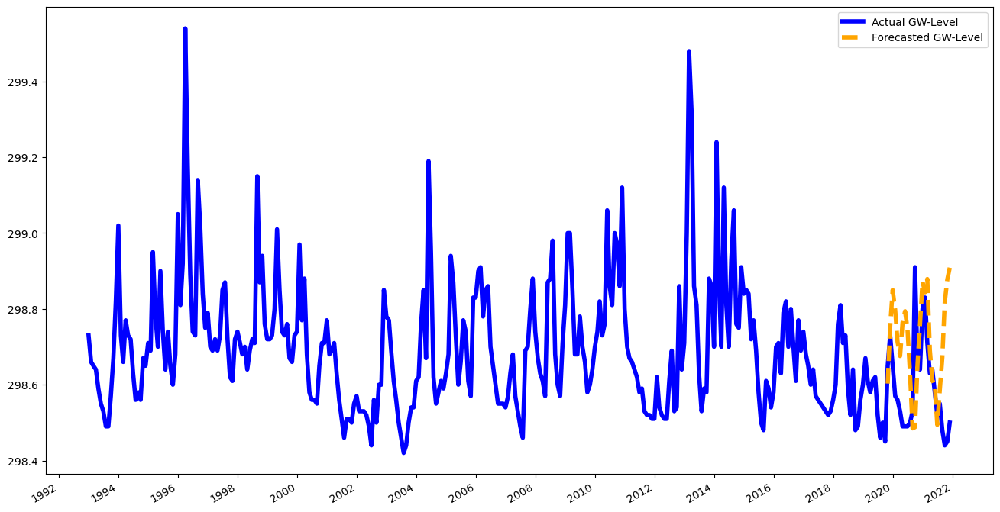



N train dates: 226
2001-01-01 00:00:00 till 2019-10-01 00:00:00
N forecast dates (horizon): 26
2019-11-01 00:00:00 till 2021-12-01 00:00:00
> SMAPE Score: 0.13671
First timepoint: 2001-01-01 00:00:00
Last timepoint:	 2021-12-01 00:00:00


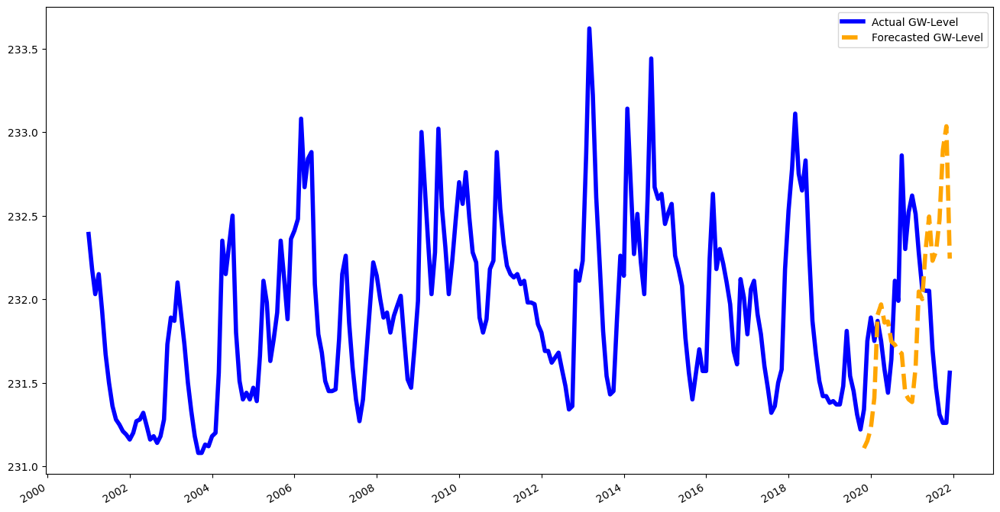



N train dates: 359
1960-01-01 00:00:00 till 2019-10-01 00:00:00
N forecast dates (horizon): 26
2019-11-01 00:00:00 till 2021-12-01 00:00:00
> SMAPE Score: 0.170344
First timepoint: 1960-01-01 00:00:00
Last timepoint:	 2021-12-01 00:00:00


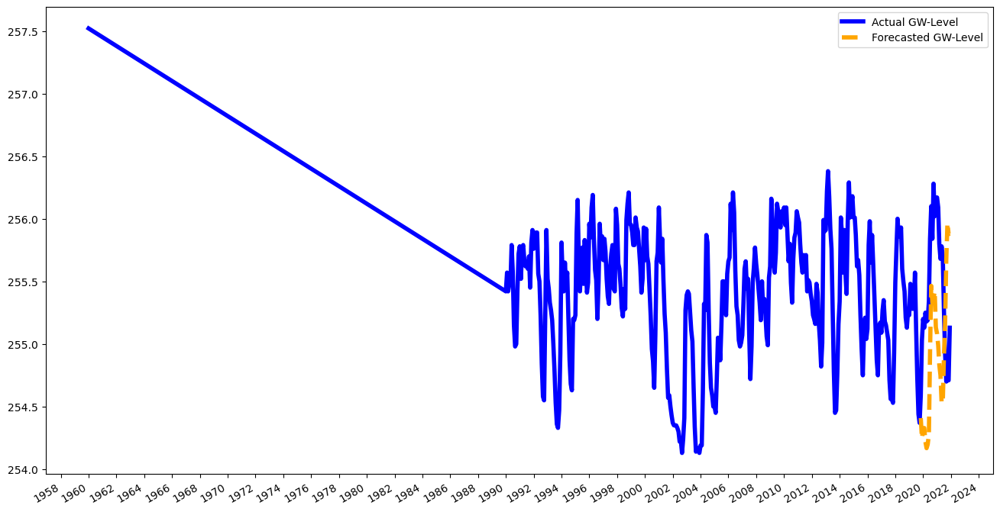



N train dates: 483
1979-01-01 00:00:00 till 2019-10-01 00:00:00
N forecast dates (horizon): 26
2019-11-01 00:00:00 till 2021-12-01 00:00:00
> SMAPE Score: 0.158985
First timepoint: 1979-01-01 00:00:00
Last timepoint:	 2021-12-01 00:00:00


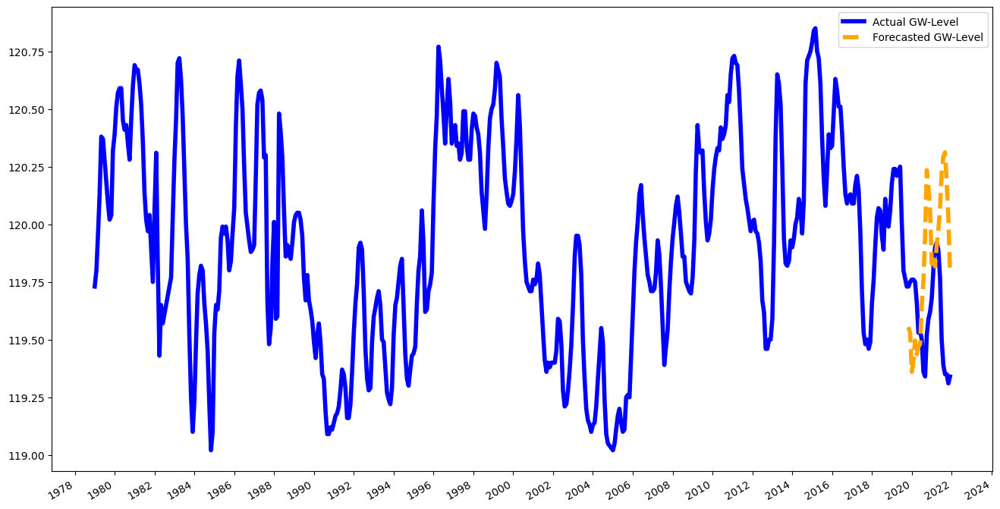



N train dates: 376
1988-01-01 00:00:00 till 2019-10-01 00:00:00
N forecast dates (horizon): 26
2019-11-01 00:00:00 till 2021-12-01 00:00:00
> SMAPE Score: 0.07606
First timepoint: 1988-01-01 00:00:00
Last timepoint:	 2021-12-01 00:00:00


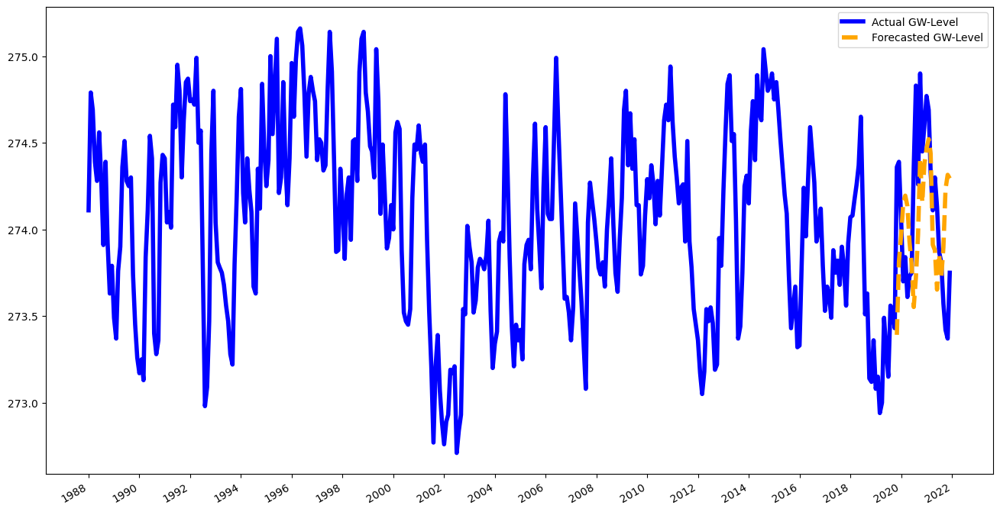



N train dates: 50
2015-08-01 00:00:00 till 2019-10-01 00:00:00
N forecast dates (horizon): 26
2019-11-01 00:00:00 till 2021-12-01 00:00:00
> SMAPE Score: 0.089326
First timepoint: 2015-08-01 00:00:00
Last timepoint:	 2021-12-01 00:00:00


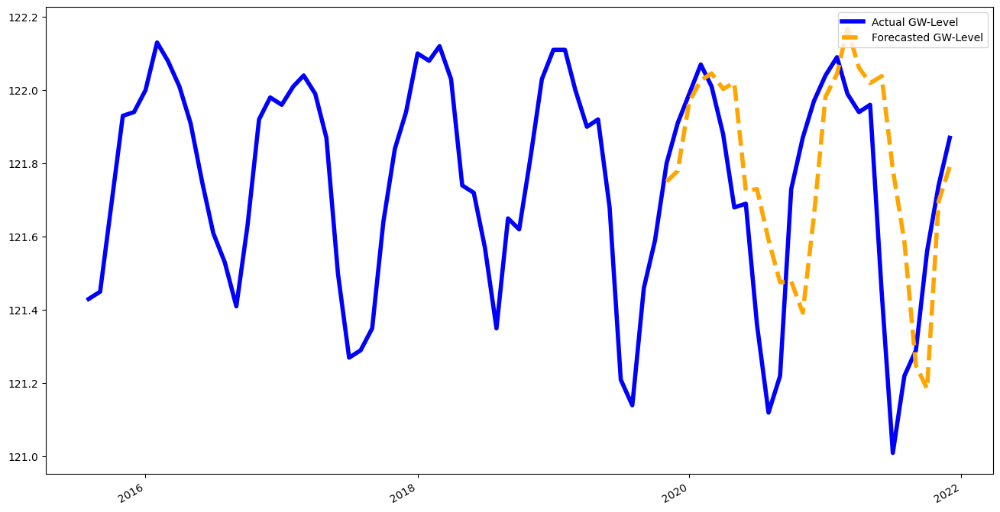



N train dates: 319
1993-04-01 00:00:00 till 2019-10-01 00:00:00
N forecast dates (horizon): 26
2019-11-01 00:00:00 till 2021-12-01 00:00:00
> SMAPE Score: 0.036621
First timepoint: 1993-04-01 00:00:00
Last timepoint:	 2021-12-01 00:00:00


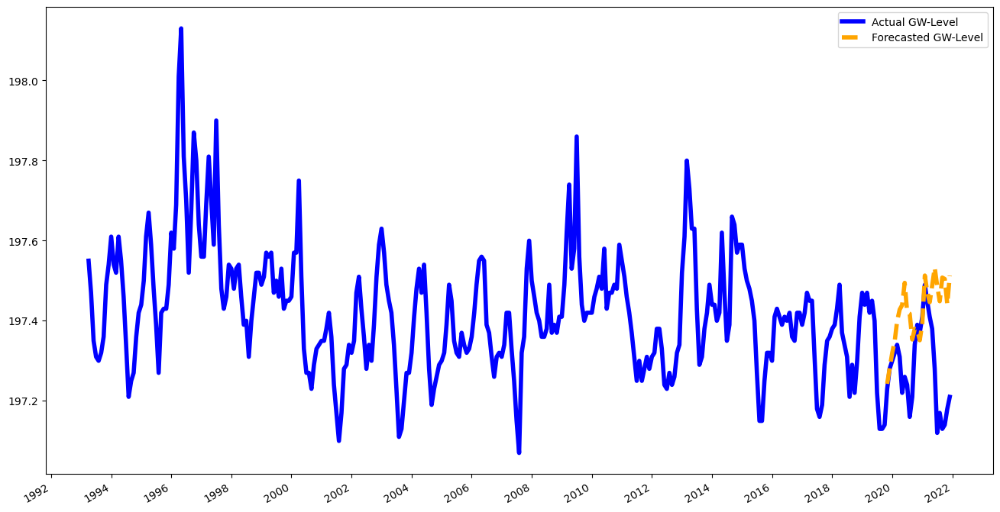



N train dates: 259
1998-01-01 00:00:00 till 2019-10-01 00:00:00
N forecast dates (horizon): 23
2019-11-01 00:00:00 till 2021-12-01 00:00:00
> SMAPE Score: 0.095242
First timepoint: 1998-01-01 00:00:00
Last timepoint:	 2021-12-01 00:00:00


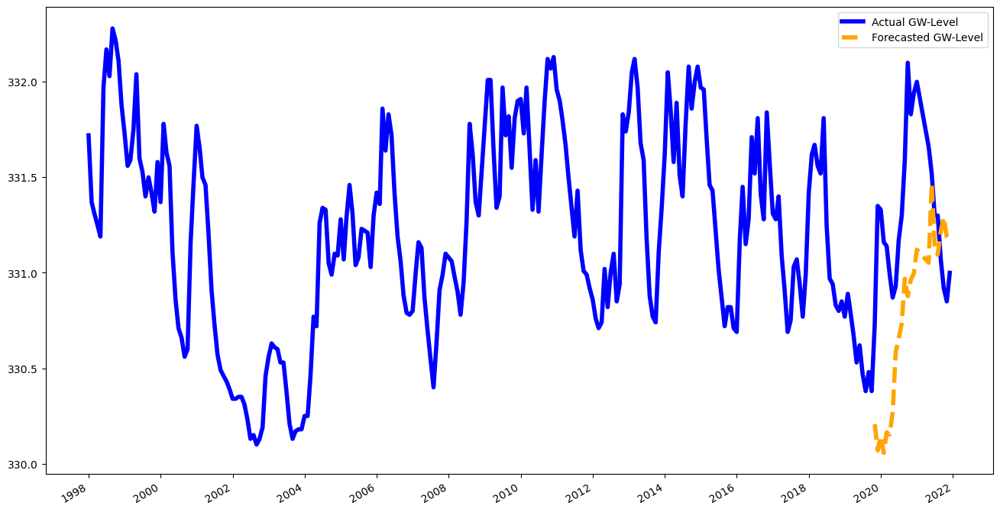



N train dates: 366
1989-01-01 00:00:00 till 2019-10-01 00:00:00
N forecast dates (horizon): 26
2019-11-01 00:00:00 till 2021-12-01 00:00:00
> SMAPE Score: 0.222677
First timepoint: 1989-01-01 00:00:00
Last timepoint:	 2021-12-01 00:00:00


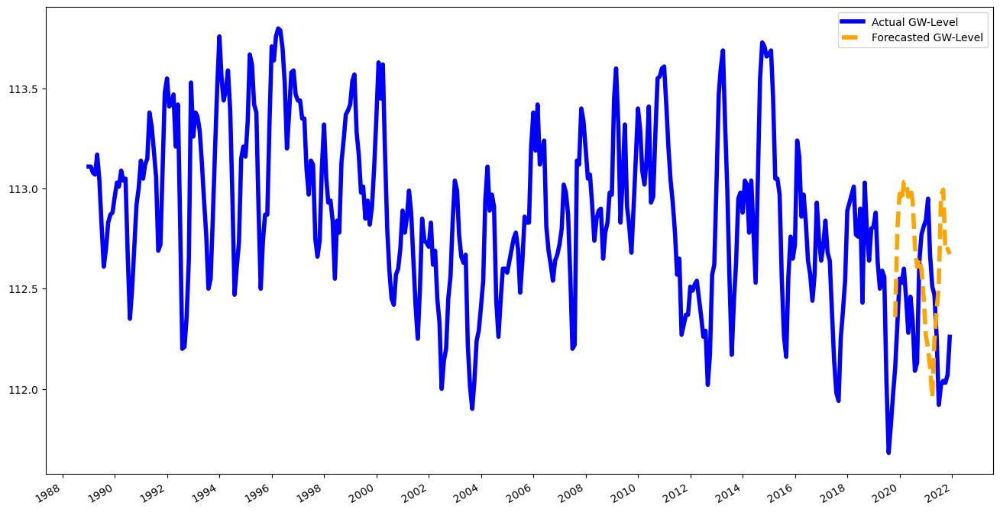



N train dates: 238
2000-01-01 00:00:00 till 2019-10-01 00:00:00
N forecast dates (horizon): 26
2019-11-01 00:00:00 till 2021-12-01 00:00:00
> SMAPE Score: 0.239642
First timepoint: 2000-01-01 00:00:00
Last timepoint:	 2021-12-01 00:00:00


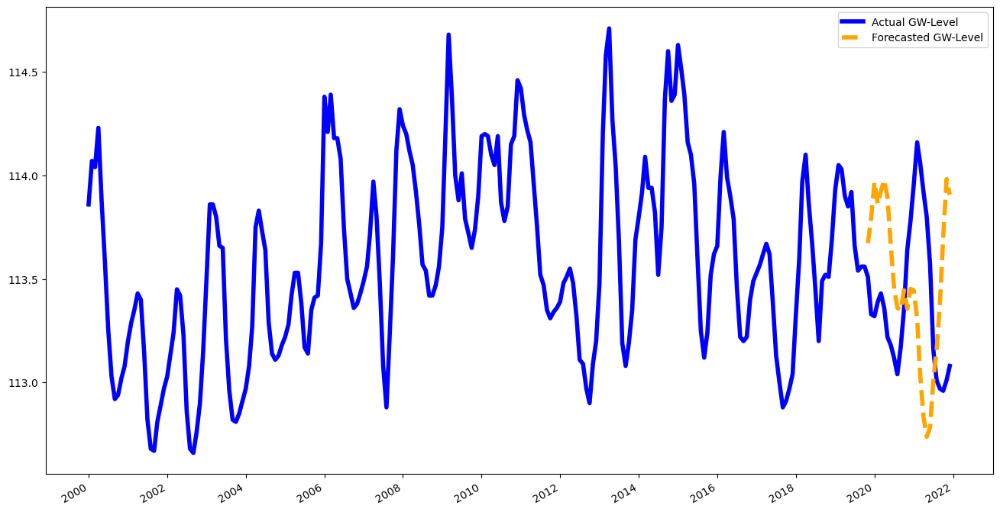



N train dates: 330
1989-01-01 00:00:00 till 2019-03-01 00:00:00
N forecast dates (horizon): 20
2019-11-01 00:00:00 till 2021-12-01 00:00:00
> SMAPE Score: 0.144136
First timepoint: 1989-01-01 00:00:00
Last timepoint:	 2021-12-01 00:00:00


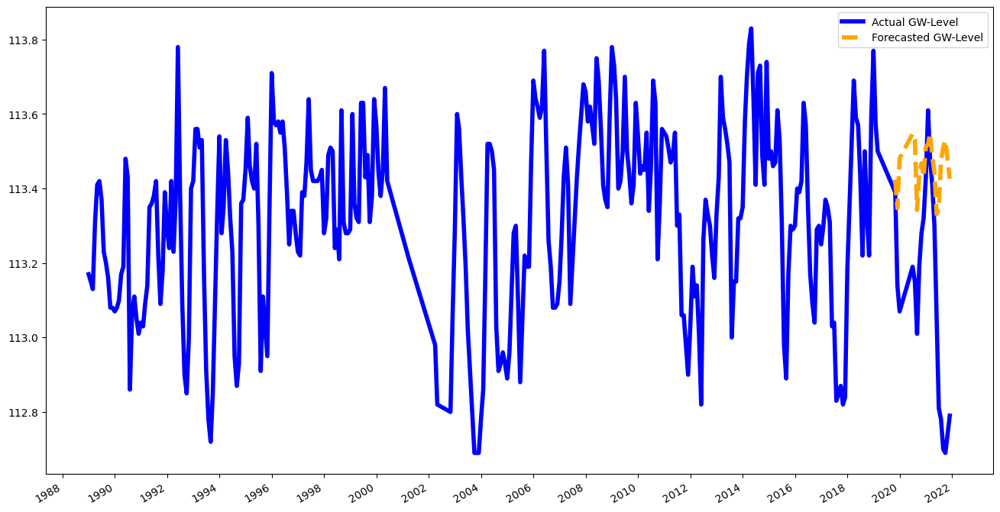



N train dates: 310
1994-01-01 00:00:00 till 2019-10-01 00:00:00
N forecast dates (horizon): 26
2019-11-01 00:00:00 till 2021-12-01 00:00:00
> SMAPE Score: 0.312635
First timepoint: 1994-01-01 00:00:00
Last timepoint:	 2021-12-01 00:00:00


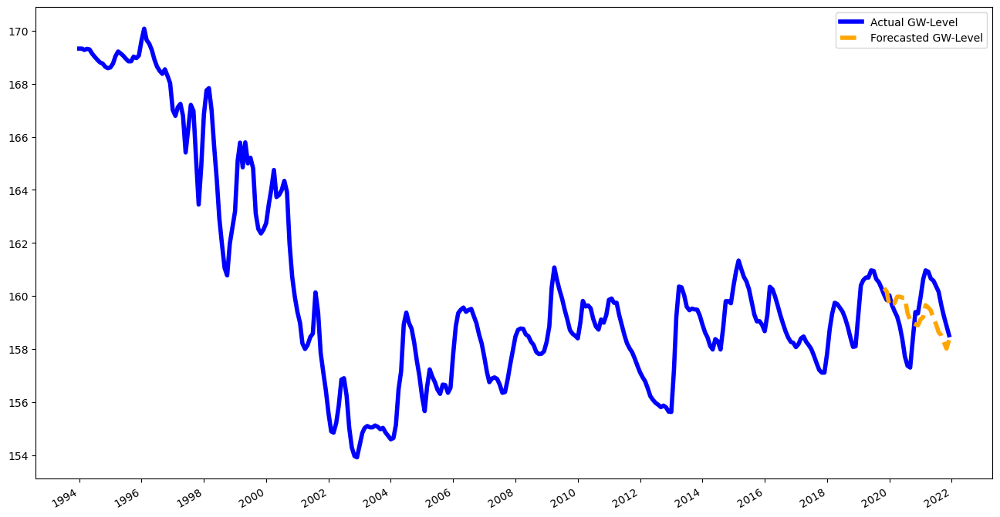



N train dates: 298
1995-01-01 00:00:00 till 2019-10-01 00:00:00
N forecast dates (horizon): 26
2019-11-01 00:00:00 till 2021-12-01 00:00:00
> SMAPE Score: 0.071349
First timepoint: 1995-01-01 00:00:00
Last timepoint:	 2021-12-01 00:00:00


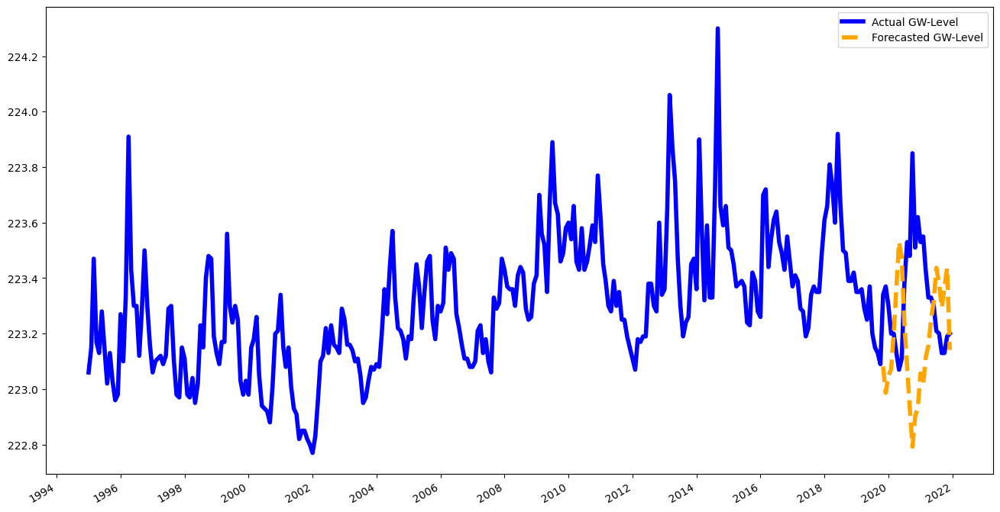



N train dates: 208
2002-07-01 00:00:00 till 2019-10-01 00:00:00
N forecast dates (horizon): 26
2019-11-01 00:00:00 till 2021-12-01 00:00:00
> SMAPE Score: 0.053143
First timepoint: 2002-07-01 00:00:00
Last timepoint:	 2021-12-01 00:00:00


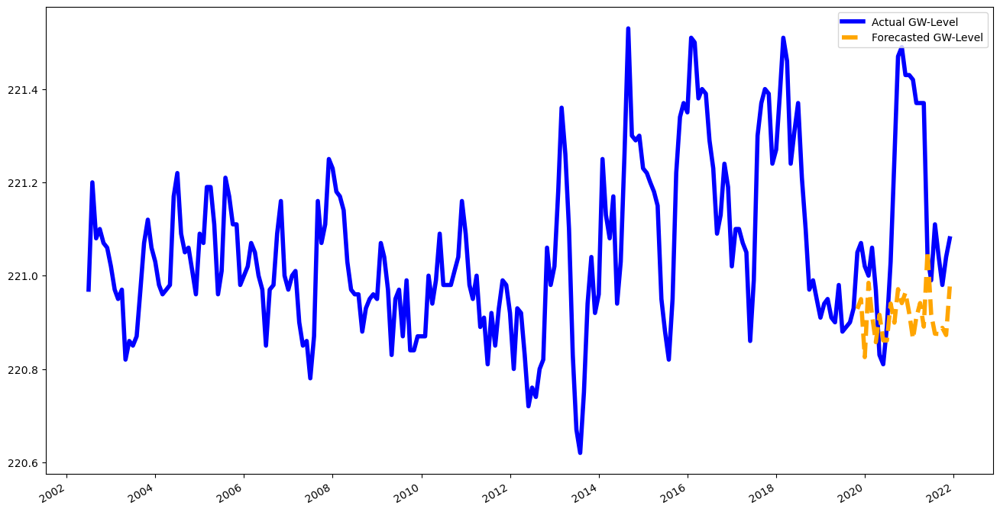



N train dates: 201
2003-01-01 00:00:00 till 2019-10-01 00:00:00
N forecast dates (horizon): 26
2019-11-01 00:00:00 till 2021-12-01 00:00:00
> SMAPE Score: 0.140726
First timepoint: 2003-01-01 00:00:00
Last timepoint:	 2021-12-01 00:00:00


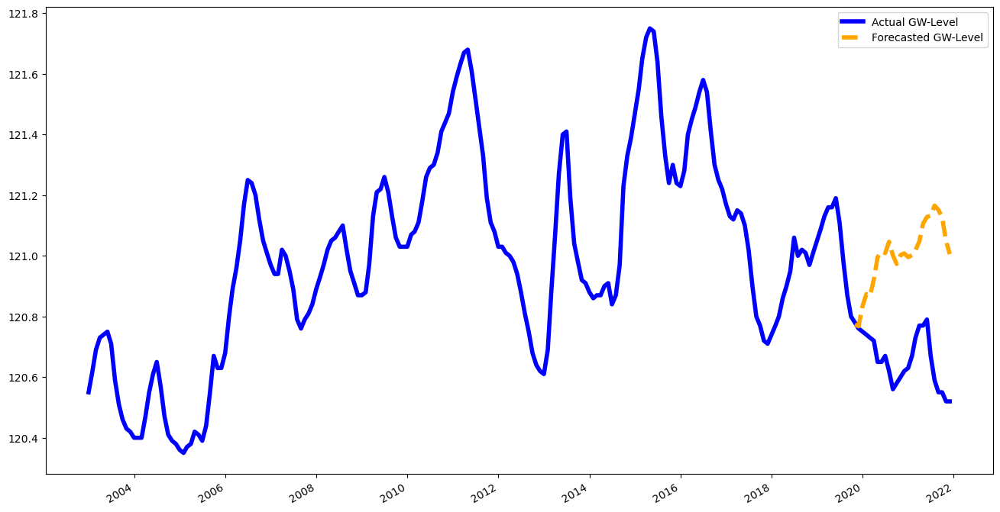



N train dates: 562
1972-01-01 00:00:00 till 2019-10-01 00:00:00
N forecast dates (horizon): 17
2019-11-01 00:00:00 till 2021-07-01 00:00:00
> SMAPE Score: 0.30722
First timepoint: 1972-01-01 00:00:00
Last timepoint:	 2021-07-01 00:00:00


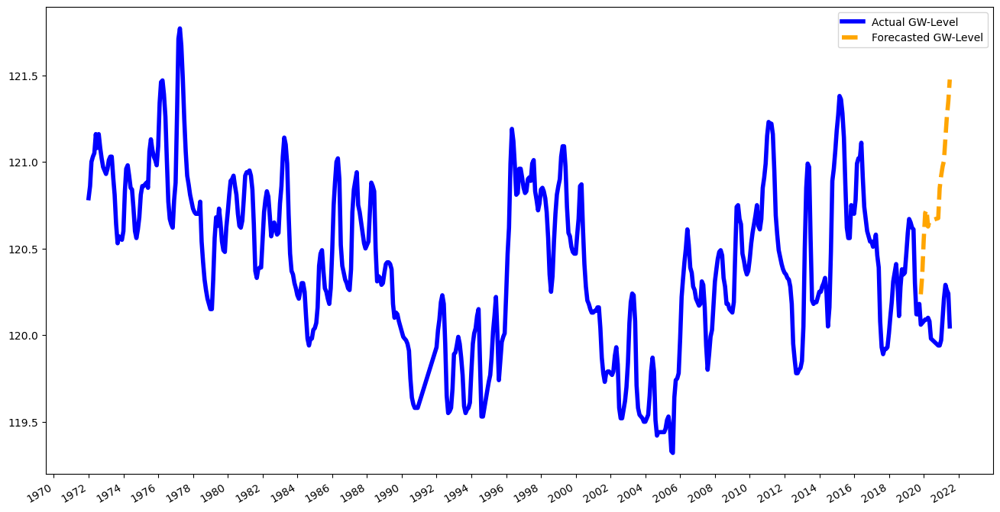



N train dates: 492
1978-10-01 00:00:00 till 2019-10-01 00:00:00
N forecast dates (horizon): 26
2019-11-01 00:00:00 till 2021-12-01 00:00:00
> SMAPE Score: 0.051233
First timepoint: 1978-10-01 00:00:00
Last timepoint:	 2021-12-01 00:00:00


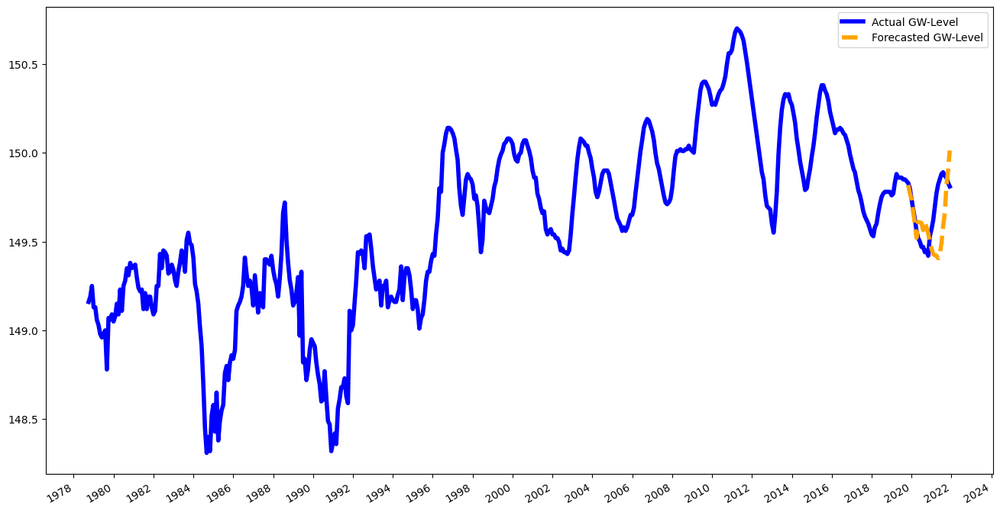



N train dates: 249
1999-01-01 00:00:00 till 2019-10-01 00:00:00
N forecast dates (horizon): 26
2019-11-01 00:00:00 till 2021-12-01 00:00:00
> SMAPE Score: 0.079365
First timepoint: 1999-01-01 00:00:00
Last timepoint:	 2021-12-01 00:00:00


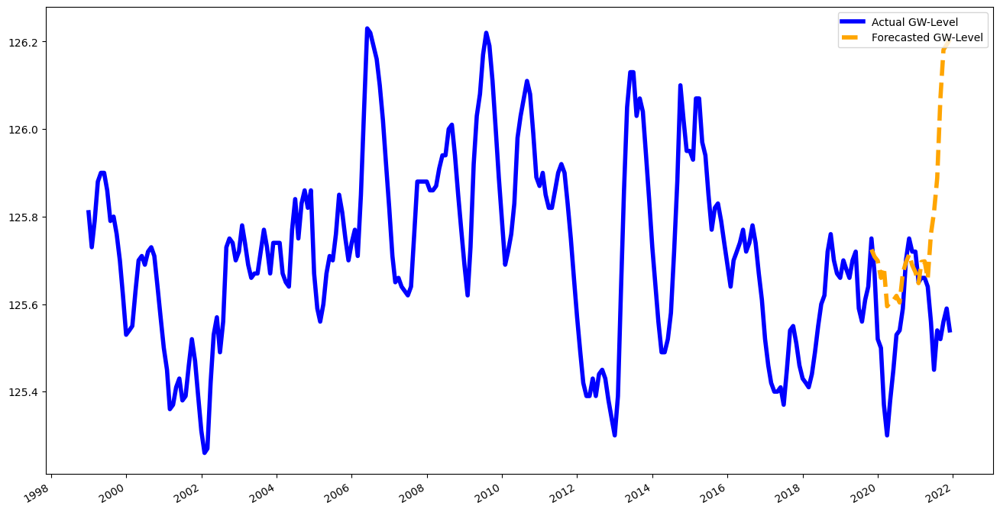



N train dates: 453
1982-02-01 00:00:00 till 2019-10-01 00:00:00
N forecast dates (horizon): 26
2019-11-01 00:00:00 till 2021-12-01 00:00:00
> SMAPE Score: 0.025343
First timepoint: 1982-02-01 00:00:00
Last timepoint:	 2021-12-01 00:00:00


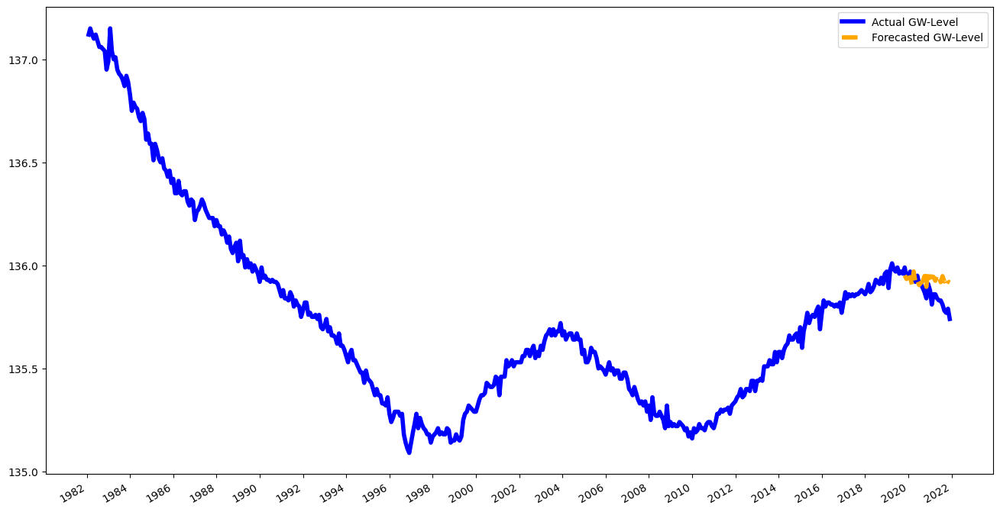



N train dates: 777
1953-12-01 00:00:00 till 2019-10-01 00:00:00
N forecast dates (horizon): 14
2019-11-01 00:00:00 till 2021-07-01 00:00:00
> SMAPE Score: 0.049594
First timepoint: 1953-12-01 00:00:00
Last timepoint:	 2021-07-01 00:00:00


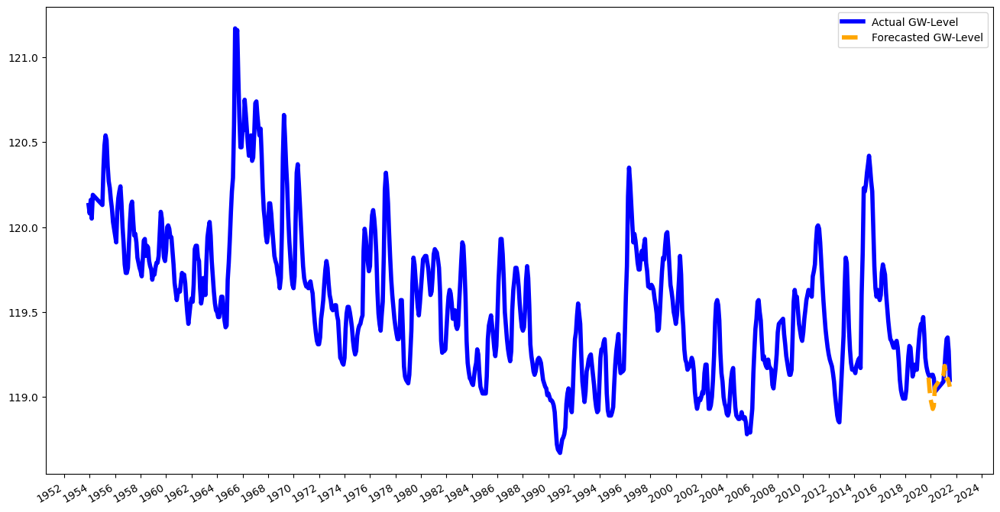



N train dates: 482
1979-05-01 00:00:00 till 2019-10-01 00:00:00
N forecast dates (horizon): 26
2019-11-01 00:00:00 till 2021-12-01 00:00:00
> SMAPE Score: 0.07313
First timepoint: 1979-05-01 00:00:00
Last timepoint:	 2021-12-01 00:00:00


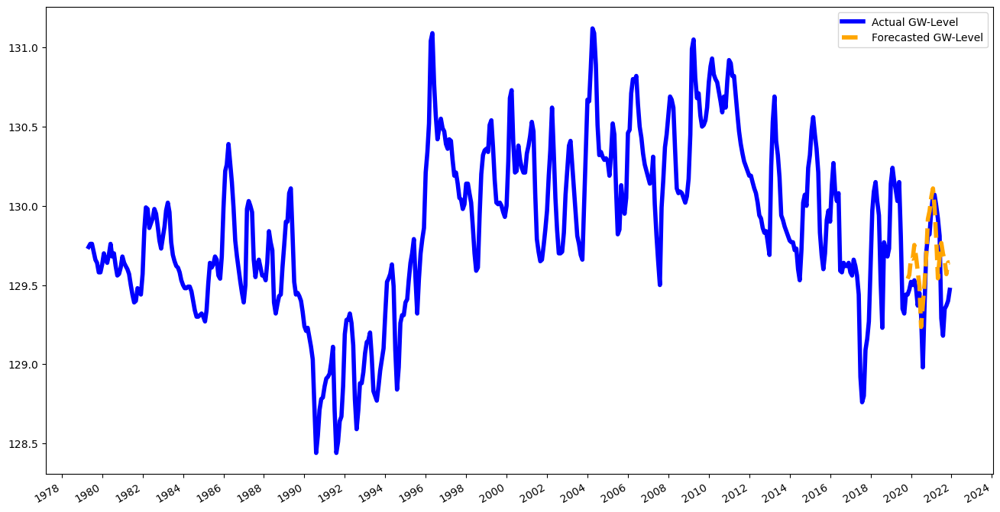



N train dates: 322
1960-01-01 00:00:00 till 2019-10-01 00:00:00
N forecast dates (horizon): 26
2019-11-01 00:00:00 till 2021-12-01 00:00:00
> SMAPE Score: 0.091615
First timepoint: 1960-01-01 00:00:00
Last timepoint:	 2021-12-01 00:00:00


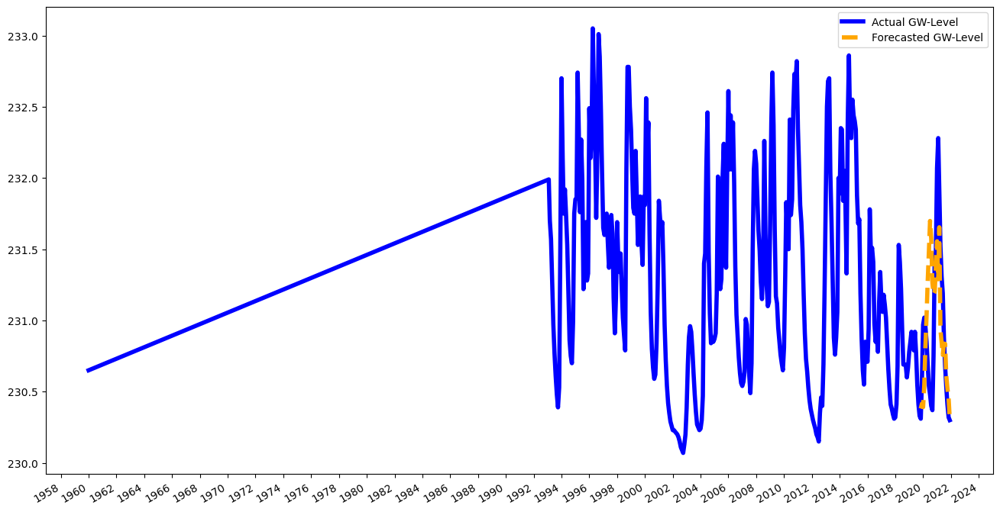



N train dates: 331
1989-01-01 00:00:00 till 2019-03-01 00:00:00
N forecast dates (horizon): 17
2019-11-01 00:00:00 till 2021-12-01 00:00:00
> SMAPE Score: 0.125757
First timepoint: 1989-01-01 00:00:00
Last timepoint:	 2021-12-01 00:00:00


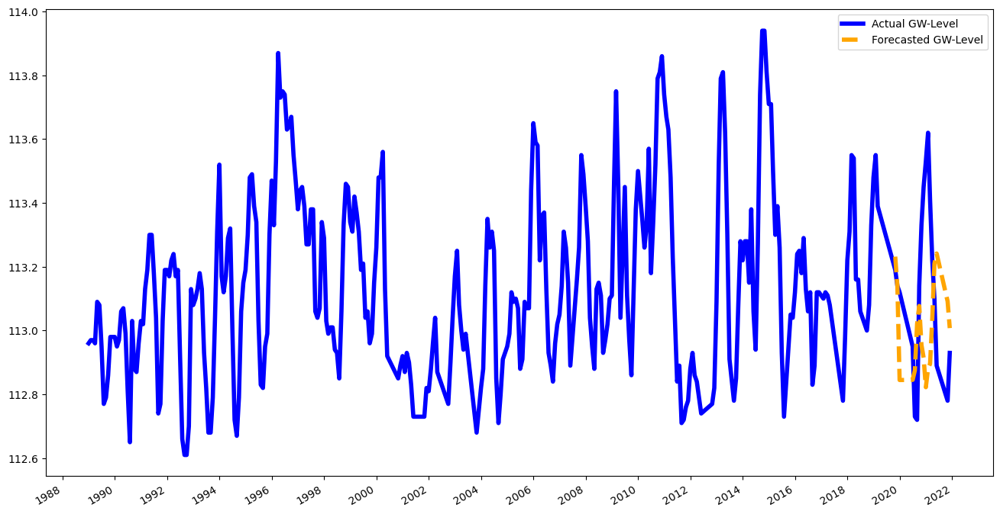



N train dates: 293
1995-01-01 00:00:00 till 2019-10-01 00:00:00
N forecast dates (horizon): 26
2019-11-01 00:00:00 till 2021-12-01 00:00:00
> SMAPE Score: 0.044601
First timepoint: 1995-01-01 00:00:00
Last timepoint:	 2021-12-01 00:00:00


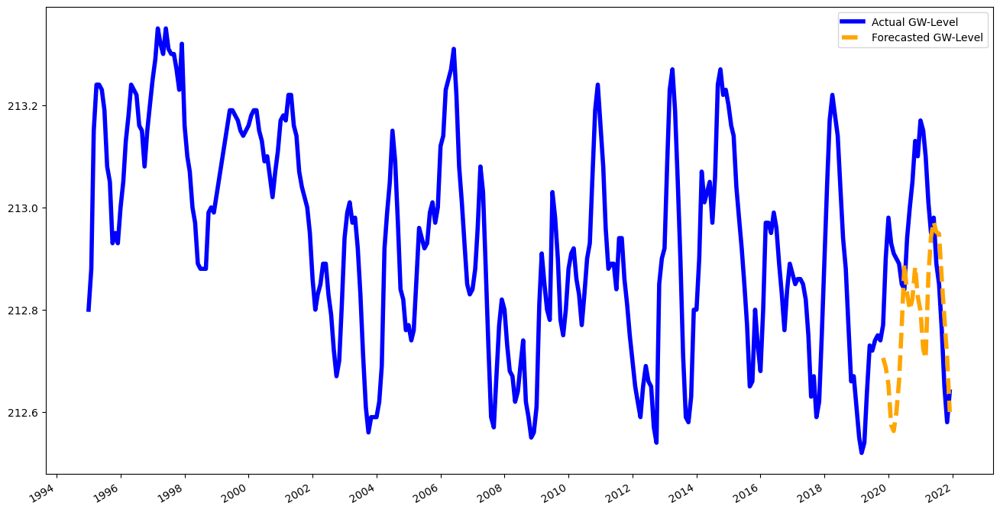



N train dates: 609
1969-01-01 00:00:00 till 2019-10-01 00:00:00
N forecast dates (horizon): 26
2019-11-01 00:00:00 till 2021-12-01 00:00:00
> SMAPE Score: 0.070583
First timepoint: 1969-01-01 00:00:00
Last timepoint:	 2021-12-01 00:00:00


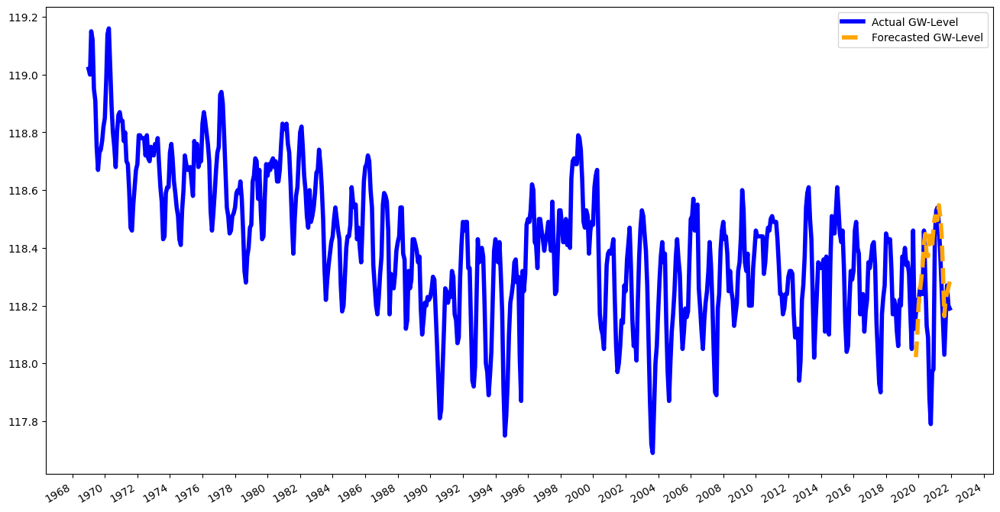



N train dates: 386
1987-08-01 00:00:00 till 2019-10-01 00:00:00
N forecast dates (horizon): 26
2019-11-01 00:00:00 till 2021-12-01 00:00:00
> SMAPE Score: 0.089557
First timepoint: 1987-08-01 00:00:00
Last timepoint:	 2021-12-01 00:00:00


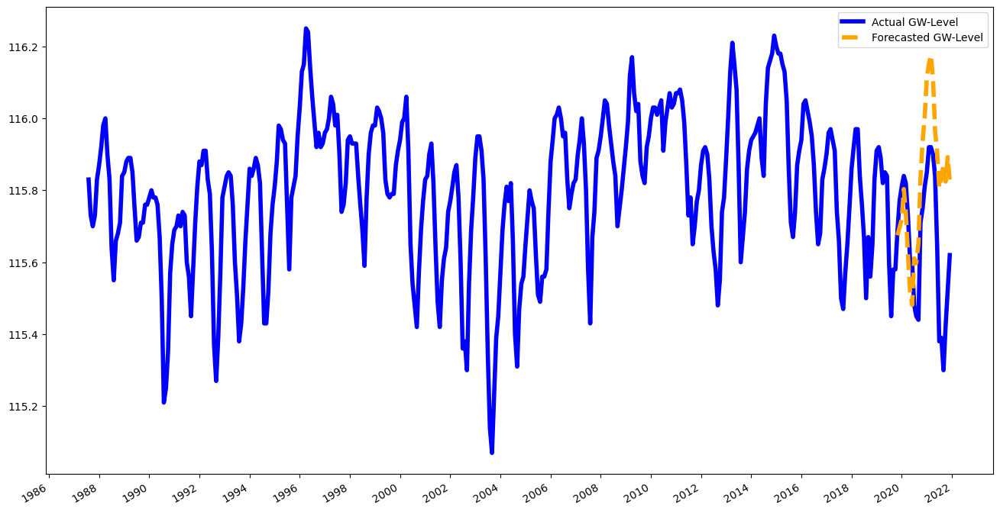



N train dates: 226
2001-01-01 00:00:00 till 2019-10-01 00:00:00
N forecast dates (horizon): 26
2019-11-01 00:00:00 till 2021-12-01 00:00:00
> SMAPE Score: 0.132073
First timepoint: 2001-01-01 00:00:00
Last timepoint:	 2021-12-01 00:00:00


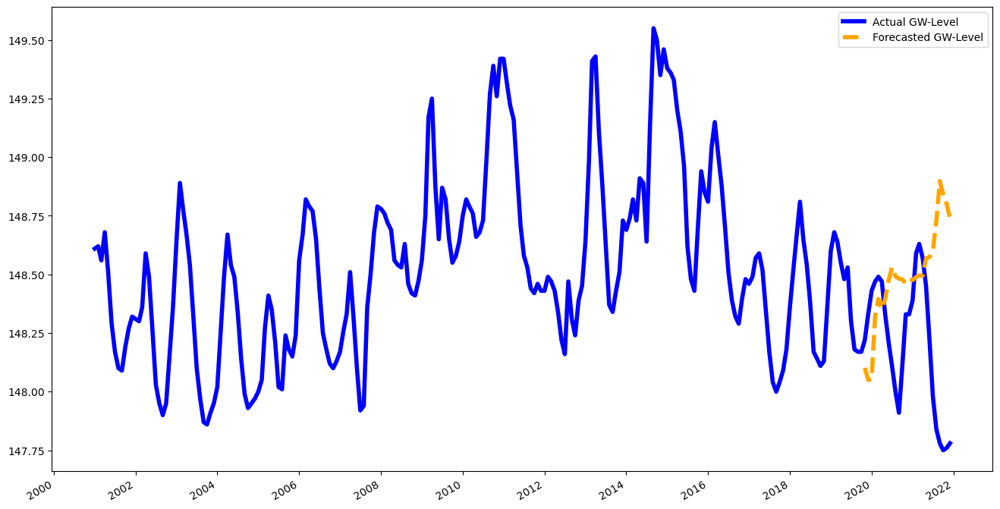



N train dates: 660
1962-08-01 00:00:00 till 2019-10-01 00:00:00
N forecast dates (horizon): 17
2019-11-01 00:00:00 till 2021-12-01 00:00:00
> SMAPE Score: 0.21172
First timepoint: 1962-08-01 00:00:00
Last timepoint:	 2021-12-01 00:00:00


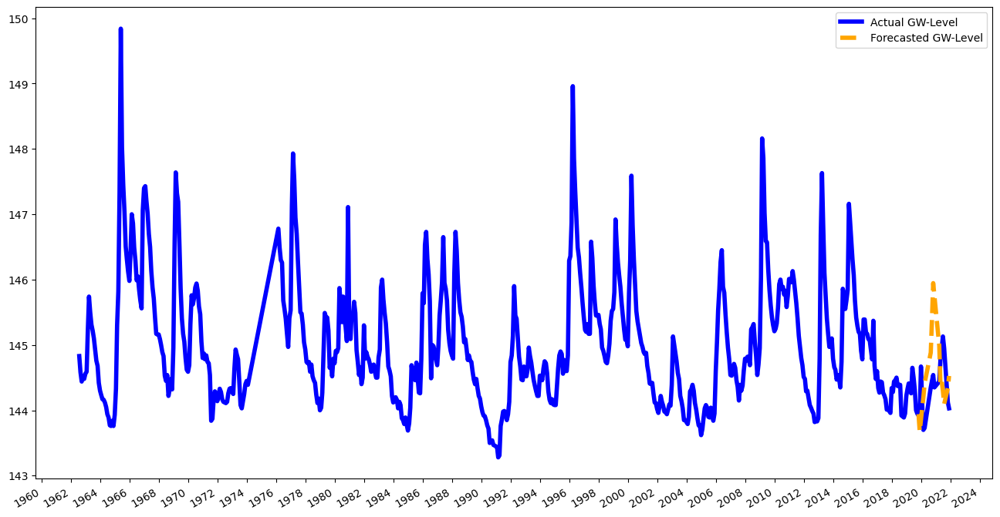



N train dates: 260
1998-03-01 00:00:00 till 2019-10-01 00:00:00
N forecast dates (horizon): 26
2019-11-01 00:00:00 till 2021-12-01 00:00:00
> SMAPE Score: 0.061414
First timepoint: 1998-03-01 00:00:00
Last timepoint:	 2021-12-01 00:00:00


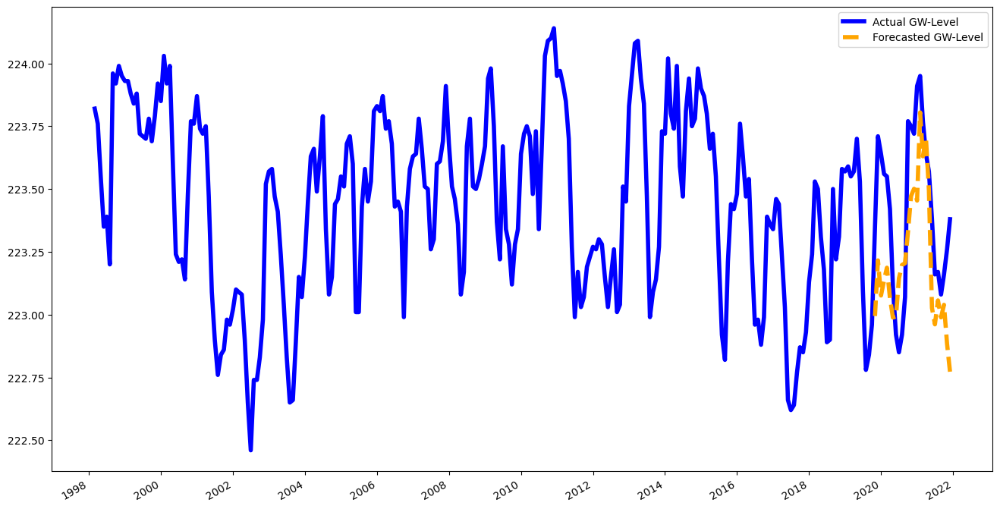



N train dates: 272
1997-01-01 00:00:00 till 2019-10-01 00:00:00
N forecast dates (horizon): 26
2019-11-01 00:00:00 till 2021-12-01 00:00:00
> SMAPE Score: 0.090306
First timepoint: 1997-01-01 00:00:00
Last timepoint:	 2021-12-01 00:00:00


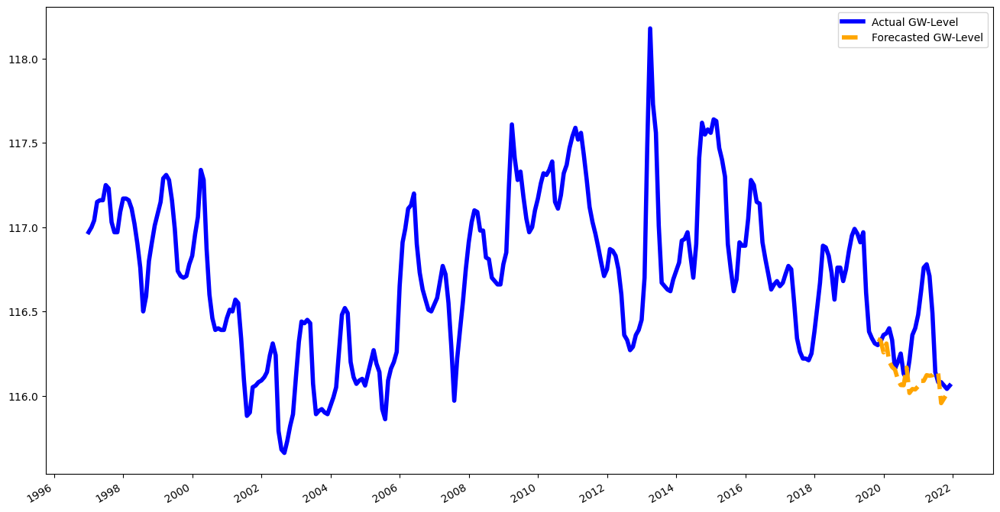



N train dates: 272
1997-01-01 00:00:00 till 2019-10-01 00:00:00
N forecast dates (horizon): 26
2019-11-01 00:00:00 till 2021-12-01 00:00:00
> SMAPE Score: 0.260201
First timepoint: 1997-01-01 00:00:00
Last timepoint:	 2021-12-01 00:00:00


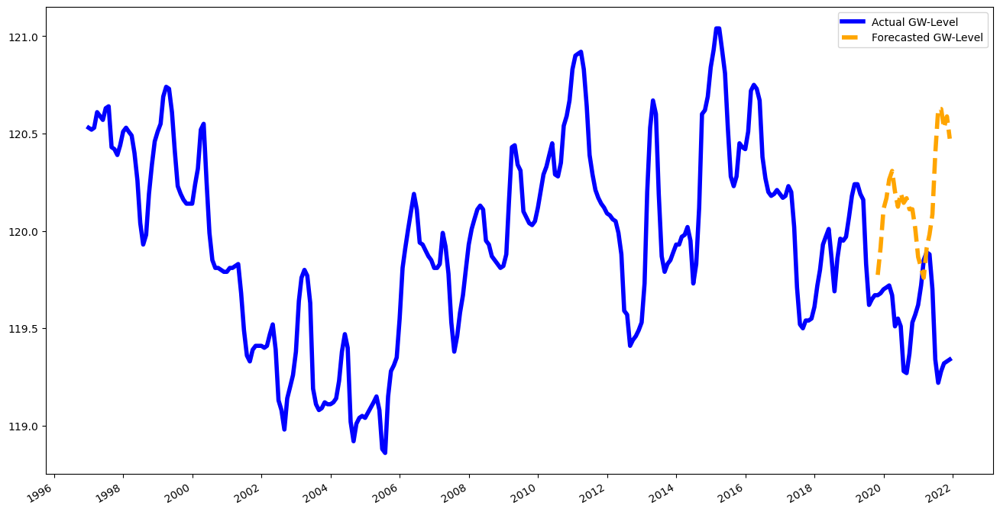



N train dates: 35
2016-07-01 00:00:00 till 2019-05-01 00:00:00
N forecast dates (horizon): 22
2020-03-01 00:00:00 till 2021-12-01 00:00:00
> SMAPE Score: 0.045682
First timepoint: 2016-07-01 00:00:00
Last timepoint:	 2021-12-01 00:00:00


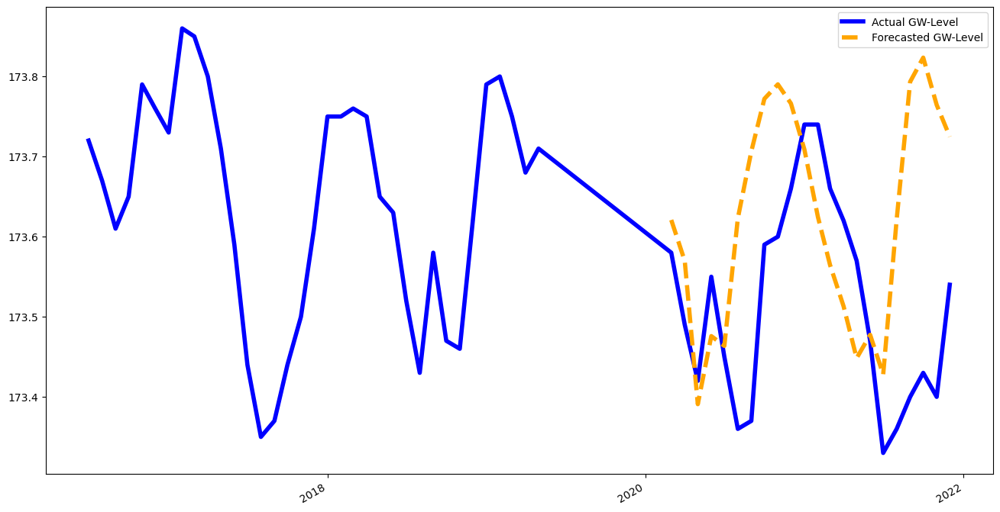



N train dates: 291
1995-08-01 00:00:00 till 2019-10-01 00:00:00
N forecast dates (horizon): 26
2019-11-01 00:00:00 till 2021-12-01 00:00:00
> SMAPE Score: 0.070799
First timepoint: 1995-08-01 00:00:00
Last timepoint:	 2021-12-01 00:00:00


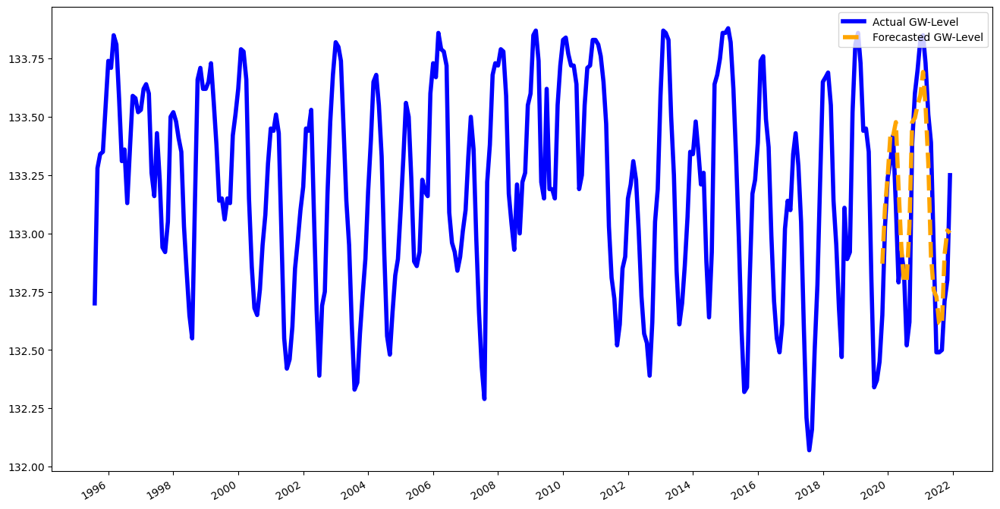



N train dates: 646
1966-01-01 00:00:00 till 2019-10-01 00:00:00
N forecast dates (horizon): 26
2019-11-01 00:00:00 till 2021-12-01 00:00:00
> SMAPE Score: 0.267362
First timepoint: 1966-01-01 00:00:00
Last timepoint:	 2021-12-01 00:00:00


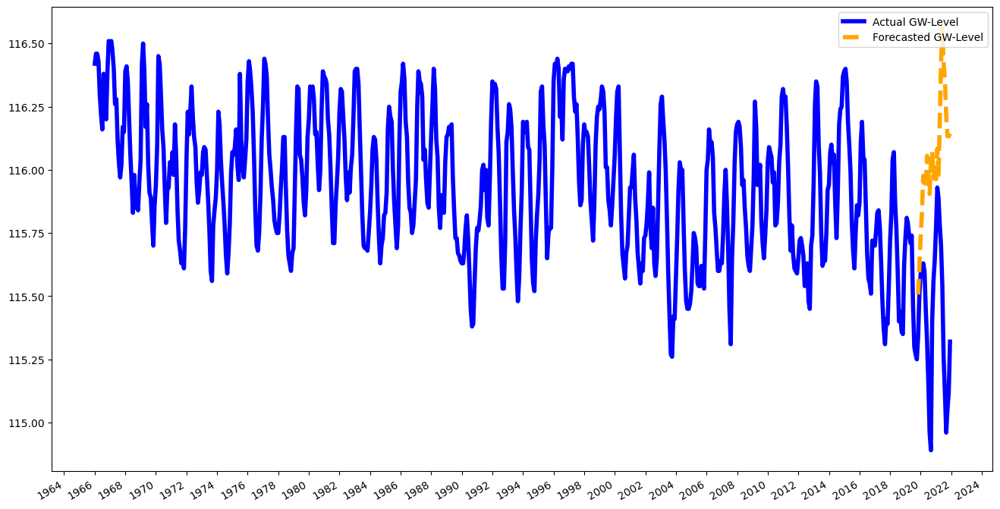



N train dates: 377
1988-01-01 00:00:00 till 2019-10-01 00:00:00
N forecast dates (horizon): 26
2019-11-01 00:00:00 till 2021-12-01 00:00:00
> SMAPE Score: 0.012944
First timepoint: 1988-01-01 00:00:00
Last timepoint:	 2021-12-01 00:00:00


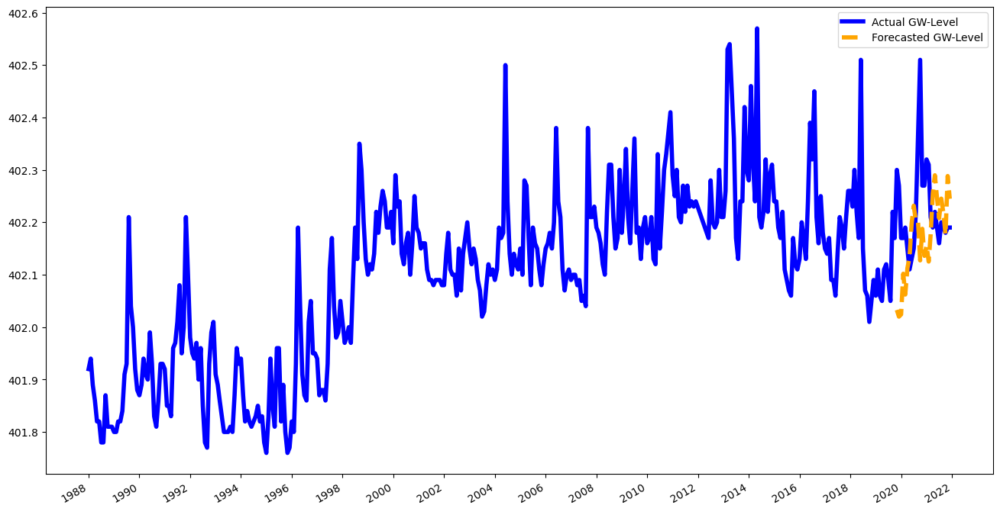



N train dates: 679
1963-04-01 00:00:00 till 2019-10-01 00:00:00
N forecast dates (horizon): 26
2019-11-01 00:00:00 till 2021-12-01 00:00:00
> SMAPE Score: 0.122401
First timepoint: 1963-04-01 00:00:00
Last timepoint:	 2021-12-01 00:00:00


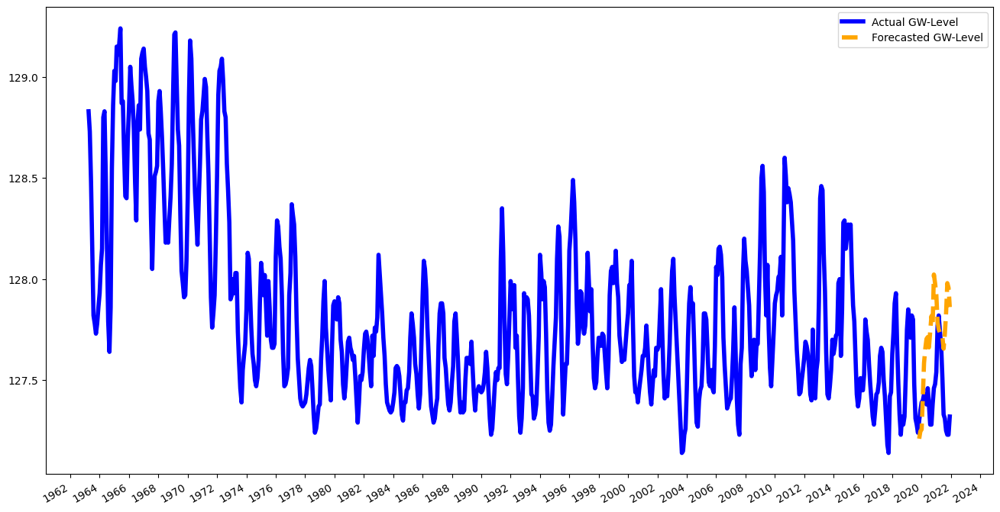



N train dates: 750
1956-11-01 00:00:00 till 2019-10-01 00:00:00
N forecast dates (horizon): 26
2019-11-01 00:00:00 till 2021-12-01 00:00:00
> SMAPE Score: 0.148297
First timepoint: 1956-11-01 00:00:00
Last timepoint:	 2021-12-01 00:00:00


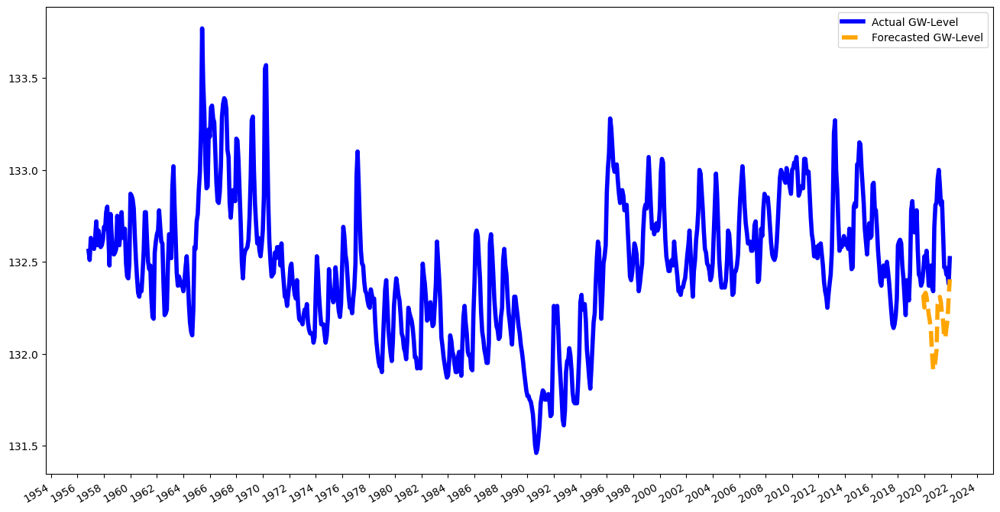



N train dates: 322
1993-01-01 00:00:00 till 2019-10-01 00:00:00
N forecast dates (horizon): 26
2019-11-01 00:00:00 till 2021-12-01 00:00:00
> SMAPE Score: 0.039942
First timepoint: 1993-01-01 00:00:00
Last timepoint:	 2021-12-01 00:00:00


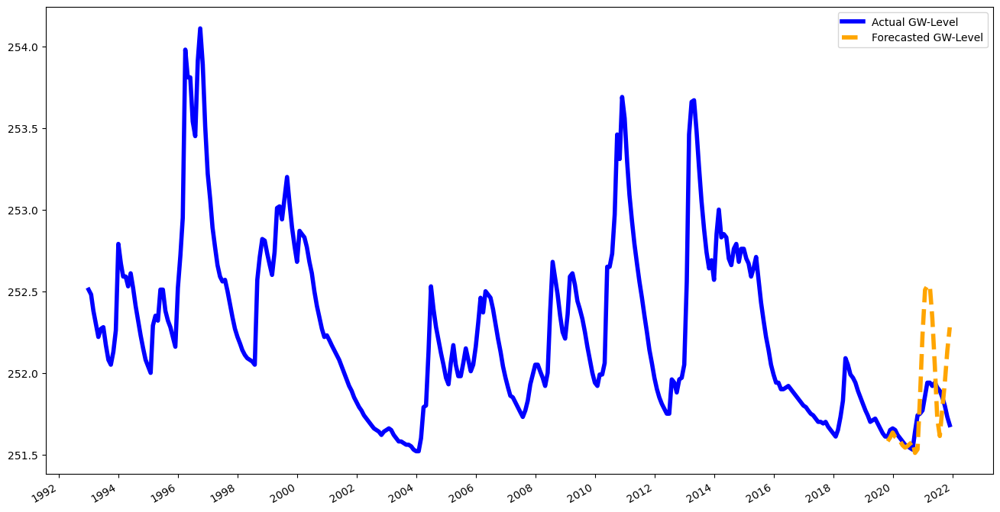



N train dates: 450
1981-11-01 00:00:00 till 2019-10-01 00:00:00
N forecast dates (horizon): 26
2019-11-01 00:00:00 till 2021-12-01 00:00:00
> SMAPE Score: 0.28416
First timepoint: 1981-11-01 00:00:00
Last timepoint:	 2021-12-01 00:00:00


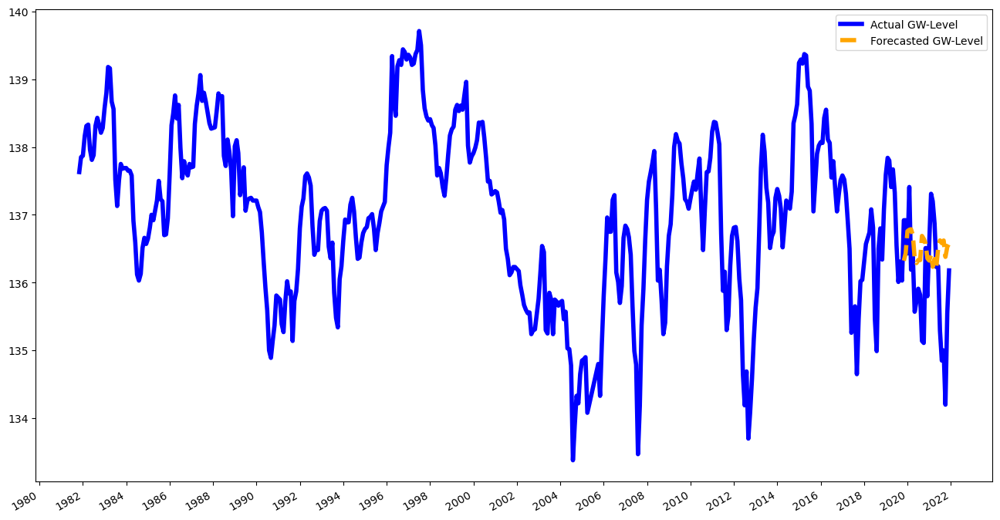



N train dates: 296
1995-01-01 00:00:00 till 2019-10-01 00:00:00
N forecast dates (horizon): 26
2019-11-01 00:00:00 till 2021-12-01 00:00:00
> SMAPE Score: 0.041853
First timepoint: 1995-01-01 00:00:00
Last timepoint:	 2021-12-01 00:00:00


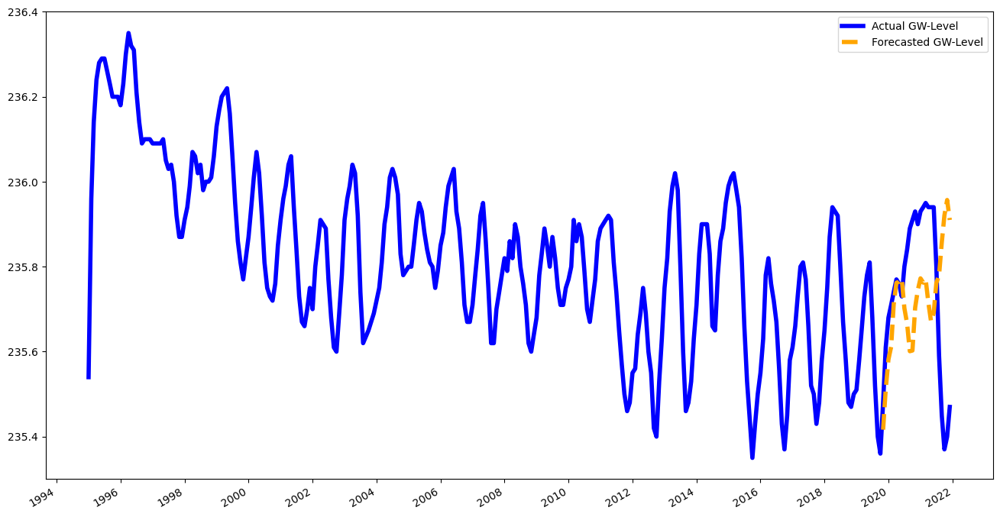



N train dates: 659
1962-12-01 00:00:00 till 2019-10-01 00:00:00
N forecast dates (horizon): 26
2019-11-01 00:00:00 till 2021-12-01 00:00:00
> SMAPE Score: 0.07162
First timepoint: 1962-12-01 00:00:00
Last timepoint:	 2021-12-01 00:00:00


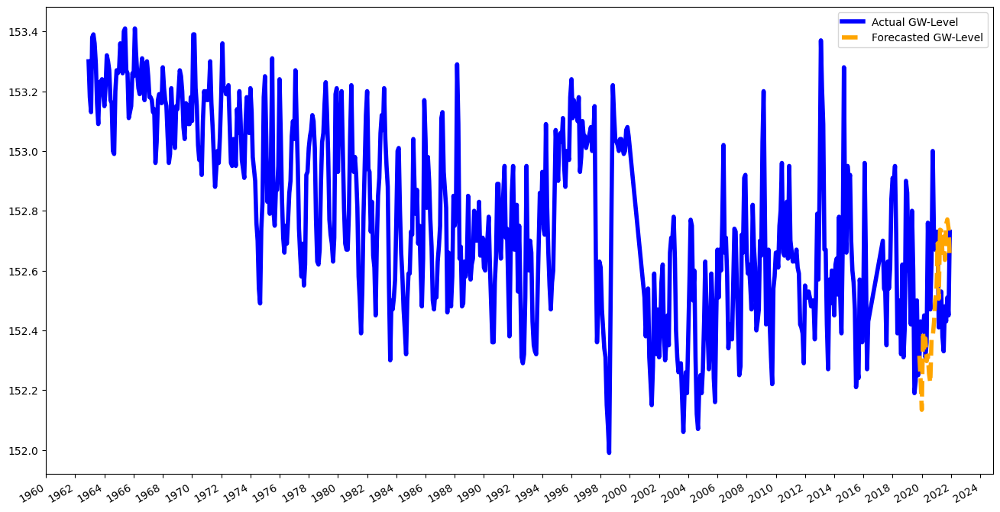



N train dates: 248
1999-01-01 00:00:00 till 2019-10-01 00:00:00
N forecast dates (horizon): 26
2019-11-01 00:00:00 till 2021-12-01 00:00:00
> SMAPE Score: 0.066697
First timepoint: 1999-01-01 00:00:00
Last timepoint:	 2021-12-01 00:00:00


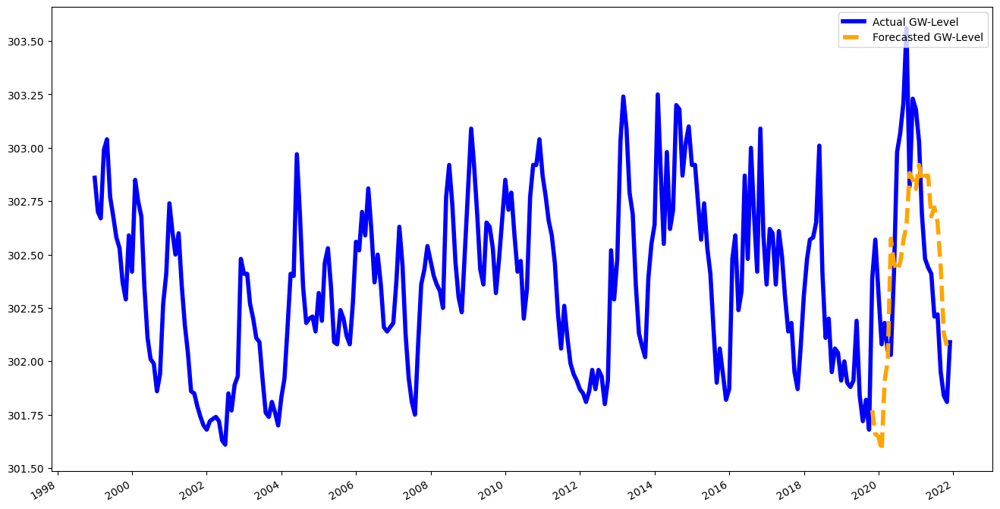



N train dates: 177
2005-02-01 00:00:00 till 2019-10-01 00:00:00
N forecast dates (horizon): 26
2019-11-01 00:00:00 till 2021-12-01 00:00:00
> SMAPE Score: 0.152935
First timepoint: 2005-02-01 00:00:00
Last timepoint:	 2021-12-01 00:00:00


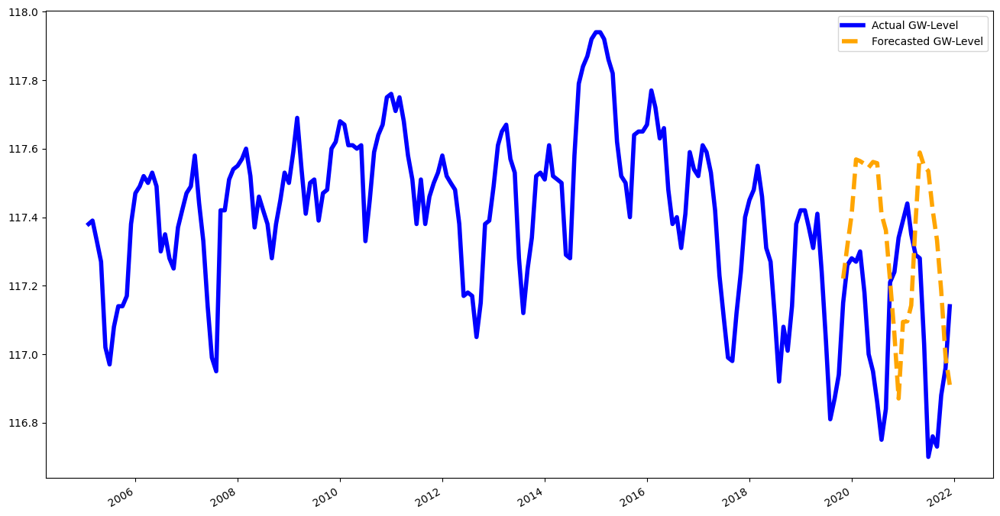



N train dates: 320
1993-01-01 00:00:00 till 2019-10-01 00:00:00
N forecast dates (horizon): 26
2019-11-01 00:00:00 till 2021-12-01 00:00:00
> SMAPE Score: 0.083521
First timepoint: 1993-01-01 00:00:00
Last timepoint:	 2021-12-01 00:00:00


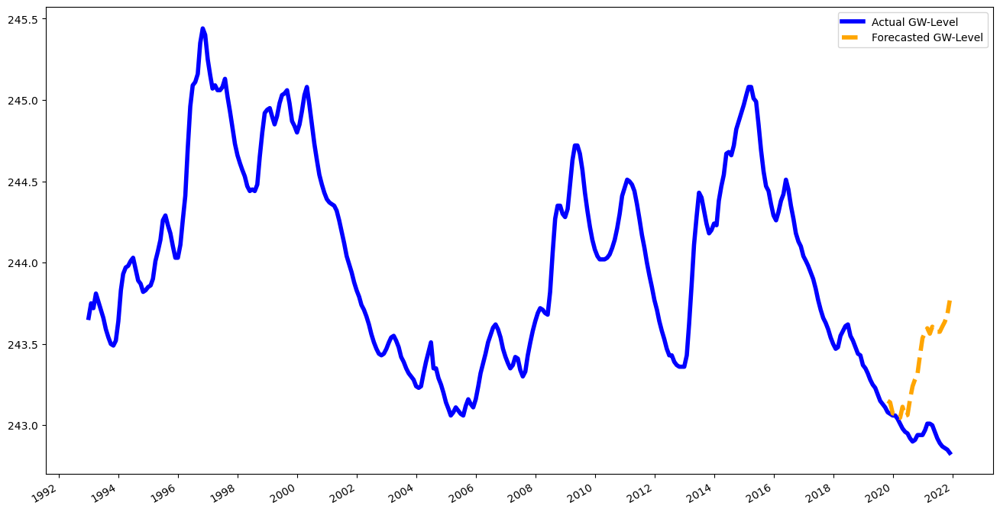



N train dates: 202
2003-01-01 00:00:00 till 2019-10-01 00:00:00
N forecast dates (horizon): 26
2019-11-01 00:00:00 till 2021-12-01 00:00:00
> SMAPE Score: 0.163456
First timepoint: 2003-01-01 00:00:00
Last timepoint:	 2021-12-01 00:00:00


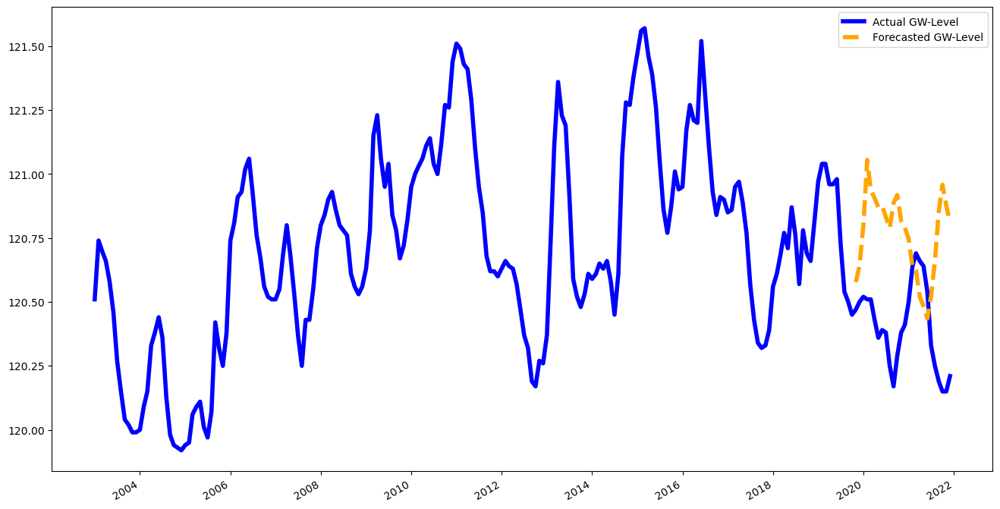



N train dates: 145
1959-12-01 00:00:00 till 2019-10-01 00:00:00
N forecast dates (horizon): 26
2019-11-01 00:00:00 till 2021-12-01 00:00:00
> SMAPE Score: 0.109387
First timepoint: 1959-12-01 00:00:00
Last timepoint:	 2021-12-01 00:00:00


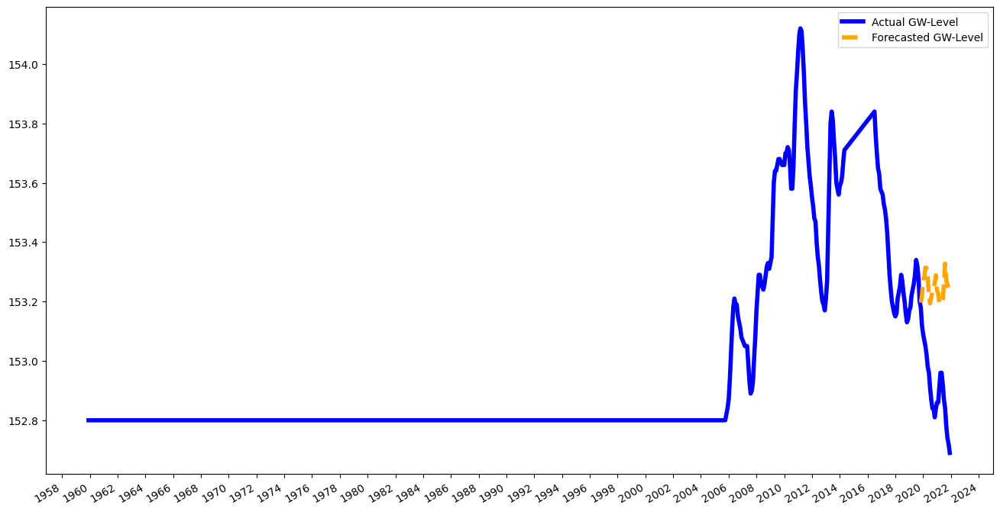



N train dates: 370
1989-01-01 00:00:00 till 2019-10-01 00:00:00
N forecast dates (horizon): 26
2019-11-01 00:00:00 till 2021-12-01 00:00:00
> SMAPE Score: 0.209588
First timepoint: 1989-01-01 00:00:00
Last timepoint:	 2021-12-01 00:00:00


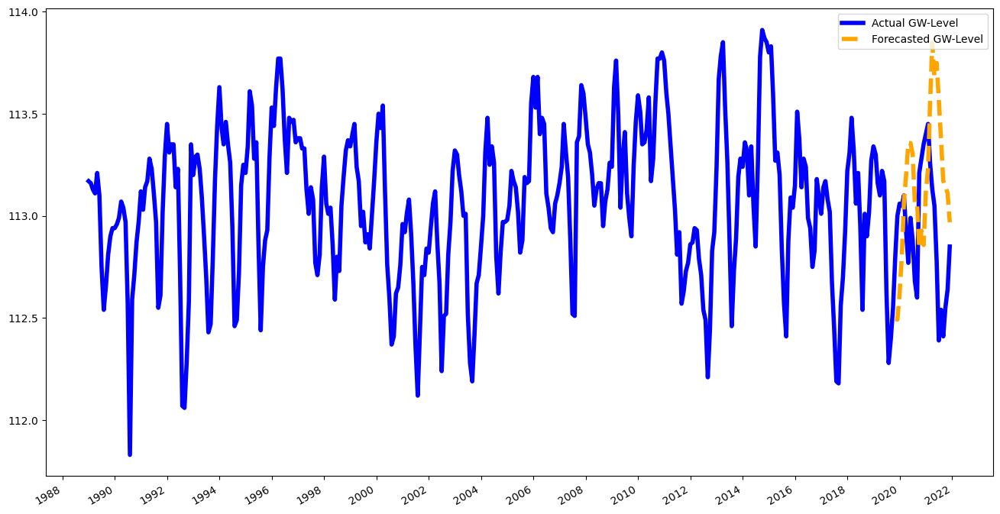



N train dates: 36
2016-11-01 00:00:00 till 2019-10-01 00:00:00
N forecast dates (horizon): 26
2019-11-01 00:00:00 till 2021-12-01 00:00:00
> SMAPE Score: 0.048523
First timepoint: 2016-11-01 00:00:00
Last timepoint:	 2021-12-01 00:00:00


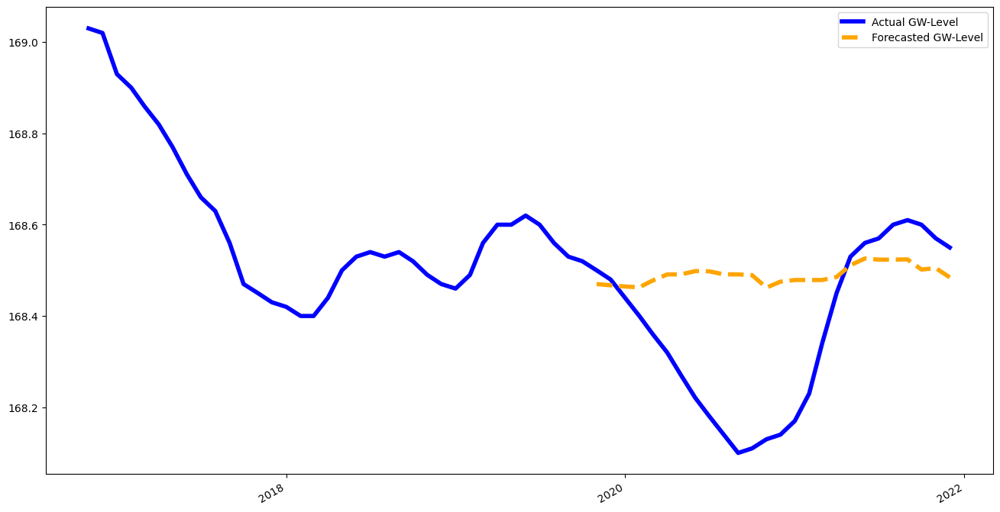



N train dates: 165
2006-01-01 00:00:00 till 2019-10-01 00:00:00
N forecast dates (horizon): 26
2019-11-01 00:00:00 till 2021-12-01 00:00:00
> SMAPE Score: 0.262457
First timepoint: 2006-01-01 00:00:00
Last timepoint:	 2021-12-01 00:00:00


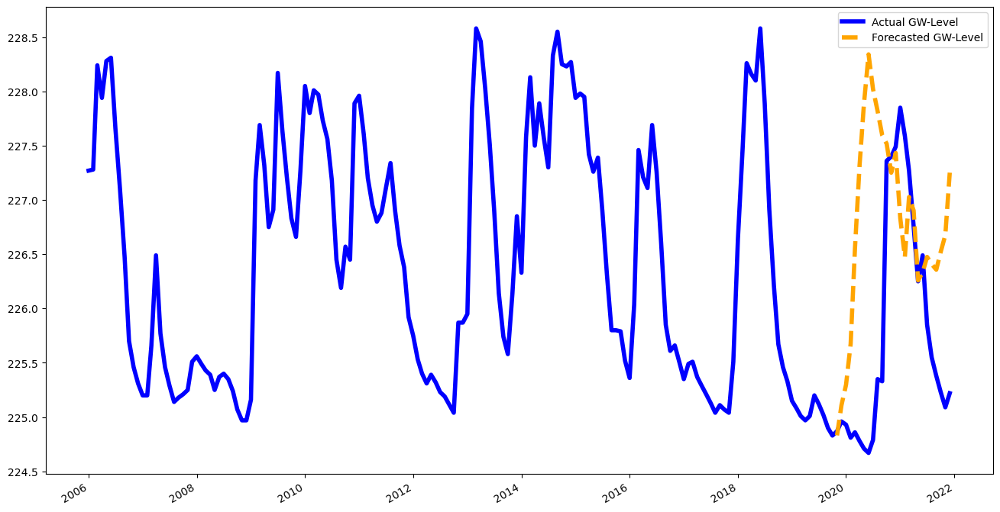



N train dates: 158
2006-02-01 00:00:00 till 2019-09-01 00:00:00
N forecast dates (horizon): 17
2020-08-01 00:00:00 till 2021-12-01 00:00:00
> SMAPE Score: 0.102335
First timepoint: 2006-02-01 00:00:00
Last timepoint:	 2021-12-01 00:00:00


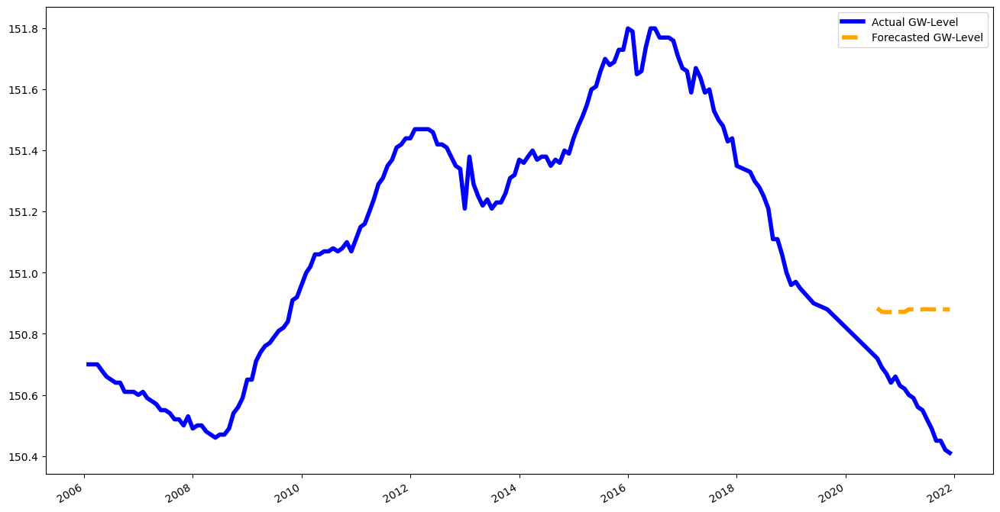



N train dates: 355
1989-01-01 00:00:00 till 2019-10-01 00:00:00
N forecast dates (horizon): 25
2019-11-01 00:00:00 till 2021-12-01 00:00:00
> SMAPE Score: 0.07719
First timepoint: 1989-01-01 00:00:00
Last timepoint:	 2021-12-01 00:00:00


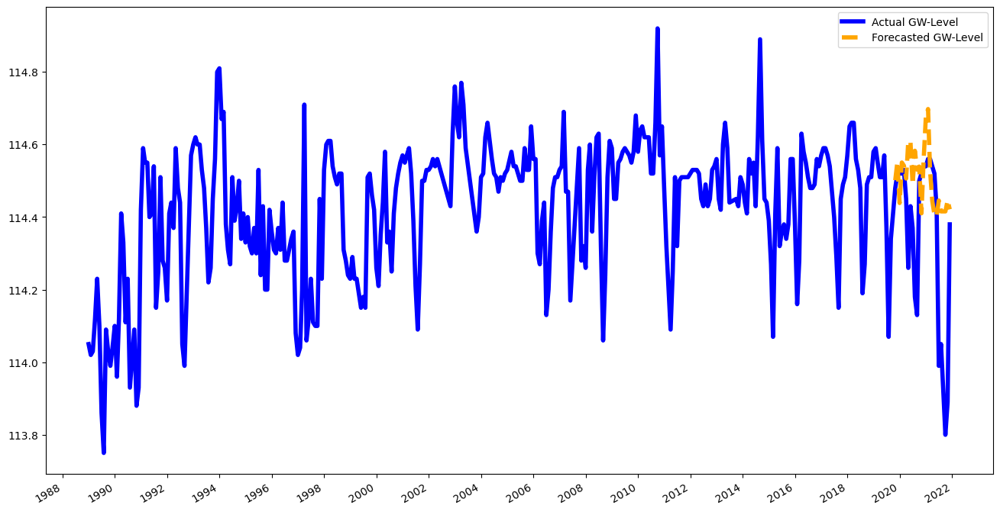



N train dates: 322
1993-01-01 00:00:00 till 2019-10-01 00:00:00
N forecast dates (horizon): 26
2019-11-01 00:00:00 till 2021-12-01 00:00:00
> SMAPE Score: 0.066753
First timepoint: 1993-01-01 00:00:00
Last timepoint:	 2021-12-01 00:00:00


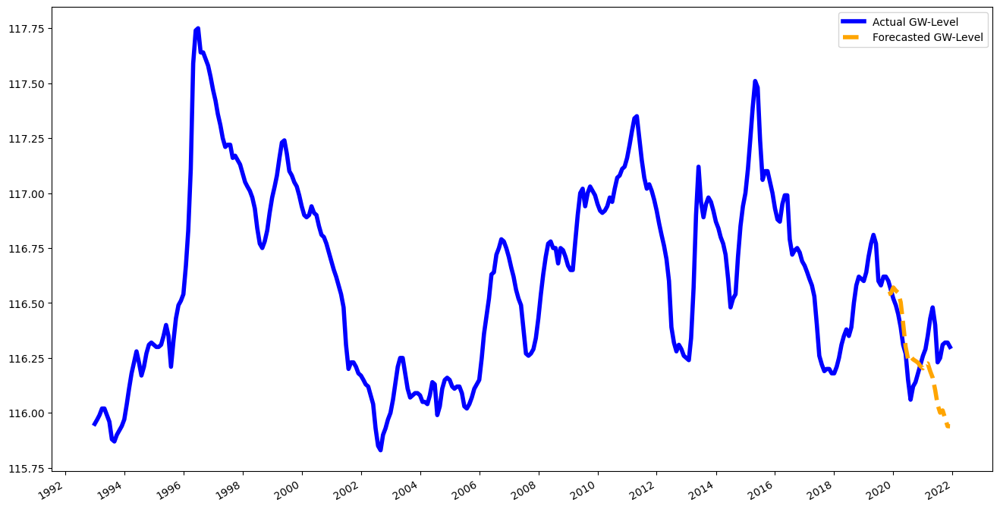



N train dates: 527
1975-11-01 00:00:00 till 2019-10-01 00:00:00
N forecast dates (horizon): 26
2019-11-01 00:00:00 till 2021-12-01 00:00:00
> SMAPE Score: 0.030684
First timepoint: 1975-11-01 00:00:00
Last timepoint:	 2021-12-01 00:00:00


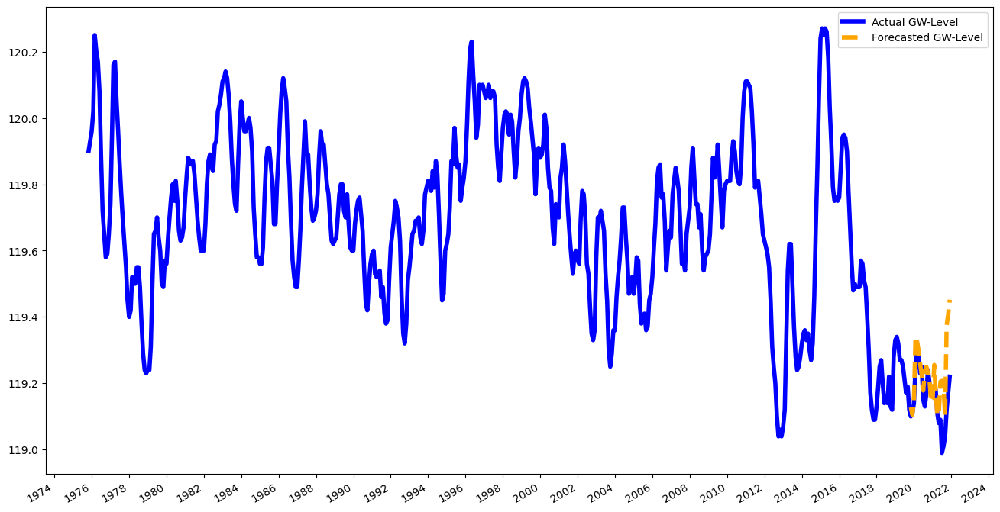



N train dates: 166
2003-09-01 00:00:00 till 2019-10-01 00:00:00
N forecast dates (horizon): 14
2019-11-01 00:00:00 till 2020-12-01 00:00:00
> SMAPE Score: 0.022461
First timepoint: 2003-09-01 00:00:00
Last timepoint:	 2020-12-01 00:00:00


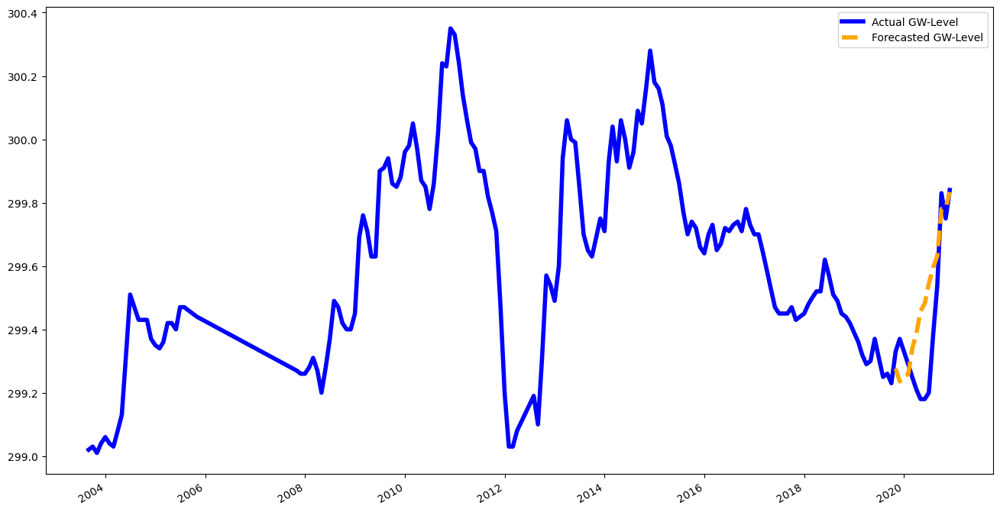



N train dates: 286
1996-01-01 00:00:00 till 2019-10-01 00:00:00
N forecast dates (horizon): 26
2019-11-01 00:00:00 till 2021-12-01 00:00:00
> SMAPE Score: 0.155482
First timepoint: 1996-01-01 00:00:00
Last timepoint:	 2021-12-01 00:00:00


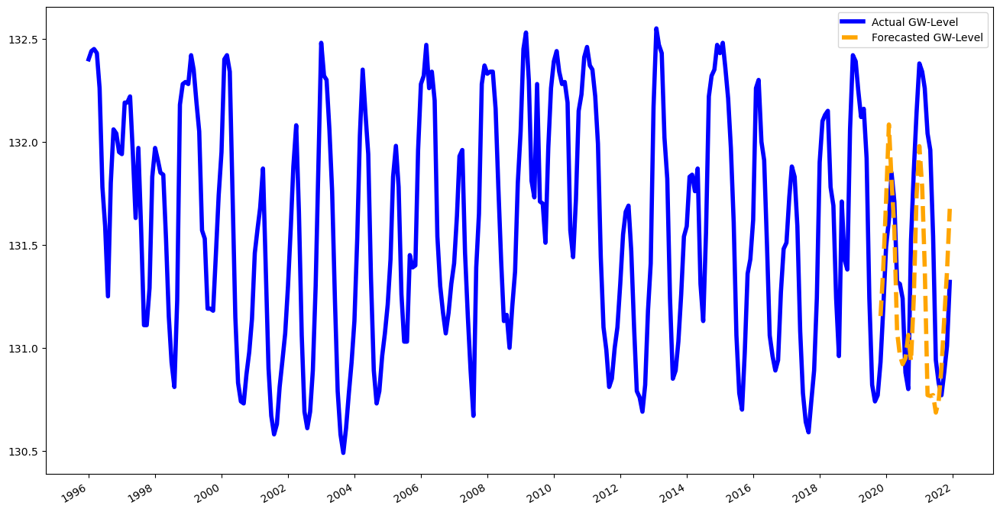



N train dates: 322
1993-01-01 00:00:00 till 2019-10-01 00:00:00
N forecast dates (horizon): 26
2019-11-01 00:00:00 till 2021-12-01 00:00:00
> SMAPE Score: 0.069223
First timepoint: 1993-01-01 00:00:00
Last timepoint:	 2021-12-01 00:00:00


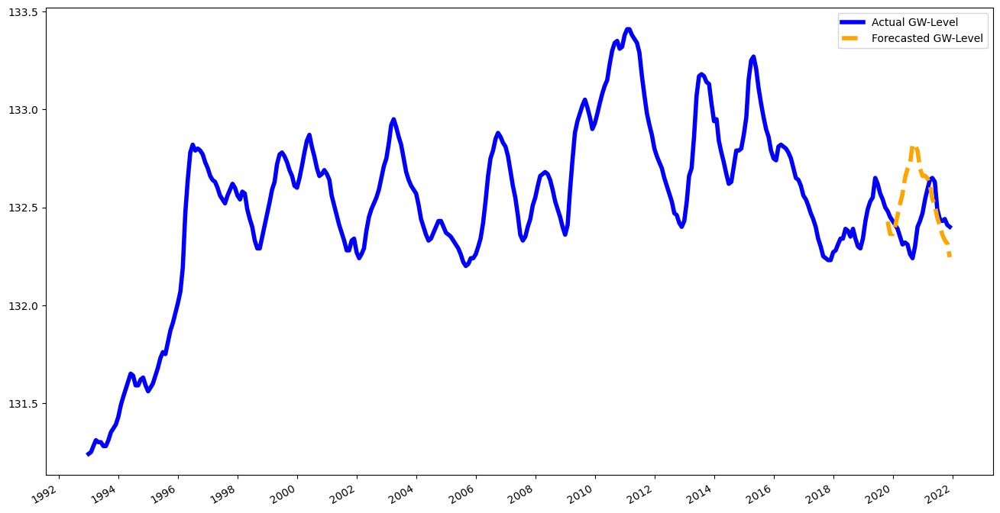



N train dates: 267
1997-02-01 00:00:00 till 2019-10-01 00:00:00
N forecast dates (horizon): 26
2019-11-01 00:00:00 till 2021-12-01 00:00:00
> SMAPE Score: 0.26383
First timepoint: 1997-02-01 00:00:00
Last timepoint:	 2021-12-01 00:00:00


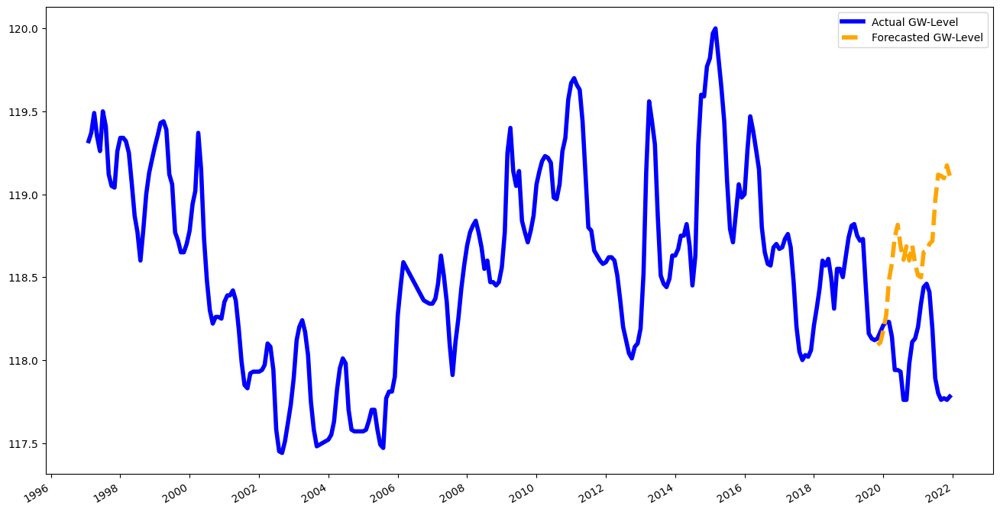



N train dates: 250
1999-01-01 00:00:00 till 2019-10-01 00:00:00
N forecast dates (horizon): 26
2019-11-01 00:00:00 till 2021-12-01 00:00:00
> SMAPE Score: 0.051005
First timepoint: 1999-01-01 00:00:00
Last timepoint:	 2021-12-01 00:00:00


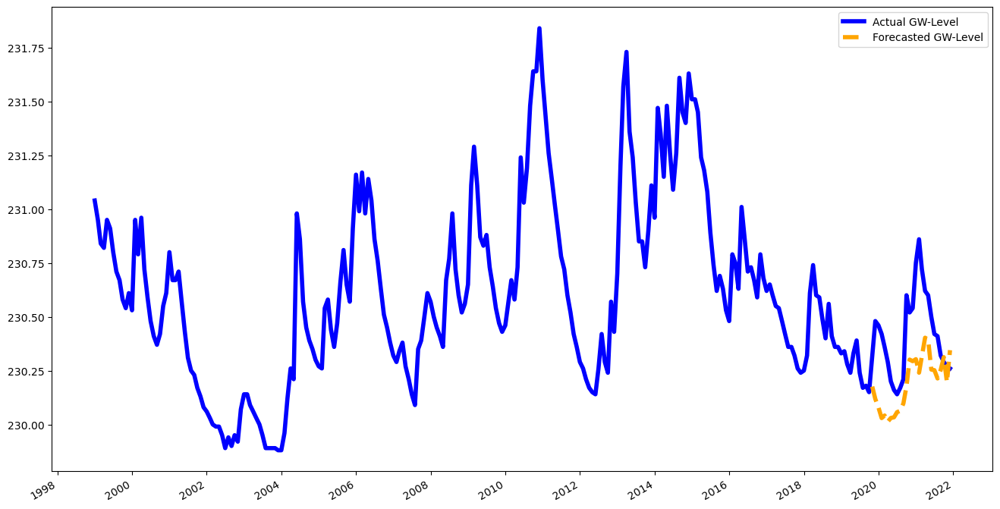



N train dates: 329
1992-01-01 00:00:00 till 2019-10-01 00:00:00
N forecast dates (horizon): 26
2019-11-01 00:00:00 till 2021-12-01 00:00:00
> SMAPE Score: 0.201181
First timepoint: 1992-01-01 00:00:00
Last timepoint:	 2021-12-01 00:00:00


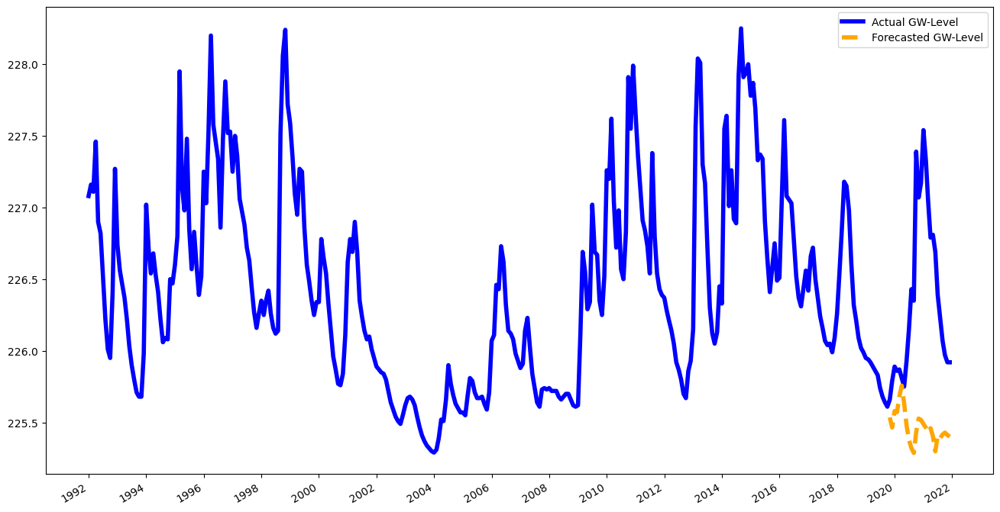



N train dates: 99
2011-08-01 00:00:00 till 2019-10-01 00:00:00
N forecast dates (horizon): 10
2019-11-01 00:00:00 till 2020-08-01 00:00:00
> SMAPE Score: 0.008384
First timepoint: 2011-08-01 00:00:00
Last timepoint:	 2020-08-01 00:00:00


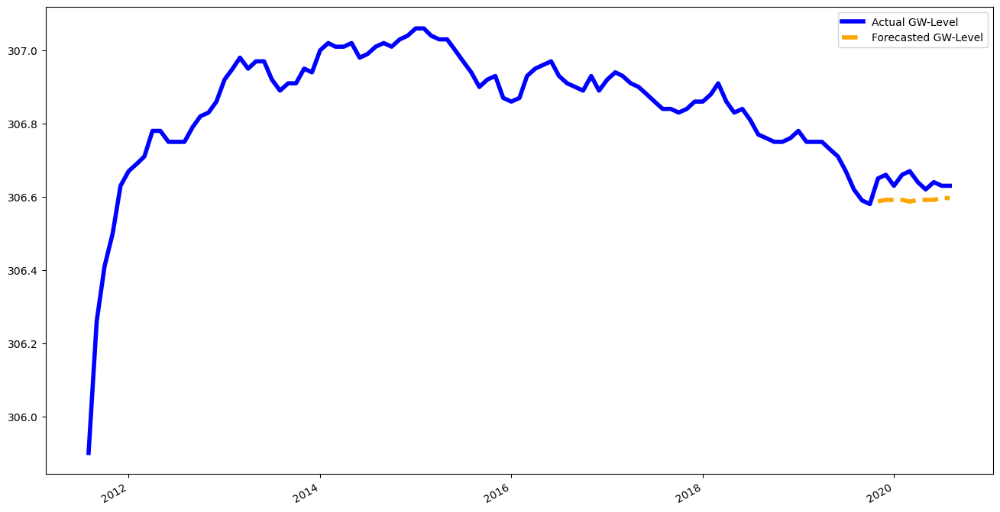



N train dates: 225
2001-01-01 00:00:00 till 2019-10-01 00:00:00
N forecast dates (horizon): 26
2019-11-01 00:00:00 till 2021-12-01 00:00:00
> SMAPE Score: 0.016404
First timepoint: 2001-01-01 00:00:00
Last timepoint:	 2021-12-01 00:00:00


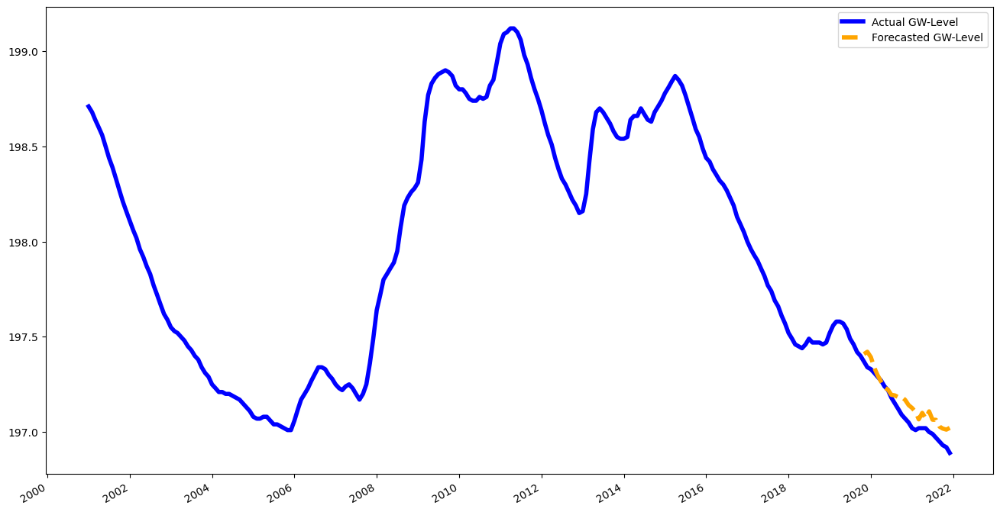



N train dates: 432
1975-04-01 00:00:00 till 2019-02-01 00:00:00
N forecast dates (horizon): 9
2020-10-01 00:00:00 till 2021-12-01 00:00:00
> SMAPE Score: 0.043167
First timepoint: 1975-04-01 00:00:00
Last timepoint:	 2021-12-01 00:00:00


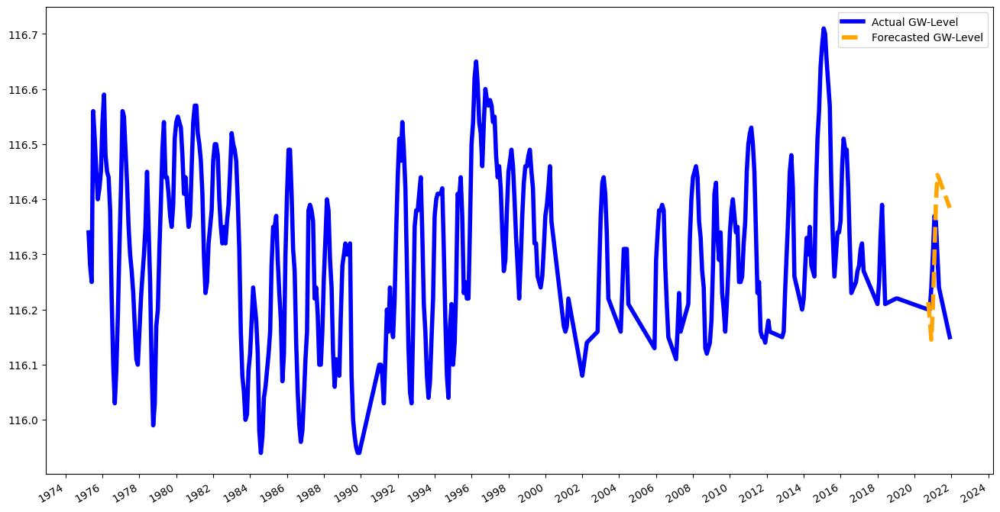



N train dates: 269
1997-06-01 00:00:00 till 2019-10-01 00:00:00
N forecast dates (horizon): 26
2019-11-01 00:00:00 till 2021-12-01 00:00:00
> SMAPE Score: 0.100311
First timepoint: 1997-06-01 00:00:00
Last timepoint:	 2021-12-01 00:00:00


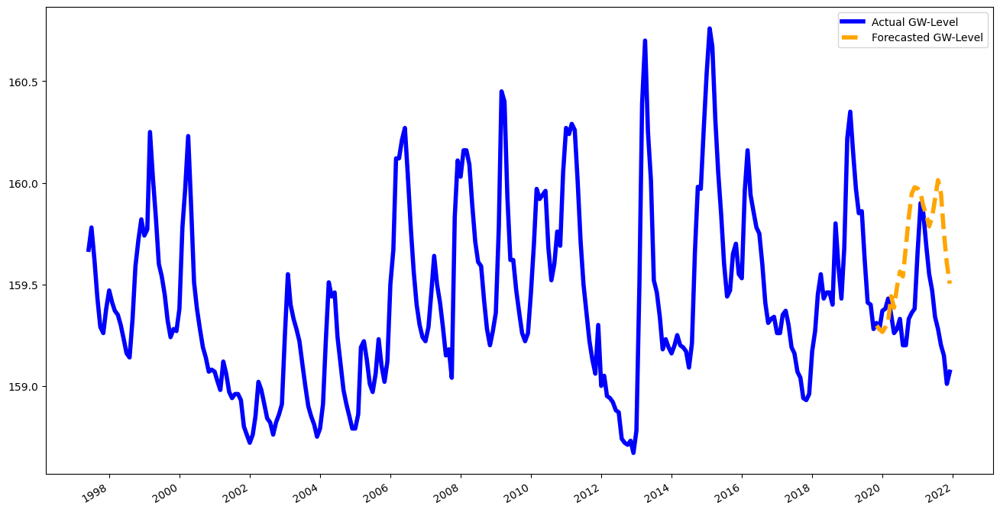



N train dates: 318
1993-01-01 00:00:00 till 2019-10-01 00:00:00
N forecast dates (horizon): 26
2019-11-01 00:00:00 till 2021-12-01 00:00:00
> SMAPE Score: 0.063552
First timepoint: 1993-01-01 00:00:00
Last timepoint:	 2021-12-01 00:00:00


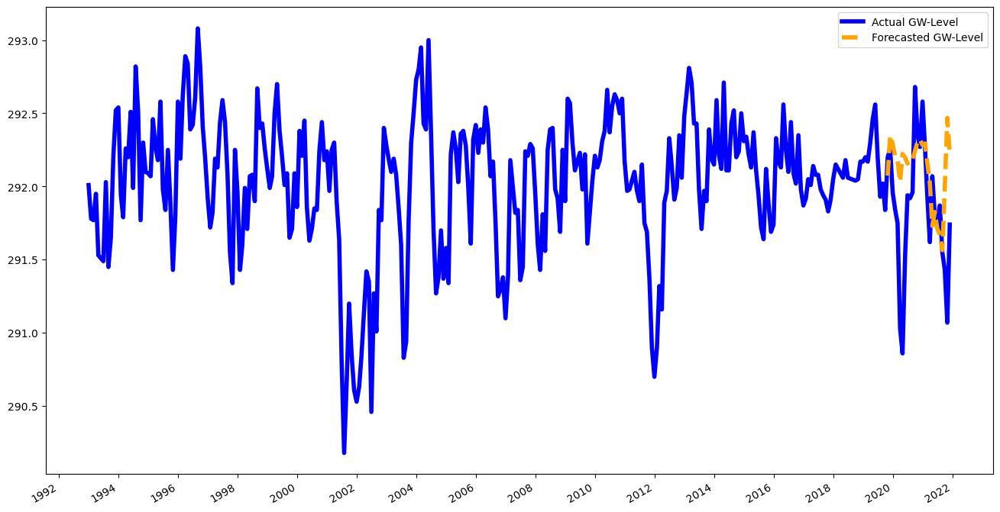



N train dates: 639
1966-08-01 00:00:00 till 2019-10-01 00:00:00
N forecast dates (horizon): 26
2019-11-01 00:00:00 till 2021-12-01 00:00:00
> SMAPE Score: 0.267798
First timepoint: 1966-08-01 00:00:00
Last timepoint:	 2021-12-01 00:00:00


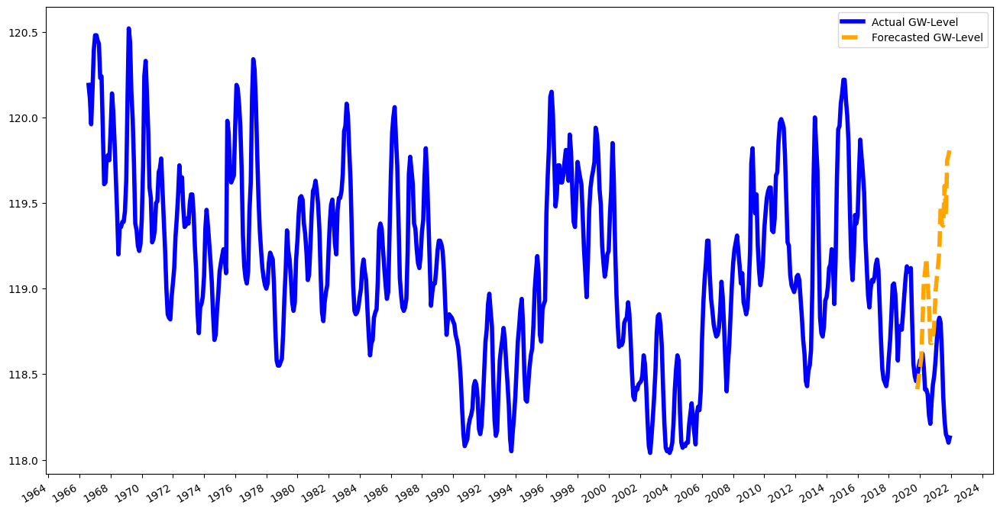



N train dates: 378
1988-01-01 00:00:00 till 2019-10-01 00:00:00
N forecast dates (horizon): 26
2019-11-01 00:00:00 till 2021-12-01 00:00:00
> SMAPE Score: 0.165111
First timepoint: 1988-01-01 00:00:00
Last timepoint:	 2021-12-01 00:00:00


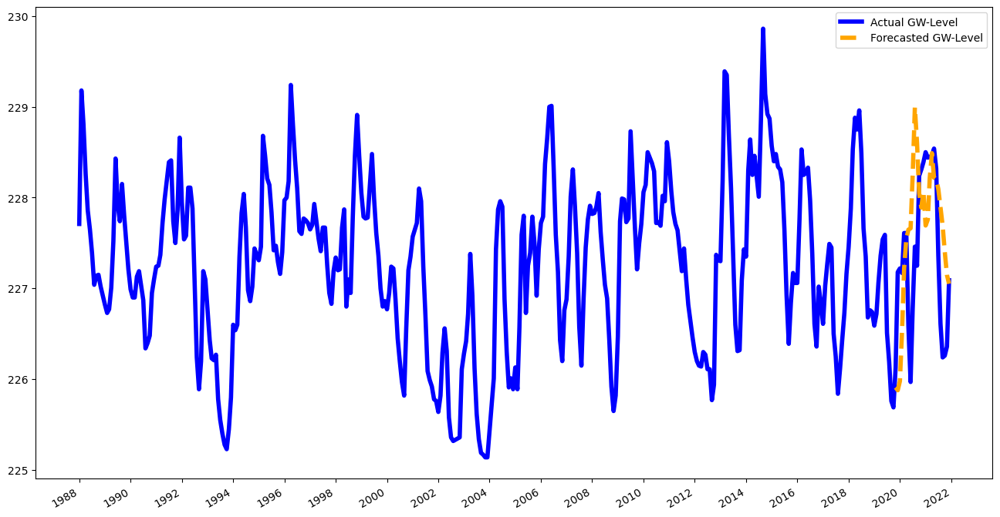



N train dates: 321
1993-01-01 00:00:00 till 2019-10-01 00:00:00
N forecast dates (horizon): 26
2019-11-01 00:00:00 till 2021-12-01 00:00:00
> SMAPE Score: 0.043524
First timepoint: 1993-01-01 00:00:00
Last timepoint:	 2021-12-01 00:00:00


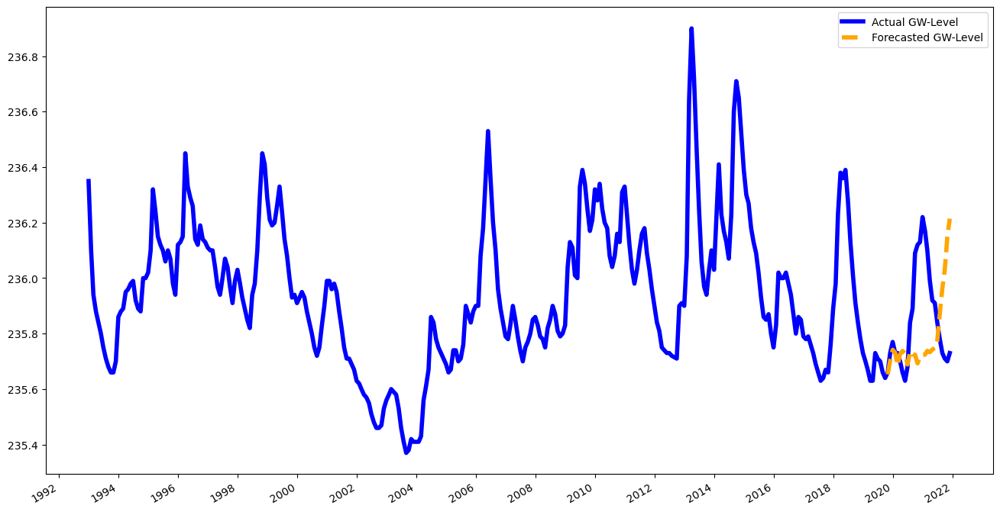



N train dates: 322
1993-01-01 00:00:00 till 2019-10-01 00:00:00
N forecast dates (horizon): 26
2019-11-01 00:00:00 till 2021-12-01 00:00:00
> SMAPE Score: 0.041574
First timepoint: 1993-01-01 00:00:00
Last timepoint:	 2021-12-01 00:00:00


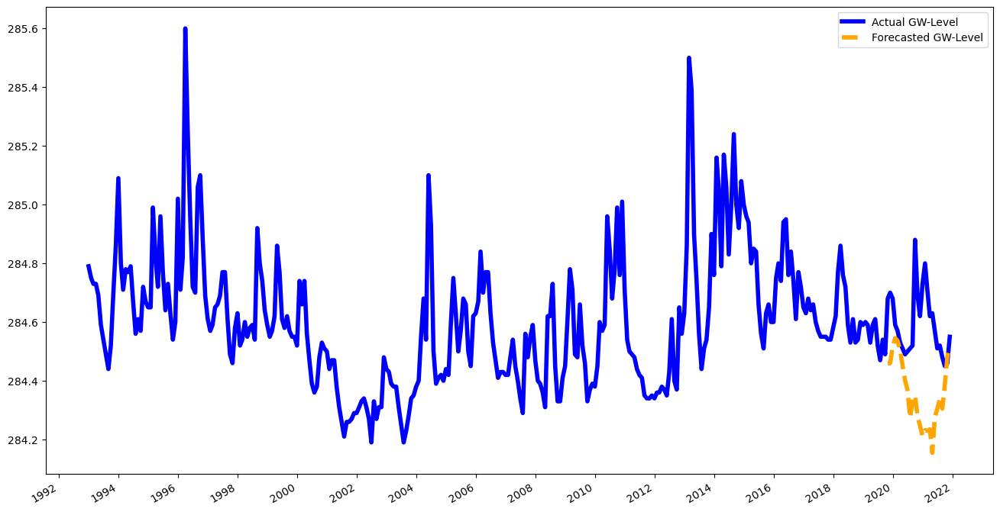



N train dates: 382
1988-01-01 00:00:00 till 2019-10-01 00:00:00
N forecast dates (horizon): 26
2019-11-01 00:00:00 till 2021-12-01 00:00:00
> SMAPE Score: 0.059264
First timepoint: 1988-01-01 00:00:00
Last timepoint:	 2021-12-01 00:00:00


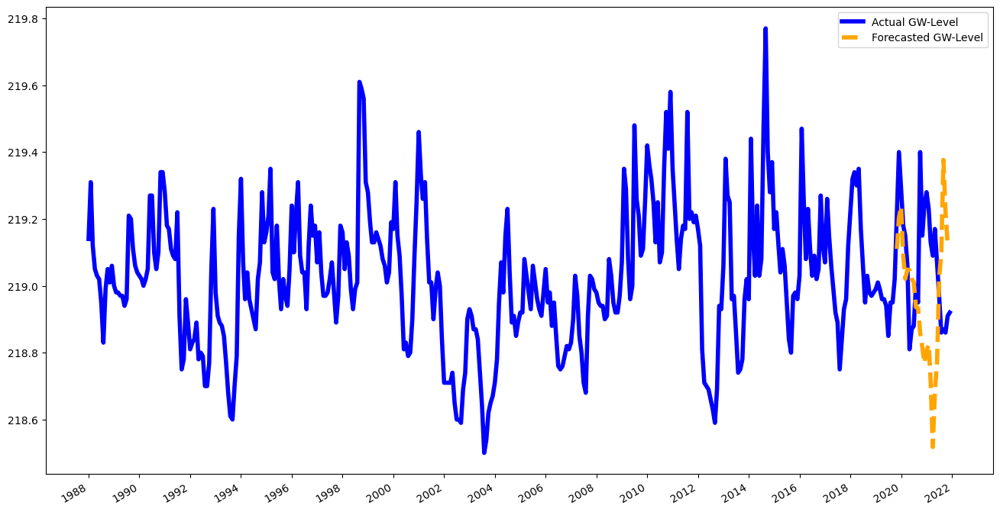



N train dates: 298
1995-01-01 00:00:00 till 2019-10-01 00:00:00
N forecast dates (horizon): 26
2019-11-01 00:00:00 till 2021-12-01 00:00:00
> SMAPE Score: 0.095506
First timepoint: 1995-01-01 00:00:00
Last timepoint:	 2021-12-01 00:00:00


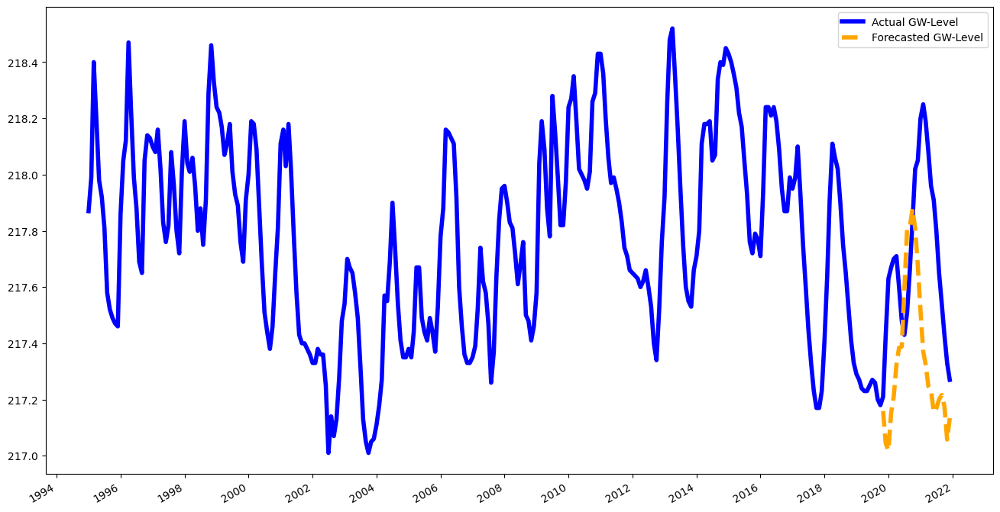



N train dates: 473
1980-01-01 00:00:00 till 2019-10-01 00:00:00
N forecast dates (horizon): 26
2019-11-01 00:00:00 till 2021-12-01 00:00:00
> SMAPE Score: 0.079162
First timepoint: 1980-01-01 00:00:00
Last timepoint:	 2021-12-01 00:00:00


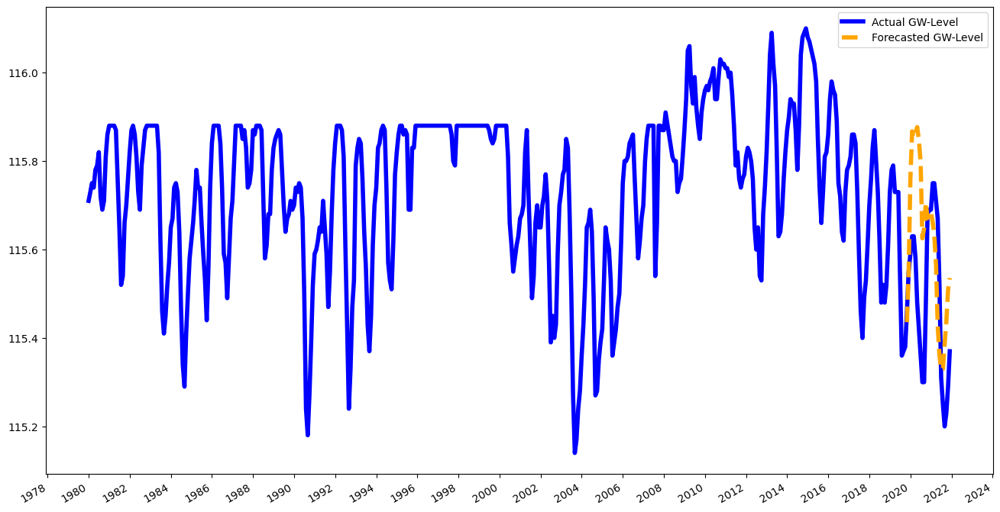



N train dates: 248
1999-01-01 00:00:00 till 2019-10-01 00:00:00
N forecast dates (horizon): 26
2019-11-01 00:00:00 till 2021-12-01 00:00:00
> SMAPE Score: 0.102973
First timepoint: 1999-01-01 00:00:00
Last timepoint:	 2021-12-01 00:00:00


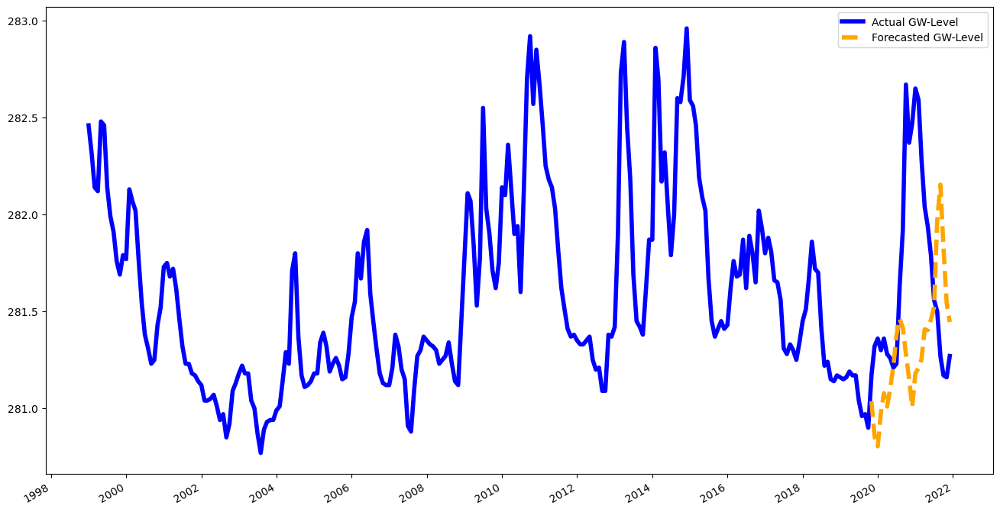



N train dates: 297
1995-01-01 00:00:00 till 2019-10-01 00:00:00
N forecast dates (horizon): 26
2019-11-01 00:00:00 till 2021-12-01 00:00:00
> SMAPE Score: 0.12487
First timepoint: 1995-01-01 00:00:00
Last timepoint:	 2021-12-01 00:00:00


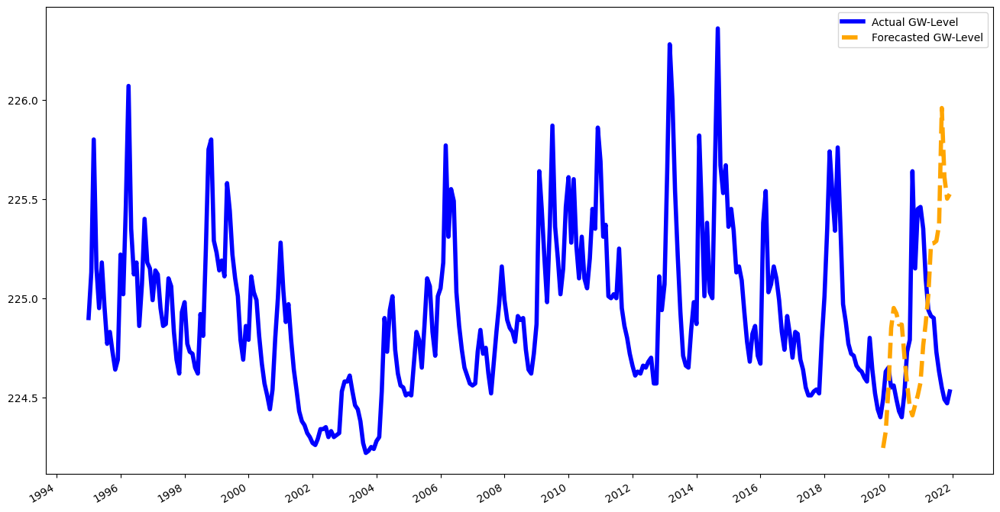



N train dates: 202
2003-01-01 00:00:00 till 2019-10-01 00:00:00
N forecast dates (horizon): 26
2019-11-01 00:00:00 till 2021-12-01 00:00:00
> SMAPE Score: 0.149278
First timepoint: 2003-01-01 00:00:00
Last timepoint:	 2021-12-01 00:00:00


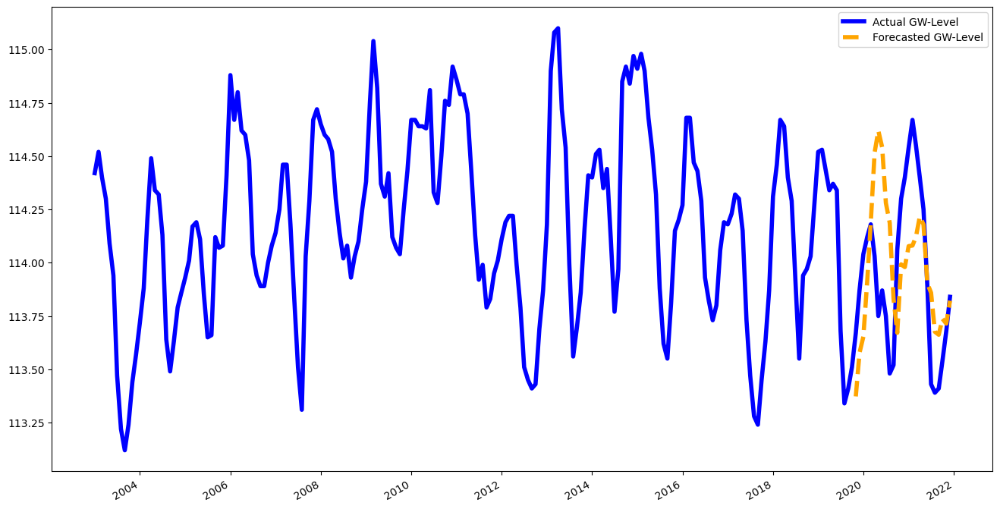



N train dates: 358
1990-01-01 00:00:00 till 2019-10-01 00:00:00
N forecast dates (horizon): 26
2019-11-01 00:00:00 till 2021-12-01 00:00:00
> SMAPE Score: 0.248494
First timepoint: 1990-01-01 00:00:00
Last timepoint:	 2021-12-01 00:00:00


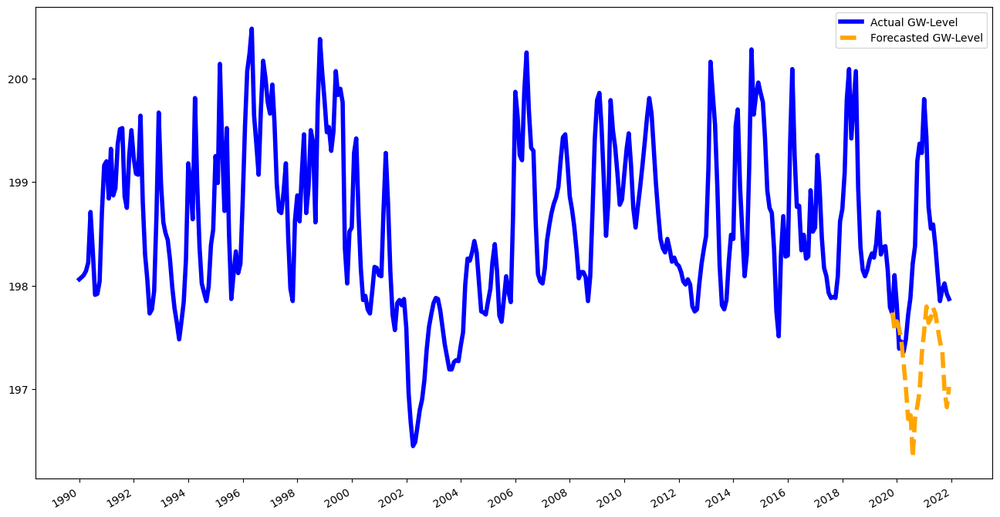



N train dates: 298
1995-01-01 00:00:00 till 2019-10-01 00:00:00
N forecast dates (horizon): 26
2019-11-01 00:00:00 till 2021-12-01 00:00:00
> SMAPE Score: 0.122379
First timepoint: 1995-01-01 00:00:00
Last timepoint:	 2021-12-01 00:00:00


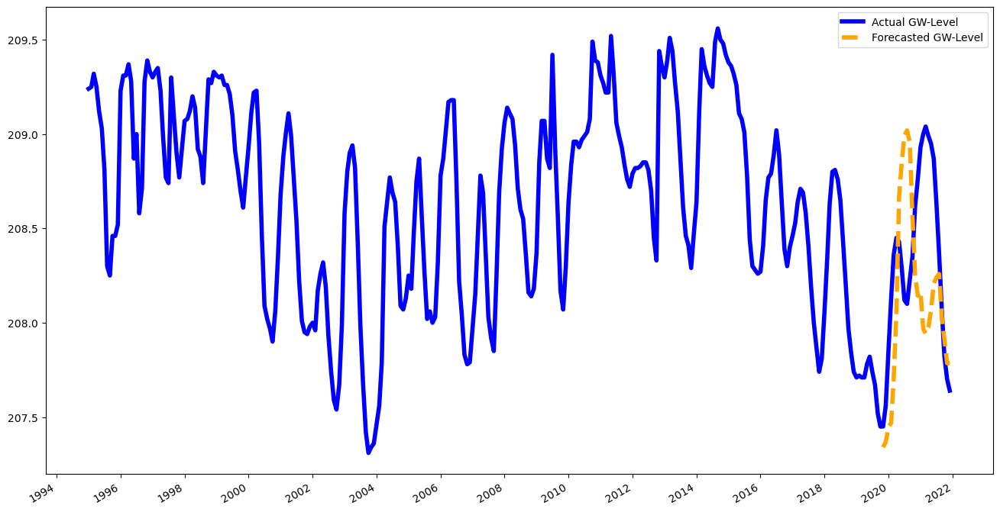



N train dates: 310
1994-01-01 00:00:00 till 2019-10-01 00:00:00
N forecast dates (horizon): 26
2019-11-01 00:00:00 till 2021-12-01 00:00:00
> SMAPE Score: 0.101382
First timepoint: 1994-01-01 00:00:00
Last timepoint:	 2021-12-01 00:00:00


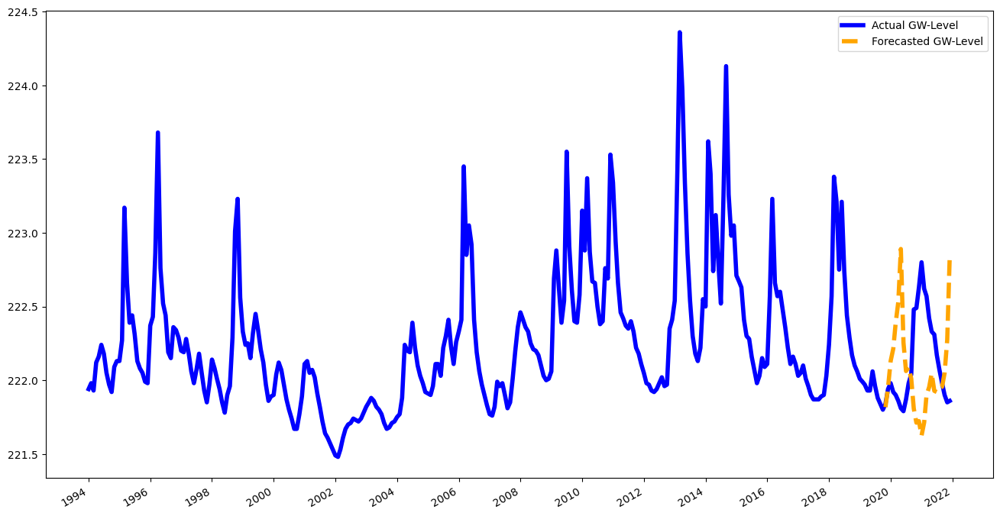



N train dates: 610
1969-01-01 00:00:00 till 2019-10-01 00:00:00
N forecast dates (horizon): 26
2019-11-01 00:00:00 till 2021-12-01 00:00:00
> SMAPE Score: 0.109907
First timepoint: 1969-01-01 00:00:00
Last timepoint:	 2021-12-01 00:00:00


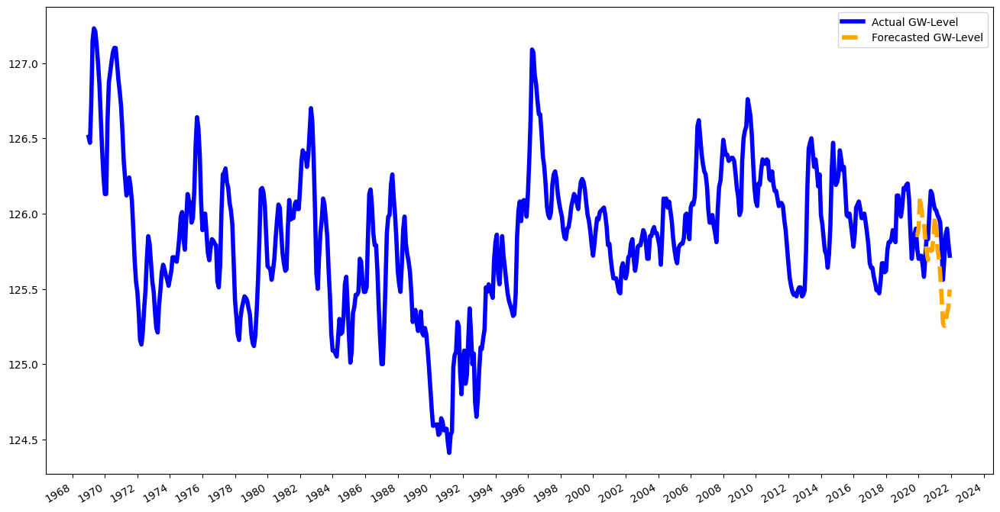



N train dates: 299
1994-02-01 00:00:00 till 2019-10-01 00:00:00
N forecast dates (horizon): 26
2019-11-01 00:00:00 till 2021-12-01 00:00:00
> SMAPE Score: 0.065358
First timepoint: 1994-02-01 00:00:00
Last timepoint:	 2021-12-01 00:00:00


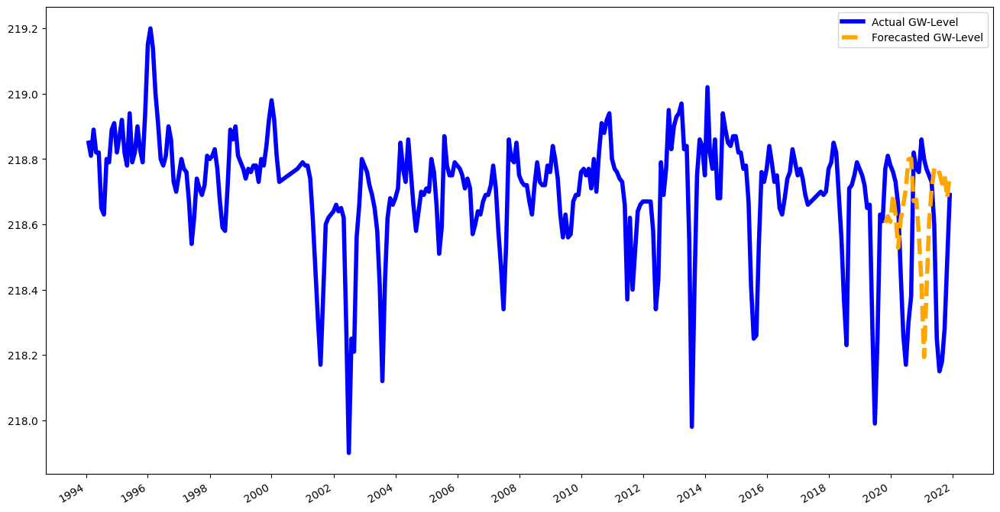



N train dates: 303
1994-02-01 00:00:00 till 2019-10-01 00:00:00
N forecast dates (horizon): 26
2019-11-01 00:00:00 till 2021-12-01 00:00:00
> SMAPE Score: 0.087776
First timepoint: 1994-02-01 00:00:00
Last timepoint:	 2021-12-01 00:00:00


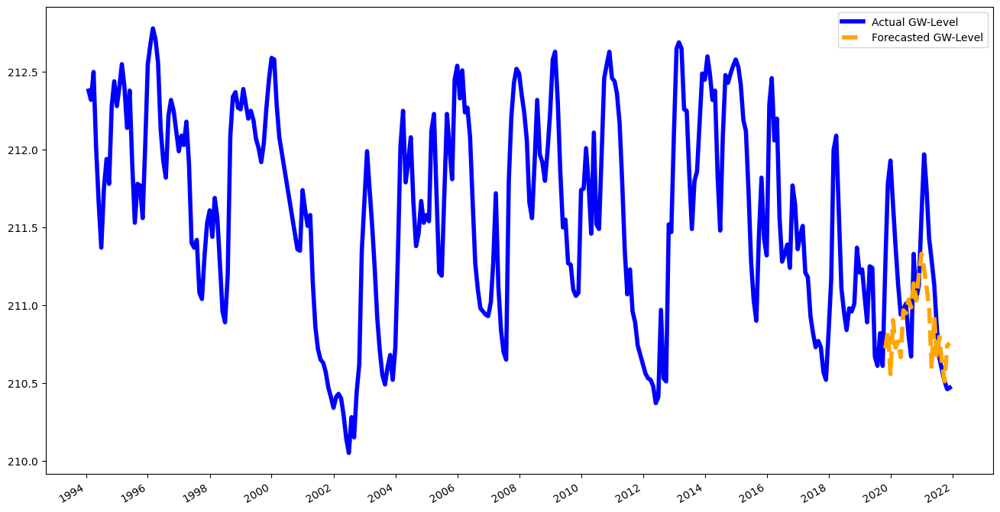



N train dates: 790
1953-11-01 00:00:00 till 2019-10-01 00:00:00
N forecast dates (horizon): 26
2019-11-01 00:00:00 till 2021-12-01 00:00:00
> SMAPE Score: 0.215561
First timepoint: 1953-11-01 00:00:00
Last timepoint:	 2021-12-01 00:00:00


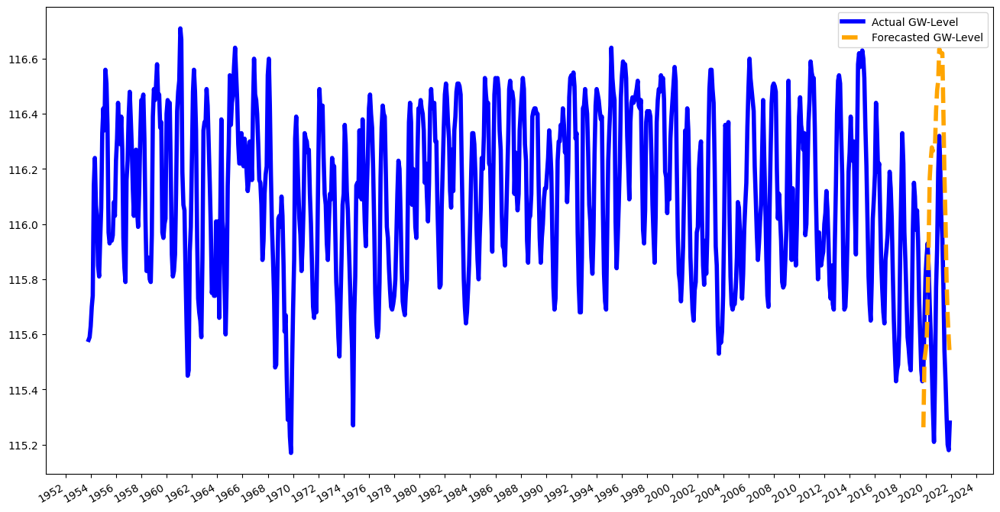



N train dates: 646
1966-01-01 00:00:00 till 2019-10-01 00:00:00
N forecast dates (horizon): 26
2019-11-01 00:00:00 till 2021-12-01 00:00:00
> SMAPE Score: 0.256914
First timepoint: 1966-01-01 00:00:00
Last timepoint:	 2021-12-01 00:00:00


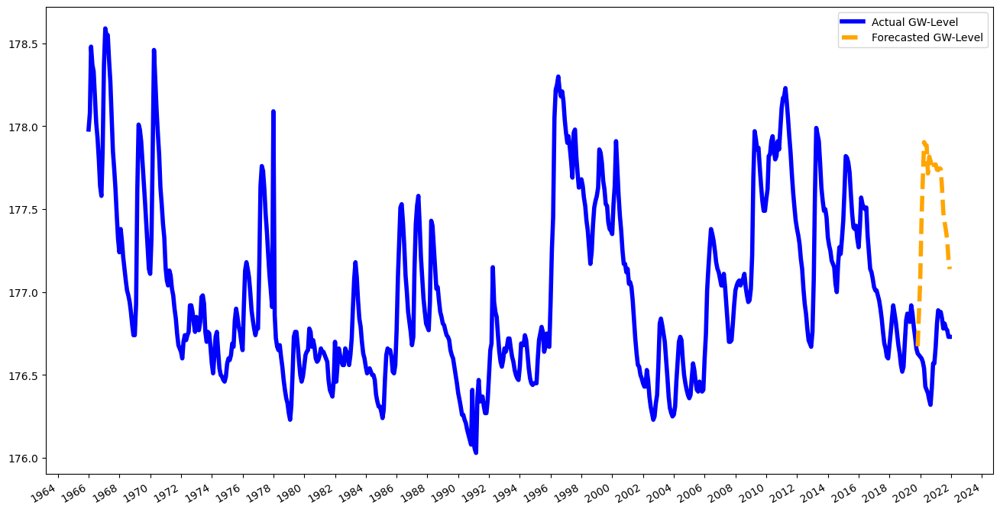



N train dates: 657
1962-04-01 00:00:00 till 2019-10-01 00:00:00
N forecast dates (horizon): 26
2019-11-01 00:00:00 till 2021-12-01 00:00:00
> SMAPE Score: 0.173133
First timepoint: 1962-04-01 00:00:00
Last timepoint:	 2021-12-01 00:00:00


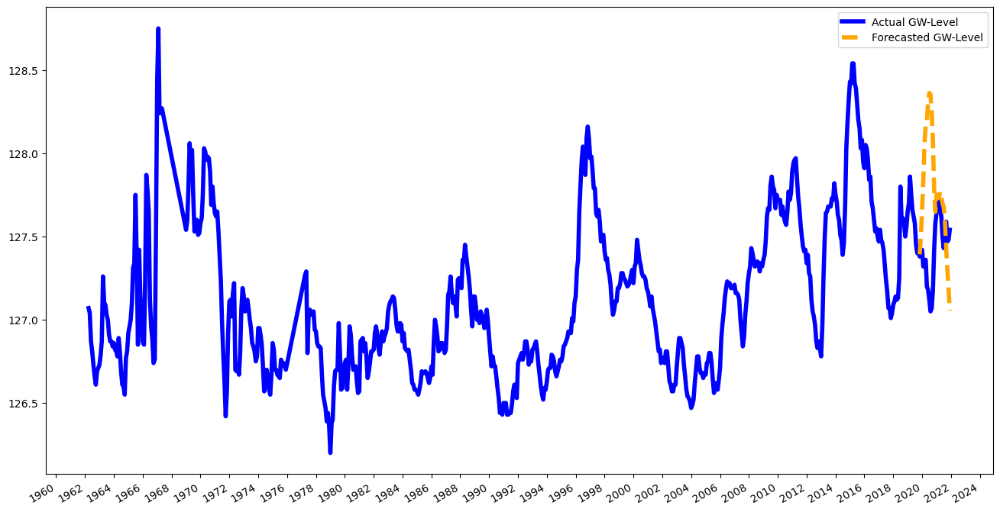



N train dates: 356
1990-01-01 00:00:00 till 2019-10-01 00:00:00
N forecast dates (horizon): 24
2019-11-01 00:00:00 till 2021-12-01 00:00:00
> SMAPE Score: 0.074381
First timepoint: 1990-01-01 00:00:00
Last timepoint:	 2021-12-01 00:00:00


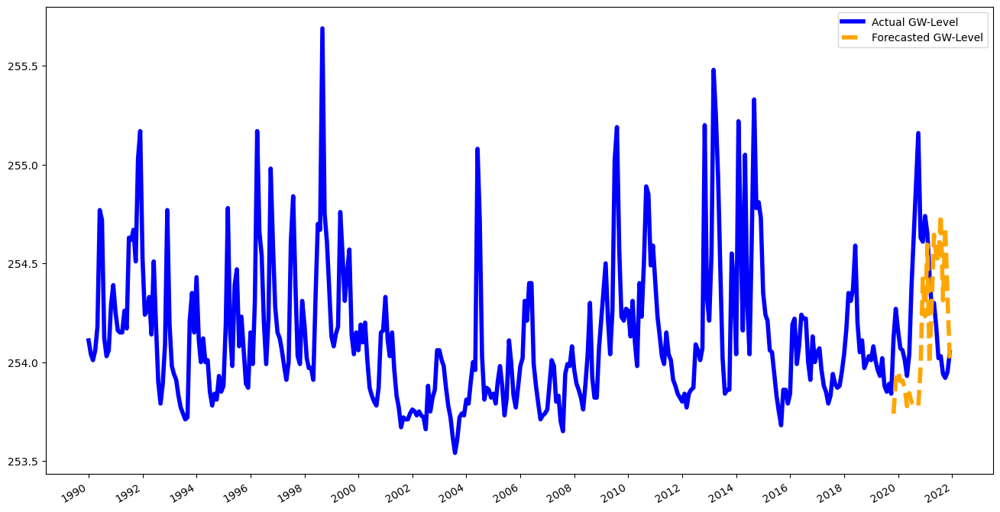



N train dates: 248
1999-01-01 00:00:00 till 2019-10-01 00:00:00
N forecast dates (horizon): 26
2019-11-01 00:00:00 till 2021-12-01 00:00:00
> SMAPE Score: 0.19436
First timepoint: 1999-01-01 00:00:00
Last timepoint:	 2021-12-01 00:00:00


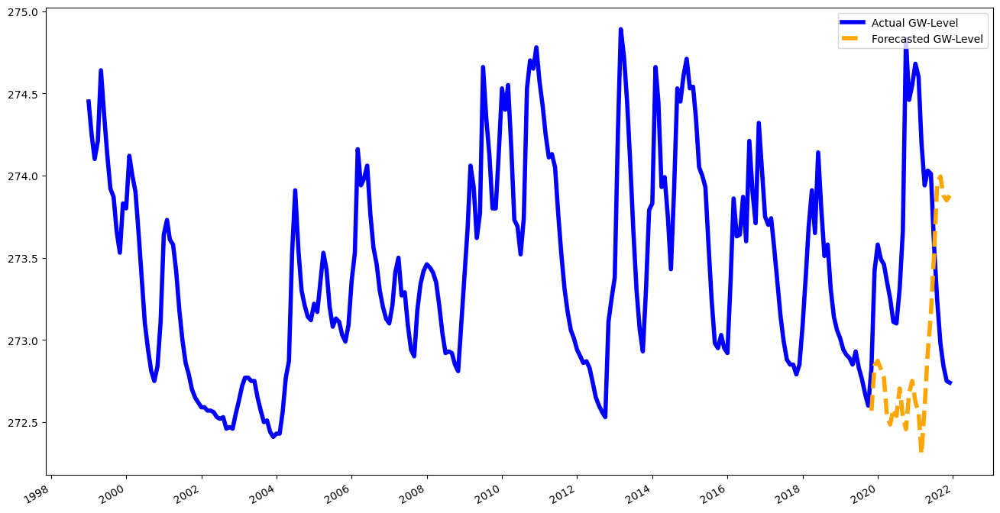



N train dates: 224
2001-03-01 00:00:00 till 2019-10-01 00:00:00
N forecast dates (horizon): 26
2019-11-01 00:00:00 till 2021-12-01 00:00:00
> SMAPE Score: 0.119037
First timepoint: 2001-03-01 00:00:00
Last timepoint:	 2021-12-01 00:00:00


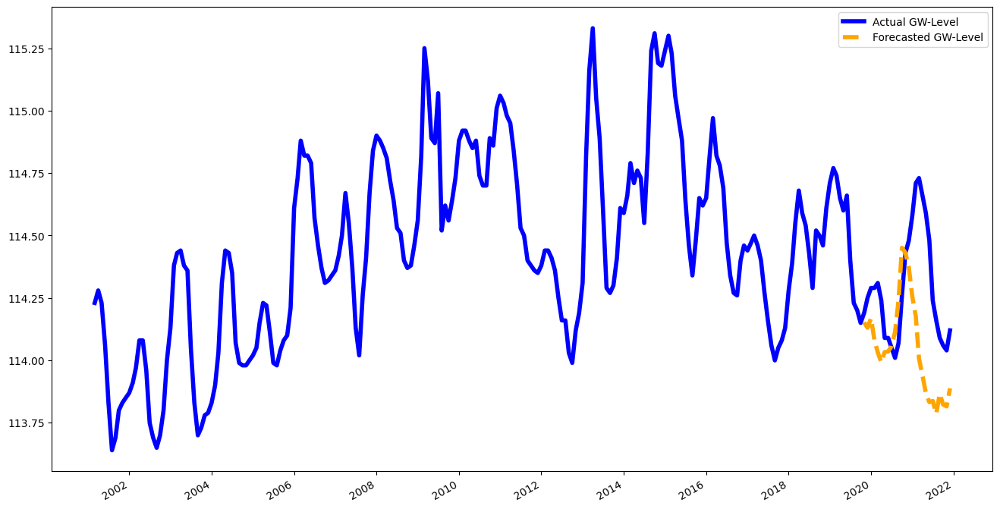



N train dates: 352
1990-01-01 00:00:00 till 2019-10-01 00:00:00
N forecast dates (horizon): 26
2019-11-01 00:00:00 till 2021-12-01 00:00:00
> SMAPE Score: 0.015898
First timepoint: 1990-01-01 00:00:00
Last timepoint:	 2021-12-01 00:00:00


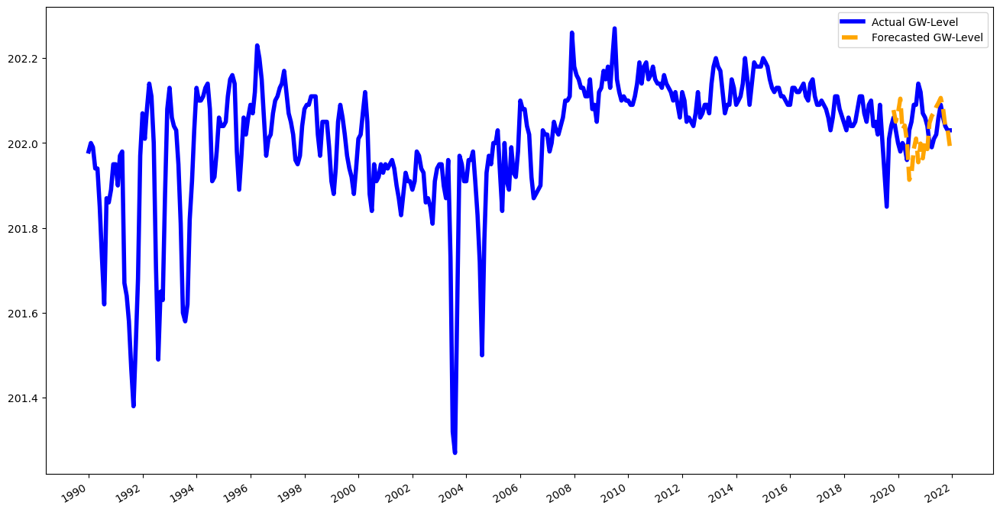



N train dates: 333
1992-01-01 00:00:00 till 2019-10-01 00:00:00
N forecast dates (horizon): 26
2019-11-01 00:00:00 till 2021-12-01 00:00:00
> SMAPE Score: 0.178286
First timepoint: 1992-01-01 00:00:00
Last timepoint:	 2021-12-01 00:00:00


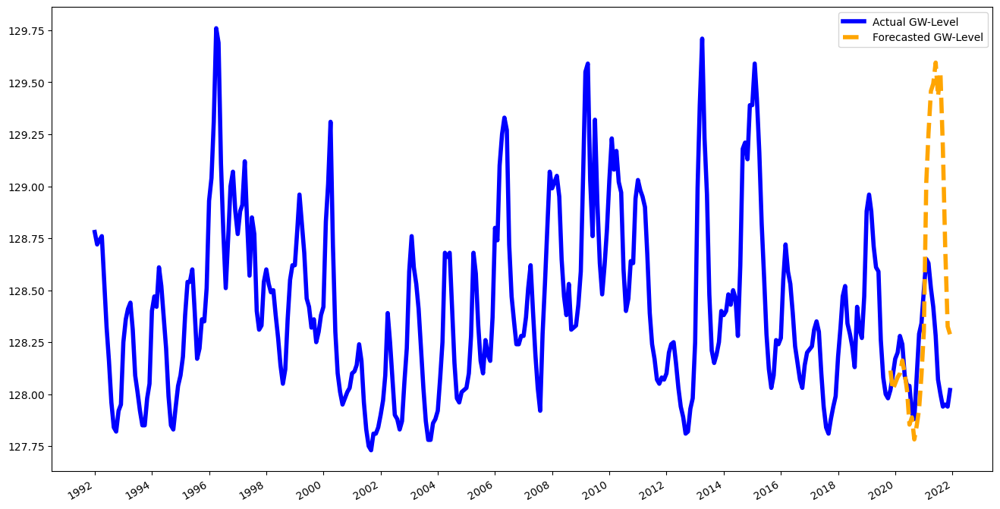



N train dates: 767
1953-11-01 00:00:00 till 2019-10-01 00:00:00
N forecast dates (horizon): 26
2019-11-01 00:00:00 till 2021-12-01 00:00:00
> SMAPE Score: 0.107294
First timepoint: 1953-11-01 00:00:00
Last timepoint:	 2021-12-01 00:00:00


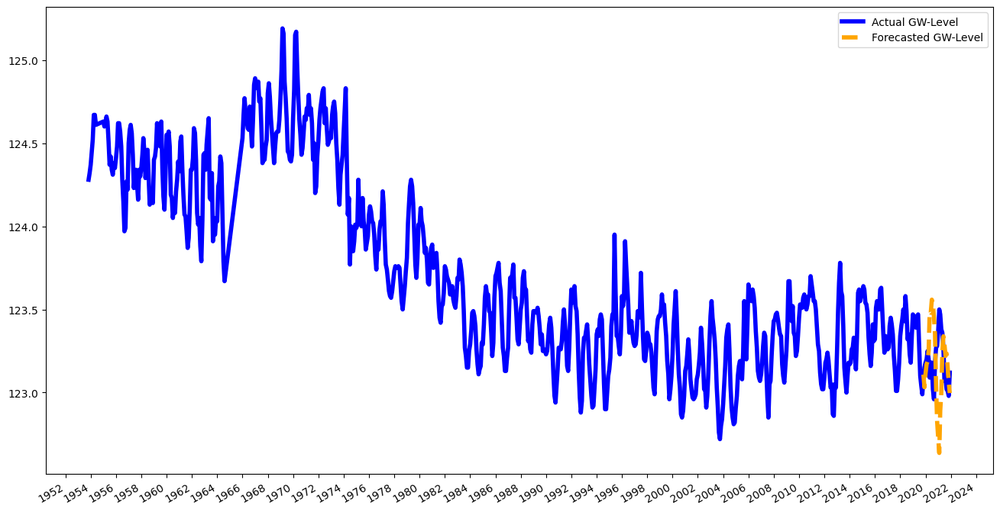



N train dates: 310
1993-01-01 00:00:00 till 2019-10-01 00:00:00
N forecast dates (horizon): 26
2019-11-01 00:00:00 till 2021-12-01 00:00:00
> SMAPE Score: 0.019885
First timepoint: 1993-01-01 00:00:00
Last timepoint:	 2021-12-01 00:00:00


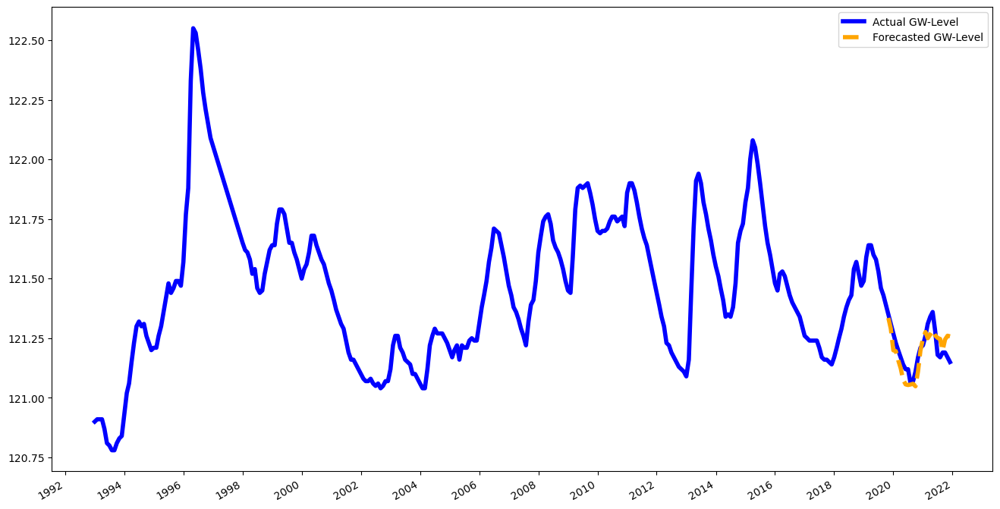



N train dates: 298
1995-01-01 00:00:00 till 2019-10-01 00:00:00
N forecast dates (horizon): 26
2019-11-01 00:00:00 till 2021-12-01 00:00:00
> SMAPE Score: 0.049719
First timepoint: 1995-01-01 00:00:00
Last timepoint:	 2021-12-01 00:00:00


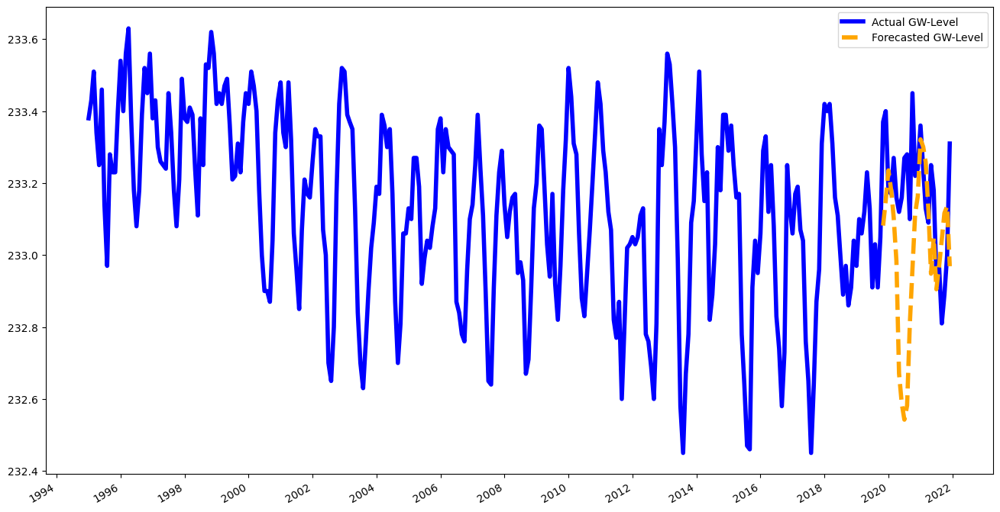



N train dates: 382
1988-01-01 00:00:00 till 2019-10-01 00:00:00
N forecast dates (horizon): 26
2019-11-01 00:00:00 till 2021-12-01 00:00:00
> SMAPE Score: 0.014145
First timepoint: 1988-01-01 00:00:00
Last timepoint:	 2021-12-01 00:00:00


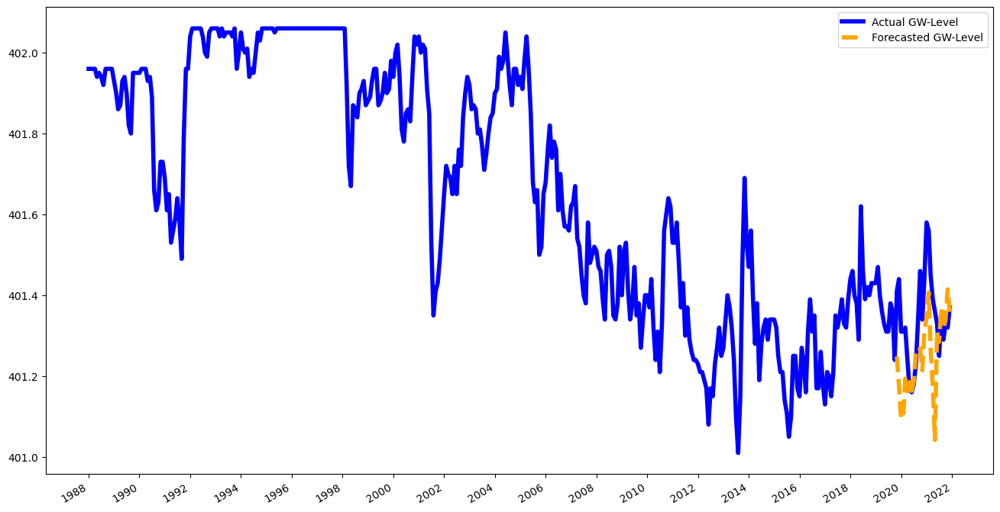



N train dates: 607
1969-01-01 00:00:00 till 2019-10-01 00:00:00
N forecast dates (horizon): 26
2019-11-01 00:00:00 till 2021-12-01 00:00:00
> SMAPE Score: 0.089741
First timepoint: 1969-01-01 00:00:00
Last timepoint:	 2021-12-01 00:00:00


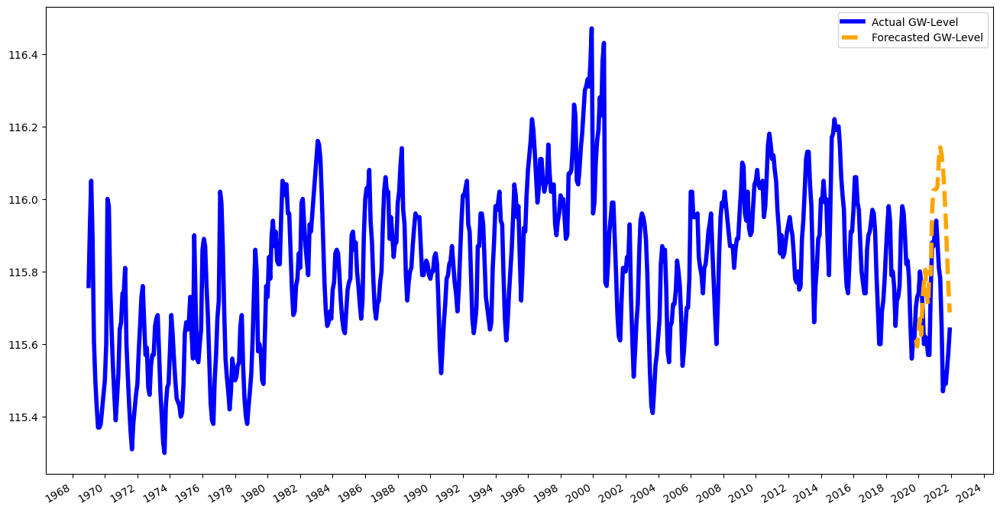



N train dates: 214
2002-01-01 00:00:00 till 2019-10-01 00:00:00
N forecast dates (horizon): 26
2019-11-01 00:00:00 till 2021-12-01 00:00:00
> SMAPE Score: 0.122711
First timepoint: 2002-01-01 00:00:00
Last timepoint:	 2021-12-01 00:00:00


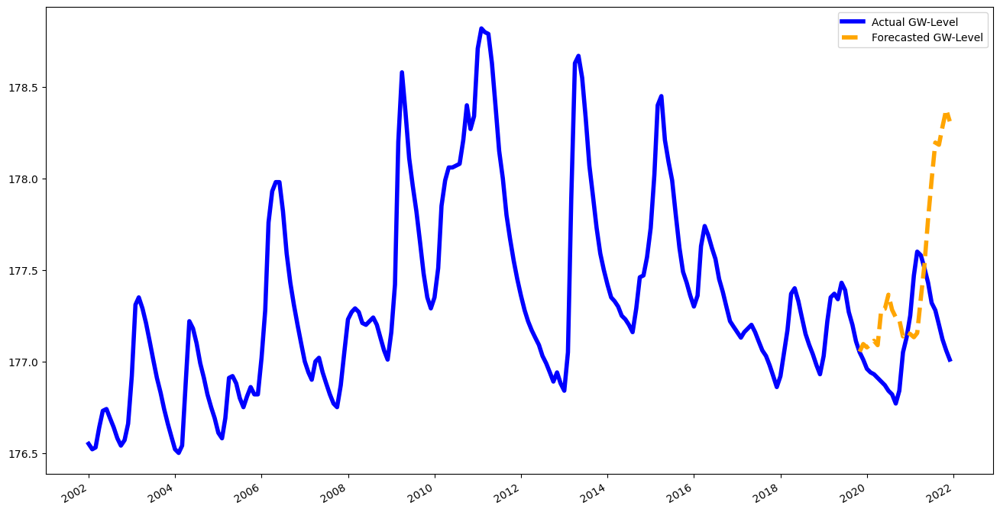



N train dates: 790
1953-12-01 00:00:00 till 2019-10-01 00:00:00
N forecast dates (horizon): 26
2019-11-01 00:00:00 till 2021-12-01 00:00:00
> SMAPE Score: 0.313908
First timepoint: 1953-12-01 00:00:00
Last timepoint:	 2021-12-01 00:00:00


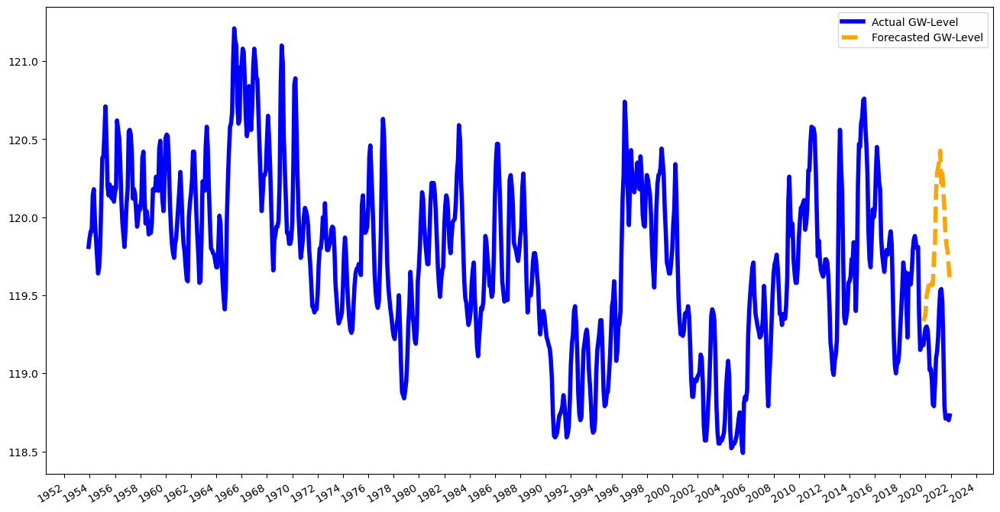



N train dates: 321
1993-01-01 00:00:00 till 2019-10-01 00:00:00
N forecast dates (horizon): 26
2019-11-01 00:00:00 till 2021-12-01 00:00:00
> SMAPE Score: 0.082619
First timepoint: 1993-01-01 00:00:00
Last timepoint:	 2021-12-01 00:00:00


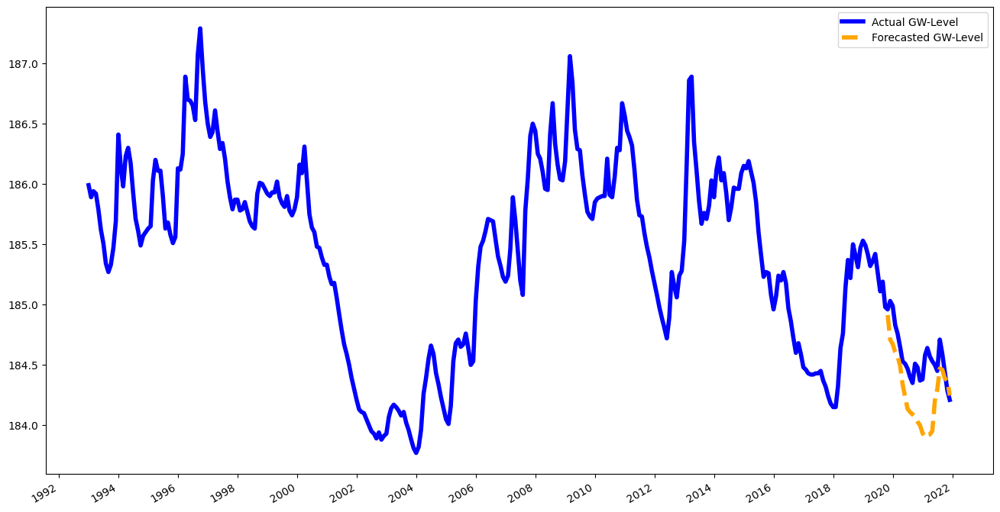



N train dates: 294
1995-01-01 00:00:00 till 2019-10-01 00:00:00
N forecast dates (horizon): 26
2019-11-01 00:00:00 till 2021-12-01 00:00:00
> SMAPE Score: 0.16182
First timepoint: 1995-01-01 00:00:00
Last timepoint:	 2021-12-01 00:00:00


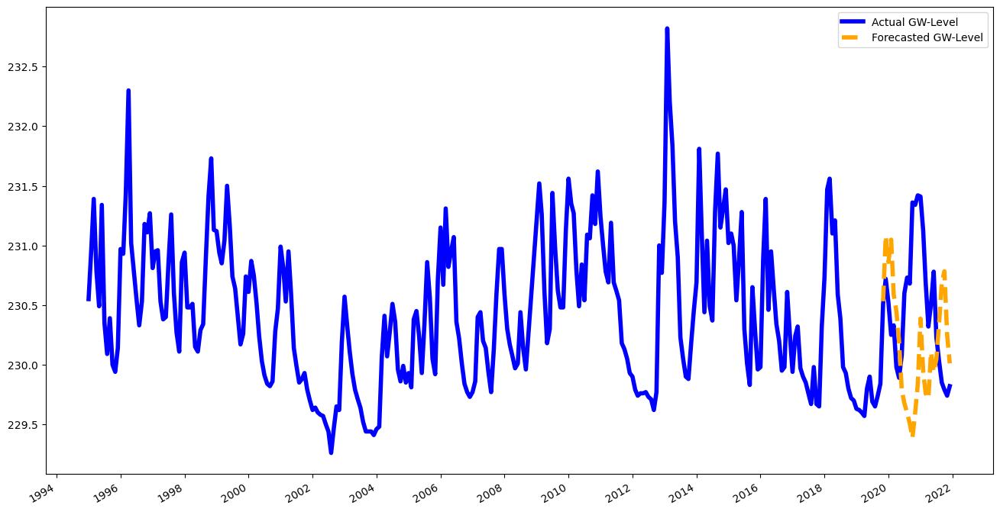



N train dates: 667
1964-04-01 00:00:00 till 2019-10-01 00:00:00
N forecast dates (horizon): 26
2019-11-01 00:00:00 till 2021-12-01 00:00:00
> SMAPE Score: 0.275474
First timepoint: 1964-04-01 00:00:00
Last timepoint:	 2021-12-01 00:00:00


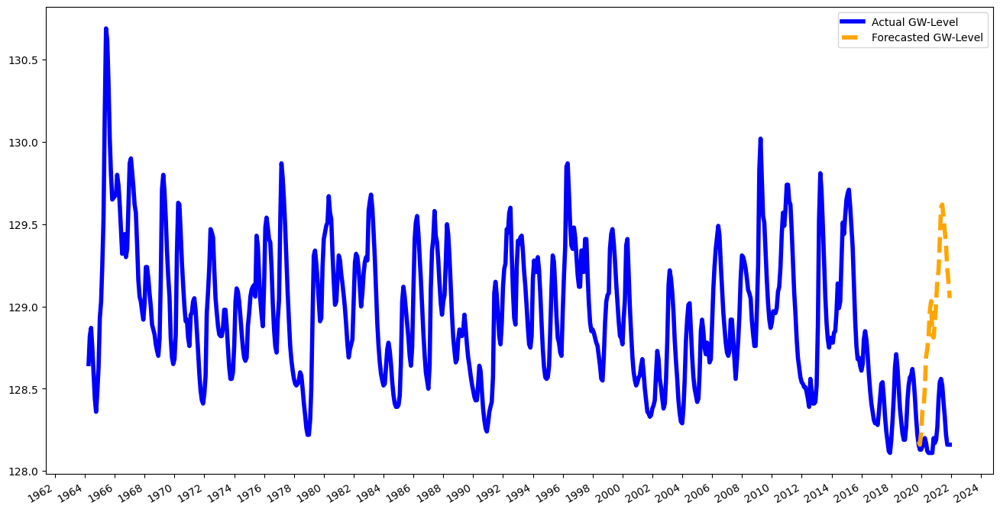



N train dates: 114
2010-04-01 00:00:00 till 2019-10-01 00:00:00
N forecast dates (horizon): 26
2019-11-01 00:00:00 till 2021-12-01 00:00:00
> SMAPE Score: 0.219739
First timepoint: 2010-04-01 00:00:00
Last timepoint:	 2021-12-01 00:00:00


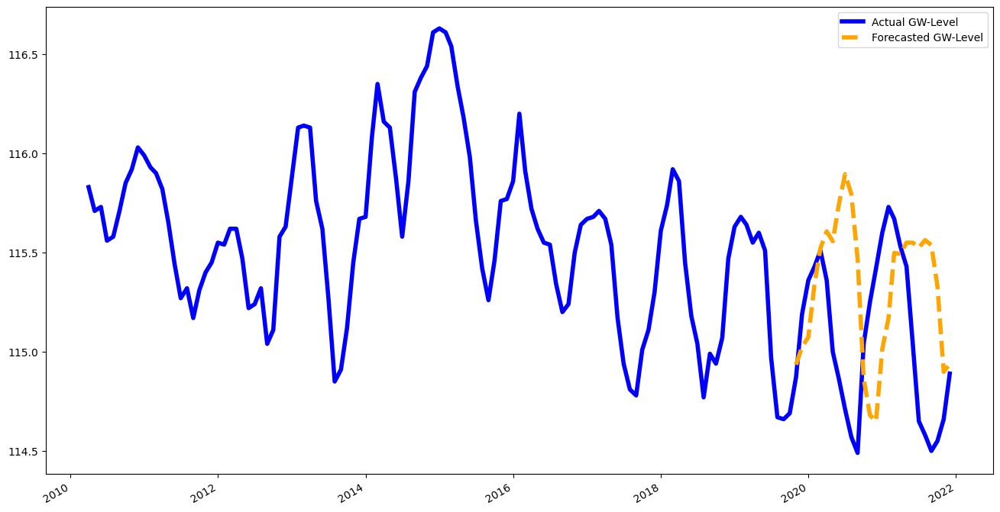



N train dates: 470
1979-10-01 00:00:00 till 2019-10-01 00:00:00
N forecast dates (horizon): 18
2019-11-01 00:00:00 till 2021-12-01 00:00:00
> SMAPE Score: 0.039242
First timepoint: 1979-10-01 00:00:00
Last timepoint:	 2021-12-01 00:00:00


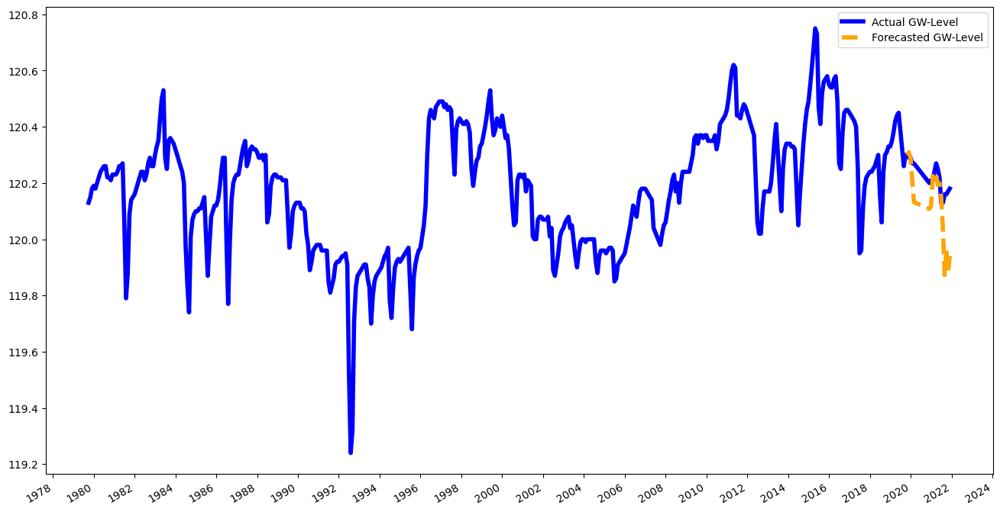



N train dates: 537
1975-01-01 00:00:00 till 2019-10-01 00:00:00
N forecast dates (horizon): 26
2019-11-01 00:00:00 till 2021-12-01 00:00:00
> SMAPE Score: 0.055477
First timepoint: 1975-01-01 00:00:00
Last timepoint:	 2021-12-01 00:00:00


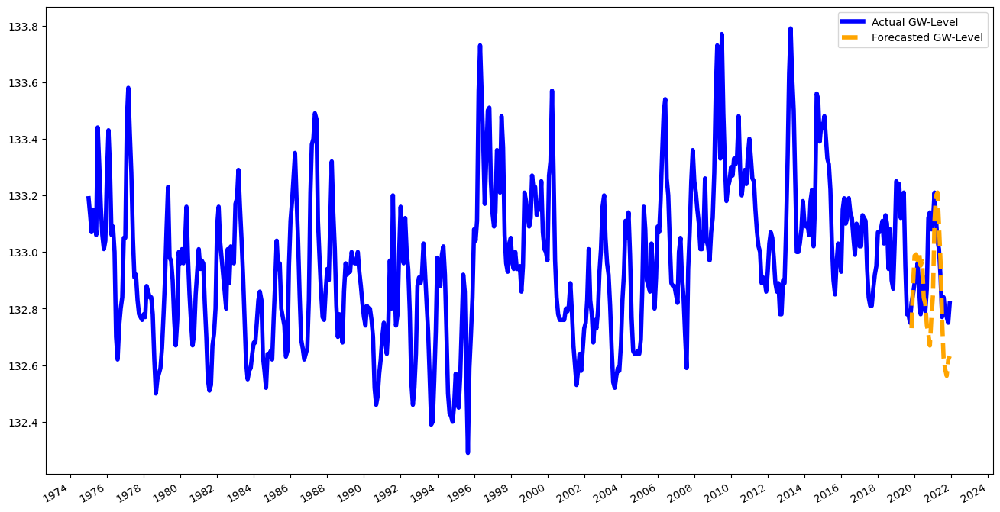



N train dates: 755
1956-11-01 00:00:00 till 2019-10-01 00:00:00
N forecast dates (horizon): 26
2019-11-01 00:00:00 till 2021-12-01 00:00:00
> SMAPE Score: 0.205913
First timepoint: 1956-11-01 00:00:00
Last timepoint:	 2021-12-01 00:00:00


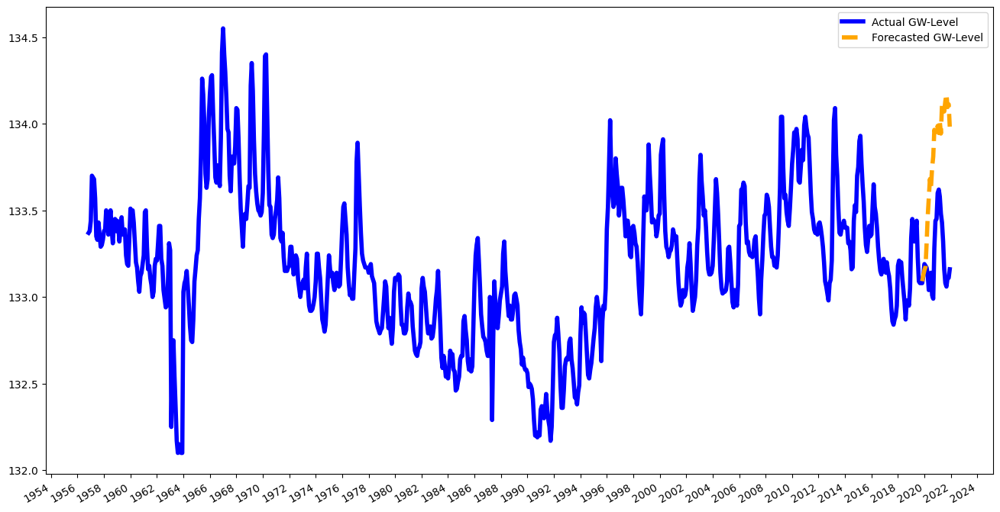



N train dates: 224
2001-01-01 00:00:00 till 2019-10-01 00:00:00
N forecast dates (horizon): 26
2019-11-01 00:00:00 till 2021-12-01 00:00:00
> SMAPE Score: 0.050094
First timepoint: 2001-01-01 00:00:00
Last timepoint:	 2021-12-01 00:00:00


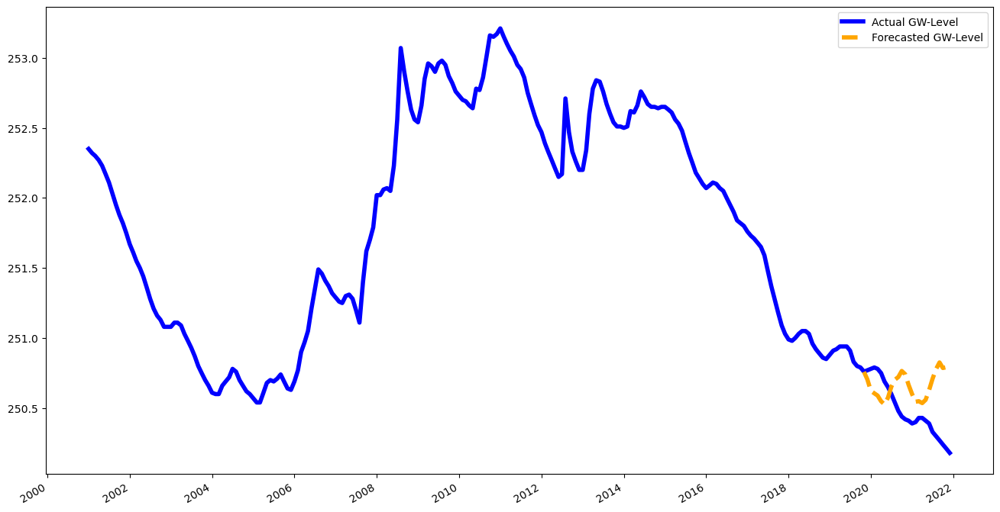



N train dates: 303
1994-02-01 00:00:00 till 2019-10-01 00:00:00
N forecast dates (horizon): 26
2019-11-01 00:00:00 till 2021-12-01 00:00:00
> SMAPE Score: 0.063043
First timepoint: 1994-02-01 00:00:00
Last timepoint:	 2021-12-01 00:00:00


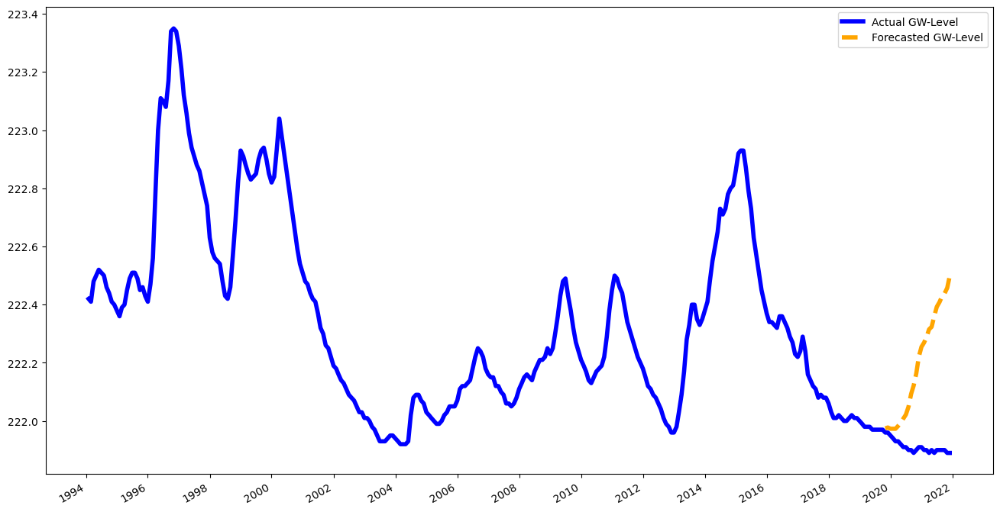



N train dates: 334
1992-01-01 00:00:00 till 2019-10-01 00:00:00
N forecast dates (horizon): 26
2019-11-01 00:00:00 till 2021-12-01 00:00:00
> SMAPE Score: 0.20788
First timepoint: 1992-01-01 00:00:00
Last timepoint:	 2021-12-01 00:00:00


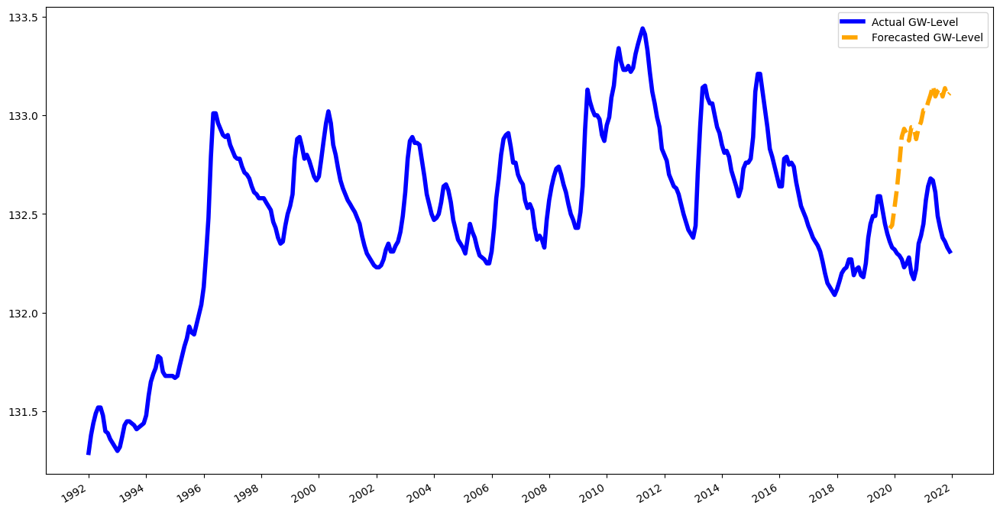



N train dates: 142
2008-01-01 00:00:00 till 2019-10-01 00:00:00
N forecast dates (horizon): 26
2019-11-01 00:00:00 till 2021-12-01 00:00:00
> SMAPE Score: 0.042449
First timepoint: 2008-01-01 00:00:00
Last timepoint:	 2021-12-01 00:00:00


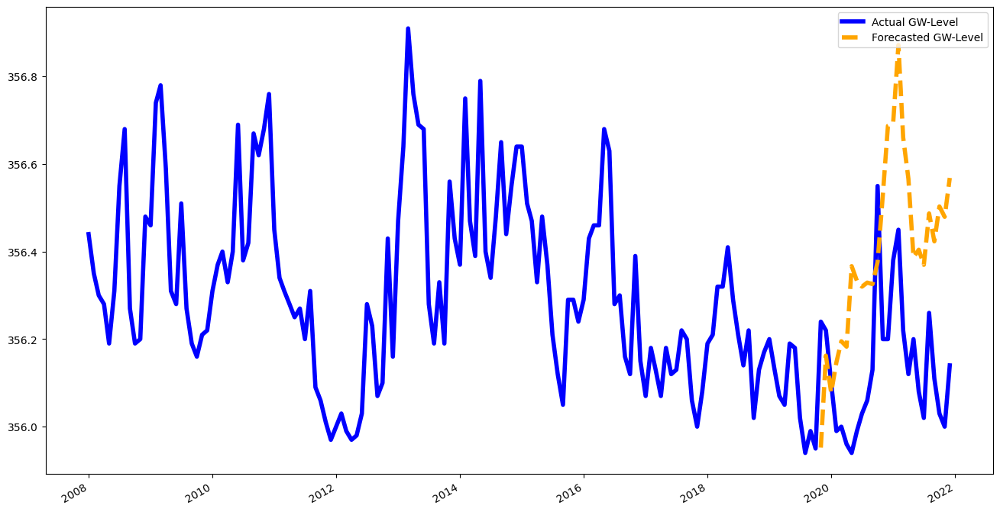



N train dates: 266
1997-06-01 00:00:00 till 2019-10-01 00:00:00
N forecast dates (horizon): 26
2019-11-01 00:00:00 till 2021-12-01 00:00:00
> SMAPE Score: 0.081383
First timepoint: 1997-06-01 00:00:00
Last timepoint:	 2021-12-01 00:00:00


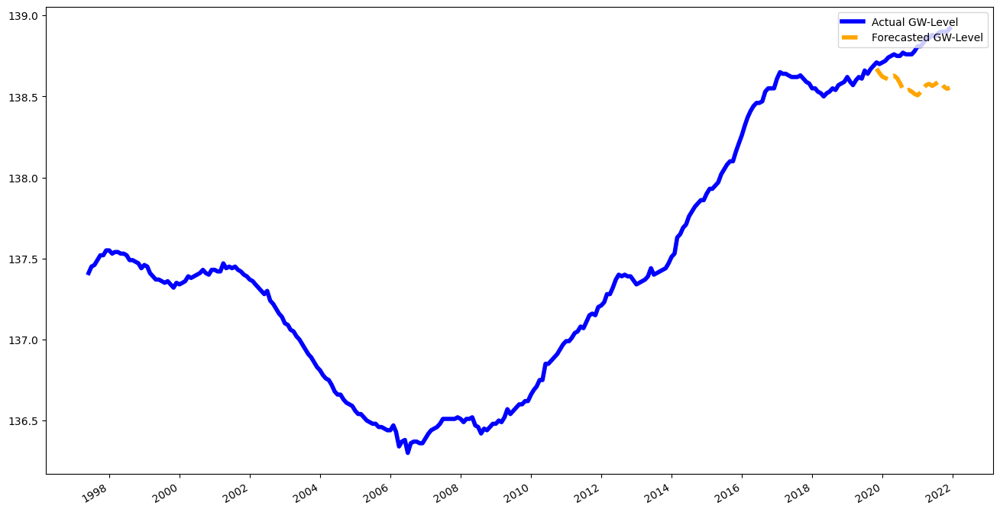



N train dates: 539
1974-11-01 00:00:00 till 2019-10-01 00:00:00
N forecast dates (horizon): 26
2019-11-01 00:00:00 till 2021-12-01 00:00:00
> SMAPE Score: 0.023729
First timepoint: 1974-11-01 00:00:00
Last timepoint:	 2021-12-01 00:00:00


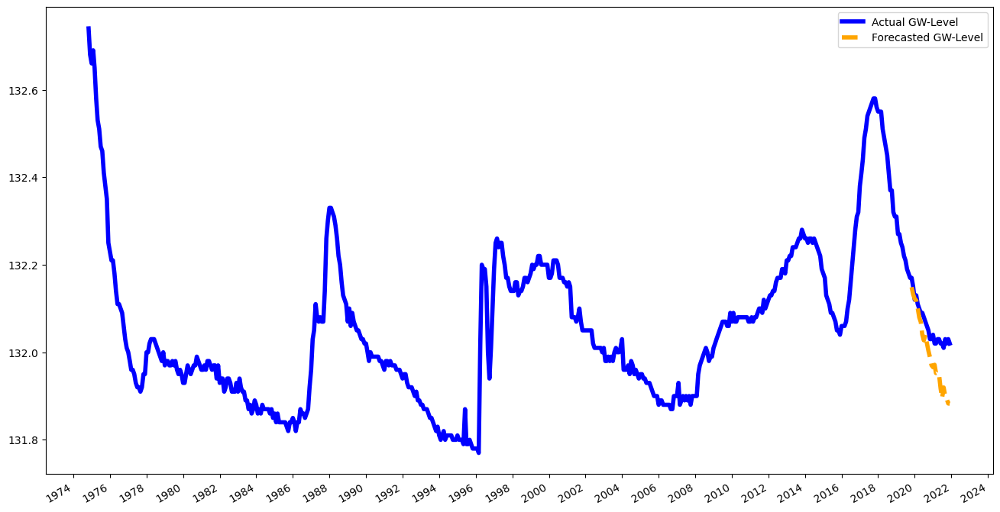



N train dates: 202
2003-01-01 00:00:00 till 2019-10-01 00:00:00
N forecast dates (horizon): 26
2019-11-01 00:00:00 till 2021-12-01 00:00:00
> SMAPE Score: 0.203579
First timepoint: 2003-01-01 00:00:00
Last timepoint:	 2021-12-01 00:00:00


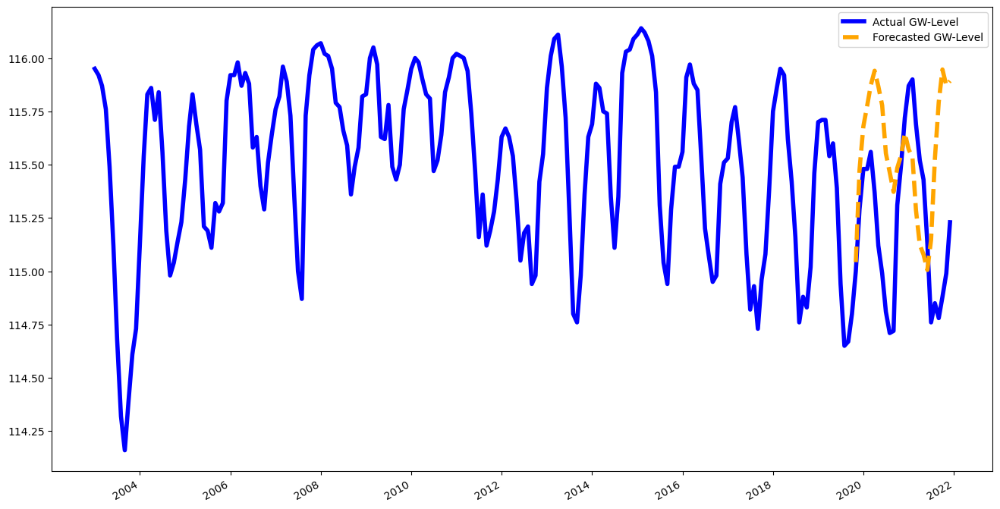



N train dates: 384
1987-07-01 00:00:00 till 2019-10-01 00:00:00
N forecast dates (horizon): 26
2019-11-01 00:00:00 till 2021-12-01 00:00:00
> SMAPE Score: 0.100129
First timepoint: 1987-07-01 00:00:00
Last timepoint:	 2021-12-01 00:00:00


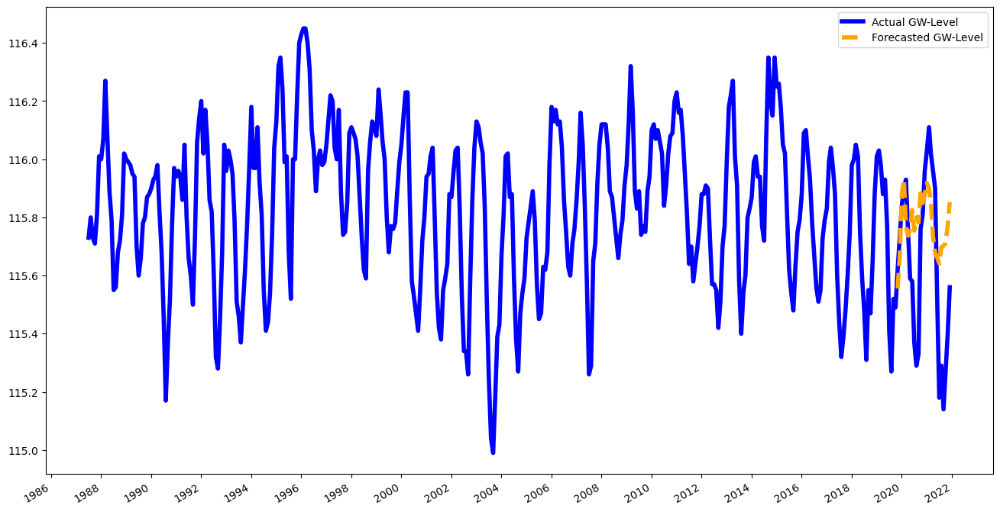



N train dates: 186
2004-01-01 00:00:00 till 2019-10-01 00:00:00
N forecast dates (horizon): 22
2019-11-01 00:00:00 till 2021-12-01 00:00:00
> SMAPE Score: 0.14459
First timepoint: 2004-01-01 00:00:00
Last timepoint:	 2021-12-01 00:00:00


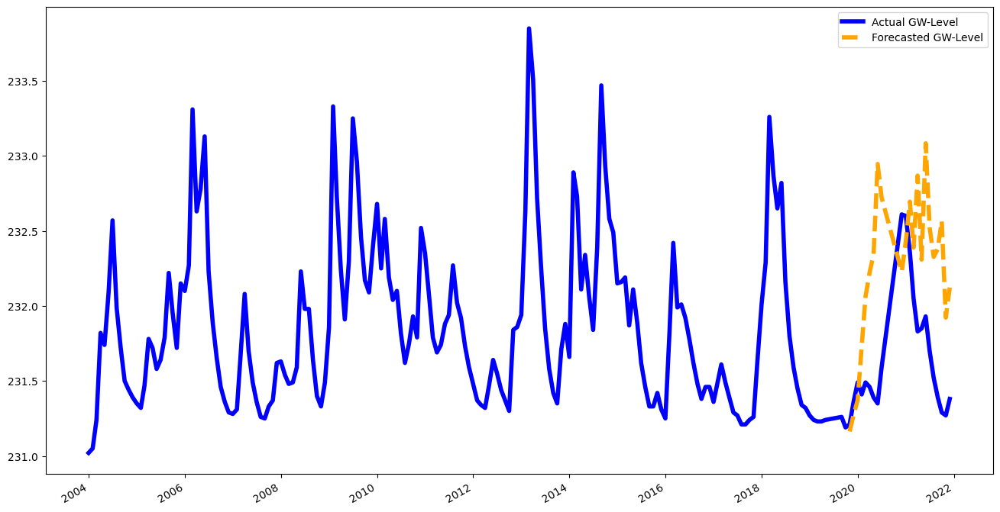



N train dates: 190
2004-01-01 00:00:00 till 2019-10-01 00:00:00
N forecast dates (horizon): 26
2019-11-01 00:00:00 till 2021-12-01 00:00:00
> SMAPE Score: 0.055354
First timepoint: 2004-01-01 00:00:00
Last timepoint:	 2021-12-01 00:00:00


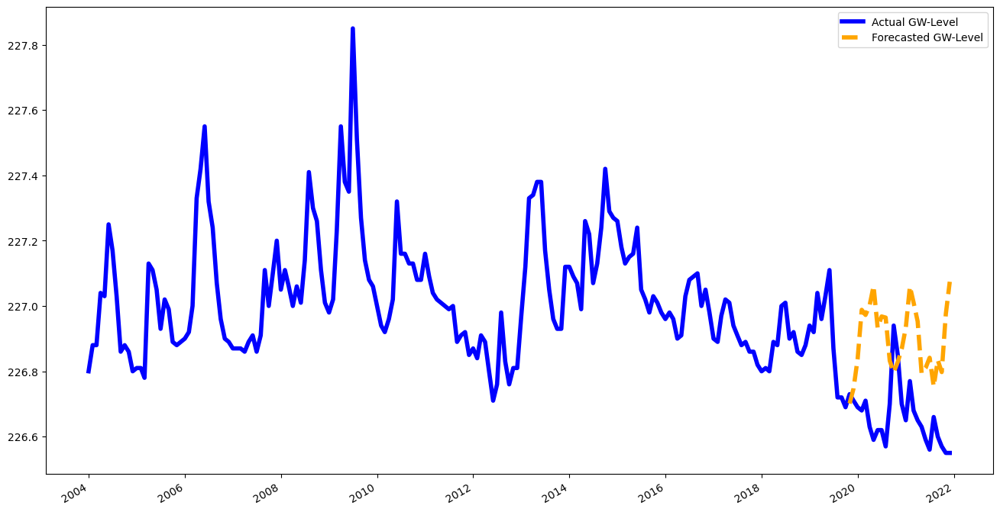



N train dates: 540
1974-11-01 00:00:00 till 2019-10-01 00:00:00
N forecast dates (horizon): 26
2019-11-01 00:00:00 till 2021-12-01 00:00:00
> SMAPE Score: 0.059919
First timepoint: 1974-11-01 00:00:00
Last timepoint:	 2021-12-01 00:00:00


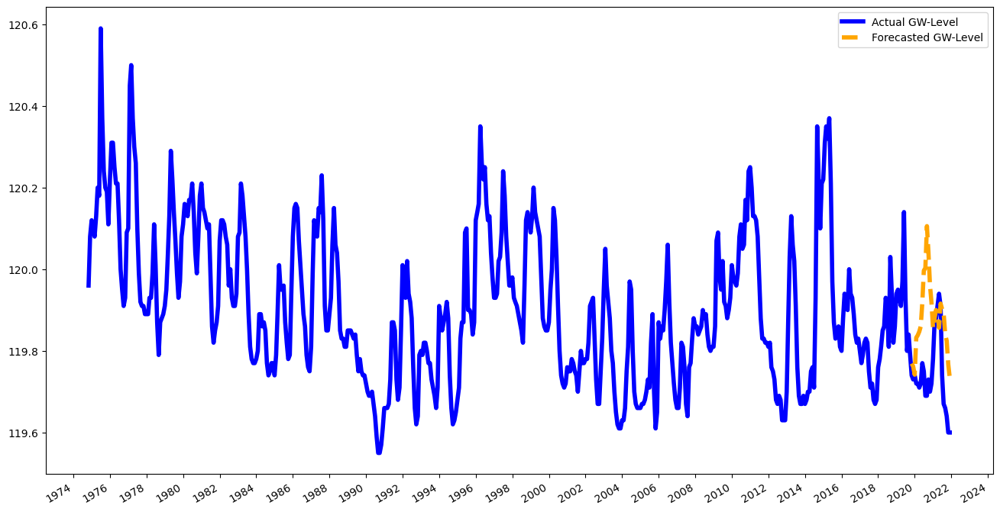



N train dates: 291
1995-08-01 00:00:00 till 2019-10-01 00:00:00
N forecast dates (horizon): 26
2019-11-01 00:00:00 till 2021-12-01 00:00:00
> SMAPE Score: 0.13059
First timepoint: 1995-08-01 00:00:00
Last timepoint:	 2021-12-01 00:00:00


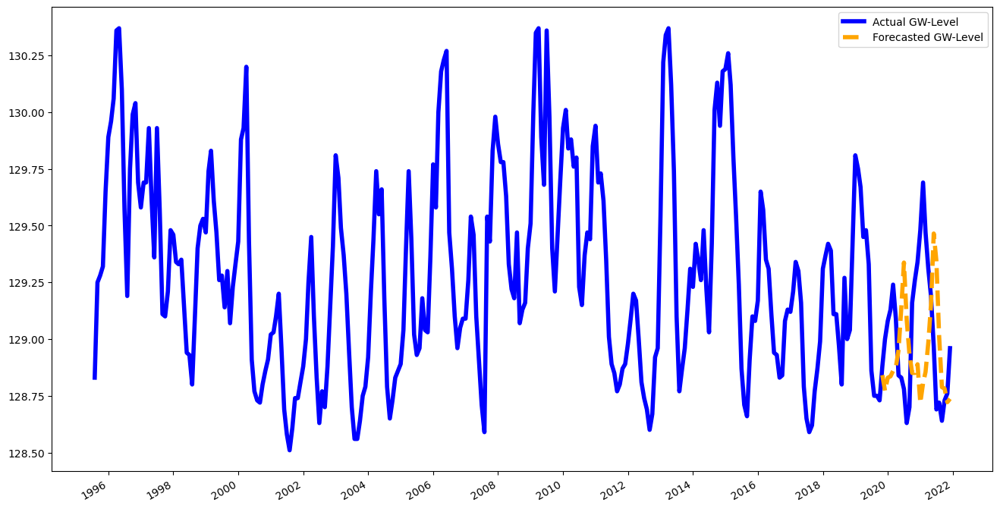



N train dates: 190
2004-01-01 00:00:00 till 2019-10-01 00:00:00
N forecast dates (horizon): 26
2019-11-01 00:00:00 till 2021-12-01 00:00:00
> SMAPE Score: 0.210908
First timepoint: 2004-01-01 00:00:00
Last timepoint:	 2021-12-01 00:00:00


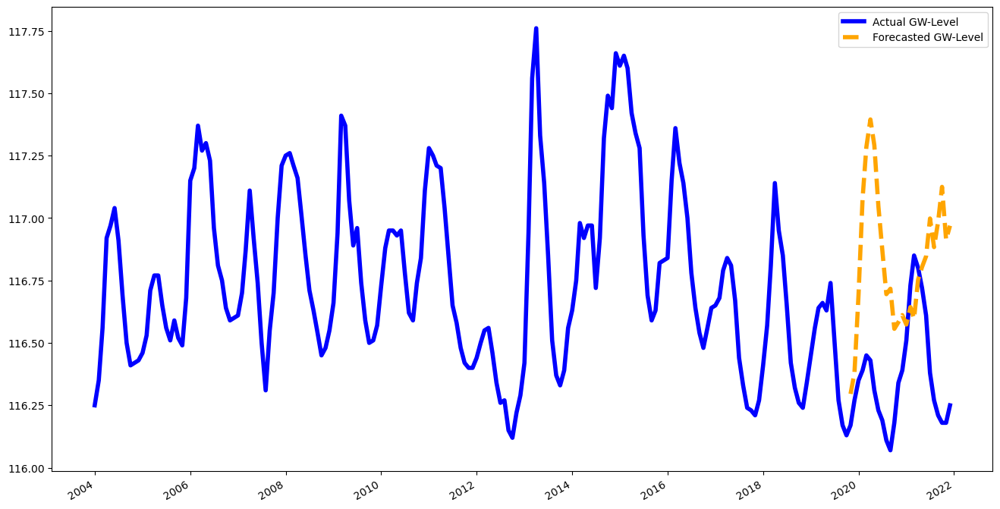



N train dates: 450
1975-04-01 00:00:00 till 2018-12-01 00:00:00
N forecast dates (horizon): 6
2020-01-01 00:00:00 till 2021-02-01 00:00:00
> SMAPE Score: 0.014216
First timepoint: 1975-04-01 00:00:00
Last timepoint:	 2021-02-01 00:00:00


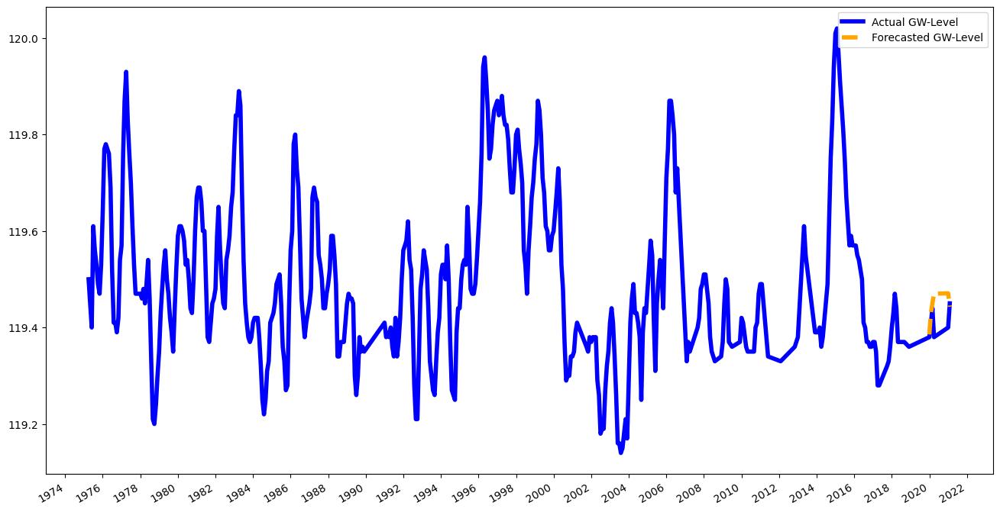



N train dates: 23
2017-12-01 00:00:00 till 2019-10-01 00:00:00
N forecast dates (horizon): 26
2019-11-01 00:00:00 till 2021-12-01 00:00:00
> SMAPE Score: 0.1432
First timepoint: 2017-12-01 00:00:00
Last timepoint:	 2021-12-01 00:00:00


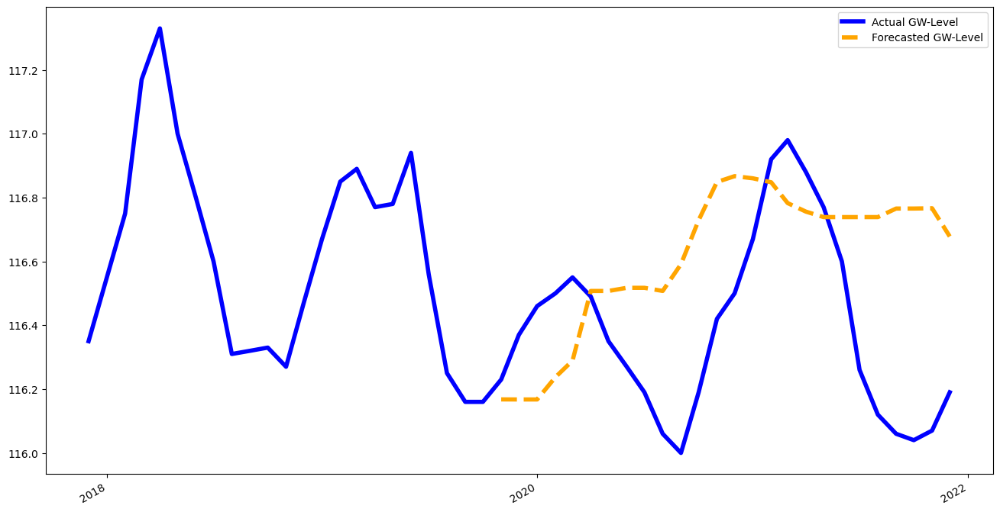



N train dates: 405
1960-01-01 00:00:00 till 2019-10-01 00:00:00
N forecast dates (horizon): 26
2019-11-01 00:00:00 till 2021-12-01 00:00:00
> SMAPE Score: 0.016358
First timepoint: 1960-01-01 00:00:00
Last timepoint:	 2021-12-01 00:00:00


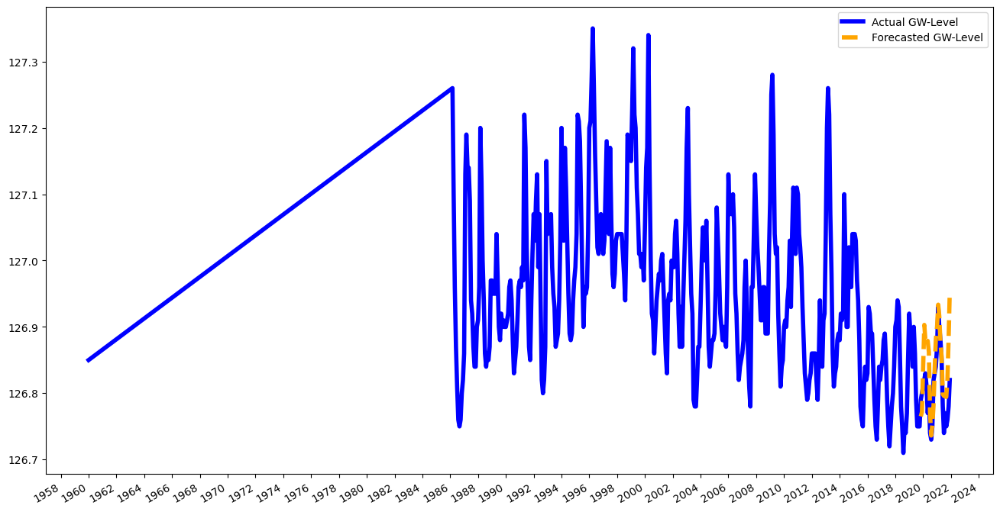



N train dates: 288
1995-01-01 00:00:00 till 2019-10-01 00:00:00
N forecast dates (horizon): 26
2019-11-01 00:00:00 till 2021-12-01 00:00:00
> SMAPE Score: 0.238129
First timepoint: 1995-01-01 00:00:00
Last timepoint:	 2021-12-01 00:00:00


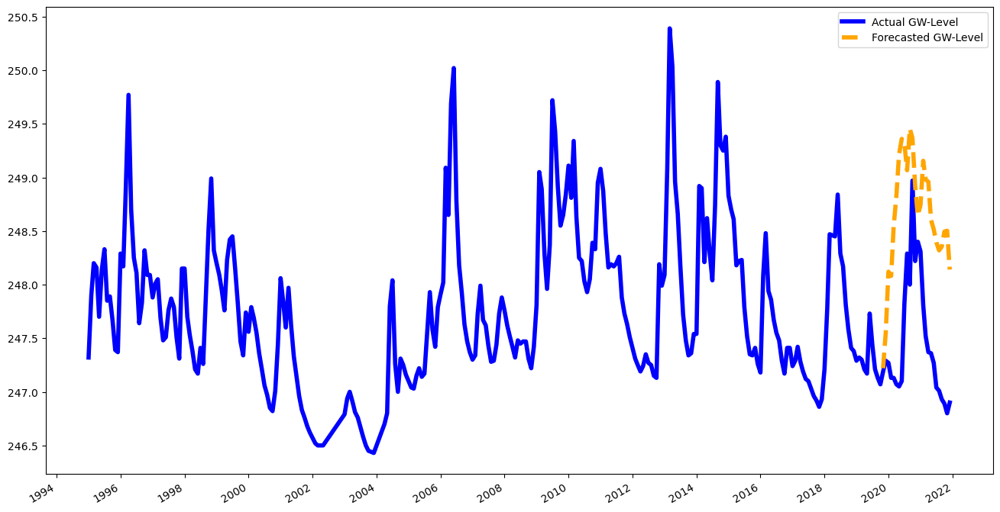



N train dates: 310
1994-01-01 00:00:00 till 2019-10-01 00:00:00
N forecast dates (horizon): 26
2019-11-01 00:00:00 till 2021-12-01 00:00:00
> SMAPE Score: 0.010206
First timepoint: 1994-01-01 00:00:00
Last timepoint:	 2021-12-01 00:00:00


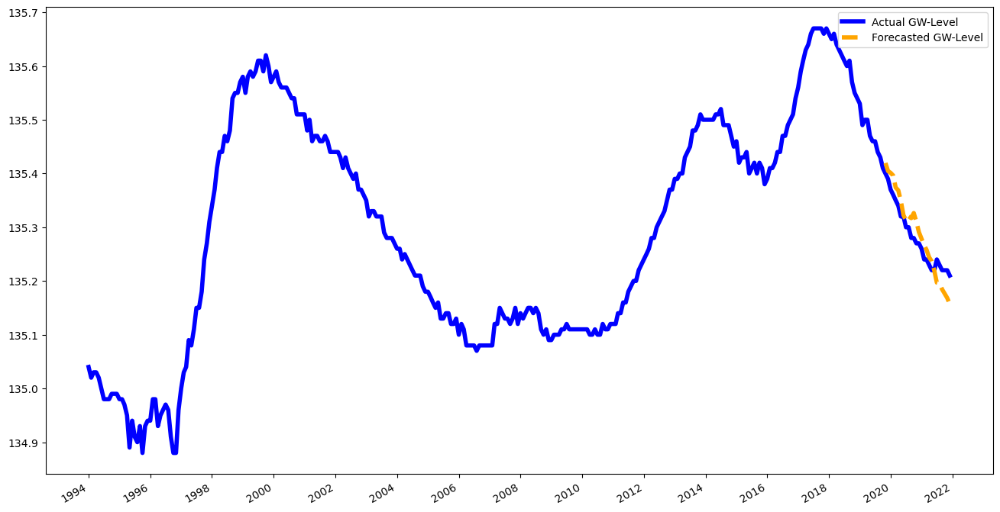



N train dates: 269
1997-01-01 00:00:00 till 2019-10-01 00:00:00
N forecast dates (horizon): 26
2019-11-01 00:00:00 till 2021-12-01 00:00:00
> SMAPE Score: 0.185863
First timepoint: 1997-01-01 00:00:00
Last timepoint:	 2021-12-01 00:00:00


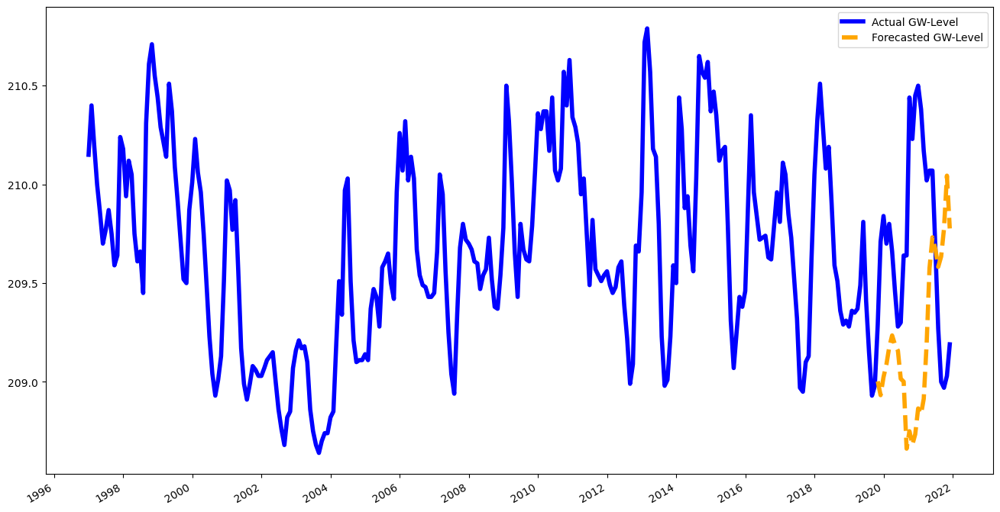



N train dates: 57
2015-02-01 00:00:00 till 2019-10-01 00:00:00
N forecast dates (horizon): 26
2019-11-01 00:00:00 till 2021-12-01 00:00:00
> SMAPE Score: 0.072262
First timepoint: 2015-02-01 00:00:00
Last timepoint:	 2021-12-01 00:00:00


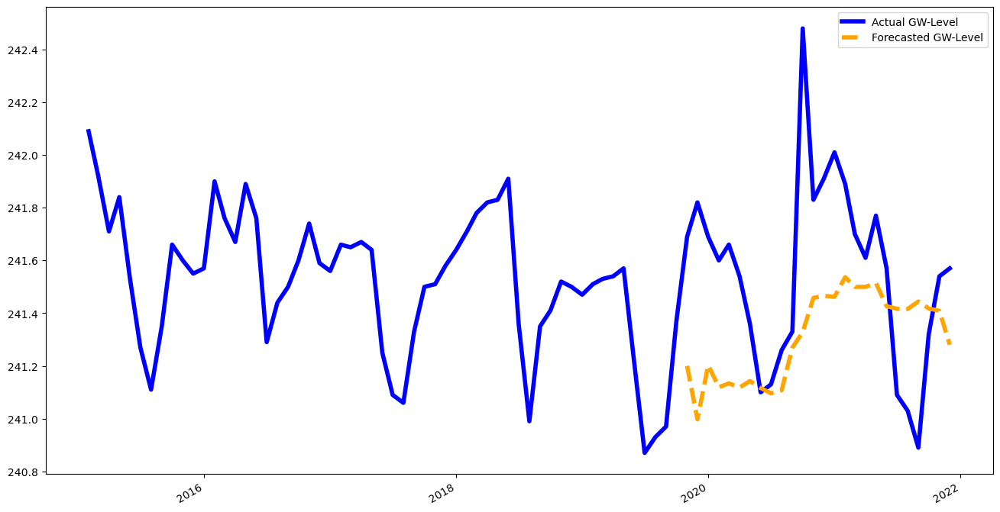



N train dates: 487
1979-04-01 00:00:00 till 2019-10-01 00:00:00
N forecast dates (horizon): 26
2019-11-01 00:00:00 till 2021-12-01 00:00:00
> SMAPE Score: 0.069791
First timepoint: 1979-04-01 00:00:00
Last timepoint:	 2021-12-01 00:00:00


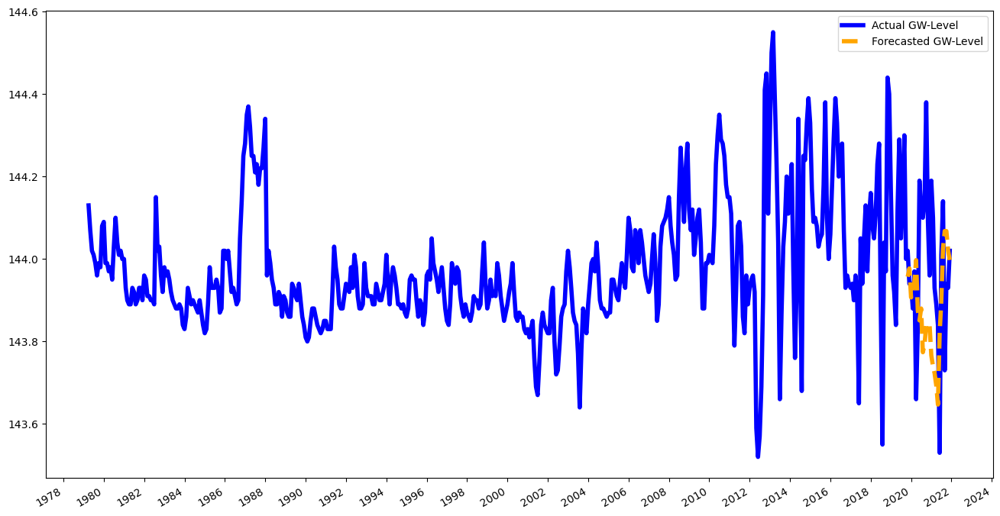



N train dates: 287
1993-01-01 00:00:00 till 2019-10-01 00:00:00
N forecast dates (horizon): 26
2019-11-01 00:00:00 till 2021-12-01 00:00:00
> SMAPE Score: 0.085562
First timepoint: 1993-01-01 00:00:00
Last timepoint:	 2021-12-01 00:00:00


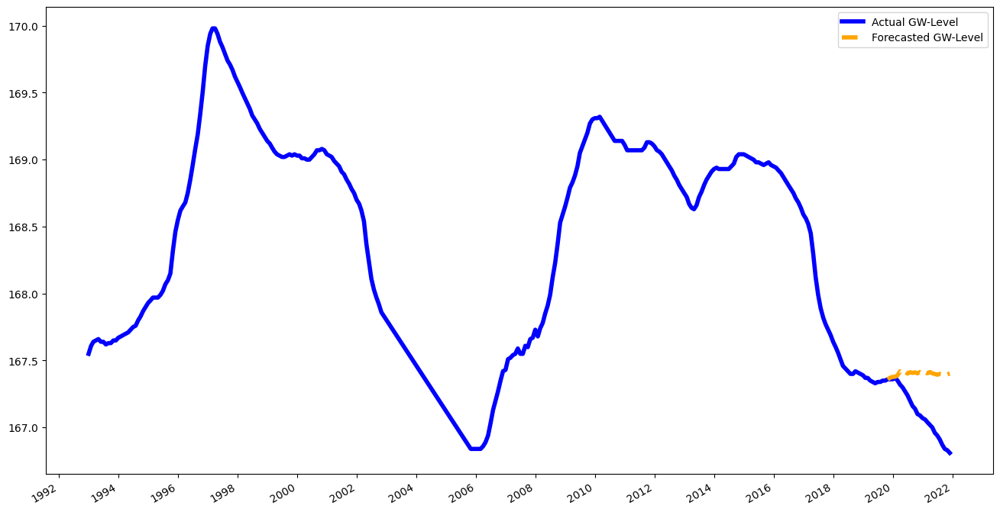



N train dates: 322
1993-01-01 00:00:00 till 2019-10-01 00:00:00
N forecast dates (horizon): 26
2019-11-01 00:00:00 till 2021-12-01 00:00:00
> SMAPE Score: 0.248222
First timepoint: 1993-01-01 00:00:00
Last timepoint:	 2021-12-01 00:00:00


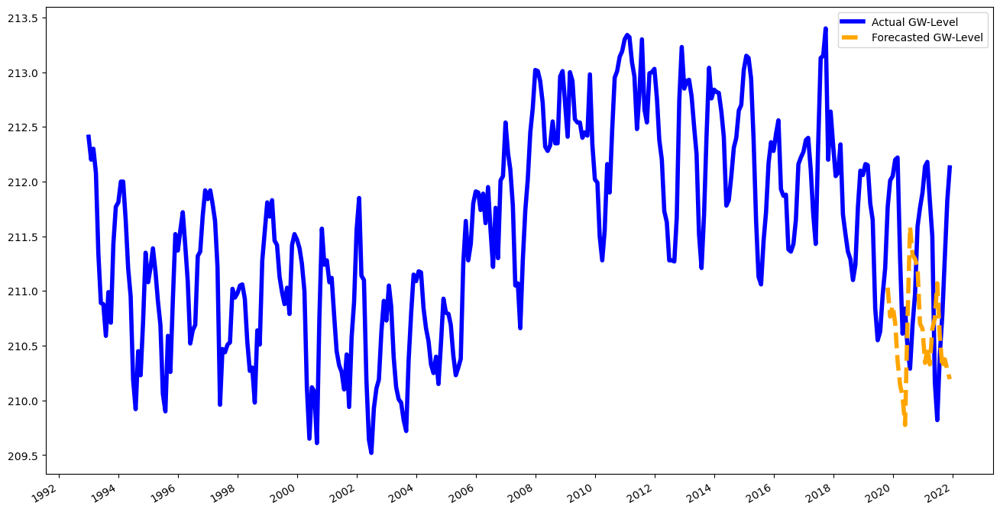



N train dates: 166
2006-01-01 00:00:00 till 2019-10-01 00:00:00
N forecast dates (horizon): 26
2019-11-01 00:00:00 till 2021-12-01 00:00:00
> SMAPE Score: 0.045273
First timepoint: 2006-01-01 00:00:00
Last timepoint:	 2021-12-01 00:00:00


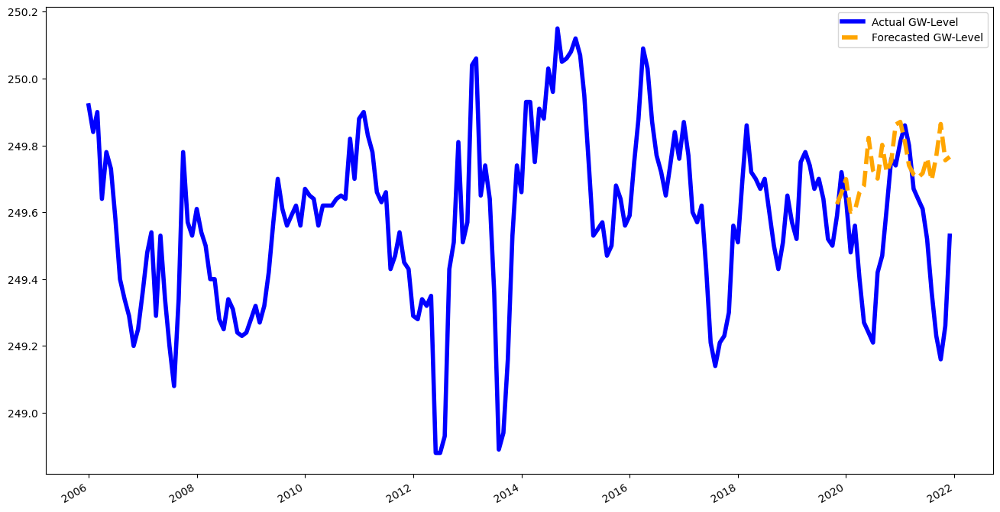



N train dates: 248
1999-01-01 00:00:00 till 2019-10-01 00:00:00
N forecast dates (horizon): 26
2019-11-01 00:00:00 till 2021-12-01 00:00:00
> SMAPE Score: 0.088439
First timepoint: 1999-01-01 00:00:00
Last timepoint:	 2021-12-01 00:00:00


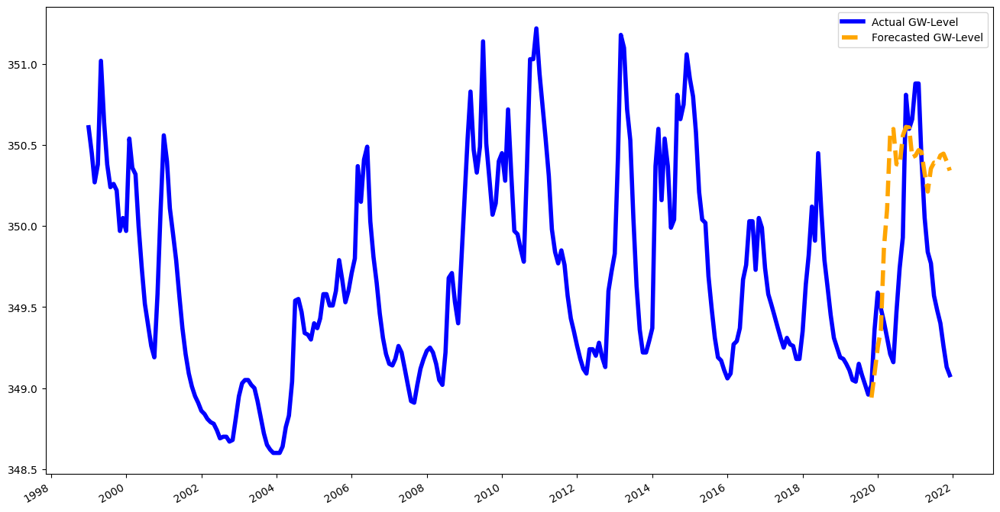



N train dates: 789
1953-11-01 00:00:00 till 2019-10-01 00:00:00
N forecast dates (horizon): 26
2019-11-01 00:00:00 till 2021-12-01 00:00:00
> SMAPE Score: 0.082668
First timepoint: 1953-11-01 00:00:00
Last timepoint:	 2021-12-01 00:00:00


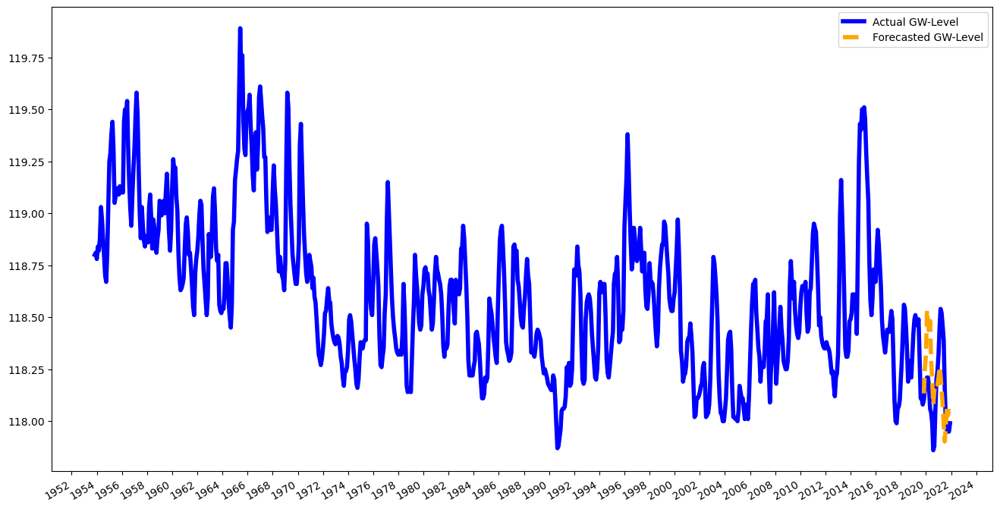



N train dates: 250
1999-01-01 00:00:00 till 2019-10-01 00:00:00
N forecast dates (horizon): 26
2019-11-01 00:00:00 till 2021-12-01 00:00:00
> SMAPE Score: 0.070246
First timepoint: 1999-01-01 00:00:00
Last timepoint:	 2021-12-01 00:00:00


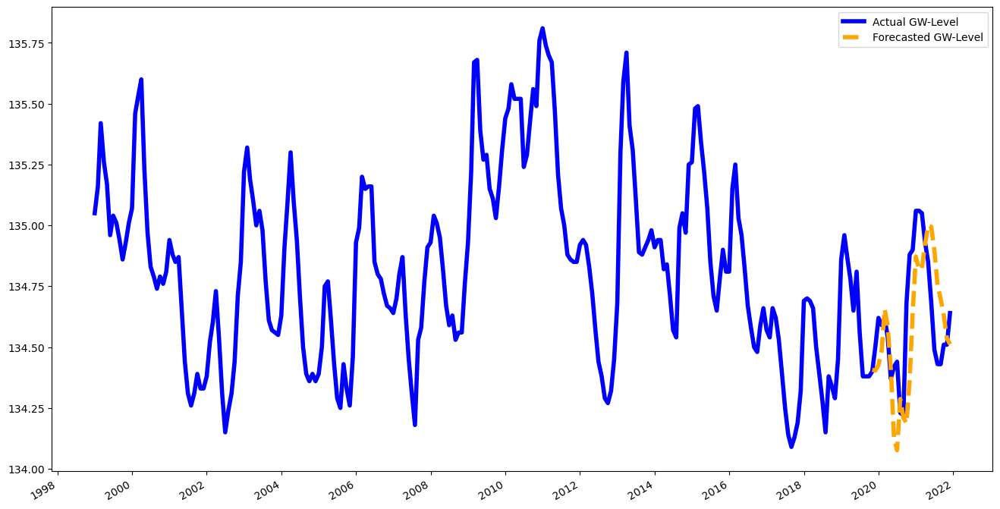



N train dates: 273
1997-01-01 00:00:00 till 2019-10-01 00:00:00
N forecast dates (horizon): 26
2019-11-01 00:00:00 till 2021-12-01 00:00:00
> SMAPE Score: 0.093814
First timepoint: 1997-01-01 00:00:00
Last timepoint:	 2021-12-01 00:00:00


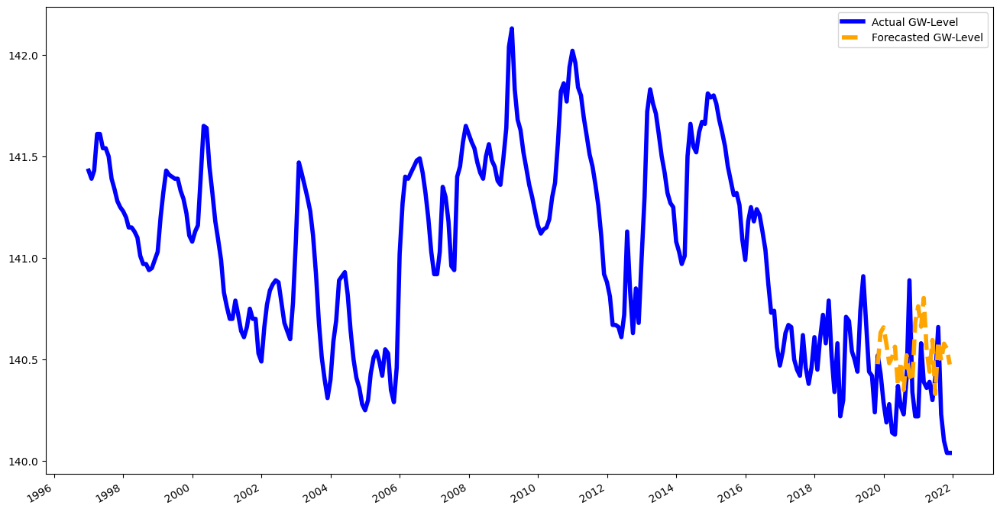



N train dates: 352
1984-01-01 00:00:00 till 2019-10-01 00:00:00
N forecast dates (horizon): 13
2019-11-01 00:00:00 till 2021-12-01 00:00:00
> SMAPE Score: 0.036979
First timepoint: 1984-01-01 00:00:00
Last timepoint:	 2021-12-01 00:00:00


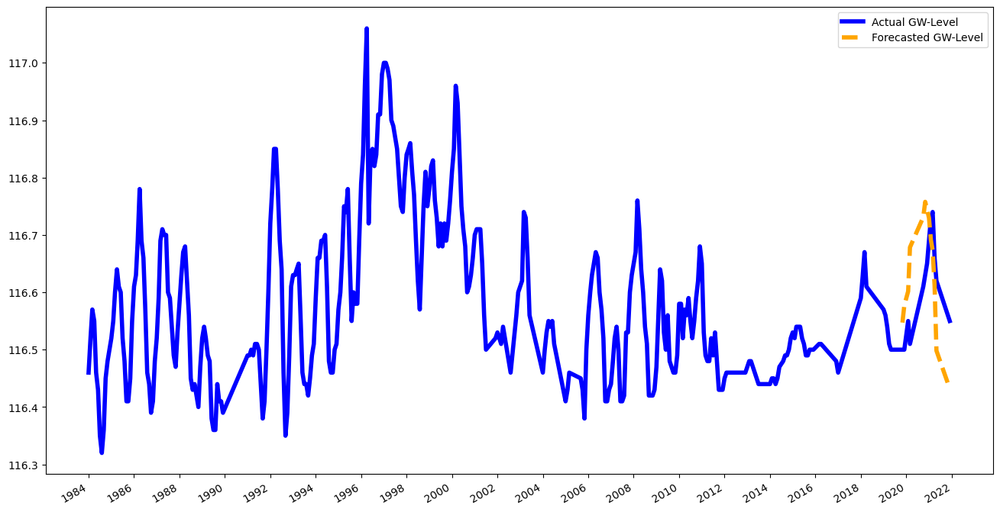



N train dates: 493
1978-09-01 00:00:00 till 2019-10-01 00:00:00
N forecast dates (horizon): 26
2019-11-01 00:00:00 till 2021-12-01 00:00:00
> SMAPE Score: 0.08926
First timepoint: 1978-09-01 00:00:00
Last timepoint:	 2021-12-01 00:00:00


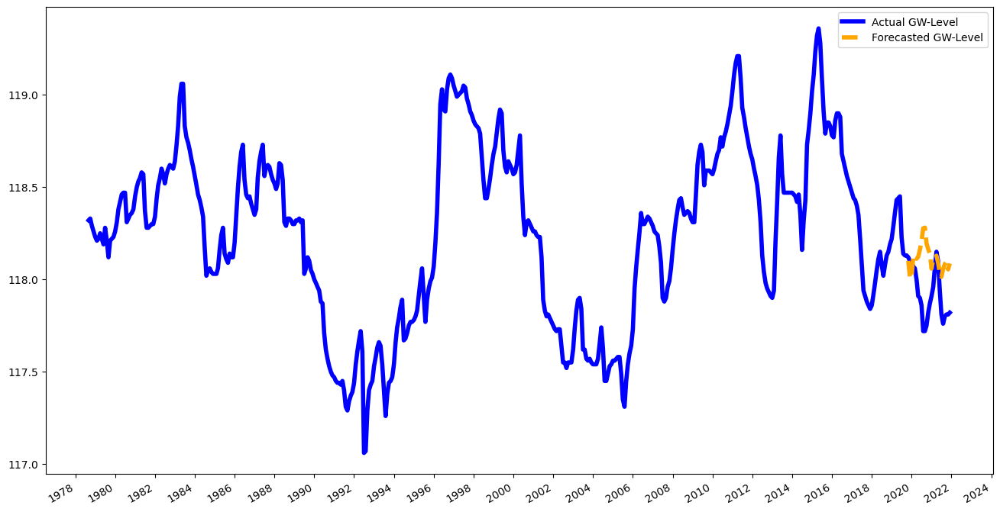



N train dates: 214
2002-01-01 00:00:00 till 2019-10-01 00:00:00
N forecast dates (horizon): 24
2019-11-01 00:00:00 till 2021-12-01 00:00:00
> SMAPE Score: 0.240001
First timepoint: 2002-01-01 00:00:00
Last timepoint:	 2021-12-01 00:00:00


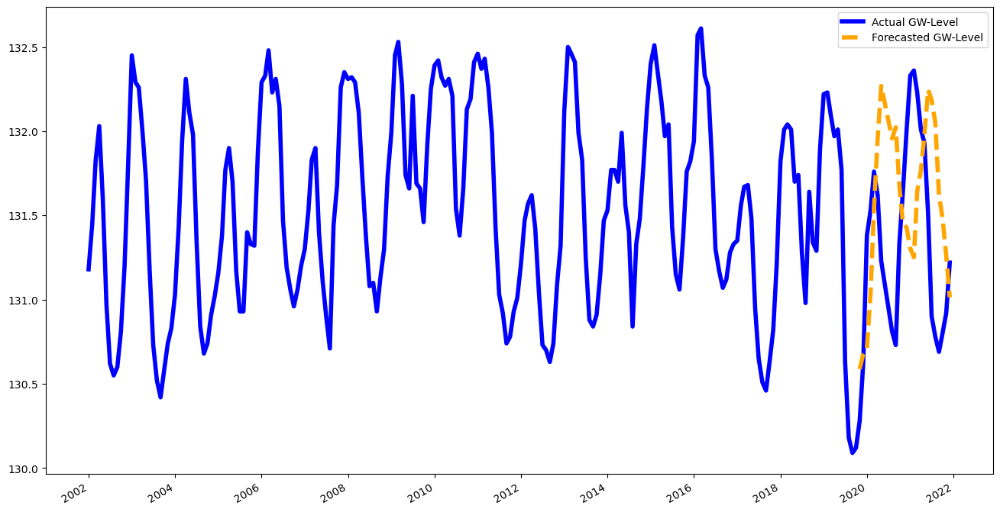



N train dates: 406
1986-01-01 00:00:00 till 2019-10-01 00:00:00
N forecast dates (horizon): 26
2019-11-01 00:00:00 till 2021-12-01 00:00:00
> SMAPE Score: 0.146922
First timepoint: 1986-01-01 00:00:00
Last timepoint:	 2021-12-01 00:00:00


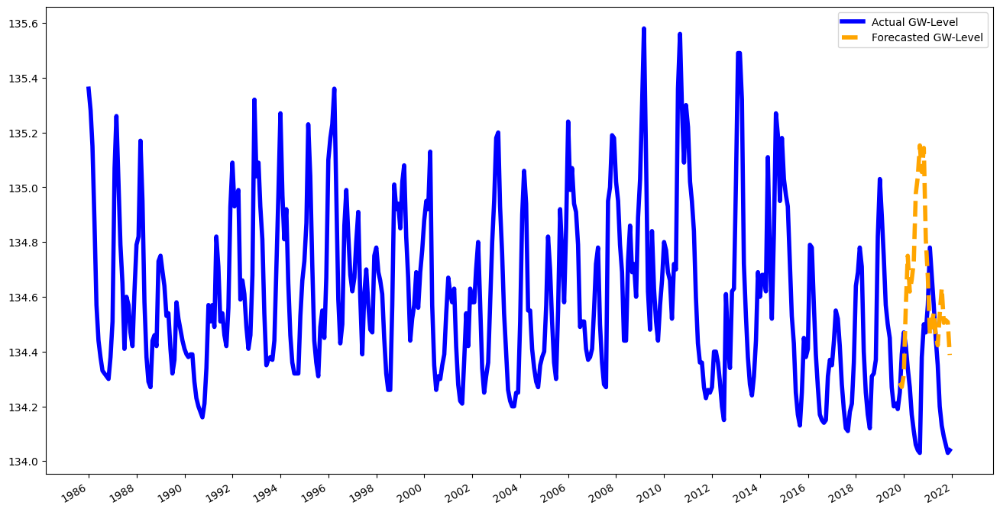



N train dates: 377
1988-01-01 00:00:00 till 2019-10-01 00:00:00
N forecast dates (horizon): 26
2019-11-01 00:00:00 till 2021-12-01 00:00:00
> SMAPE Score: 0.072663
First timepoint: 1988-01-01 00:00:00
Last timepoint:	 2021-12-01 00:00:00


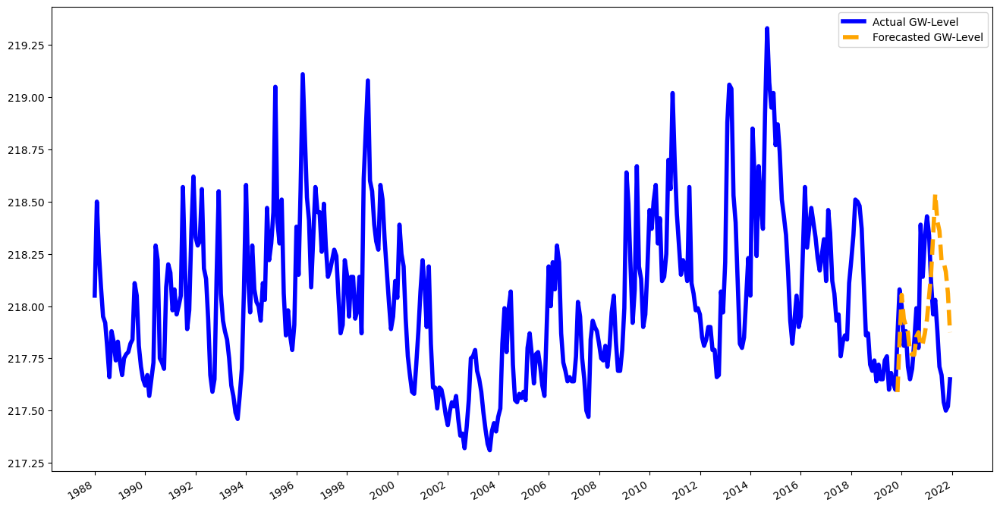



N train dates: 333
1992-01-01 00:00:00 till 2019-10-01 00:00:00
N forecast dates (horizon): 26
2019-11-01 00:00:00 till 2021-12-01 00:00:00
> SMAPE Score: 0.10299
First timepoint: 1992-01-01 00:00:00
Last timepoint:	 2021-12-01 00:00:00


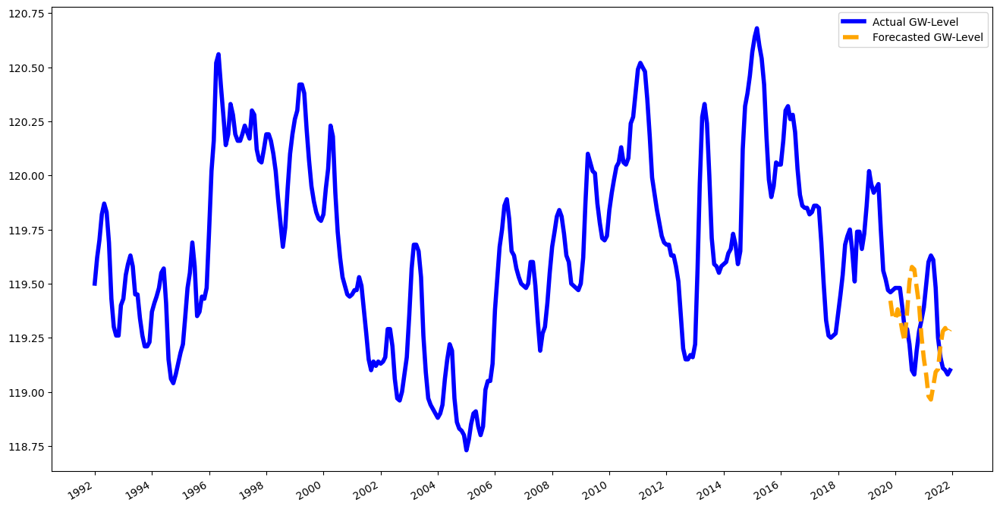



N train dates: 34
2017-01-01 00:00:00 till 2019-10-01 00:00:00
N forecast dates (horizon): 26
2019-11-01 00:00:00 till 2021-12-01 00:00:00
> SMAPE Score: 0.092112
First timepoint: 2017-01-01 00:00:00
Last timepoint:	 2021-12-01 00:00:00


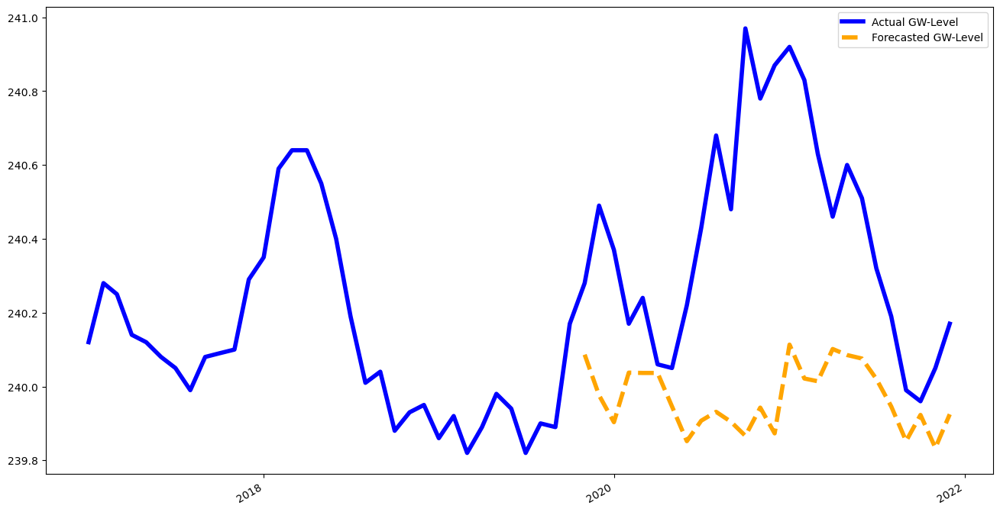



N train dates: 508
1975-04-01 00:00:00 till 2019-10-01 00:00:00
N forecast dates (horizon): 22
2019-11-01 00:00:00 till 2021-12-01 00:00:00
> SMAPE Score: 0.059857
First timepoint: 1975-04-01 00:00:00
Last timepoint:	 2021-12-01 00:00:00


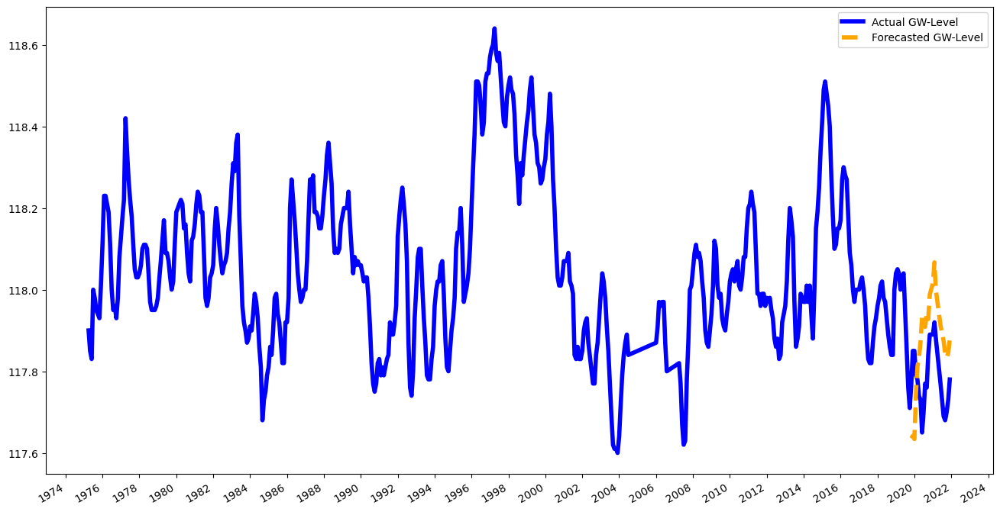



N train dates: 382
1988-01-01 00:00:00 till 2019-10-01 00:00:00
N forecast dates (horizon): 26
2019-11-01 00:00:00 till 2021-12-01 00:00:00
> SMAPE Score: 0.083888
First timepoint: 1988-01-01 00:00:00
Last timepoint:	 2021-12-01 00:00:00


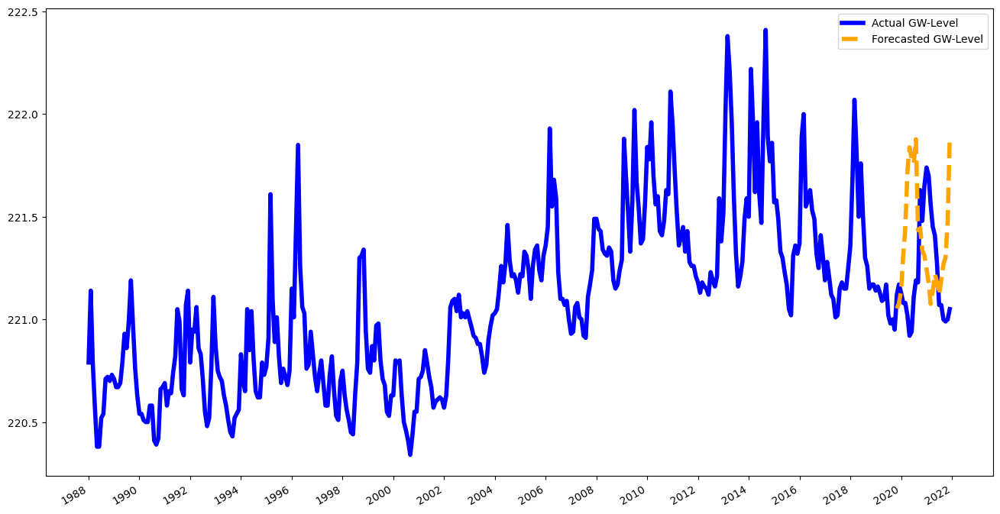



N train dates: 178
2005-01-01 00:00:00 till 2019-10-01 00:00:00
N forecast dates (horizon): 26
2019-11-01 00:00:00 till 2021-12-01 00:00:00
> SMAPE Score: 0.12894
First timepoint: 2005-01-01 00:00:00
Last timepoint:	 2021-12-01 00:00:00


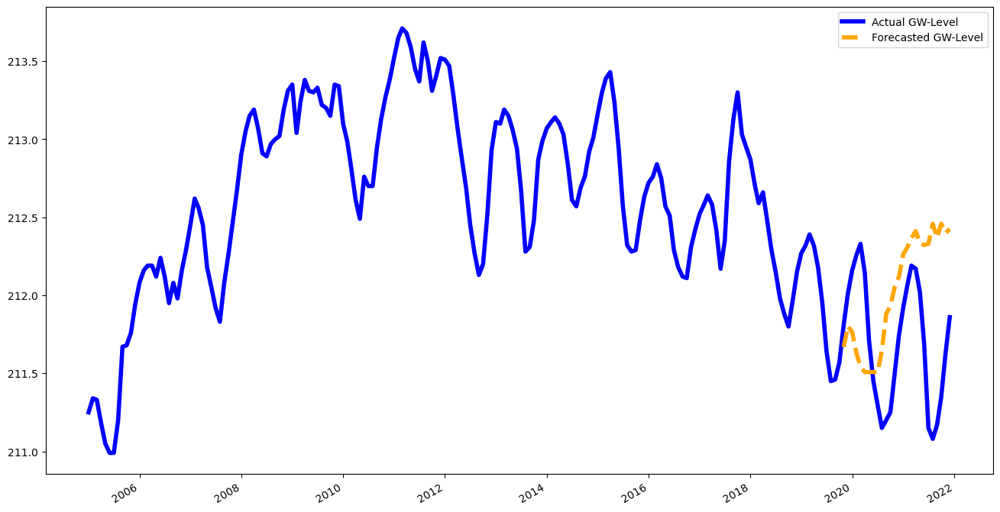



N train dates: 322
1993-01-01 00:00:00 till 2019-10-01 00:00:00
N forecast dates (horizon): 26
2019-11-01 00:00:00 till 2021-12-01 00:00:00
> SMAPE Score: 0.036383
First timepoint: 1993-01-01 00:00:00
Last timepoint:	 2021-12-01 00:00:00


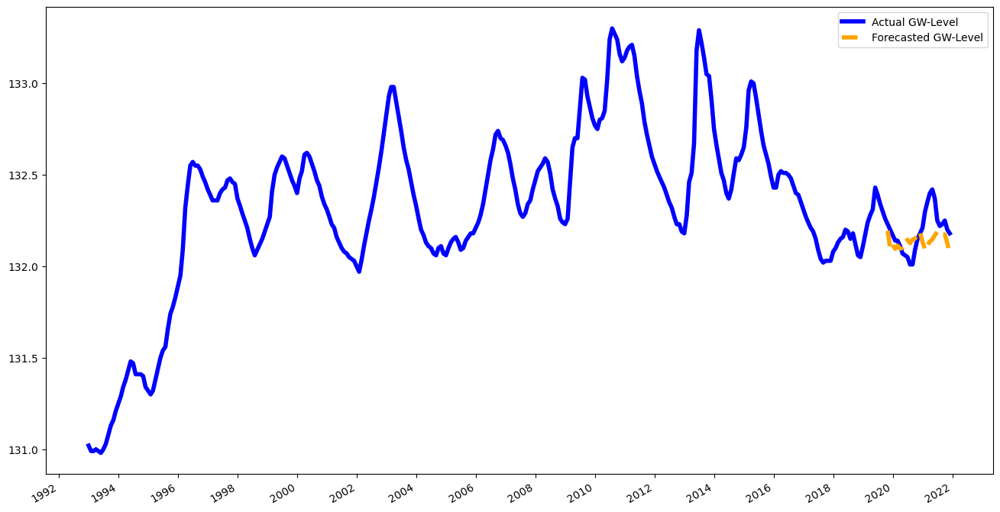



N train dates: 271
1997-04-01 00:00:00 till 2019-10-01 00:00:00
N forecast dates (horizon): 26
2019-11-01 00:00:00 till 2021-12-01 00:00:00
> SMAPE Score: 0.105594
First timepoint: 1997-04-01 00:00:00
Last timepoint:	 2021-12-01 00:00:00


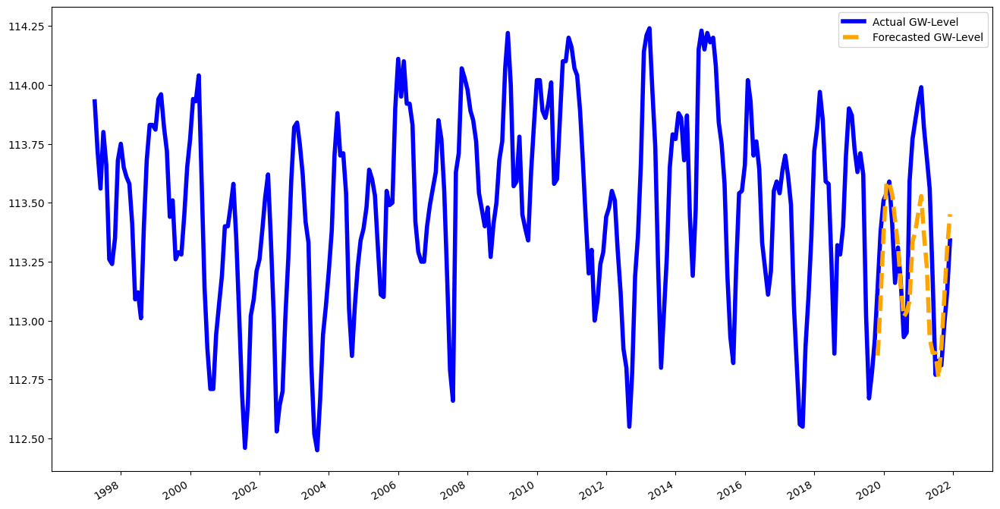



N train dates: 362
1989-01-01 00:00:00 till 2019-10-01 00:00:00
N forecast dates (horizon): 26
2019-11-01 00:00:00 till 2021-12-01 00:00:00
> SMAPE Score: 0.065626
First timepoint: 1989-01-01 00:00:00
Last timepoint:	 2021-12-01 00:00:00


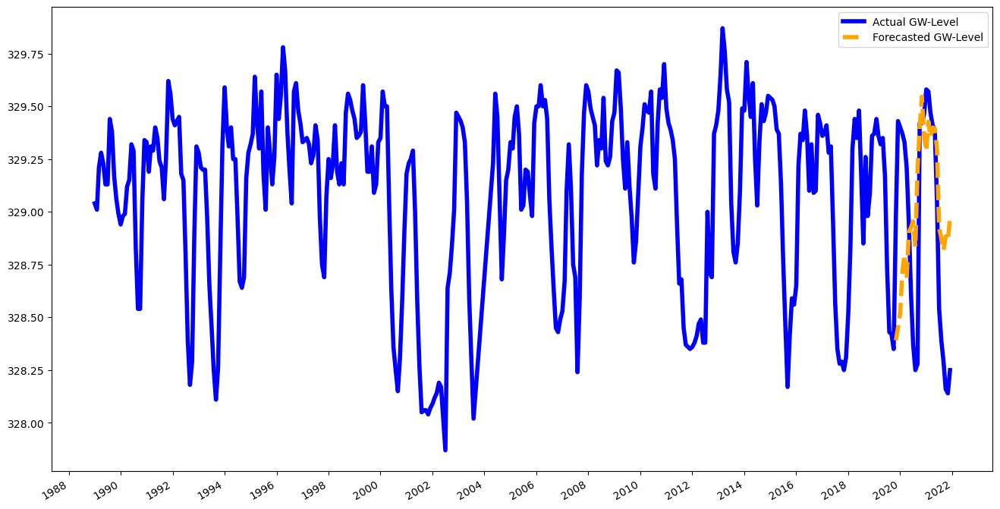



N train dates: 235
1999-07-01 00:00:00 till 2019-10-01 00:00:00
N forecast dates (horizon): 26
2019-11-01 00:00:00 till 2021-12-01 00:00:00
> SMAPE Score: 0.044011
First timepoint: 1999-07-01 00:00:00
Last timepoint:	 2021-12-01 00:00:00


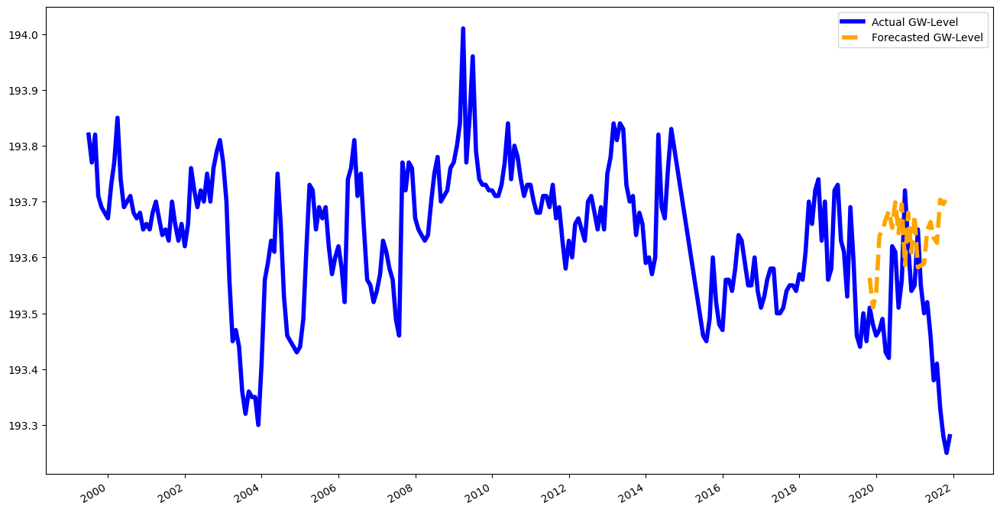



N train dates: 552
1973-11-01 00:00:00 till 2019-10-01 00:00:00
N forecast dates (horizon): 26
2019-11-01 00:00:00 till 2021-12-01 00:00:00
> SMAPE Score: 0.059243
First timepoint: 1973-11-01 00:00:00
Last timepoint:	 2021-12-01 00:00:00


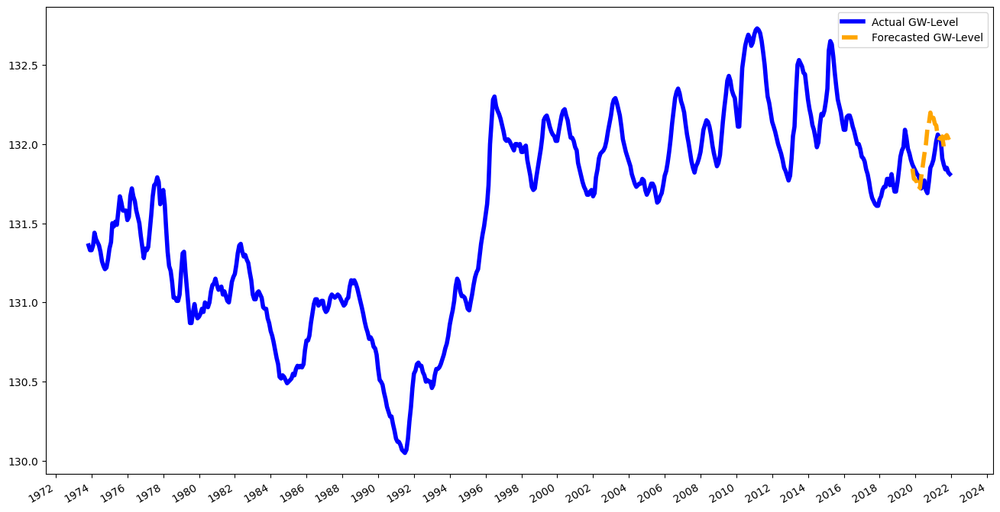



N train dates: 664
1962-07-01 00:00:00 till 2019-10-01 00:00:00
N forecast dates (horizon): 26
2019-11-01 00:00:00 till 2021-12-01 00:00:00
> SMAPE Score: 0.125878
First timepoint: 1962-07-01 00:00:00
Last timepoint:	 2021-12-01 00:00:00


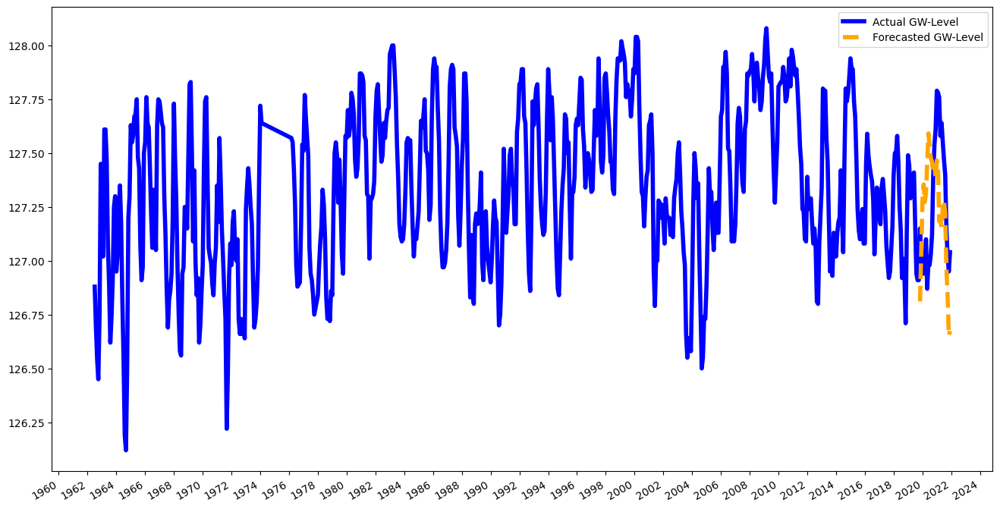



N train dates: 677
1963-04-01 00:00:00 till 2019-10-01 00:00:00
N forecast dates (horizon): 14
2019-11-01 00:00:00 till 2020-12-01 00:00:00
> SMAPE Score: 0.396202
First timepoint: 1963-04-01 00:00:00
Last timepoint:	 2020-12-01 00:00:00


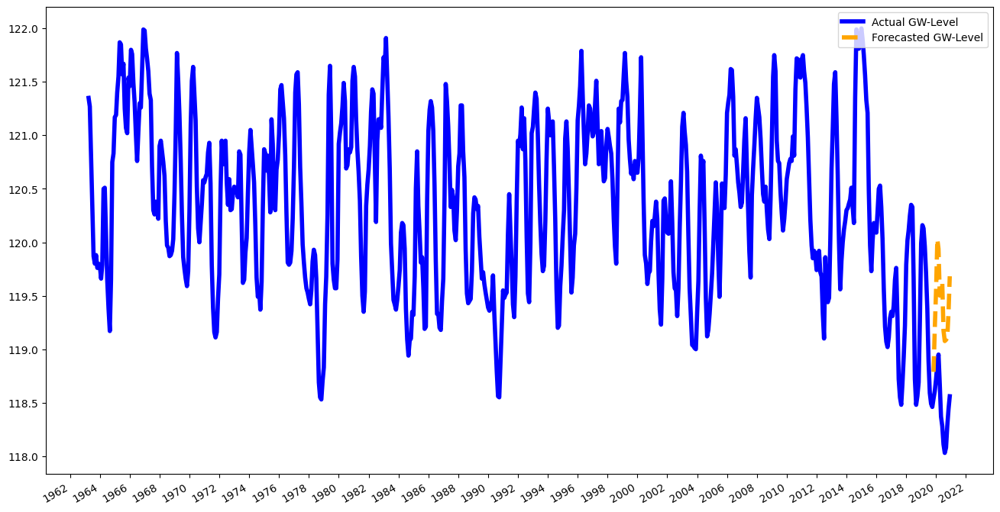



N train dates: 378
1988-01-01 00:00:00 till 2019-10-01 00:00:00
N forecast dates (horizon): 26
2019-11-01 00:00:00 till 2021-12-01 00:00:00
> SMAPE Score: 0.067492
First timepoint: 1988-01-01 00:00:00
Last timepoint:	 2021-12-01 00:00:00


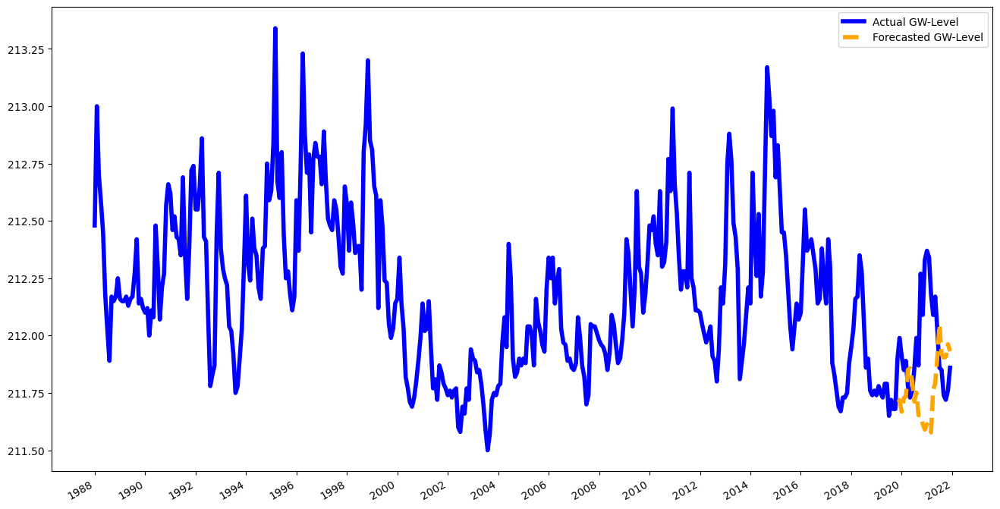



N train dates: 155
2006-04-01 00:00:00 till 2019-06-01 00:00:00
N forecast dates (horizon): 17
2020-08-01 00:00:00 till 2021-12-01 00:00:00
> SMAPE Score: 0.199458
First timepoint: 2006-04-01 00:00:00
Last timepoint:	 2021-12-01 00:00:00


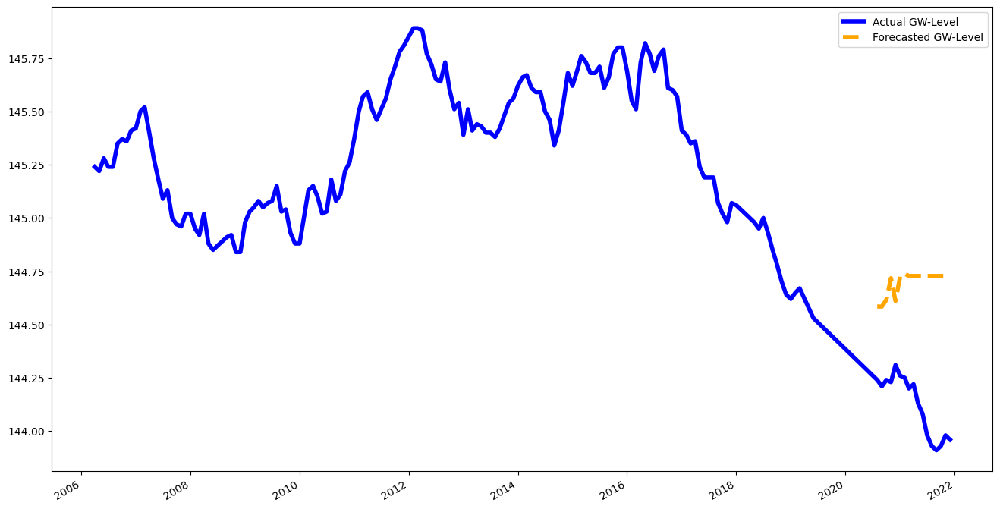



N train dates: 250
1999-01-01 00:00:00 till 2019-10-01 00:00:00
N forecast dates (horizon): 26
2019-11-01 00:00:00 till 2021-12-01 00:00:00
> SMAPE Score: 0.030712
First timepoint: 1999-01-01 00:00:00
Last timepoint:	 2021-12-01 00:00:00


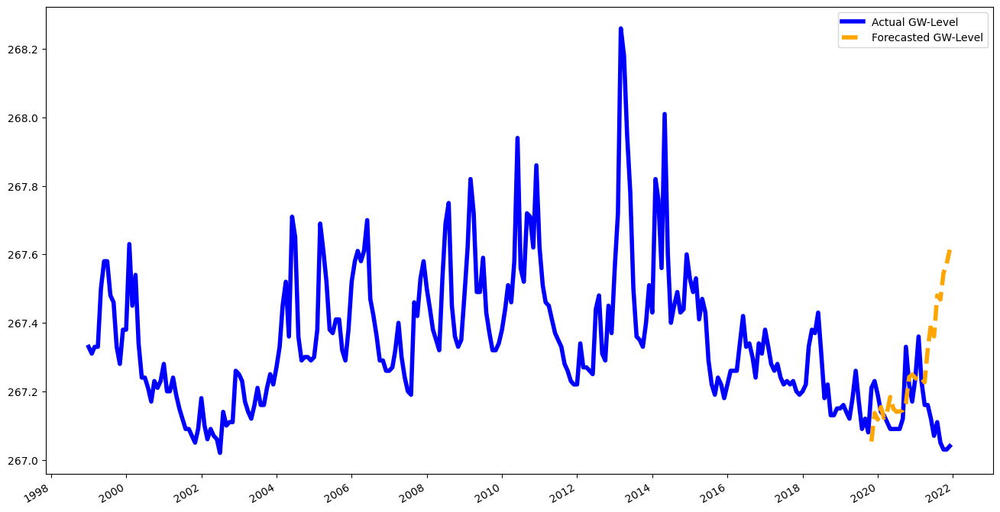



N train dates: 248
1999-01-01 00:00:00 till 2019-10-01 00:00:00
N forecast dates (horizon): 26
2019-11-01 00:00:00 till 2021-12-01 00:00:00
> SMAPE Score: 0.089957
First timepoint: 1999-01-01 00:00:00
Last timepoint:	 2021-12-01 00:00:00


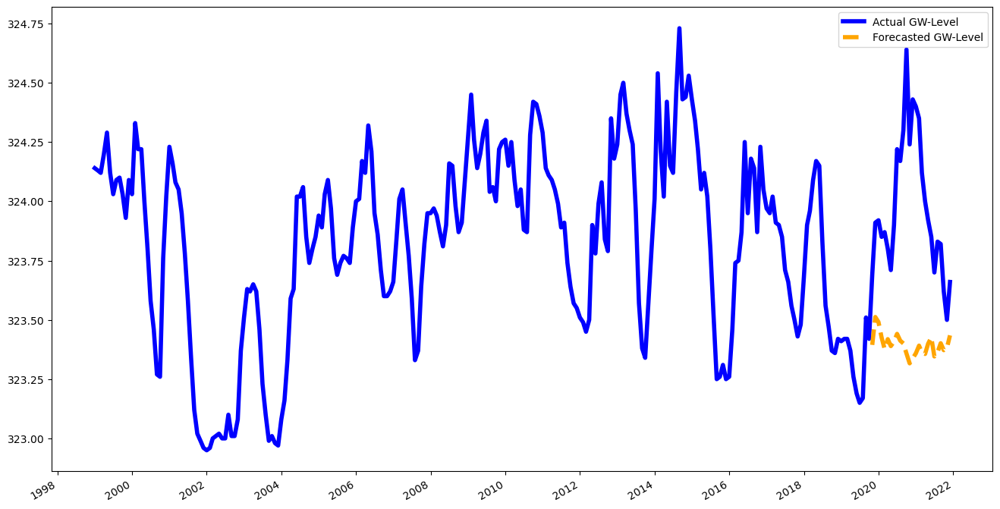



N train dates: 250
1999-01-01 00:00:00 till 2019-10-01 00:00:00
N forecast dates (horizon): 26
2019-11-01 00:00:00 till 2021-12-01 00:00:00
> SMAPE Score: 0.041055
First timepoint: 1999-01-01 00:00:00
Last timepoint:	 2021-12-01 00:00:00


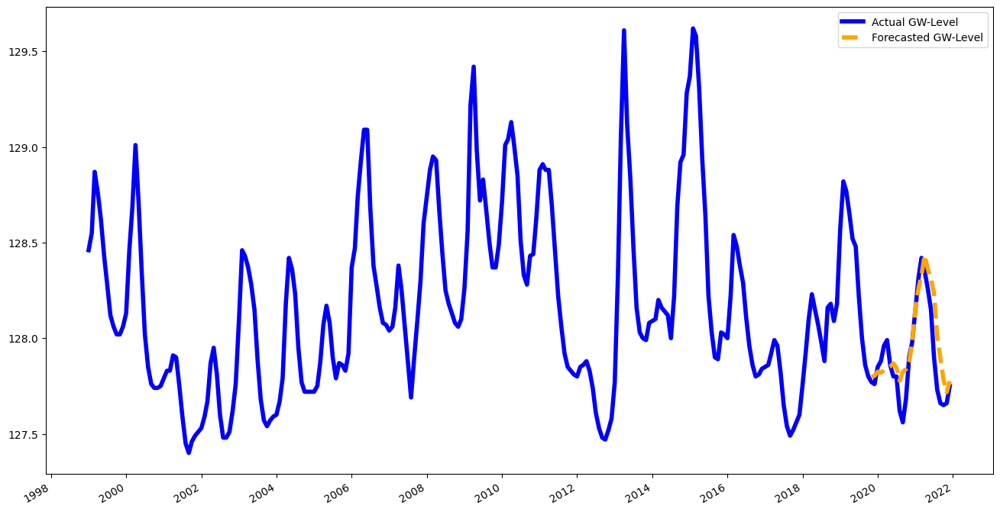



N train dates: 286
1996-01-01 00:00:00 till 2019-10-01 00:00:00
N forecast dates (horizon): 26
2019-11-01 00:00:00 till 2021-12-01 00:00:00
> SMAPE Score: 0.099229
First timepoint: 1996-01-01 00:00:00
Last timepoint:	 2021-12-01 00:00:00


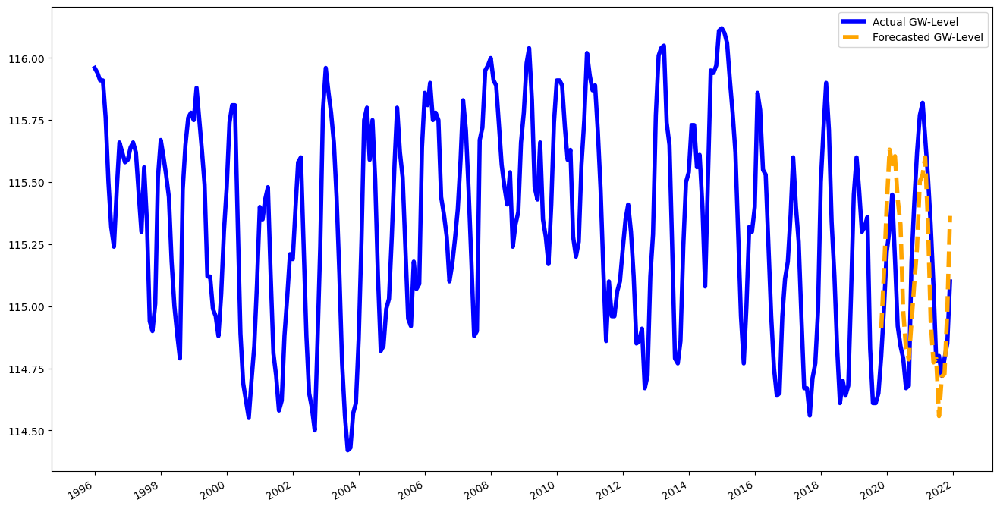



N train dates: 295
1995-04-01 00:00:00 till 2019-10-01 00:00:00
N forecast dates (horizon): 26
2019-11-01 00:00:00 till 2021-12-01 00:00:00
> SMAPE Score: 0.125577
First timepoint: 1995-04-01 00:00:00
Last timepoint:	 2021-12-01 00:00:00


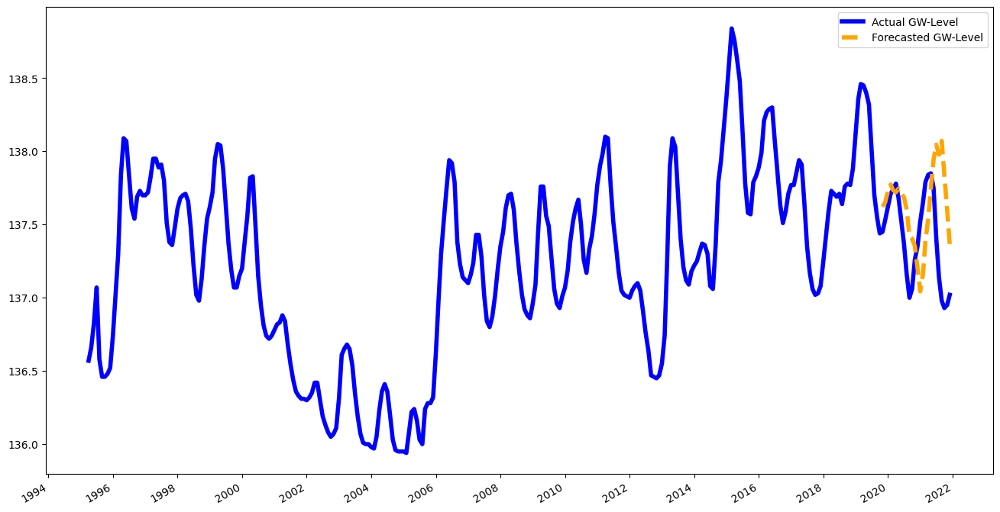



N train dates: 318
1993-05-01 00:00:00 till 2019-10-01 00:00:00
N forecast dates (horizon): 26
2019-11-01 00:00:00 till 2021-12-01 00:00:00
> SMAPE Score: 0.272359
First timepoint: 1993-05-01 00:00:00
Last timepoint:	 2021-12-01 00:00:00


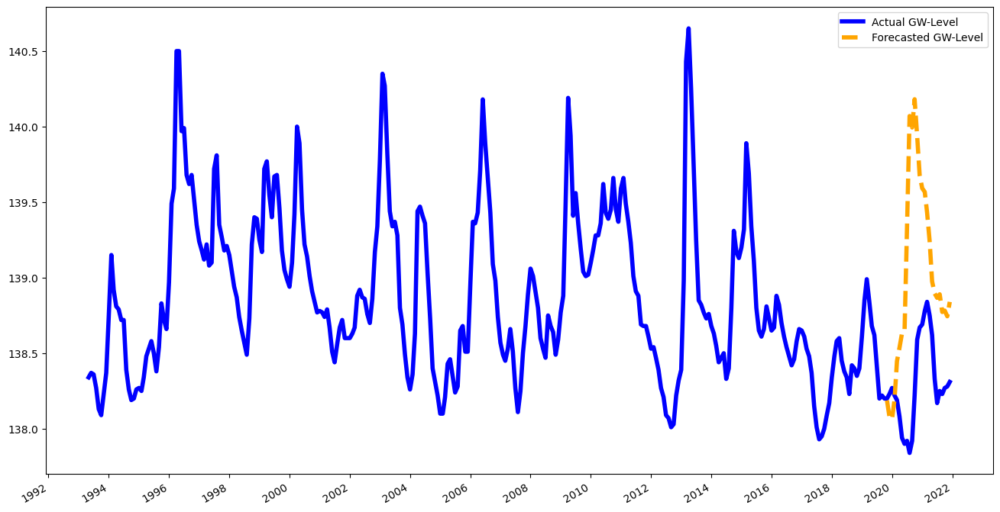



N train dates: 124
2009-02-01 00:00:00 till 2019-10-01 00:00:00
N forecast dates (horizon): 25
2019-11-01 00:00:00 till 2021-11-01 00:00:00
> SMAPE Score: 0.086818
First timepoint: 2009-02-01 00:00:00
Last timepoint:	 2021-11-01 00:00:00


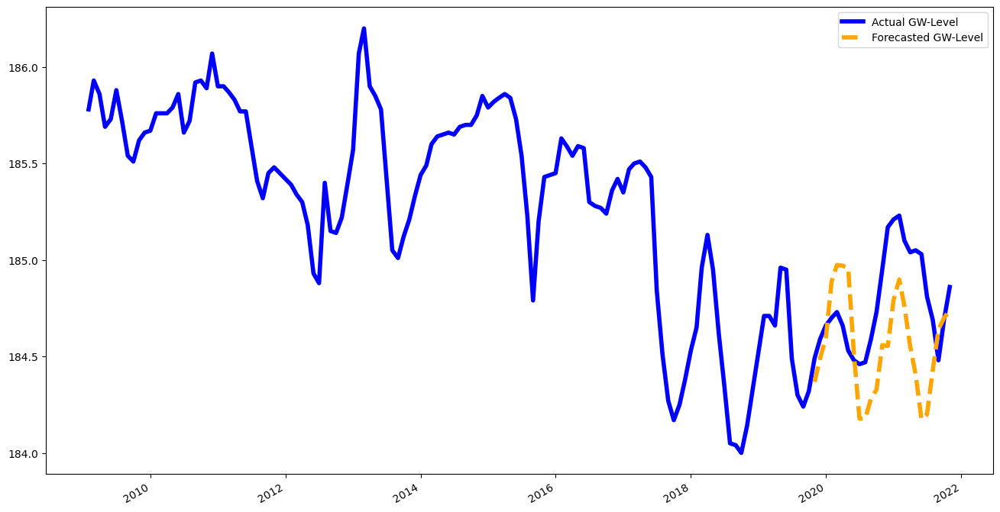



N train dates: 248
1999-01-01 00:00:00 till 2019-10-01 00:00:00
N forecast dates (horizon): 26
2019-11-01 00:00:00 till 2021-12-01 00:00:00
> SMAPE Score: 0.175686
First timepoint: 1999-01-01 00:00:00
Last timepoint:	 2021-12-01 00:00:00


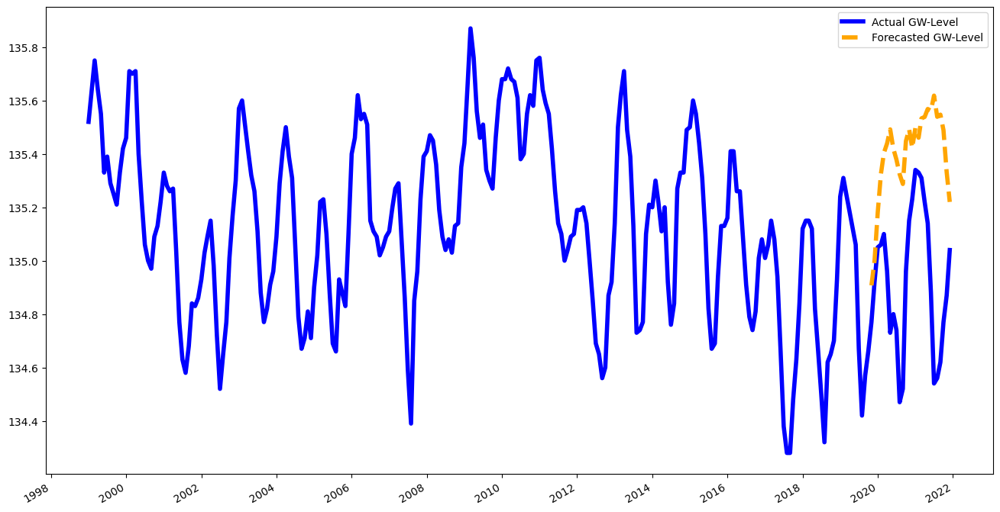



N train dates: 244
1999-01-01 00:00:00 till 2019-10-01 00:00:00
N forecast dates (horizon): 26
2019-11-01 00:00:00 till 2021-12-01 00:00:00
> SMAPE Score: 0.061354
First timepoint: 1999-01-01 00:00:00
Last timepoint:	 2021-12-01 00:00:00


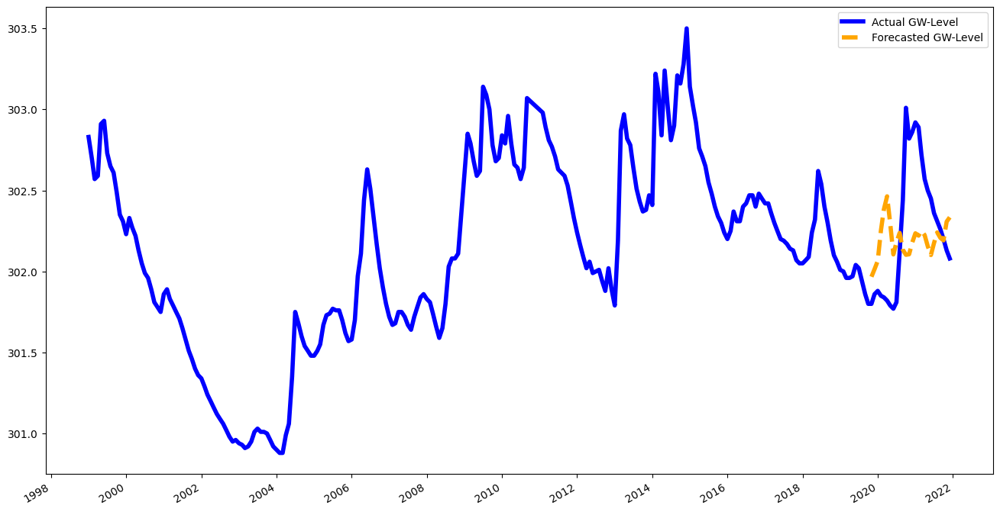



N train dates: 380
1988-01-01 00:00:00 till 2019-10-01 00:00:00
N forecast dates (horizon): 26
2019-11-01 00:00:00 till 2021-12-01 00:00:00
> SMAPE Score: 0.017226
First timepoint: 1988-01-01 00:00:00
Last timepoint:	 2021-12-01 00:00:00


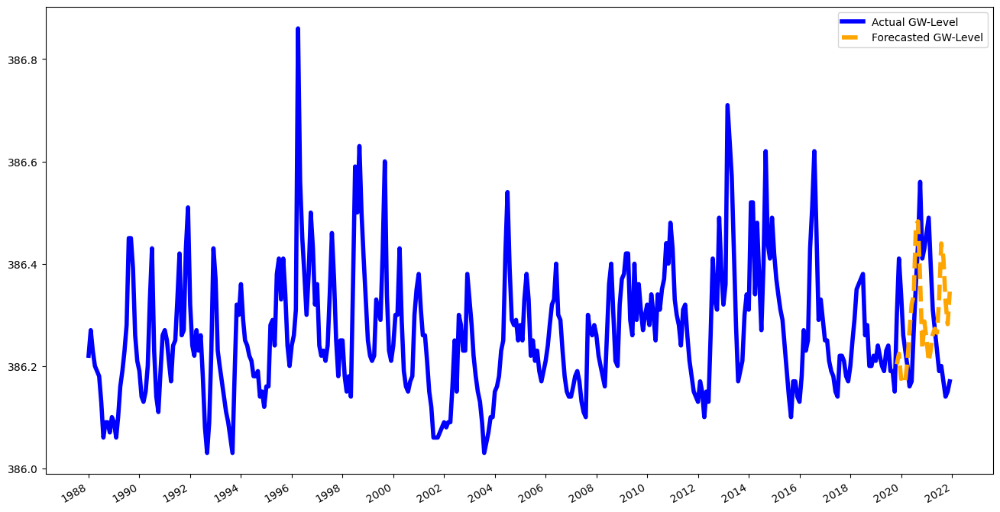



N train dates: 429
1977-04-01 00:00:00 till 2019-10-01 00:00:00
N forecast dates (horizon): 26
2019-11-01 00:00:00 till 2021-12-01 00:00:00
> SMAPE Score: 0.050509
First timepoint: 1977-04-01 00:00:00
Last timepoint:	 2021-12-01 00:00:00


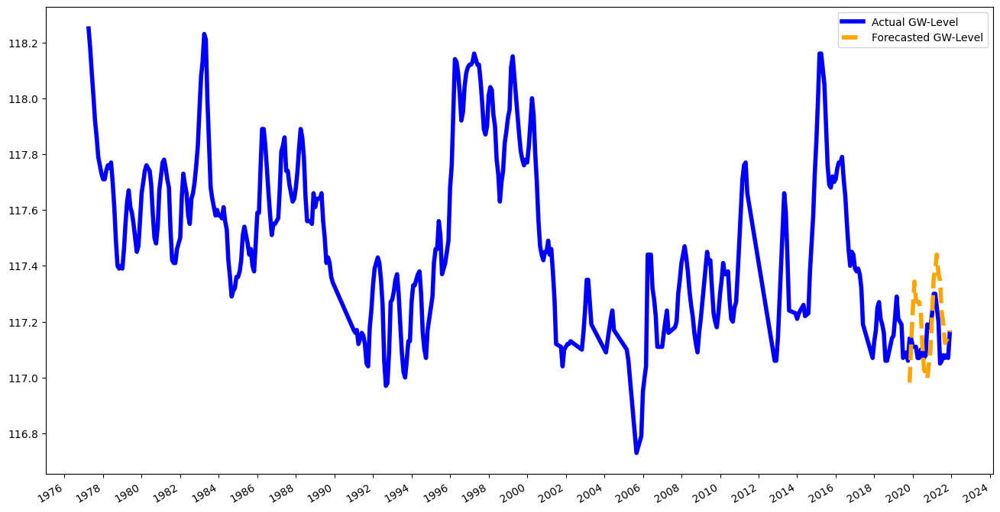



N train dates: 321
1993-01-01 00:00:00 till 2019-10-01 00:00:00
N forecast dates (horizon): 26
2019-11-01 00:00:00 till 2021-12-01 00:00:00
> SMAPE Score: 0.038619
First timepoint: 1993-01-01 00:00:00
Last timepoint:	 2021-12-01 00:00:00


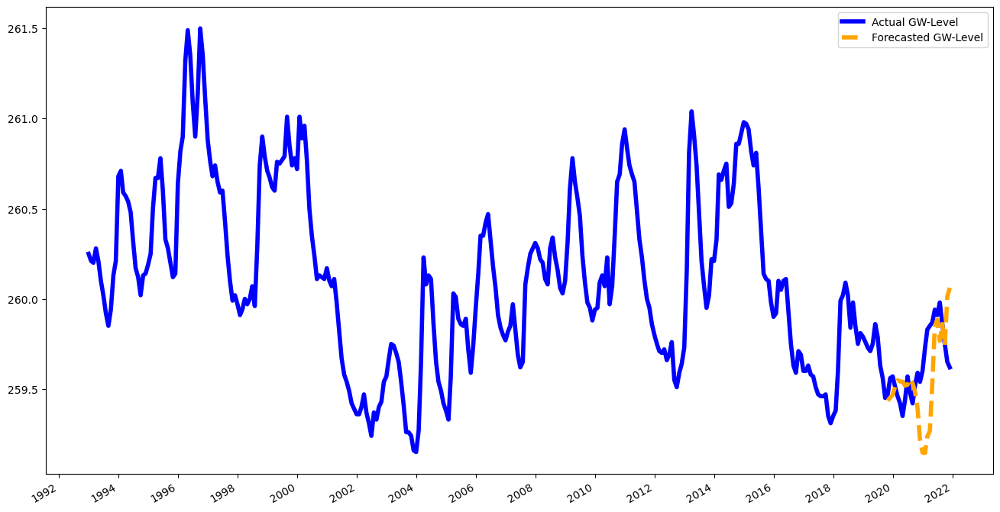



N train dates: 226
2000-10-01 00:00:00 till 2019-10-01 00:00:00
N forecast dates (horizon): 26
2019-11-01 00:00:00 till 2021-12-01 00:00:00
> SMAPE Score: 0.143382
First timepoint: 2000-10-01 00:00:00
Last timepoint:	 2021-12-01 00:00:00


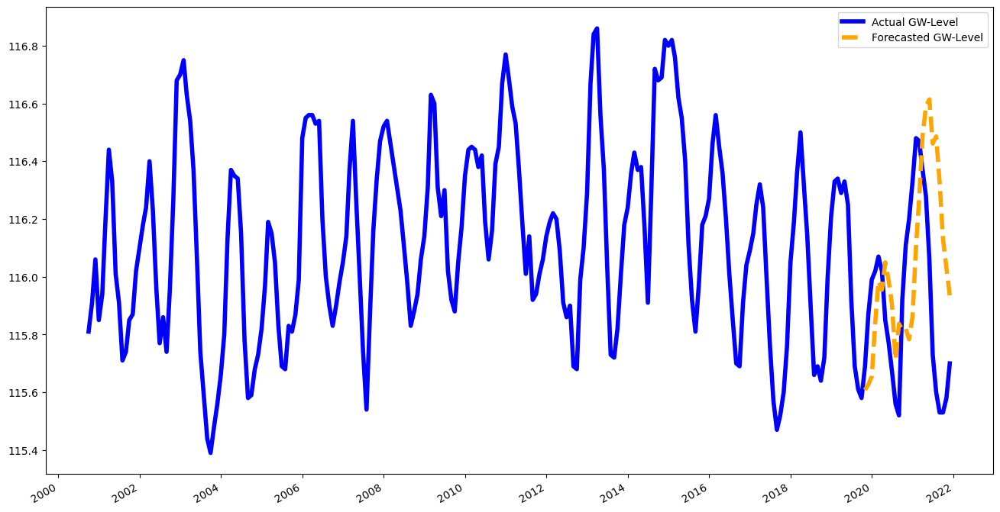



N train dates: 610
1969-01-01 00:00:00 till 2019-10-01 00:00:00
N forecast dates (horizon): 26
2019-11-01 00:00:00 till 2021-12-01 00:00:00
> SMAPE Score: 0.082795
First timepoint: 1969-01-01 00:00:00
Last timepoint:	 2021-12-01 00:00:00


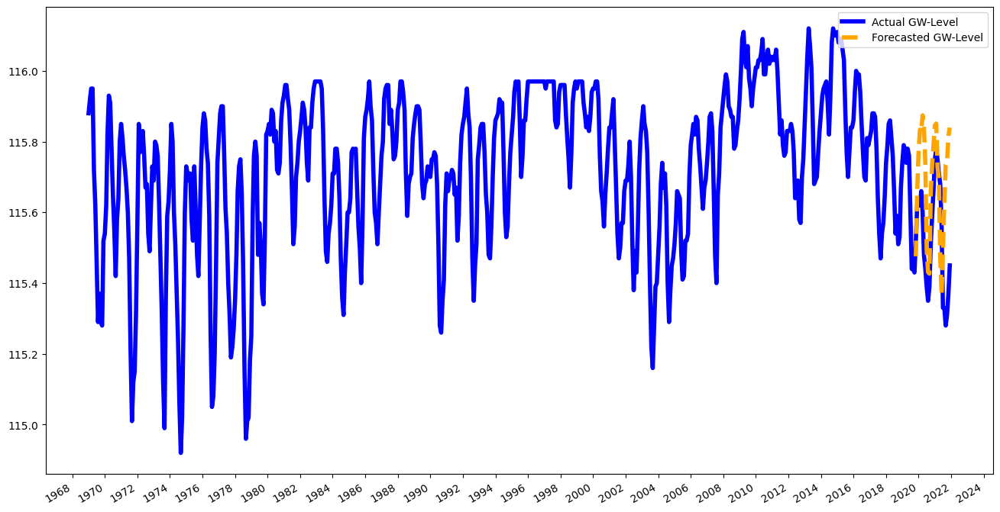



N train dates: 313
1991-02-01 00:00:00 till 2019-10-01 00:00:00
N forecast dates (horizon): 26
2019-11-01 00:00:00 till 2021-12-01 00:00:00
> SMAPE Score: 0.051102
First timepoint: 1991-02-01 00:00:00
Last timepoint:	 2021-12-01 00:00:00


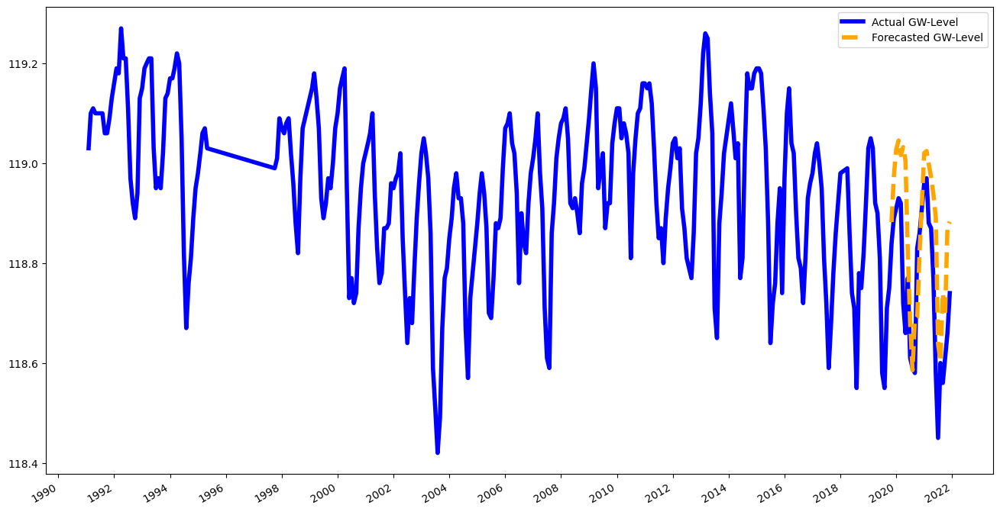



N train dates: 557
1972-01-01 00:00:00 till 2019-10-01 00:00:00
N forecast dates (horizon): 26
2019-11-01 00:00:00 till 2021-12-01 00:00:00
> SMAPE Score: 0.169302
First timepoint: 1972-01-01 00:00:00
Last timepoint:	 2021-12-01 00:00:00


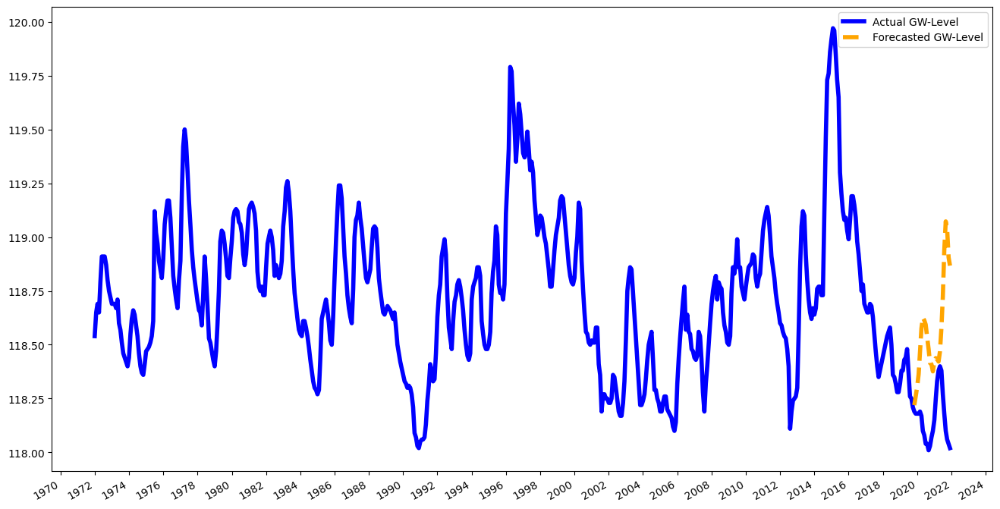



N train dates: 787
1953-12-01 00:00:00 till 2019-10-01 00:00:00
N forecast dates (horizon): 26
2019-11-01 00:00:00 till 2021-12-01 00:00:00
> SMAPE Score: 0.124454
First timepoint: 1953-12-01 00:00:00
Last timepoint:	 2021-12-01 00:00:00


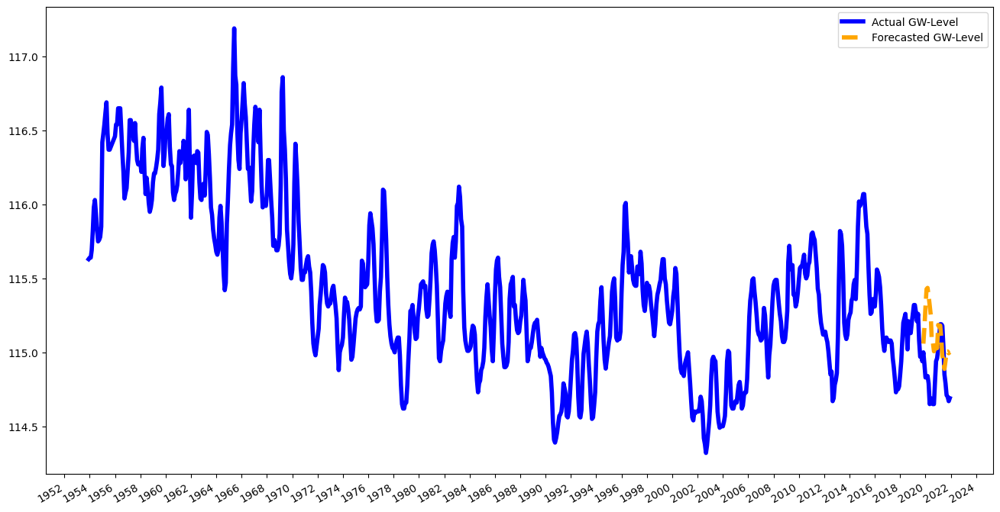



N train dates: 172
2004-10-01 00:00:00 till 2019-10-01 00:00:00
N forecast dates (horizon): 23
2019-11-01 00:00:00 till 2021-11-01 00:00:00
> SMAPE Score: 0.097417
First timepoint: 2004-10-01 00:00:00
Last timepoint:	 2021-11-01 00:00:00


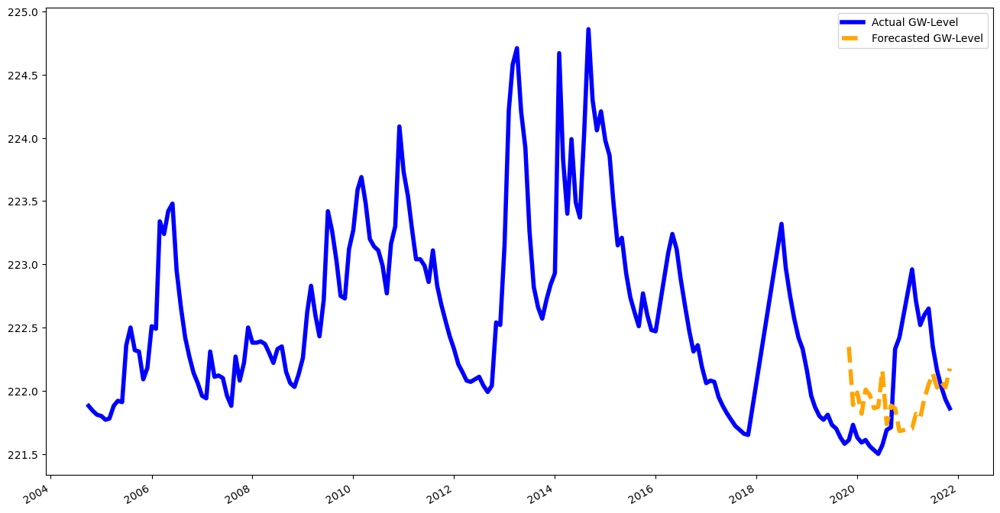



N train dates: 369
1989-01-01 00:00:00 till 2019-10-01 00:00:00
N forecast dates (horizon): 26
2019-11-01 00:00:00 till 2021-12-01 00:00:00
> SMAPE Score: 0.088379
First timepoint: 1989-01-01 00:00:00
Last timepoint:	 2021-12-01 00:00:00


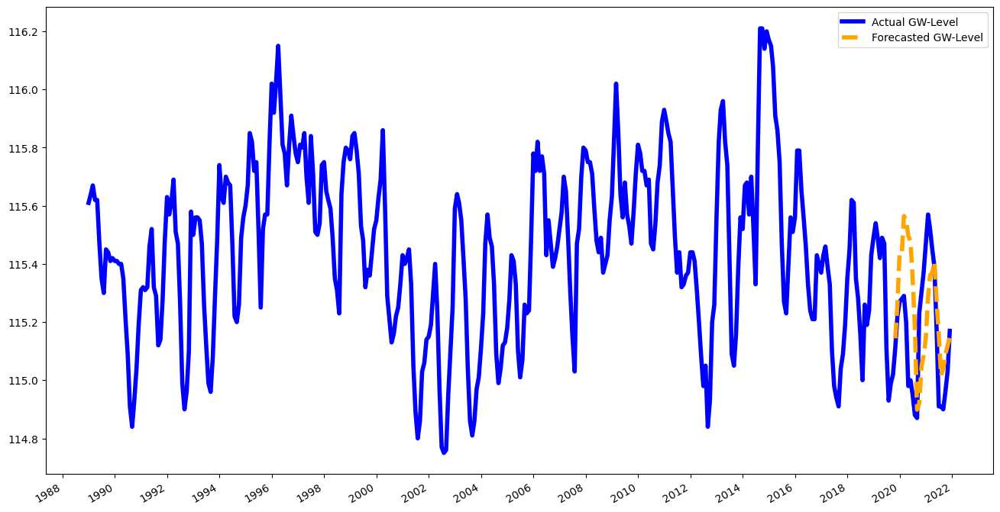



N train dates: 322
1993-01-01 00:00:00 till 2019-10-01 00:00:00
N forecast dates (horizon): 26
2019-11-01 00:00:00 till 2021-12-01 00:00:00
> SMAPE Score: 0.084718
First timepoint: 1993-01-01 00:00:00
Last timepoint:	 2021-12-01 00:00:00


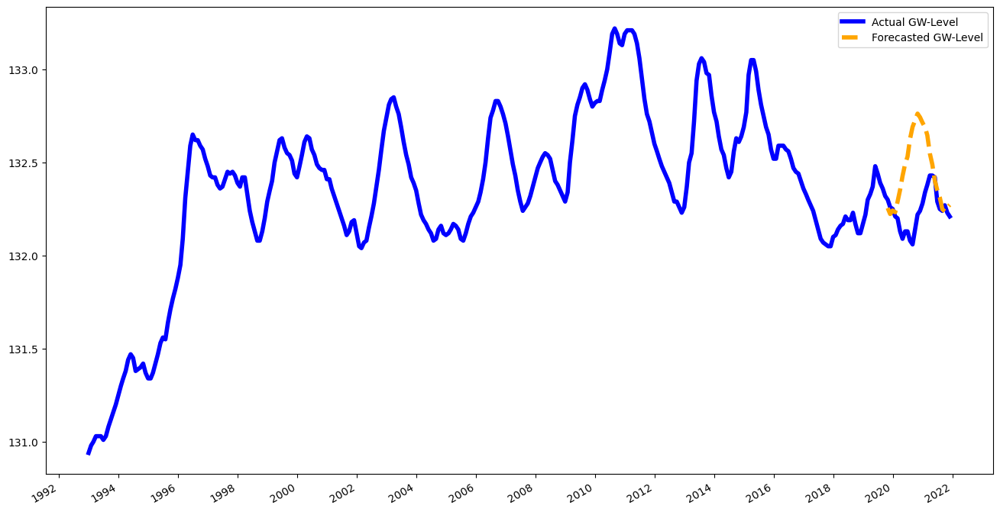



N train dates: 138
2005-10-01 00:00:00 till 2019-10-01 00:00:00
N forecast dates (horizon): 26
2019-11-01 00:00:00 till 2021-12-01 00:00:00


KeyboardInterrupt: 

In [173]:
## forecast for all mps in region
region_idx = 0
mp_nums = get_region_mp_nums(region_idx, regions, region_dirs)

# Get a tuned XGBRegressor model
model = get_tuned_XGB_model(MODEL_TUNE_MODE, region_idx=region_idx)

for mp_num in mp_nums:
    hzbnr01 = mp_num
    # Forecast
    df_p = forecast(model, ds, hzbnr01, 
                    FORECAST_T_START, FORECAST_T_END, 
                    forecast_existing=FORECAST_EXISTING, 
                    nthread=1)

    #print(df_p)
    print("\n===============================================\n")

> Region: Burgenland
> N included mps: 282
> N records: 104454
SMAPE: 0.013087%
Feature Weights DataFrame:
                        weight
land_height       8.458746e-01
yr_min            6.835981e-02
yr_avg_dist       5.012712e-02
yr_max            3.207671e-02
bottom_line       2.697425e-03
x                 4.476633e-04
mp_height         3.820656e-04
y                 1.936258e-05
hzbnr01           5.300366e-06
yr_min_dist       5.277496e-06
yr_max_dist       1.772282e-06
yr_avg            1.360367e-06
year              1.006823e-06
month             5.014279e-07
yr_avg_abs(dist)  0.000000e+00


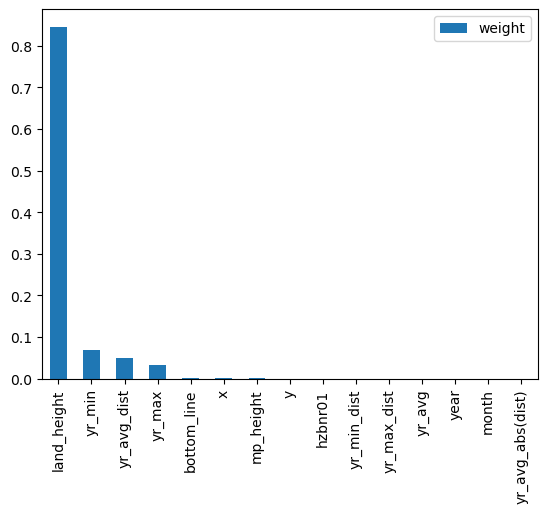

In [34]:
# Predict for all mps in region
region_idx = 0
predict_region(model, region_idx=region_idx, plot_feature_importance=True)

##